# Set up environment and functions

In [1]:
import os
os.chdir('/home/jupyter/slide-tcr-seq-public/edit/PubData/')

In [45]:
# Import packages and set parameters for plotting and directories
import ast
import bisect
from collections import Counter
import copy
import csv
from datetime import datetime
import functools
from functools import reduce
import itertools
import kneed
from kneed import DataGenerator, KneeLocator
import math
from matplotlib import pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
from matplotlib_venn import venn2, venn2_circles
import matplotlib.cm as cm
import matplotlib.font_manager as fm
from matplotlib_scalebar.scalebar import ScaleBar
import numpy as np
from os import path
import pandas as pd
import pickle5 as pkl
import random
import scanpy as sc
import scipy
import scipy.sparse
from scipy.interpolate import make_interp_spline
import scipy.spatial as spatial
from scipy.spatial import distance
from scipy.stats import kstest, pearsonr, ttest_rel, ttest_ind, gaussian_kde
from scipy.stats import gaussian_kde as kde
from scipy.ndimage import gaussian_filter, gaussian_filter1d
import seaborn as sns
import skbio
from sklearn.decomposition import NMF
from sklearn.neighbors import KNeighborsClassifier
from sklearn.cluster import KMeans
import statsmodels
from statistics import mean, stdev
from statsmodels import stats
from statsmodels.stats.weightstats import DescrStatsW
import statsmodels.stats.multitest
import sys
from tqdm.notebook import tqdm
from scipy.spatial import cKDTree


fontprops = fm.FontProperties(size=18)
pixels_needed = 500 / 0.65
nbins = 100
plt.rcParams["pdf.fonttype"] = 42
directory_slideseq = '.'
directory_out = '.'
%matplotlib inline

In [3]:
# Define functions


def cohens_d(i, j):
    """Calculates the Cohen's d effect size between two groups"""
    return (mean(i) - mean(j)) / (math.sqrt((stdev(i)**2 + stdev(j)**2) / 2))


def slope_intercept(x1, y1, x2, y2):
    a = (y2 - y1) / (x2 - x1)
    b = y1 - a * x1
    return a, b


def abline(slope, intercept, ax_name=None):
    """Plot a line from slope and intercept"""
    if ax_name is None:
        axes = plt.gca()
        x_vals = np.array(axes.get_xlim())
        y_vals = intercept + slope * x_vals
        plt.plot(x_vals, y_vals, "--")
    else:
        x_vals = np.array(ax_name.get_xlim())
        y_vals = intercept + slope * x_vals
        ax_name.plot(x_vals, y_vals, "--")


def closest_node(node, nodes):
    """Finds the closest point in a list of points to a given point"""
    closest_index = distance.cdist([node], nodes).argmin()
    return nodes[closest_index]


def distance_between_points(pt1, pt2):
    """Distance between two points"""
    return math.sqrt((pt1[0] - pt2[0])**2 + (pt1[1] - pt2[1])**2)


def switch_dict(orig_dict):
    """Switches the keys and values of a dictionary and merges to a list"""
    new_dict = {}
    for i in orig_dict:
        if orig_dict[i] in new_dict:
            new_dict[orig_dict[i]].append(i)
        else:
            new_dict[orig_dict[i]] = [i]
    return new_dict


def generate_barcode_loc_dictionary(barcode_file,
                                    locations_file,
                                    old_status=False):
    """Creates barcode and location dictionary from Slide-seq data"""
    barcode_loc_dict = {}

    if old_status:
        with open(barcode_file, "r") as file1, open(locations_file,
                                                    "r") as file2:
            for line1, line2 in zip(file1, file2):
                line1 = line1.rstrip("\n")
                line2 = line2.rstrip("\n")
                line2_split = list(line2.split("\t"))
                barcode_loc_dict[line1] = (line2_split[1], line2_split[2])

    else:
        barcodes = []
        with open(barcode_file, "r") as file1, open(locations_file,
                                                    "r") as file2:
            for line in file1:
                line = line.rstrip("\n")
                line = line.replace(",", "")
                barcodes.append(line)

        with open(locations_file, "r") as file1:
            locations = []
            for line in file1:
                line = line.rstrip("\n")
                line_split = list(line.split("\t"))
                locations.append((line_split[1], line_split[2]))

    file1.close()
    file2.close()

    for i, j in enumerate(barcodes):
        barcode_loc_dict[j] = (float(locations[i][0]), float(locations[i][1]))

    return barcode_loc_dict


def hamming_distance(s1, s2):
    """Reports if hamming distance between two strings is 1"""
    if len(s1) != len(s2):
        return 'Fail'
    return sum(ch1 != ch2 for ch1, ch2 in zip(s1, s2))


def clonotype_to_spatial(
    clonotype_to_barcode,
    barcode_to_spatial,
    display_missed_barcodes=True,
    hamming_correction=True,
    verbose=False,
):
    hamming_dict = {}
    """Returns dictionary of clonotypes to all spatial locations"""
    cl_to_spatial = {}
    # For each clonotype
    print(len(clonotype_to_barcode), "total to analyze")

    errors = []

    all_barcodes = set(barcode_to_spatial)
    all_barcodes_firsthalf = {}
    all_barcodes_secondhalf = {}
    for bc in all_barcodes:
        if bc[0:7] not in all_barcodes_firsthalf:
            all_barcodes_firsthalf[bc[0:7]] = set()
        all_barcodes_firsthalf[bc[0:7]].add(bc)
        if bc[7:] not in all_barcodes_secondhalf:
            all_barcodes_secondhalf[bc[7:]] = set()
        all_barcodes_secondhalf[bc[7:]].add(bc)

    for tcr_clonotype in tqdm(clonotype_to_barcode):
        missed_barcodes = []
        bc_umis_per_cl = set(clonotype_to_barcode[tcr_clonotype])

        if tcr_clonotype not in cl_to_spatial:
            cl_to_spatial[tcr_clonotype] = []

        for read in bc_umis_per_cl:
            bc = read[0][0:14]
            if bc in barcode_to_spatial:
                cl_to_spatial[tcr_clonotype].append(barcode_to_spatial[bc])
                continue
            else:
                if display_missed_barcodes:
                    if bc not in missed_barcodes:
                        print(bc,
                              " was not found in in situ barcode sequencing")
                        missed_barcodes.append(bc)

                if hamming_correction:
                    all_barcodes_searchspace = set()
                    if bc[7:] in all_barcodes_secondhalf:
                        all_barcodes_searchspace.update(
                            all_barcodes_secondhalf[bc[7:]])
                    if bc[0:7] in all_barcodes_firsthalf:
                        all_barcodes_searchspace.update(
                            all_barcodes_firsthalf[bc[0:7]])
                    all_barcodes_pass_hamming = [
                        bc2 for bc2 in all_barcodes_searchspace
                        if hamming_distance(bc, bc2) == 1
                    ]

                    if len(all_barcodes_pass_hamming) > 1:
                        if verbose:
                            print("bc:", bc, "match?",
                                  all_barcodes_pass_hamming)
                            print("error not 1 d apart")
                        errors.append(all_barcodes_pass_hamming)
                        continue
                    if len(all_barcodes_pass_hamming) == 1:
                        cl_to_spatial[tcr_clonotype].append(
                            barcode_to_spatial[all_barcodes_pass_hamming[0]])

                continue
    return cl_to_spatial, errors


def cl_loc_convert_loc_cl(tcr_loc_dict):
    """Converts clonotype-location dictionary to location-clonotype"""
    loc_to_tcr = {}  # Dictionary of locations to clonotypes
    for tcr in tcr_loc_dict:
        loc_all = tcr_loc_dict[tcr]
        for loc in loc_all:
            if loc in loc_to_tcr:
                loc_to_tcr[loc].append(tcr)
            else:
                loc_to_tcr[loc] = [tcr]

    # Remove duplicates
    loc_to_tcr_dedup = {}
    for loc in loc_to_tcr:
        loc_to_tcr_dedup[loc] = set(loc_to_tcr[loc])

    return loc_to_tcr_dedup


def bc_loc_convert_loc_bc(bc_loc_dict):
    """Converts bc-location dictionary to location-bc"""
    loc_bc_dict = {}
    for bc in bc_loc_dict:
        loc_all = bc_loc_dict[bc]

        if loc_all not in loc_bc_dict:
            loc_bc_dict[loc_all] = []

        loc_bc_dict[loc_all].append(bc)

    return loc_bc_dict


def check_clonotype(cl_string, a_clonotypes_list, b_clonotypes_list):
    """Checks if a clonotype is in alpha or beta list"""
    if cl_string in a_clonotypes_list:
        return "a"
    if cl_string in b_clonotypes_list:
        return "b"


def save_to_csv(filename,
                tcr_loc_dict,
                clonotypes,
                bc_umi_dict,
                output_dataframe=True,
                save=True):
    """Output a csv file with bead barcodes, locations, and clonotypes
    of tcr_a and tcr_b"""
    loc_to_tcr = cl_loc_convert_loc_cl(
        tcr_loc_dict)  # Convert tcr:locations to locations:tcr

    # Make list of all locations
    locations = loc_to_tcr.keys()
    loclist = list(locations)

    # Make list of all clonotypes at each location
    clonotypes_all = []

    for loc in loclist:
        clonotypes_all.append(loc_to_tcr[loc])

    # Separate list of all clonotypes into tcr_a and tcr_b
    clonotypes_a = []
    clonotypes_b = []
    for i in clonotypes_all:
        insert_a = []
        insert_b = []
        for j in i:
            outcome = check_clonotype(j, clonotypes["1a"], clonotypes["1b"])
            if outcome == "a":
                insert_a.append(j)
                insert_b.append("")
            elif outcome == "b":
                insert_b.append(j)
                insert_a.append("")

        clonotypes_a.append(insert_a)
        clonotypes_b.append(insert_b)

    # Make list of bead_barcodes at each location
    bead_barcodes = []
    for i in loclist:
        loc_bc = bc_loc_convert_loc_bc(bc_umi_dict)
        bead_barcodes.append(loc_bc[i])

    # Save as csv
    if save:
        with open(filename, "w") as csvfile:
            fieldnames = ["x", "y", "tcr_a", "tcr_b", "bead_barcodes"]

            writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
            writer.writeheader()
            for i, j in enumerate(loclist):
                writer.writerow({
                    "x": j[0],
                    "y": j[1],
                    "tcr_a": clonotypes_a[i],
                    "tcr_b": clonotypes_b[i],
                    "bead_barcodes": bead_barcodes[i][0],
                })

    # Output result as dataframe
    if output_dataframe:
        d = {
            "x": [i[0] for i in loclist],
            "y": [i[1] for i in loclist],
            "tcr_a": clonotypes_a,
            "tcr_b": clonotypes_b,
            "bead_barcodes": [i[0] for i in bead_barcodes],
        }

        df = pd.DataFrame(data=d)
        return df


def import_dge(dge_filename, skip_lines=0, print_progress=True):
    """Imports a dge as a dictionary and barcodes"""
    csv.field_size_limit(sys.maxsize)
    cter = 0

    reader = csv.reader(open(dge_filename), delimiter='\t')

    result = {}
    cter = 0
    for row in reader:
        cter += 1
        key = row[0]
        if key in result:
            # implement your duplicate row handling here
            pass
        result[key] = row[1:]
        if cter % 1000 == 0 and print_progress:
            print(cter)

    barcodes = list(result['GENE'])
    result.pop('GENE')
    for item in result:
        result[item] = [int(i) for i in result[item]]

    return result, barcodes


def dge_formatting(dge, barcodes_fn, locations_fn):
    """Formats a dge as a dataframe and returns coordinates for locations"""
    coords_barcodes = pd.read_csv(barcodes_fn, sep="\t", header=None)
    coords_barcodes = [i.replace(",", "")
                       for i in list(coords_barcodes[0])]  # Remove commas
    coords_locations = pd.read_csv(locations_fn, sep="\t", header=None)
    coords = pd.DataFrame(coords_locations)
    coords.set_axis(["id", "xcoord", "ycoord"], axis=1, inplace=True)
    coords["barcodes"] = coords_barcodes
    coords.set_index("barcodes", inplace=True)

    barcodes_in_dge = dge.index
    barcodes_in_coords = coords.index
    common_barcodes = [i for i in barcodes_in_dge if i in barcodes_in_coords]
    dge = dge.loc[common_barcodes]
    coords = coords.loc[common_barcodes]

    return dge, coords


def dge_formatting_sst(dge, barcodes, locations):
    """Formats a dge as a dataframe and returns coordinates for locations"""
    coords = pd.DataFrame({'barcodes': barcodes})
    coords['xcoord'] = [i[0] for i in locations]
    coords['ycoord'] = [i[1] for i in locations]
    coords.set_index("barcodes", inplace=True)

    barcodes_in_dge = dge.index
    barcodes_in_coords = coords.index
    #common_barcodes = [i for i in barcodes_in_dge if i in barcodes_in_coords]
    #dge = dge.loc[common_barcodes]
    #     coords = coords.loc[common_barcodes]

    return dge


def find_specific_barcodes(which_tcr, df_scb):
    """Finds the barcodes of a certain clonotype"""

    tcr_spec = df_scb[which_tcr]

    tcr_spec_counter = []
    ct = 0
    for i in tcr_spec:

        if isinstance(i, list):
            cl = i
        else:
            cl = ast.literal_eval(i)
        cl = [n.strip() for n in cl]
        filt_cl = [j for j in cl if j != ""]
        if len(filt_cl) == 0:
            tcr_spec_counter.append(-1)
        else:
            tcr_spec_counter.append(ct)
        ct += 1

    tcr_specific_barcodes = [
        df_scb["bead_barcodes"][b] for b in tcr_spec_counter if b != -1
    ]

    print(len(tcr_specific_barcodes))
    return tcr_specific_barcodes


def open_sparse_matrix(filename, dge_filename, sample_abbrev):
    """Opens a previously saved sparse matrix as a dataframe, used for DGE"""
    sparse_matrix = scipy.sparse.load_npz(filename)
    sparse_matrix_dense = sparse_matrix.todense()
    sparse_matrix_dense = sparse_matrix_dense.astype(float)

    if (path.exists("{}/{}_genenames_barcodes.csv".format(
            directory_slideseq, sample_abbrev)) is False):
        new_dict, barcodes = import_dge(dge_filename, print_progress=True)
        df_dge = pd.DataFrame(data=new_dict, index=barcodes)
        df_dge.index.name = "barcodes"
        dge_fmtd = df_dge
        cols = [list(dge_fmtd.columns)]
        rows = [list(dge_fmtd.index)]
        f = pd.DataFrame({"Genes": cols, "Barcodes": rows})
        f.to_csv(
            "{}/{}_genenames_barcodes.csv".format(directory_slideseq,
                                                  sample_abbrev),
            header=True,
            index=False,
        )

    rows_cols = pd.read_csv("{}/{}_genenames_barcodes.csv".format(
        directory_slideseq, sample_abbrev))
    cols = list(rows_cols["Genes"])
    cols = [ast.literal_eval(i) for i in cols][0]
    rows = list(rows_cols["Barcodes"])
    rows = [ast.literal_eval(i) for i in rows][0]
    new_df = pd.DataFrame(data=sparse_matrix_dense, columns=cols, index=rows)
    return new_df


def save_as_sparse(filename, abbrev_sample_reference, skip_lines=0):
    """Saves a dataframe as a sparse matrix, used for DGE"""
    new_dict, barcodes = import_dge(filename, skip_lines, print_progress=True)
    df_dge = pd.DataFrame(data=new_dict, index=barcodes)
    df_dge.index.name = "barcodes"
    dge_fmtd = df_dge
    cols = [list(dge_fmtd.columns)]
    rows = [list(dge_fmtd.index)]
    f = pd.DataFrame({"Genes": cols, "Barcodes": rows})
    f.to_csv(
        "{}/{}_genenames_barcodes.csv".format(directory_slideseq,
                                              abbrev_sample_reference),
        header=True,
        index=False,
    )
    array = dge_fmtd.values
    sparse_matrix = scipy.sparse.csc_matrix(array)
    scipy.sparse.save_npz(
        "{}/{}_sparse_matrix.npz".format(directory_slideseq,
                                         abbrev_sample_reference),
        sparse_matrix,
    )


def read_in_clonotypes(sample_name, full_directory=False):
    """Reads in clonotypes from MiXCR output"""
    if full_directory is False:
        fn1 = "{}{}_paired_clones.txt".format(directory, sample_name)
        fn2 = "{}{}_paired_cloneID.txt".format(directory, sample_name)
    if full_directory:
        fn1 = "{}{}_paired_clones.txt".format(directory, sample_name)
        fn2 = "{}{}_paired_cloneID.txt".format(directory, sample_name)
    cloneids = pd.read_csv(fn1, sep="\t")
    readids = pd.read_csv(fn2, sep="\t", error_bad_lines=False)
    readids = readids[(readids.topChains == "TRB") |
                      (readids.topChains == "TRA")]
    cloneids = cloneids[(cloneids.topChains == "TRB") |
                        (cloneids.topChains == "TRA")]
    return cloneids, readids


def readIDtobarcode(fastq_file_r1, up_filter):
    """Converts read IDs from MiXCR output to barcodes"""
    readIDtobarcode = {}
    line_count = 0
    all_read_count = 0
    up_present_ct = 0
    up_not_present_ct = 0
    up_shifted_ct = 0
    with open(fastq_file_r1, "r") as file1:
        for line1 in file1:
            if line_count % 4 == 0:  # readID name
                line1 = line1.strip()
                read_name = line1[1:].split(' ')[0]
            if line_count % 4 == 1:  # Check if fastq sequence
                all_read_count += 1
                barcode = line1[0:8] + line1[26:32]
                if line1[8:26] == "TCTTCAGCGTTCCCGAGA":
                    up_present_ct += 1

                else:

                    if "TCTTCAGCGTTCCCGAGA" in line1:
                        up_shifted_ct += 1
                    else:
                        up_not_present_ct += 1
                    if up_filter:
                        line_count += 1
                        continue

                umi = line1[32:41]

                readIDtobarcode[read_name] = [barcode, umi]
            line_count += 1
            if line_count % 1000000 == 0:
                print(line_count)
                print(datetime.now())
    file1.close()
    print("Total reads:", all_read_count)
    print(
        "UP present reads:",
        up_present_ct,
        "UP not present reads:",
        up_not_present_ct,
        ". UP shifted: ",
        up_shifted_ct,
    )
    return readIDtobarcode


def tcr_bcumi_dict_f(readbarcode, cloneids, readids):
    """Makes a dictionary of TCR clonotypes to barcode-UMIs"""
    aa_to_clid = {}
    aa_to_tcr = {}
    cloneids_dict = cloneids.to_dict()
    for i in cloneids_dict['cloneId'].keys():
        clid = cloneids_dict['cloneId'][i]
        aa_seq = cloneids_dict['aaSeqImputedCDR3'][i]
        tcr_seq = cloneids_dict['targetSequences'][i]
        if aa_seq not in aa_to_clid:
            aa_to_clid[aa_seq] = []
        aa_to_clid[aa_seq].append(clid)

        if aa_seq not in aa_to_tcr:
            aa_to_tcr[aa_seq] = []
        aa_to_tcr[aa_seq].append(tcr_seq)

    clid_to_r1name = {}
    r1name_all = [i.split(' ')[0] for i in list(readids["descrsR1"])]
    clid_all = list(readids["cloneId"])
    for key, value in tqdm(zip(clid_all, r1name_all)):
        if key in clid_to_r1name:
            clid_to_r1name[key].append(value)
        else:
            clid_to_r1name[key] = [value]
    cl_aa_to_barcode_umis = {}
    for aa in tqdm(aa_to_clid):
        if aa not in cl_aa_to_barcode_umis:
            cl_aa_to_barcode_umis[aa] = []
        for clid in aa_to_clid[aa]:
            if clid not in clid_to_r1name:
                continue
            for r1name in clid_to_r1name[clid]:
                if r1name in readbarcode:
                    cl_aa_to_barcode_umis[aa].append(tuple(
                        readbarcode[r1name]))

    return cl_aa_to_barcode_umis


def merge_hamming_clonotype(clonotype_dict):
    """Merges clonotypes with a hamming distance of 1 into
    the clonotype with more UMIs"""
    hamming_sets = []
    found = False
    clonotype_dict_hamming = {}
    for i in clonotype_dict:
        found = False
        for hset in hamming_sets:
            for cl in hset:
                if hamming_distance(i, cl) == 1:
                    hset.append(i)
                    found = True
                    break
            if found:
                break
        if found:
            continue
        hamming_sets.append([i])

    for hset in hamming_sets:
        hset_lengths = [len(clonotype_dict[i]) for i in hset]
        pref_clonotype = hset[hset_lengths.index(max(hset_lengths))]

        clonotype_dict_hamming[pref_clonotype] = []
        for cl in hset:
            clonotype_dict_hamming[pref_clonotype] = (
                clonotype_dict_hamming[pref_clonotype] + clonotype_dict[cl])
    return clonotype_dict_hamming


def plot_variable_vs_constant(dge_output,
                              tcr_type,
                              tcr_loc_dict_s1,
                              loc_to_bc_s1,
                              puck,
                              human=False,
                              cutoff=15,
                              file_type='jilong',
                              plot_histogram=True,
                              save=False,
                              nanopore=False,
                              nanopore_filt=False):
    """Plots the variable recovery"""
    if tcr_type == "tcr_b":
        gene_name = "Trbc2"
    if tcr_type == "tcr_a":
        gene_name = "Trac"
    if human:
        if tcr_type == "tcr_b":
            gene_name = "TRBC2"
        if tcr_type == "tcr_a":
            gene_name = "TRAC"

    bc_umis = (
        {}
    )  # This converts dictionary to barcodes:UMIs instead of clonotypes:[bc,umi]
    if nanopore == True:
        if nanopore_filt == True:
            bc_umis = {}
            for read in puck.nanopore_bcumi_list_filtered:
                if read[0] not in bc_umis:
                    bc_umis[read[0]] = []
                bc_umis[read[0]].append(read[1])
        else:
            for read in puck.nanopore_bcumi_list:
                if read[0] not in bc_umis:
                    bc_umis[read[0]] = []
                bc_umis[read[0]].append(read[1])

    else:

        for cl in tcr_loc_dict_s1:
            for loc in tcr_loc_dict_s1[cl]:
                bc = loc_to_bc_s1[loc]
                if bc not in bc_umis:
                    bc_umis[bc] = []
                bc_umis[bc].append(loc)
        # tcr_bc = list(df_output['bead_barcodes'])
    tcr_barcodes = list(dge_output[
        dge_output[gene_name] >= 1].index)  # all constant tcr barcodes
    if file_type == 'slide-seq-tools':
        if nanopore == True:
            pass
        else:
            tcr_barcodes = [
                puck.matched_bead_barcodes[i] for i in tcr_barcodes
            ]

    cons_counts = []
    for j in tcr_barcodes:
        if file_type == 'slide-seq-tools':
            if nanopore == True:
                j = j
            else:
                j = puck.matched_bead_barcodes_rev[j]
        cons_counts.append(dge_output.loc[j][gene_name])


#         ### TESTING DELETE BELOW
#         cons_counts.append(dge_output.loc[j][gene_name] + dge_output.loc[j]['Trbc1'])

### TESTING DELETE ABOVE

    var_counts = []  # record umi counts
    for i in tcr_barcodes:
        if nanopore:
            i = i[:-2]
        if i in bc_umis:
            var_counts.append(len(bc_umis[i]))
        if i not in bc_umis:
            var_counts.append(0)

    frac_count = [j / i for i, j in zip(cons_counts, var_counts)]

    frac_count_adj = []

    for i in frac_count:
        if i > 0:
            frac_count_adj.append(1)
        else:
            frac_count_adj.append(0)

    ##### groups counts based on constant counts

    t = int(max(cons_counts))  # maximum number of constant counts

    output = [0] * t  # Summed beads passing test for this bin
    counts = [0] * t  # Number of bead barcodes for each bin

    for i, j in enumerate(cons_counts):
        idxcount = int(j) - 1
        output[idxcount] += frac_count_adj[i]
        counts[idxcount] += 1

    frac_fin = []
    cutoff_sum = [[], []]  # output, beads
    for i, j in enumerate(output):
        if i < cutoff:
            if counts[i] == 0:  # If there arloade no beads, append 0
                frac_fin.append(0)
            else:
                frac_fin.append(
                    float(j) / float(counts[i])
                )  # number of beads passing test divided by total constant beads
        else:
            cutoff_sum[0].append(j)
            cutoff_sum[1].append(counts[i])
    frac_fin.append(sum(cutoff_sum[0]) / sum(cutoff_sum[1]))

    #Aesthetics
    _, ax = plt.subplots(figsize=(cutoff, 5))
    print(cutoff)

    if tcr_type == "tcr_a":
        color_to_use = "#9FB7CD"
    if tcr_type == "tcr_b":
        color_to_use = "#0F4C81"

    ax.bar(np.array([i + 1 for i in range(cutoff + 1)]),
           frac_fin,
           color=color_to_use)
    labels = [str(i) for i in counts]
    updated_labels = []
    for v, i in enumerate(frac_fin):
        if v < cutoff:
            ax.text(v + 1,
                    1.03,
                    labels[v],
                    ha="center",
                    va="bottom",
                    rotation="vertical")
            updated_labels.append(int(labels[v]))
        if v == cutoff:
            ax.text(
                v + 1,
                1.03,
                str(sum(cutoff_sum[1])),
                ha="center",
                va="bottom",
                rotation="vertical",
            )
            updated_labels.append(sum(cutoff_sum[1]))
    plt.ylim([0, 1])
    if tcr_type == "tcr_b":
        #         plt.yticks([])
        plt.ylabel("")
        plt.xlabel("Number of constant reads")

    else:
        plt.ylabel("Fraction")
        plt.ylabel("")
        plt.yticks([])
        plt.xlabel("")
    plt.xticks([i + 1 for i in range(cutoff + 1)])
    print(frac_fin)
    if plot_histogram:
        plt.figure(figsize=(cutoff, 1))
        print(updated_labels)
        plt.plot(range(len(updated_labels)), updated_labels)
        plt.axis("off")
    if save == True:
        plt.savefig(f'./plots/{tcr_type}.pdf')
    return updated_labels, frac_fin


def cdist(i, j):
    """Calculates the distance between every pair of points in two lists"""
    return scipy.spatial.distance.cdist(i, j)


def find_le(a, x):
    """Finds index of rightmost value less than or equal to x"""
    i = bisect.bisect_right(a, x)
    if i:
        return i - 1
    return 0


def find_ge(a, x):
    """Finds index of leftmost value greater than or equal to x"""
    i = bisect.bisect_left(a, x)
    if i <= len(a):
        return i
    raise ValueError


def bc_list_to_clusters_vector(barcode_list,
                               cell_type_list,
                               bc_to_cluster_label_dict,
                               verbose=False):
    """Makes barcodes to clusters dictionary"""
    clusters = [0 for i in range(len(cell_type_list))]
    for barcode in barcode_list:
        if barcode not in bc_to_cluster_label_dict:
            if verbose:
                print(barcode, "not in cluster labels")
            continue

        cl = bc_to_cluster_label_dict[barcode]
        clusters[cl] += 1
    return clusters


def gaussian_heat_plot(x,
                       y,
                       vmin_val,
                       vmax_val,
                       title_text,
                       plot_contour=False,
                       title=False,
                       save_name='',
                       save=False):
    """Gaussian smoothed plots for gene expression on puck"""

    data = np.array([np.array([i, j]) for i, j in zip(x, y)])
    k = kde(data.T)

    xi, yi = np.mgrid[0:6000:nbins * 1j, 0:6000:nbins * 1j]
    zi = k(np.vstack([xi.flatten(), yi.flatten()]))

    print("real life size:", (min(x) - max(x) / nbins * 0.65))

    Z, xedges, yedges = np.histogram2d(x, y, bins=nbins)

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.set_xlim([0, 6000])
    ax.set_ylim([0, 6000])
    if title:
        ax.set_title(title_text)
    Z = gaussian_filter(Z, sigma=0.5)
    this_plot = plt.pcolormesh(
        xedges[:-1],
        yedges[:-1],
        Z.T,
        cmap=reversed_color_map,
        shading="gouraud",
        vmin=vmin_val,
        vmax=vmax_val,
    )
    if plot_contour:
        ax.contour(xi,
                   yi,
                   zi.reshape(xi.shape),
                   levels=15,
                   linewidths=0.5,
                   colors="white")
    divider = make_axes_locatable(ax)
    cax = divider.append_axes(
        "right",
        size="7%",
        pad=0.2,
    )
    cbar = fig.colorbar(this_plot, cax=cax, ticks=[])
    cbar.ax.tick_params(labelsize=20)
    ax.set_axis_off()

    cbar.ax.text(0.5,
                 -0.01,
                 str(vmin_val),
                 transform=cbar.ax.transAxes,
                 va="top",
                 ha="center")
    cbar.ax.text(0.5,
                 1.0,
                 str(vmax_val),
                 transform=cbar.ax.transAxes,
                 va="bottom",
                 ha="center")
    cbar.outline.set_visible(False)
    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )

    ax.add_artist(scalebar)

    fig.canvas.draw()

    if save == True:
        fig.savefig(f"./plots/{title_text}_{save_name}.pdf",
                    bbox_inches='tight')


def make_knn_assignments(rctd_filename, puck_abbreviation, puck,
                         cluster_num_to_name_list, cell_type_list):
    """Generates K-nearest neighbors assignments for compartments on puck"""
    puck.all_locs = list(puck.loc_to_bc_s1.keys())
    aggregated_clusters = pd.read_csv(rctd_filename)
    rep = [i.split("_")[0] for i in list(aggregated_clusters.barcode)]
    barcode = [i.split("_")[1] for i in list(aggregated_clusters.barcode)]
    aggregated_clusters["rep"] = rep
    aggregated_clusters["barcode"] = barcode

    cluster_labels = aggregated_clusters[aggregated_clusters.rep ==
                                            puck_abbreviation]

    cluster_labels["x"] = [
        puck.bc_loc_dict_s1[bc][0] for bc in cluster_labels.barcode
    ]
    cluster_labels["y"] = [
        puck.bc_loc_dict_s1[bc][1] for bc in cluster_labels.barcode
    ]

    bc_to_cluster_label_dict = dict(
        zip(cluster_labels.barcode, cluster_labels.cluster))
    loc_to_cluster_dict = {
        puck.bc_loc_dict_s1[i]: bc_to_cluster_label_dict[i]
        for i in list(bc_to_cluster_label_dict.keys())
    }

    cluster_labels["cluster_name"] = [
        cluster_num_to_name_list[i] for i in cluster_labels.cluster
    ]
    # Load in cell type assignments for posttreatment
    # Perform KNN to assign tumor, lung, and TIL regions

    ###### KNN Classifier
    loc_cluster_dict = {}
    loc_cluster_dict_all = {}

    # cell_type_list = ['Tumor','Normal']
    # cell_type_list = ['TumorCell_CA9','NonImmuneCell','PlasmaCell']

    for index, row in cluster_labels.iterrows():
        loc_cluster_dict_all[(float(row["x"]),
                              float(row["y"]))] = row["cluster_name"]
        if row["cluster_name"] in cell_type_list:
            loc_cluster_dict[(float(row["x"]),
                              float(row["y"]))] = row["cluster_name"]

    unassigned_points = set(
        [i for i in puck.all_locs if i not in set(loc_cluster_dict.keys())])

    neigh = KNeighborsClassifier(
        n_neighbors=500)  # nearest neighbors was 500 for post treatment.
    print("Begin classifier process")
    X = np.array(list(loc_cluster_dict.keys()))
    y = np.array(list(loc_cluster_dict.values()))
    neigh.fit(X, y)
    cl_assignment = {}
    for pt in tqdm(unassigned_points):
        cl_assignment[pt] = neigh.predict([pt])[0]
    for pt in tqdm(loc_cluster_dict):
        cl_assignment[pt] = neigh.predict([pt])[0]

    # Plots results of classifier
    testl = []
    testtil = []
    testtu = []
    for loc in cl_assignment:
        if cl_assignment[loc] == cell_type_list[0]:
            testl.append(loc)
        if cl_assignment[loc] == cell_type_list[1]:
            testtu.append(loc)
        if cl_assignment[loc] == cell_type_list[2]:
            testtil.append(loc)

    loc_cluster_dict = copy.deepcopy(cl_assignment)
    puck.tll_loc_cluster_dict = loc_cluster_dict
    puck.tumor_beads = [
        i for i in loc_cluster_dict if loc_cluster_dict[i] == "Tumor"
    ]
    puck.loc_to_cluster_dict = loc_to_cluster_dict
    return cluster_labels


def get_locations_distribution(all_locations, locations_reference):
    """Gets the cell types for a list of locations"""
    lung_locs = set(locations_reference["Lung"])
    til_locs = set(locations_reference["TIL Chemokines"])
    tumor_locs = set(locations_reference["Tumor"])
    ltt_dist = [0, 0, 0]

    for location in all_locations:
        if location in lung_locs:
            ltt_dist[0] += 1

        elif location in til_locs:
            ltt_dist[1] += 1

        elif location in tumor_locs:
            ltt_dist[2] += 1
    return ltt_dist


def normalize_by_total_reads(list_name, total_reads):
    ''' Normalize a list by the total number of reads'''
    return [i / total_reads for i in list_name]


def clono_vd(pre_list, post_list, labels, filename):
    ''' Makes a venn diagram for comparing pre and post-treatment clonotypes'''
    plt.rcParams.update({"font.size": 12})
    set1 = set(pre_list)
    set2 = set(post_list)

    v = venn2([set1, set2], labels)
    c = venn2_circles([set1, set2])
    c[0].set_color("white")
    c[0].set_ls("solid")
    c[0].set_edgecolor("blue")

    c[1].set_color("white")
    c[1].set_ls("solid")
    c[1].set_edgecolor("red")
    plt.savefig(filename)
    plt.show()


def add_cp_puck(puck, cl_agg_enrichment):
    '''Adds a clono_plot from a puck to an aggregated enrichment'''
    for cl in puck.clono_plot_df.clonotype:
        for c in compartments:
            if cl not in cl_agg_enrichment[c]:
                cl_agg_enrichment[c][cl] = []
            cl_agg_enrichment[c][cl].append(
                float(
                    puck.clono_plot_df[puck.clono_plot_df.clonotype == cl][c]))
    return cl_agg_enrichment


def make_plotting_df():
    '''Makes plotting df for violin plots below and above median distance'''
    pval_recorder = {}
    plt.rcParams.update({"font.size": 22})
    plotting_df = {}
    plotting_df["clonotype"] = []
    plotting_df["greater_or_less"] = []
    plotting_df["expression"] = []

    for cl in list(gene_group_cl_below_median.keys()
                   ):  ### changed to different group to test
        for i in range(len(gene_group_cl_below_median[cl])):
            plotting_df["clonotype"].append(cl)
            plotting_df["greater_or_less"].append("less")
            plotting_df["expression"].append(gene_group_cl_below_median[cl][i])

        for i in range(len(gene_group_cl_above_median[cl])):
            plotting_df["clonotype"].append(cl)
            plotting_df["greater_or_less"].append("greater")
            plotting_df["expression"].append(gene_group_cl_above_median[cl][i])

        pval = kstest(gene_group_cl_below_median[cl],
                      gene_group_cl_above_median[cl])[1]
        pval_recorder[cl] = (pval)
        if pval < 0.05:
            print("KS", cl, group, pval)  #pretty_clonotype_name[cl],

    plotting_df = pd.DataFrame(plotting_df)
    return plotting_df, pval_recorder


def find_highest_expressing_clonotype(barcode,
                                      list_of_clonotypes,
                                      verbose=False):
    '''Finds highest expressing clonotype'''
    errors = []
    counts = 0
    cl_keep = ''
    for cl in list_of_clonotypes:
        if (cl, barcode) not in tcr_bc_counter_dict:
            errors.append((cl, barcode))
        else:
            bc_count = tcr_bc_counter_dict[(cl, barcode)]
            if bc_count > counts:
                counts = bc_count
                cl_keep = cl
    if (errors != [] and verbose):
        print(errors)
    return cl_keep


def save_puck(slideseq_name, puck):
    '''Saves a puck object as a pickle file'''
    with open("Puck_object_{}.pickle".format(slideseq_name), "wb") as handle:
        pkl.dump(puck, handle, protocol=pkl.HIGHEST_PROTOCOL)
    return puck


def load_puck(slideseq_name):
    '''Loads a puck object from a pickle file'''
    with open("Puck_object_{}.pickle".format(slideseq_name), "rb") as handle:
        puck = pkl.load(handle)
    return puck


def make_adata(puck, save=True):
    '''Makes an adata file'''
    adata = sc.AnnData(puck.s1_dge_fmtd)
    adata.var_names_make_unique()
    sc.pl.highest_expr_genes(
        adata,
        n_top=20,
    )
    sc.pp.filter_cells(adata, min_genes=50)
    sc.pp.filter_genes(adata, min_cells=3)
    adata.var['mt'] = adata.var_names.str.startswith(
        'MT-')  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(adata,
                               qc_vars=['mt'],
                               percent_top=None,
                               log1p=False,
                               inplace=True)
    sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
                 jitter=0.4,
                 multi_panel=True)
    sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
    sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
    #adata = adata[adata.obs.n_genes_by_counts < 2500, :]
    adata = adata[adata.obs.pct_counts_mt < 5, :]
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata,
                                min_mean=0.0125,
                                max_mean=3,
                                min_disp=0.5)
    sc.pl.highly_variable_genes(adata)
    adata.raw = adata
    adata = adata[:, adata.var.highly_variable]
    sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
    sc.pp.scale(adata, max_value=10)
    sc.tl.pca(adata, svd_solver='arpack')
    sc.pl.pca(adata, color='TRBC2')
    sc.pl.pca_variance_ratio(adata, log=True)
    sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)
    sc.tl.umap(adata)
    sc.pl.umap(adata, color=['TRBC2'], cmap='viridis')
    sc.tl.leiden(adata)
    sc.pl.umap(adata, color=['leiden'])
    sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
    sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
    # Show top 10 ranked genes in clusters in a dataframe
    pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(5)
    if save == True:
        results_file = './{}/{}.h5ad'.format(directory_slideseq, slideseq_name)
        adata.write(results_file)
    return adata


def load_adata(slideseq_name):
    '''Loads adata from pickle file'''
    with open('./{}.h5ad'.format(slideseq_name),
              "rb") as handle:
        adata = sc.read_h5ad(handle)
    return adata


In [4]:
# Create a puck class


class PuckReplicate:
    '''A class for each puck'''
    def __init__(self,
                 puck_name,
                 genome,
                 clonotype_sample_name,
                 clonotype_fastq_name,
                 umi_filter_number,
                 resave,
                 rctd_fn,
                 clonotype_mixcr_name,
                 cluster_num_to_name_list=False,
                 cell_type_list=False,
                 abbrev_rep_name=False,
                 rcc=False,
                 resave_sparse=False,
                 skip_clonotype=False,
                 file_type='jilong',
                 pub=False):
        """Sets up variables"""
        self.puck_name = puck_name
        self.abbrev_sample_reference = "_".join(puck_name.split("_")[1:])
        self.genome = genome
        self.clonotype_sample_name = clonotype_sample_name
        self.clonotype_fastq_name = clonotype_fastq_name
        self.resave_state = resave
        self.abbrev_rep_name = abbrev_rep_name
        self.cluster_num_to_name_list = cluster_num_to_name_list
        self.clonotype_mixcr_name = clonotype_mixcr_name
        self.cell_type_list = cell_type_list
        self.umi_filter_number = umi_filter_number
        self.resave_sparse = resave_sparse
        self.rctd_fn = rctd_fn  ##### CHANGE HERE
        self.file_type = file_type
        if self.file_type == 'jilong':
            self.dge_filename = "{}/{}.digital_expression.txt".format(
                directory_slideseq, self.abbrev_sample_reference)

        elif self.file_type == 'slide-seq-tools':
            self.dge_filename = "{}/{}.matched.digital_expression.txt".format(
                directory_slideseq, self.abbrev_sample_reference)
        if self.file_type == 'jilong':
            self.spatial_barcodes_s1 = "{}/{}_matched_bead_barcodes.txt".format(
                directory_slideseq, self.abbrev_sample_reference)
            self.spatial_locations_s1 = "{}/{}_matched_bead_locations.txt".format(
                directory_slideseq, self.abbrev_sample_reference)
            self.bc_loc_dict_s1 = generate_barcode_loc_dictionary(
                self.spatial_barcodes_s1,
                self.spatial_locations_s1,
                old_status=False)
        elif self.file_type == 'slide-seq-tools':
            self.bc_loc_df = pd.read_csv('{}/{}_barcode_matching.txt'.format(
                directory_slideseq, self.abbrev_sample_reference),
                                    sep='\t',
                                    header=None)
            self.spatial_barcodes_s1 = list(self.bc_loc_df[0])
            self.spatial_locations_s1 = [
                (i, j) for i, j in zip(self.bc_loc_df[2], self.bc_loc_df[3])
            ]
            self.bc_loc_dict_s1 = {
                i: j
                for i, j in zip(self.spatial_barcodes_s1,
                                self.spatial_locations_s1)
            }
            self.matched_bead_barcodes = {i:j for i,j in zip(self.bc_loc_df[1],self.bc_loc_df[0])}

        self.loc_to_bc_s1 = {y: x for x, y in self.bc_loc_dict_s1.items()}

        if skip_clonotype is False:
            self.identify_clonotypes()
        self.open_dge()
        if rcc:
            self.run_rcc()

    def identify_clonotypes(self):
        """Identifies clonotypes from rhTCR sequencing"""
        if (path.exists("{}/cloneids_readids_{}.pickle".format(
                directory_slideseq, self.puck_name)) is
                False) or (self.resave_state):
            self.cloneids, self.readids = read_in_clonotypes(
                sample_name=self.clonotype_mixcr_name)
            with open(
                    "{}/cloneids_readids_{}.pickle".format(
                        directory_slideseq, self.puck_name), "wb") as handle:
                pkl.dump([self.cloneids, self.readids],
                         handle,
                         protocol=pkl.HIGHEST_PROTOCOL)

        else:
            with open(
                    "{}/cloneids_readids_{}.pickle".format(
                        directory_slideseq, self.puck_name), "rb") as p_f:
                self.cloneids, self.readids = pkl.load(p_f)

        if path.exists("{}/readIDtobarcode_dict_{}.pickle".format(
                directory_slideseq,
                self.puck_name)) is False or (self.resave_state):
            self.readIDtobarcode_dict = readIDtobarcode(
                "{}/{}_R1_001.fastq".format(directory_slideseq,
                                            self.clonotype_fastq_name),
                up_filter=False,
            )
            with open(
                    "{}/readIDtobarcode_dict_{}.pickle".format(
                        directory_slideseq, self.puck_name), "wb") as handle:
                pkl.dump(self.readIDtobarcode_dict,
                         handle,
                         protocol=pkl.HIGHEST_PROTOCOL)
        else:
            with open(
                    "{}/readIDtobarcode_dict_{}.pickle".format(
                        directory_slideseq, self.puck_name), "rb") as p_f:
                self.readIDtobarcode_dict = pkl.load(p_f)

        self.tcr_bcumi_dict = tcr_bcumi_dict_f(self.readIDtobarcode_dict,
                                               self.cloneids, self.readids)

        self.clonotypes = {}
        self.clonotypes["1a"] = list(
            self.cloneids[self.cloneids.topChains == "TRA"].aaSeqImputedCDR3)
        self.clonotypes["1b"] = list(
            self.cloneids[self.cloneids.topChains == "TRB"].aaSeqImputedCDR3)

        self.tcr_bcumi_dict = merge_hamming_clonotype(self.tcr_bcumi_dict)

        filename = "{}/tcr_loc_dict_s1_{}.pickle".format(
            directory_slideseq, self.puck_name)

        if path.exists(filename) is False or (self.resave_state):
            self.tcr_loc_dict_s1, _ = clonotype_to_spatial(
                self.tcr_bcumi_dict,
                self.bc_loc_dict_s1,
                display_missed_barcodes=False,
                hamming_correction=True,
            )
            with open(filename, "wb") as handle:
                pkl.dump(self.tcr_loc_dict_s1,
                         handle,
                         protocol=pkl.HIGHEST_PROTOCOL)
        else:
            with open(filename, "rb") as p_f:
                self.tcr_loc_dict_s1 = pkl.load(p_f)

        self.tcr_loc_dict_s1 = merge_hamming_clonotype(self.tcr_loc_dict_s1)

        # Add back BC and UMIs of constant reads
        with open(
                "{}/trac_trbc2_constant_umis_{}.pickle".format(
                    directory_slideseq, self.puck_name), "rb") as p_f:
            self.trac_trbc2_constant = pkl.load(p_f)

        ### add back constant UMIs
        if self.genome == "hg19":
            tcra_gene_name = "TRAC"
        else:
            tcra_gene_name = "Trac"
        if self.genome == "hg19":
            tcrb_gene_name = "TRBC2"
        else:
            tcrb_gene_name = "Trbc2"
        all_constant_bc_umis = list(
            tuple(i) for i in self.trac_trbc2_constant[tcra_gene_name]) + list(
                tuple(i) for i in self.trac_trbc2_constant[tcrb_gene_name])
        all_constant_bc_umis = set(all_constant_bc_umis)

        self.tcr_bcumi_dict_filt4 = {}
        self.tcr_loc_dict_s1_filtered4 = {}

        for tcr in self.tcr_bcumi_dict:
            umis_to_include = set()
            cter = Counter(self.tcr_bcumi_dict[tcr])
            # Include if at least 2 reads
            umis_to_include.update(set(i for i in cter if cter[i] >= 2))
            #print(f'2 reads added to: {len(umis_to_include)}')
            # Include if at least 2 UMIs/bead
            deduped_bcs = [i[0] for i in cter]
            cter2 = Counter(deduped_bcs)
            bcs_to_include = set([i for i in cter2 if cter2[i] >= 2])
            umi_to_bc_dict = {i: i[0] for i in cter}
            umis_to_include.update(
                set(i for i in cter if umi_to_bc_dict[i] in bcs_to_include))
            #print(f'2 umis added to: {len(umis_to_include)}')
            # TODO: Include if in constant
            umis_to_include.update(
                set(i for i in cter if i in all_constant_bc_umis))

            self.tcr_bcumi_dict_filt4[tcr] = list(set(umis_to_include))

        self.tcr_loc_dict_s1_filtered4, errors = clonotype_to_spatial(
            self.tcr_bcumi_dict_filt4,
            self.bc_loc_dict_s1,
            display_missed_barcodes=False,
            hamming_correction=True,
        )
        self.tcr_loc_dict_s1_filtered4 = merge_hamming_clonotype(
            self.tcr_loc_dict_s1_filtered4)

        if path.exists("{}/dfs1_filtered_{}.csv".format(
                directory_out,
                self.puck_name)) is False or (self.resave_state):
            self.df_s1_filtered4 = save_to_csv(
                "{}/dfs1_filtered_{}.csv".format(directory_out,
                                                 self.puck_name),
                self.tcr_loc_dict_s1_filtered4,
                self.clonotypes,
                self.bc_loc_dict_s1,
                save=True,
            )
        else:
            self.df_s1_filtered4 = pd.read_csv(
                "{}/dfs1_filtered_{}.csv".format(
                    directory_out,
                    self.puck_name))  # s1, s08, s9 & _filtered mods

    def open_dge(self):
        """Opens DGE and saves a sparse matrix if needed"""
        if self.resave_sparse:
            save_as_sparse(
                self.dge_filename,
                self.abbrev_sample_reference,
                skip_lines=0,
            )
        self.s1_dge_fmtd = open_sparse_matrix(
            "{}/{}_sparse_matrix.npz".format(directory_slideseq,
                                             self.abbrev_sample_reference),
            self.dge_filename,
            sample_abbrev=self.abbrev_sample_reference)

        self.s1_dge_fmtd_norm = self.s1_dge_fmtd.div(
            self.s1_dge_fmtd.sum(axis=1), axis=0)

        if self.file_type == 'jilong':
            self.s1_dge_fmtd, x = dge_formatting(self.s1_dge_fmtd,
                                                 self.spatial_barcodes_s1,
                                                 self.spatial_locations_s1)
        if self.file_type == 'slide-seq-tools':
            self.s1_dge_fmtd = dge_formatting_sst(self.s1_dge_fmtd,
                                                  self.spatial_barcodes_s1,
                                                  self.spatial_locations_s1)
        self.s1_total_counts = self.s1_dge_fmtd.sum(axis=1)

    def run_rcc(self):
        """Analysis for RCC samples"""
        self.cluster_labels = make_knn_assignments(
            "{}/{}".format(directory_slideseq, self.rctd_fn),
            self.abbrev_rep_name,
            self,
            self.cluster_num_to_name_list,
            self.cell_type_list,
        )

        # Identify tumor boundary
        d = 50
        distarray = cdist(
            self.tumor_beads,
            [i for i in self.tll_loc_cluster_dict])  # tumor beads vs all beads

        all_beads = [i for i in self.tll_loc_cluster_dict]
        boundary_points = []

        skip_these_beads = set(
            []
        )  # for the tumor beads that are just too far away from the boundary

        tumor_beads_loc_to_index = {}
        for i in range(len(self.tumor_beads)):
            tumor_beads_loc_to_index[self.tumor_beads[i]] = i

        for each_loc in tqdm(self.tumor_beads):

            if each_loc in skip_these_beads:
                continue

            nearby_cell_types = [0,
                                 0]  # First is tumor, second is anything else
            # Get nearest points within distance

            all_beads_indices = [
                i for i, x in enumerate(distarray[
                    self.tumor_beads.index(each_loc), ]) if x < d
            ]
            cell_types = [
                self.tll_loc_cluster_dict[all_beads[idx]]
                for idx in all_beads_indices
            ]
            for i in cell_types:
                if i == "Tumor":
                    nearby_cell_types[0] += 1
                else:
                    nearby_cell_types[1] += 1
            if nearby_cell_types[0] / sum(nearby_cell_types) <= 0.9:
                boundary_points.append(each_loc)

            else:
                skip_these_beads |= set([
                    all_beads[i] for i in all_beads_indices
                    if all_beads[i] in self.tumor_beads
                ])
        self.boundary_points = boundary_points
        self.bc_to_cluster_label_dict = dict(
            zip(self.cluster_labels.barcode, self.cluster_labels.cluster))

        ##### Randomness between lung, tumor, and TIL

        self.locations_reference = switch_dict(
            copy.deepcopy(self.tll_loc_cluster_dict))

        self.ltt_dist_dict = {}
        for tcr in tqdm(self.tcr_loc_dict_s1_filtered4):
            if tcr not in self.clonotypes["1b"]:
                continue
            ltt_dist = get_locations_distribution(
                set(self.tcr_loc_dict_s1_filtered4[tcr]),
                self.locations_reference)
            if sum(ltt_dist) < 10:
                continue

            self.ltt_dist_dict[tcr] = ltt_dist

        ##### EXPECTED VALUES

        # Sampling expected only from tcr locations
        all_tcr_locs = []
        for clonotype in self.tcr_loc_dict_s1_filtered4:
            all_tcr_locs = all_tcr_locs + list(
                set(self.tcr_loc_dict_s1_filtered4[clonotype]))
        expected = get_locations_distribution(all_tcr_locs,
                                              self.locations_reference)

        #### SET UP CLONO PLOT DF FOR Clonotype Analysis Plot
        cl_all = [
            i for i in self.tcr_loc_dict_s1_filtered4
            if ((len(set(self.tcr_loc_dict_s1_filtered4[i])) >= 10) and (
                i in self.clonotypes["1b"]))
        ]
        num_locs = [len(list(set(self.tcr_loc_dict_s1[i]))) for i in cl_all]
        self.x_ltt = [
            self.ltt_dist_dict[clonotype][0] /
            sum(self.ltt_dist_dict[clonotype]) / expected[0] * sum(expected) -
            1 for clonotype in cl_all
        ]  # lung
        self.y_ltt = [
            self.ltt_dist_dict[clonotype][1] /
            sum(self.ltt_dist_dict[clonotype]) / expected[1] * sum(expected) -
            1 for clonotype in cl_all
        ]  # til
        self.z_ltt = [
            self.ltt_dist_dict[clonotype][2] /
            sum(self.ltt_dist_dict[clonotype]) / expected[2] * sum(expected) -
            1 for clonotype in cl_all
        ]  # tumor

        clono_plot_df = pd.DataFrame.from_dict({
            "Lung": self.x_ltt,
            "TIL": self.y_ltt,
            "Tumor": self.z_ltt,
            "clonotype": cl_all,
            "num_points": num_locs,
        })
        self.clono_plot_df = clono_plot_df

In [5]:
# Clonotype naming and other set-up INPUT DIRECTORY OF DATA HERE
directory = './'

# Load bulk data
pre_bulk_beta = pd.read_excel('{}RCC Bulk TCR.26Oct20.xls'.format(directory),
                              sheet_name='RCCpre Beta')
post_bulk_beta = pd.read_excel('{}RCC Bulk TCR.26Oct20.xls'.format(directory),
                               sheet_name='RCCpost Beta')
pre_bulk_alpha = pd.read_excel('{}RCC Bulk TCR.26Oct20.xls'.format(directory),
                               sheet_name='RCCpre Alpha')
post_bulk_alpha = pd.read_excel('{}RCC Bulk TCR.26Oct20.xls'.format(directory),
                                sheet_name='RCCpost Alpha')

post_treatment_df = pd.read_csv(
    '{}post_treatment_clonotype_fraction_slide_seq.csv'.format(
        directory))  # Supplementary table with clonotype naming
pretty_clonotype_name = dict(
    zip(list(post_treatment_df.clonotype), list(post_treatment_df.name)))

ugly_clonotype_name = {
    pretty_clonotype_name[i]: i
    for i in pretty_clonotype_name
}

pixels_needed = 500 / 0.65  # for scalebars

In [6]:
# Germinal center functions
def find_gc_cl_num(adata_list, puck_list):
    for idx in range(len(adata_list)):
        adata = adata_list[idx]
        puck = puck_list[idx]

        if puck == puck_ton21:
            file_type = 'jilong'
            gc_cluster_num = 0
        if puck == puck_ton22:
            gc_cluster_num = 0
            file_type = 'jilong'
        if puck == puck_ln5:
            gc_cluster_num = 0
            file_type = 'jilong'
        if puck == puck_ln6:
            gc_cluster_num = 0
            file_type = 'jilong'
        if puck == puck_ln12:
            gc_cluster_num = 1
            file_type = 'slide-seq-tools'
        if puck == puck_ln13:
            gc_cluster_num = 1
            file_type = 'slide-seq-tools'

        if file_type == 'slide-seq-tools':
            puck.matched_to_bc = {
                i: j
                for i, j in zip(puck.matched_bead_barcodes,
                                puck.bc_loc_dict_s1.keys())
            }
        #file_type = 'slide-seq-tools'
    return gc_cluster_num, file_type


# Visualize clusters
def plot_clusters(puck, adata, show_plots=False):
    bcs = [i for i in list(adata.obs.index)]
    cluster = [int(i) for i in list(adata.obs.leiden)]
    for z in set(cluster):
        #     if z not in [0,1,3,4,5,6,7,8,9,10,11,12,13,14,15]:
        #         continue
        bcs = list(adata.obs.index)

        if file_type == 'slide-seq-tools':
            gc_unsup_locs = [
                puck.bc_loc_dict_s1[puck.matched_to_bc[i]]
                for i, j in zip(bcs, cluster) if j == z
            ]

        else:
            gc_unsup_locs = [
                puck.bc_loc_dict_s1[i] for i, j in zip(bcs, cluster) if j == z
            ]
        gc_unsup_locs = set(gc_unsup_locs)
        # Visualize cluster
        if show_plots:
            plt.figure()
            plt.scatter([i[0] for i in gc_unsup_locs],
                        [i[1] for i in gc_unsup_locs],
                        s=1)
            plt.xlim([0, 5000])
            plt.ylim([0, 5000])
            plt.title(f'Cluster: {z}')


# Take GC locs from unsupervised clustering
def identify_gcs(puck, adata, look_at_multiples=True, show_plots=False):

    all_locs = list(puck.loc_to_bc_s1.keys())

    bcs = list(adata.obs.index)
    cluster = [int(i) for i in list(adata.obs.leiden)]
    if file_type == 'slide-seq-tools':  ### TESTING HERE
        gc_unsup_locs = []
        gc_unsup_locs = [
            puck.bc_loc_dict_s1[puck.matched_to_bc[i]]
            for i, j in zip(bcs, cluster) if j == gc_cluster_num
        ]
        gc_unsup_locs = gc_unsup_locs + [
            puck.bc_loc_dict_s1[puck.matched_to_bc[i]]
            for i in puck.s1_dge_fmtd[puck.s1_dge_fmtd['BCL6'] > 0].index
        ]
        gc_unsup_locs = gc_unsup_locs + [
            puck.bc_loc_dict_s1[puck.matched_to_bc[i]]
            for i in puck.s1_dge_fmtd[puck.s1_dge_fmtd['CXCR5'] > 0].index
        ]
#         gc_unsup_locs = gc_unsup_locs + [puck.bc_loc_dict_s1[puck.matched_to_bc[i]] for i in puck.s1_dge_fmtd[puck.s1_dge_fmtd['CD40'] > 0].index]
#         gc_unsup_locs = gc_unsup_locs + [puck.bc_loc_dict_s1[puck.matched_to_bc[i]] for i in puck.s1_dge_fmtd[puck.s1_dge_fmtd['MKI67'] > 0].index]

    else:
        gc_unsup_locs = []
        gc_unsup_locs = [
            puck.bc_loc_dict_s1[i] for i, j in zip(bcs, cluster)
            if j == gc_cluster_num
        ]
        gc_unsup_locs = gc_unsup_locs + [
            puck.bc_loc_dict_s1[i]
            for i in puck.s1_dge_fmtd[puck.s1_dge_fmtd['BCL6'] > 0].index
        ]
        gc_unsup_locs = gc_unsup_locs + [
            puck.bc_loc_dict_s1[i]
            for i in puck.s1_dge_fmtd[puck.s1_dge_fmtd['CXCR5'] > 0].index
        ]


#         gc_unsup_locs = gc_unsup_locs + [puck.bc_loc_dict_s1[i] for i in puck.s1_dge_fmtd[puck.s1_dge_fmtd['CD40'] > 0].index]
#         gc_unsup_locs = gc_unsup_locs + [puck.bc_loc_dict_s1[i] for i in puck.s1_dge_fmtd[puck.s1_dge_fmtd['MKI67'] > 0].index]

    gc_unsup_locs = set(gc_unsup_locs)
    if show_plots:
        # Visualize cluster
        plt.figure(figsize=(3, 3))
        plt.scatter([i[0] for i in gc_unsup_locs],
                    [i[1] for i in gc_unsup_locs],
                    s=1)
        plt.xlim([0, 5000])
        plt.ylim([0, 5000])
        plt.title('Germinal center cluster')

    locs_var = []  # location of variable TCR sequences
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes['1b']:  # Only consider beta sequences.
            continue
        if look_at_multiples == True:
            if len(set(puck.tcr_loc_dict_s1_filtered4[tcr])) < 2:
                continue
        locs_var = locs_var + list(set(puck.tcr_loc_dict_s1_filtered4[tcr]))
    locs_var = list(set(locs_var))
    puck.locs_var = locs_var
    # Separate all beads into two groups: GC and other, make
    # a mask with two rounds of KNN
    puck.gc_locs = []
    puck.other_locs = []
    point_tree = cKDTree(all_locs)
    for point in tqdm(all_locs):
        cell_locs = point_tree.data[point_tree.query_ball_point(
            point, 50 / 0.65)]

        cell_locs_types = [
            len([i for i in cell_locs if tuple(i) in gc_unsup_locs]),
            len([i for i in cell_locs if tuple(i) not in gc_unsup_locs])
        ]
        if cell_locs_types[0] > sum(cell_locs_types) * 0.3:
            puck.gc_locs.append(point)
        else:
            puck.other_locs.append(point)

    puck.gc_locs = set(puck.gc_locs)
    puck.gc_locs2 = []
    puck.other_locs2 = []
    for point in tqdm(puck.other_locs):
        cell_locs = point_tree.data[point_tree.query_ball_point(
            point, 50 / 0.65)]

        cell_locs_types = [
            len([i for i in cell_locs if tuple(i) in puck.gc_locs]),
            len([i for i in cell_locs if tuple(i) not in puck.gc_locs])
        ]
        if cell_locs_types[0] > sum(cell_locs_types) * 0.3:
            puck.gc_locs2.append(point)
        else:
            puck.other_locs2.append(point)
    puck.gc_locs = list(set(list(puck.gc_locs2) + list(puck.gc_locs)))
    puck.other_locs = puck.other_locs2
    return puck, adata


    # Separate TCR variables into two groups: GC and other
def separate_tcrs(puck, adata, look_at_multiples=True, show_plots=False):

    puck.gc_tcrs_locs = []
    puck.other_tcrs_locs = []
    for loc in puck.locs_var:
        if loc in puck.gc_locs:
            puck.gc_tcrs_locs.append(loc)
        elif loc in puck.other_locs:
            puck.other_tcrs_locs.append(loc)

    # Plot in space
    if show_plots:
        fontprops = fm.FontProperties(size=18)
        fig, ax = plt.subplots(figsize=(10, 10))
        plt.scatter([i[0] for i in puck.gc_locs], [i[1] for i in puck.gc_locs],
                    s=8,
                    alpha=0.5,
                    marker='s')
        plt.scatter([i[0] for i in puck.other_locs],
                    [i[1] for i in puck.other_locs],
                    s=8,
                    alpha=0.5,
                    marker='s')
        plt.scatter([i[0] for i in puck.gc_tcrs_locs],
                    [i[1] for i in puck.gc_tcrs_locs],
                    s=20,
                    c='k')
        plt.scatter([i[0] for i in puck.other_tcrs_locs],
                    [i[1] for i in puck.other_tcrs_locs],
                    s=20,
                    c='k')
        plt.xlim([0, 5000])
        plt.ylim([0, 5000])
        plt.axis('off')

        scalebar = AnchoredSizeBar(
            ax.transData,
            pixels_needed,
            "",
            "lower right",
            pad=0.1,
            color="black",
            frameon=False,
            size_vertical=1,
            fontproperties=fontprops,
        )

        ax.add_artist(scalebar)

        fig.canvas.draw()

        plt.show()

    # Make a dictionary converting locations to lists of TCRs at each location
    loc_to_tcr = {}
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes['1b']:
            continue
        locs = puck.tcr_loc_dict_s1_filtered4[tcr]
        if look_at_multiples == True:
            if len(set(locs)) < 2:
                continue
        for i in locs:
            if i not in loc_to_tcr:
                loc_to_tcr[i] = []

            loc_to_tcr[i].append(tcr)
    loc_to_tcr = {i: list(set(loc_to_tcr[i])) for i in loc_to_tcr}
    puck.loc_to_tcr = loc_to_tcr

    puck.gc_tcrs = [
        loc_to_tcr[i] for i in puck.gc_tcrs_locs if i in loc_to_tcr
    ]  # if i in loc_to_tcr for mults
    puck.other_tcrs = [
        loc_to_tcr[i] for i in puck.other_tcrs_locs if i in loc_to_tcr
    ]

    puck.gc_tcrs = list(itertools.chain.from_iterable(puck.gc_tcrs))
    puck.other_tcrs = list(itertools.chain.from_iterable(puck.other_tcrs))
    return puck, adata


def bootstrap_gcs(gc_tcrs,
                  other_tcrs,
                  puck,
                  iters=1000,
                  save=False,
                  show_plots=False):
    # Bootstrap overlaps between GC and interfollicles
    if show_plots:
        venn2(subsets=(set(gc_tcrs), set(other_tcrs)))

    iters = 1000  # Number of random shuffles
    iter_cter = 0
    overlaps = []  # Counts the number of overlaps in the random shuffles

    rand_all = gc_tcrs + other_tcrs  # Make one list of TCRs in both locations for shuffling

    while iter_cter < iters:
        random.shuffle(rand_all)
        rand_gc_tcrs = rand_all[0:len(gc_tcrs)]
        rand_other_tcrs = rand_all[len(gc_tcrs):]
        overlaps.append(len(set(rand_gc_tcrs) & set(rand_other_tcrs)))
        iter_cter += 1
        if iter_cter % 1000 == 0:
            print(iter_cter)
    # Plot a figure showing p-value testing
    test = [i for i in overlaps if i > len(set(gc_tcrs) & set(other_tcrs))]
    pval = len(test) / len(overlaps)
    print(pval)
    if show_plots:
        fig = plt.figure(figsize=(6, 3))
        plt.hist(overlaps, bins=20, density=True, label='Shuffled')
        plt.axvline(len(set(gc_tcrs) & set(other_tcrs)),
                    c='r',
                    linestyle='--',
                    label='Observed')
        mu, std = scipy.stats.distributions.norm.fit(overlaps)

        xmin, xmax = plt.xlim()
        x = np.linspace(xmin, xmax, 100)
        p = scipy.stats.distributions.norm.pdf(x, mu, std)
        plt.show()
    if show_plots:
        plt.plot(x, p, 'k', linewidth=2, label='Normal Fit')
        plt.legend(bbox_to_anchor=(1.3, 1))

        plt.title(f'p={1-pval}')
        plt.xlabel('Number of overlapping clonotypes')
        plt.ylabel('Density')

        if save:
            fig.savefig(f"./plots/gc_other_testing_{puck.puck_name}.pdf",
                        bbox_inches='tight')
        plt.show()


def convert_tcr_list_to_groupings(tcr_list):
    out = [0, 0, 0, 0, 0]
    for i in tcr_list:
        if i > hyperexpanded[0]:
            out[4] += 1
        elif i > large[0]:
            out[3] += 1
        elif i > medium[0]:
            out[2] += 1
        elif i > small[0]:
            out[1] += 1
        else:
            out[0] += 1
    return out


def find_vs(dictionary_vj,bc_list):
    out_tcrs = []
    for i in bc_list:
        if i not in dictionary_vj:
            continue
        out_tcrs.append(dictionary_vj[i].split('*')[0])
    out_counter = Counter(out_tcrs)
    return out_tcrs,out_counter

def get_shannon_values(gc_tcrs, other_tcrs):
    sg = skbio.diversity.alpha.shannon(list(Counter(gc_tcrs).values()))
    so = skbio.diversity.alpha.shannon(list(Counter(other_tcrs).values()))
    return sg, so

In [7]:
# Filtering/nanopore related functions


def add_nanopore(puck,
                 bc_umi_fn,
                 cloneid_fn,
                 csv=False):  # if clones is a csv file

    cloneid_bcumi_df = pd.read_csv(bc_umi_fn)
    if csv:
        cloneid_to_seq_df = pd.read_csv(cloneid_fn, sep=",")
    else:
        cloneid_to_seq_df = pd.read_csv(cloneid_fn, sep="\t")
    cloneID_bcumi_dict = {}
    for index, row in tqdm(cloneid_bcumi_df.iterrows()):
        cloneName = row['cloneId']
        if cloneName not in cloneID_bcumi_dict:
            cloneID_bcumi_dict[cloneName] = []
        cloneID_bcumi_dict[cloneName].append((row['bc'], row['umi']))

    puck.cloneId_to_clone_dict = {
        i: j
        for i, j in zip(cloneid_to_seq_df['cloneId'],
                        cloneid_to_seq_df['aaSeqImputedCDR3'])
        if i != 'cloneId'
    }

    puck.nanopore_bcumi_list = [
        (i, j) for i, j in zip(cloneid_bcumi_df.bc, cloneid_bcumi_df.umi)
    ]
    puck.nanopore = cloneID_bcumi_dict
    puck.nanopore_tcr_bcumi = {
        puck.cloneId_to_clone_dict[i]: puck.nanopore[i]
        for i in puck.nanopore
    }


# Make knee plot to identify cutoff
def process_nanopore_filtering(puck, rerun_cts_per_bead=True):
    rerun = False
    if rerun_cts_per_bead:
        nanopore_bcumi_list_filtered = {}

        bc_to_reads = {}
        for read in puck.nanopore_bcumi_list:
            bc = read[0]
            if bc not in bc_to_reads:
                bc_to_reads[bc] = []
            bc_to_reads[bc].append(read)

        bcs_to_remove = []
        cts_per_bead = []
        for bc in bc_to_reads:
            cts_per_bead.append(len(bc_to_reads[bc]))
            try:
                cutoff_to_use = puck.np_cutoff

            except:
                cutoff_to_use = 10
                rerun = True
            if len(bc_to_reads[bc]) >= cutoff_to_use:
                nanopore_bcumi_list_filtered[bc] = bc_to_reads[bc]
            else:
                bcs_to_remove.append(bc)
        puck.cts_per_bead = cts_per_bead

        puck.nanopore_bcumi_list_filt = nanopore_bcumi_list_filtered

        bcs_to_remove = set(bcs_to_remove)

        puck.nanopore_tcr_bcumi_filt = {}
        for tcr in puck.nanopore_tcr_bcumi:
            new_bcumi = []
            for read in puck.nanopore_tcr_bcumi[tcr]:
                if read[0] in bcs_to_remove:
                    continue
                else:
                    new_bcumi.append(read)
            puck.nanopore_tcr_bcumi_filt[tcr] = new_bcumi
    if rerun == True:
        nanopore_bcumi_list_filtered = {}

        bc_to_reads = {}
        for read in puck.nanopore_bcumi_list:
            bc = read[0]
            if bc not in bc_to_reads:
                bc_to_reads[bc] = []
            bc_to_reads[bc].append(read)

        bcs_to_remove = []
        cts_per_bead = []
        for bc in bc_to_reads:
            cts_per_bead.append(len(bc_to_reads[bc]))
            try:
                cutoff_to_use = puck.np_cutoff

            except:
                cutoff_to_use = 10
                rerun = True
            if len(bc_to_reads[bc]) >= cutoff_to_use:
                nanopore_bcumi_list_filtered[bc] = bc_to_reads[bc]
            else:
                bcs_to_remove.append(bc)
        puck.cts_per_bead = cts_per_bead

        puck.nanopore_bcumi_list_filt = nanopore_bcumi_list_filtered

        bcs_to_remove = set(bcs_to_remove)

        puck.nanopore_tcr_bcumi_filt = {}
        for tcr in puck.nanopore_tcr_bcumi:
            new_bcumi = []
            for read in puck.nanopore_tcr_bcumi[tcr]:
                if read[0] in bcs_to_remove:
                    continue
                else:
                    new_bcumi.append(read)
            puck.nanopore_tcr_bcumi_filt[tcr] = new_bcumi

    puck.cts_per_bead = sorted(puck.cts_per_bead, reverse=True)

    x = np.log2(range(len(puck.cts_per_bead)))[1:]
    y = np.log2(puck.cts_per_bead)[1:]
    puck.np_cutoff = identify_cutoff(x, y)

    plt.figure()
    plt.plot(x, y)
    plt.xlabel('log2 rank')
    plt.ylabel('log2 read counts/bead')
    plt.figure()
    #     plt.hist(np.log10(puck.cts_per_bead),bins=len(puck.cts_per_bead))

    plt.hist([i for i in puck.cts_per_bead if i < 30], bins=30)
    plt.ylim([0, 100])
    plt.xlim([0, 20])


def identify_cutoff(x, y):
    '''This function takes in log2 values for x and log2 values for y. You need to remove any NaN values.'''
    plt.figure()
    plt.plot(x, y, linewidth=3, label='Raw data')
    xys = make_interp_spline(x, y)
    xs = np.linspace(x.min(), x.max(), 20)
    ys = xys(xs)
    plt.plot(xs, ys, linewidth=10, alpha=0.3, label='Smoothed')

    dydx = np.diff(ys) / np.diff(xs)
    idx_max_dydx = np.argmax(np.abs(dydx)) + 1

    cutoff_new = math.floor(2**ys[idx_max_dydx])
    if cutoff_new > 100:
        cutoff_new = 2

    plt.plot(xs[idx_max_dydx],
             ys[idx_max_dydx],
             'or',
             label='estimated inflection point',
             markersize=10,
             c='k')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.legend()
    print('cutoff', cutoff_new)
    plt.title('cutoff: ' + str(cutoff_new))
    plt.xlabel('log2 rank')
    plt.ylabel('log2 counts')

    return cutoff_new


def make_tcr_loc_dict(bcumi_dict, file_type='slide-seq-tools'):
    new_dict = {}
    for tcr in bcumi_dict:
        bcs = [i[0] for i in bcumi_dict[tcr]]
        if file_type == 'slide-seq-tools':
            #             print(len([i for i in bcs if i not in puck.bc_loc_dict_s1]))
            #             print(len([i for i in bcs if i in puck.bc_loc_dict_s1]))

            #             print(len([i for i in bcs if i+'-1' not in puck.matched_bead_barcodes]))
            #             print(len([i for i in bcs if i+'-1' in puck.matched_bead_barcodes]))
            new_dict[tcr] = [
                puck.bc_loc_dict_s1[i] for i in bcs if i in puck.bc_loc_dict_s1
            ]
        else:
            new_dict[tcr] = [puck.bc_loc_dict_s1[i] for i in bcs]
    return new_dict


def make_custom_filtered_bcumis(puck, cutoff=2, umi=False):  #>= cutoff
    new_tcr_loc_dict = {}

    if umi == False:
        for tcr in puck.tcr_bcumi_dict:
            if tcr not in new_tcr_loc_dict:
                new_tcr_loc_dict[tcr] = []
            read_counter = Counter(
                puck.tcr_bcumi_dict[tcr])  # only take umis with >2 reads
            new_tcr_loc_dict[tcr] = [
                i for i in puck.tcr_bcumi_dict[tcr]
                if read_counter[i] >= cutoff
            ]

    if umi == True:
        for tcr in puck.tcr_bcumi_dict:
            if tcr not in new_tcr_loc_dict:
                new_tcr_loc_dict[tcr] = []
            deduped_reads = set(puck.tcr_bcumi_dict[tcr])
            bcs = [i[0] for i in deduped_reads]
            bc_counter = Counter(bcs)
            bcs_to_keep = [i for i in bc_counter if bc_counter[i] >= cutoff]
            new_tcr_loc_dict[tcr] = [
                i for i in puck.tcr_bcumi_dict[tcr] if i[0] in bcs_to_keep
            ]

    return new_tcr_loc_dict


def process_miseq_filtering(puck):
    # Set cutoffs for Miseq data
    nanopore_bcs = puck.nanopore_bcumi_list_filt.keys()

    miseq_bcs = []

    #miseq_dict = puck.tcr_loc_dict_s1_filtered4 ## change here for testing

    try:
        miseq_dict = make_custom_filtered_bcumis(puck,
                                                 cutoff=puck.miseq_cutoff,
                                                 umi=False)
    except:
        print('using 10 for cutoff')
        miseq_dict = make_custom_filtered_bcumis(puck, cutoff=10, umi=False)
    for tcr in miseq_dict:
        miseq_bcs = miseq_bcs + miseq_dict[tcr]
    miseq_bcs = set(miseq_bcs)
    print('np', len(nanopore_bcs), 'miseq', len(miseq_bcs))

    # Plot mixture knee plot for Miseq
    bcumi_dict = {}
    for tcr in tqdm(puck.tcr_bcumi_dict):
        for read in puck.tcr_bcumi_dict[tcr]:
            if read[0] not in bcumi_dict:
                bcumi_dict[read[0]] = []
            bcumi_dict[read[0]].append(read)
    len(bcumi_dict)
    miseq_reads = []
    for bc in bcumi_dict:
        miseq_reads.append(len(bcumi_dict[bc]))
    miseq_reads = sorted(miseq_reads, reverse=True)

    print('INFLECTION')
    x = np.log2(range(len(miseq_reads)))[1:]
    y = np.log2(miseq_reads)[1:]
    new_miseq_cutoff = identify_cutoff(x, y)
    try:
        puck.miseq_cutoff
    except:
        puck.miseq_cutoff = new_miseq_cutoff
    if new_miseq_cutoff != puck.miseq_cutoff:
        puck.miseq_cutoff = new_miseq_cutoff
        nanopore_bcs = puck.nanopore_bcumi_list_filt.keys()
        miseq_bcs = []
        miseq_bcs_all = []
        miseq_dict = make_custom_filtered_bcumis(puck,
                                                 cutoff=puck.miseq_cutoff,
                                                 umi=False)
        for tcr in miseq_dict:
            miseq_bcs = miseq_bcs + miseq_dict[tcr]
        miseq_bcs = set(miseq_bcs)
        print('np', len(nanopore_bcs), 'miseq', len(miseq_bcs))

    else:
        plt.show()
        return len(miseq_bcs), len(nanopore_bcs)

In [8]:
# Grouped bar plot functions
def normalize_by_compartment(state_dfs,sample='mel'): # or clone df
    state_dfs_norm = []
    for df in state_dfs:
        # merge lobe 1 and lobe 2
        if sample == 'mel':
            if ('Lobe1' in df.index and 'Lobe2' in df.index):
                df.loc['Tumor'] = df.loc['Lobe1'] + df.loc['Lobe2']
            elif 'Lobe1' in df.index:
                df.loc['Tumor'] = df.loc['Lobe1']
            elif 'Lobe2' in df.index:
                df.loc['Tumor'] = df.loc['Lobe2']
            df = df.drop(labels=['Lobe1','Lobe2'])
        df = df.fillna(0)
        state_dfs_norm.append(df.div(df.sum(axis=1),axis=0)) #df.div(sum(df.sum()))
    return state_dfs_norm
def update_df_reps(state_dfs_norm,cell_types_all):
    # Make updated dataframe with all replicates separate

    samples = []
    region = []
    cell_type = []
    counts = []
    stdevs = []
    means = []
    
    for idx,smp in tqdm(enumerate(state_dfs_norm)):
        if set(regions_all) != set(smp.index):
            continue
        for ct in cell_types_all:
            for rgn in regions_all:
                ct_val = smp[ct].loc[rgn]

                samples.append(idx)
                region.append(rgn)
                cell_type.append(ct)
                counts.append(ct_val)


    data = {'Sample':samples,
           'Region':region,
           'CellType':cell_type,
           'Counts':counts}
    df = pd.DataFrame(data)


    stdev_dict = {}
    means_dict = {}
    for rgn in regions_all:
        for ct in cell_types_all:
            df_filt = df[df.Region==rgn]
            df_filt = df_filt[df_filt.CellType==ct]
            stdev = np.std(df_filt.Counts)
            stdev_dict[(rgn,ct)] = stdev
            means_dict[(rgn,ct)] = np.mean(df_filt.Counts)

    for idx,smp in tqdm(enumerate(state_dfs_norm)):
        if set(regions_all) != set(smp.index): # remove samples that don't have all regions
            continue
        for ct in cell_types_all:
            for rgn in regions_all:
                stdevs.append(stdev_dict[(rgn,ct)])
                means.append(means_dict[(rgn,ct)])

    data = {'Sample':samples,
           'Region':region,
           'CellType':cell_type,
           'Counts':counts,
           'StDev':stdevs,
           'Means':means}
    df = pd.DataFrame(data)
    return df
def barplot_annotate_brackets(num1, num2, data, center, height, yerr=None, dh=.2, barh=.05, fs=None, maxasterix=None):
    """ 
    Annotate barplot with p-values.

    :param num1: number of left bar to put bracket over
    :param num2: number of right bar to put bracket over
    :param data: string to write or number for generating asterixes
    :param center: centers of all bars (like plt.bar() input)
    :param height: heights of all bars (like plt.bar() input)
    :param yerr: yerrs of all bars (like plt.bar() input)
    :param dh: height offset over bar / bar + yerr in axes coordinates (0 to 1)
    :param barh: bar height in axes coordinates (0 to 1)
    :param fs: font size
    :param maxasterix: maximum number of asterixes to write (for very small p-values)
    """

    if type(data) is str:
        text = data
    else:
        # * is p < 0.05
        # ** is p < 0.005
        # *** is p < 0.0005
        # etc.
        text = ''
        p = .05

        while data < p:
            text += '*'
            p /= 10.

            if maxasterix and len(text) == maxasterix:
                break

        if len(text) == 0:
            text = 'n. s.'

    lx, ly = center[num1], height[num1]
    rx, ry = center[num2], height[num2]

    if yerr:
        ly += yerr[num1]
        ry += yerr[num2]

    ax_y0, ax_y1 = plt.gca().get_ylim()
    dh *= (ax_y1 - ax_y0)
    barh *= (ax_y1 - ax_y0)

    y = max(ly, ry) + dh

    barx = [lx, lx, rx, rx]
    bary = [y, y+barh, y+barh, y]
    mid = ((lx+rx)/2, y+barh)

    plt.plot(barx, bary, c='black')

    kwargs = dict(ha='center', va='bottom')
    if fs is not None:
        kwargs['fontsize'] = fs

    plt.text(*mid, text, **kwargs)
def make_bar_plot(df,cell_types_all,colormap,add_error_bars=True):
    all_p = []
    fig, ax = plt.subplots(figsize=(8, 5))
    ax,width,all_bar_locs,all_bar_heights = grouped_barplot(df[df.Sample == 2],
                    cat,
                    subcat,
                    val,
                    err,
                    colors=colormap,
                    ax=ax)

    w = width
    colors=cm.viridis(np.linspace(0, 1, 3))
    for i in range(len(cell_types_all)):
        for j in range(len(regions_all)):
            ct = cell_types_all[i]
            rgn = regions_all[j]
            df_new = df[df['Region']==rgn]
            df_new = df_new[df_new['CellType']==ct]
            y = df_new.Counts
            ax.scatter([i+(j-1)*w]+ np.random.random(y.size) * w/2 - w / 2, y,c='black')
    
    if add_error_bars:
        loc_heights = [(i,j) for i,j in zip(all_bar_locs,all_bar_heights)]
        loc_heights.sort(key=lambda y: y[0])
        all_bar_locs, all_bar_heights = zip(*loc_heights)

        for i in range(len(cell_types_all)):
            groups = []
            for j in range(len(regions_all)):
                ct = cell_types_all[i]
                rgn = regions_all[j]
                df_new = df[df['Region']==rgn]
                df_new = df_new[df_new['CellType']==ct]
                y = list(df_new.Counts)
                groups.append(y)
            #test 1 and 2
            stat,p1 = scipy.stats.ttest_ind(groups[0],groups[1])
            #test 1 and 3
            stat,p2 = scipy.stats.ttest_ind(groups[0],groups[2])
            #test 2 and 3
            stat,p3 = scipy.stats.ttest_ind(groups[1],groups[2])
            all_p = all_p + [p1,p2,p3]
            if p1 <  0.05:
                barplot_annotate_brackets(i*(j+1),i*(j+1)+1,p1,all_bar_locs,all_bar_heights,dh=0.2)
            if p2 < 0.05:
                barplot_annotate_brackets(i*(j+1),i*(j+1)+2,p2,all_bar_locs,all_bar_heights,dh=0.3)
            if p3 < 0.05:
                barplot_annotate_brackets(i*(j+1)+1,i*(j+1)+2,p3,all_bar_locs,all_bar_heights,dh=0.4)
    return all_p
def grouped_barplot(df, cat, subcat, val, err, colors, ax):
    all_bar_locs = []
    all_bar_heights = []

    u = df[cat].unique()
    x = np.arange(len(u))
    subx = df[subcat].unique()
    offsets = (np.arange(len(subx)) -
               np.arange(len(subx)).mean()) / (len(subx) + 1.)
    width = np.diff(offsets).mean()
    for i, gr in enumerate(subx):
        dfg = df[df[subcat] == gr]
        plt_x = x + offsets[i]
        plt_y = dfg[val].values
        plt.bar(plt_x,
                plt_y,
                width=width,
                label="{} {}".format(subcat, gr),
                yerr=dfg[err].values,
                alpha=0.3,
                color=colors[i])
        all_bar_locs = np.append(all_bar_locs, plt_x)
        all_bar_heights = np.append(all_bar_heights, plt_y)
    plt.xlabel(cat)
    plt.ylabel(val)
    plt.xticks(x, u)
    plt.legend(bbox_to_anchor=(0.5, -0.5), loc='lower center')

    return (ax, width, all_bar_locs, all_bar_heights)

# Figure 1C - Spatial reconstruction of Slide-TCR-seq array on mouse spleen
- (C) Spatial reconstruction of Slide-TCR-seq array for a corresponding section of OT-I mouse spleen, with RCTD cell type assignment. Cell types are plotted individually in Supplementary Figure 1A.

In [10]:
# If you want to make the puck, the raw data is available.
# run_spleen = False
# # # Set True if you want to re-run the puck object generation.

# # Spleen
# if run_spleen:
#     puckSpleen = PuckReplicate(
#         puck_name="2020-08-31_Puck_200727_02",  # Name of the Slide-seq puck
#         genome="GRCm38.81",  # Genome"
#         clonotype_sample_name="Merged_mouse_spleen",
#         clonotype_mixcr_name="Merged_mouse_spleen",  # Name of the MiXCR outputs
#         clonotype_fastq_name="Merged_mouse_spleen2_L001",  # Name of the rhPCR sequencing results
#         umi_filter_number=
#         1,  # We consider clonotypes on beads with > umi_filter_number UMIs.
#         rctd_fn="{}/spleen_rctd_clusters_aging.csv".format(directory),
#         resave=False,  # See note below
#         resave_sparse=False,
#         pub=True)  # Set note below

# # save_puck(slideseq_name = "2020-08-31_Puck_200727_02",puck=puckSpleen)

# Load the saved pickle object
puckSpleen = load_puck(slideseq_name="2020-08-31_Puck_200727_02")
puckSpleen1 = load_puck(slideseq_name="2021-12-20_Puck_211105_07")
puckSpleen2 = load_puck(slideseq_name="2022-05-18_Puck_220420_17")

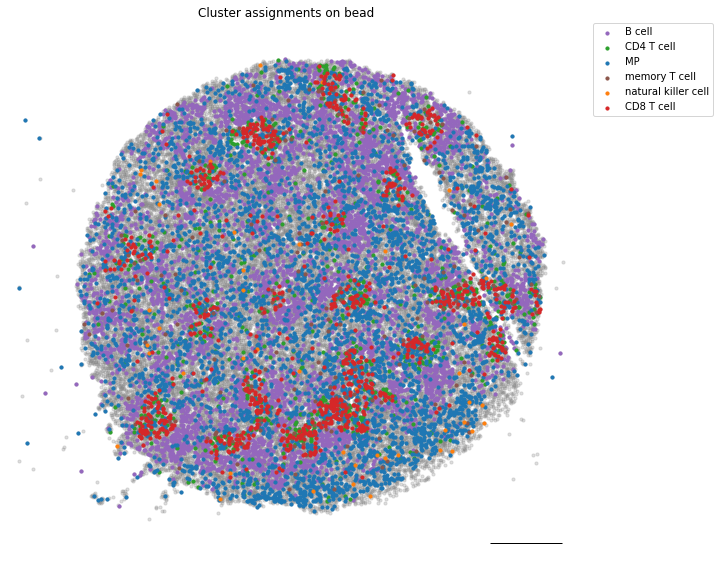

In [10]:
# FIGURE 1C - Plot RCTD

point_size = 10

fig, ax = plt.subplots(figsize=(10, 10))

gray_filt = puckSpleen.s1_dge_fmtd
plt.scatter(
    [puckSpleen.bc_loc_dict_s1[i][0] for i in gray_filt.index],
    [puckSpleen.bc_loc_dict_s1[i][1] for i in gray_filt.index],
    s=point_size,
    alpha=0.25,  # 0.05
    c="gray",
)  # c=list(marco_filt['Marco']),

fn = "./spleen_rctd_clusters_aging.csv"
cluster_labels = pd.read_csv(fn)
cluster_labels["cluster"] = cluster_labels["cell_label"]
cluster_num = len(list(set(cluster_labels.cluster)))

# Merge all macrophage labels
macrophage_dict = {
    "CD8 macrophage": "MP",
    "CD4 macrophage": "MP",
    "activated macrophage": "MP",
}
cluster_labels.cell_label = [
    macrophage_dict[i] if i in macrophage_dict else i
    for i in cluster_labels.cell_label
]
cluster_labels.cluster = [
    macrophage_dict[i] if i in macrophage_dict else i
    for i in cluster_labels.cluster
]

groups = cluster_labels.groupby(
    "cell_label"
)  # can change to translated to visualize by translation or clonotype
cell_type_list = list(set(cluster_labels.cluster))
colors_to_use = [
    sns.color_palette("deep")[idx] for idx in range(len(cell_type_list))
]
colors_to_use_dict = {
    "CD8 T cell": sns.color_palette()[3],
    "natural killer cell": sns.color_palette()[1],
    "MP": sns.color_palette()[0],
    "memory T cell": sns.color_palette()[5],
    "CD4 T cell": sns.color_palette()[2],
    "B cell": sns.color_palette()[4],
}
# plot MP first
for name, group in groups:
    if name == "CD8 T cell":
        continue
    plt.scatter(
        group["x"],
        group["y"],
        s=point_size,
        label=name,
        marker="o",
        alpha=1,
        color=colors_to_use_dict[name],
    )

for name, group in groups:
    if name != "CD8 T cell":
        continue
    plt.scatter(
        group["x"],
        group["y"],
        s=point_size,
        label=name,
        marker="o",
        alpha=1,
        color=colors_to_use_dict[name],
    )

plt.title("Cluster assignments on bead")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)
plt.xlim([0, 6000])
plt.ylim([0, 6000])
plt.axis("off")
fontprops = fm.FontProperties(size=18)
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)

ax.add_artist(scalebar)
plt.show()

# Figure 1E - Capture efficiency of Slide-TCR-seq
- (E) The fraction of beads that capture CDR3 variable sequences (y-axis) when constant UMIs, UMIs corresponding to the constant region of the TCR, are captured (x-axis) for TCRα (left, light blue) and TCRβ (right, dark blue), with the number of corresponding beads along the top axis (weighted average across n=3 replicates, error bars are weighted standard deviation).

------------------ miseq filtered ------------------
TCR beta
6
[0.2582935329805086, 0.44234345939243647, 0.5870113493064313, 0.697339246119734, 0.7855887521968365, 0.8606271777003485, 0.9411764705882353]
TCR alpha
1
[0.6458333333333334, 0.8615384615384616]
------------------ fin ------------------
------------------ miseq filtered ------------------
TCR beta
6
[0.10270270270270271, 0.21246458923512748, 0.3793103448275862, 0.35714285714285715, 0.7777777777777778, 0.5, 0.8]
TCR alpha
1
[0.205607476635514, 0.0]
------------------ fin ------------------
------------------ miseq filtered ------------------
TCR beta
6
[0.5678522362998015, 0.7265711135611908, 0.8442748091603054, 0.8787878787878788, 0.96875, 0.9821428571428571, 1.0]
TCR alpha
1
[0.7630208333333334, 0.9375]
------------------ fin ------------------


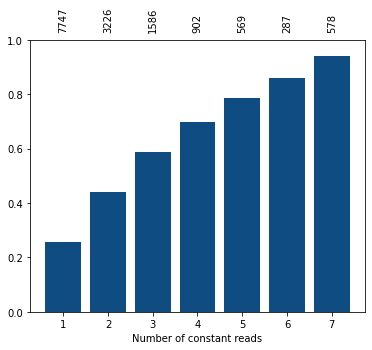

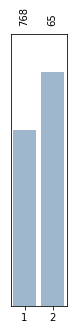

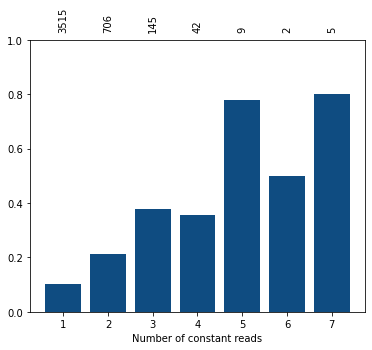

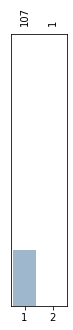

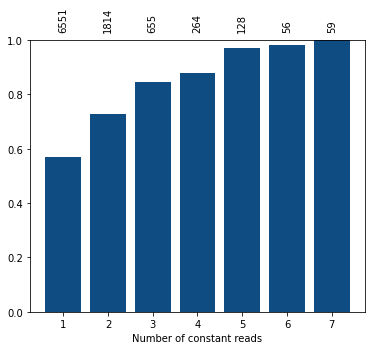

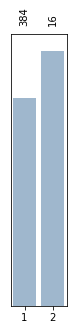

In [11]:
# For each replicate, calculate the capture efficiency

alpha_cutoff = 1
beta_cutoff = 6
updated_labels_alpha = []
frac_fin_alpha = []

updated_labels_beta = []
frac_fin_beta = []

for puck in [puckSpleen, puckSpleen1, puckSpleen2]:
    if puck != puckSpleen:
        puck.matched_bead_barcodes_rev = {
            puck.matched_bead_barcodes[i]: i
            for i in puck.matched_bead_barcodes
        }
    if puck == puckSpleen:
        file_type_used = 'jilong'
    else:
        file_type_used = 'slide-seq-tools'
    #process_nanopore_filtering(puck)
    print('------------------ miseq filtered ------------------')
    print('TCR beta')
    labels, frac_fin = plot_variable_vs_constant(
        puck.s1_dge_fmtd,
        'tcr_b',
        puck.tcr_loc_dict_s1_filtered4,
        puck.loc_to_bc_s1,
        human=False,
        cutoff=beta_cutoff,  # 10
        puck=puck,
        file_type=file_type_used,
        plot_histogram=False,
        save=True,
        nanopore=False,
        nanopore_filt=False)
    updated_labels_beta.append(labels)
    frac_fin_beta.append(frac_fin)

    print('TCR alpha')
    labels, frac_fin = plot_variable_vs_constant(
        puck.s1_dge_fmtd,
        'tcr_a',
        puck.tcr_loc_dict_s1_filtered4,
        puck.loc_to_bc_s1,
        human=False,
        puck=puck,
        cutoff=alpha_cutoff,
        file_type=file_type_used,
        plot_histogram=False,
        save=True,
        nanopore=False,
        nanopore_filt=False)

    updated_labels_alpha.append(labels)
    frac_fin_alpha.append(frac_fin)

    print('------------------ fin ------------------')

In [95]:
# Calculate the weighted mean and standard deviation across all replicates
updated_labels_beta
frac_fin_beta 

frac_fin_alpha_mean = []
frac_fin_beta_mean = []

frac_fin_alpha_std = []
frac_fin_beta_std = []

updated_labels_beta_weighted = []
updated_labels_alpha_weighted = []

for index in range(len(frac_fin_beta[0])):
    weights_to_use = [updated_labels_beta[0][index],updated_labels_beta[1][index],updated_labels_beta[2][index]]
    mean_beta = np.average([frac_fin_beta[0][index],frac_fin_beta[1][index],frac_fin_beta[2][index]], weights=weights_to_use)
    frac_fin_beta_mean.append(mean_beta)
    frac_fin_beta_std.append(DescrStatsW([frac_fin_beta[0][index],frac_fin_beta[1][index],frac_fin_beta[2][index]],weights=weights_to_use,ddof=1).std)
    updated_labels_beta_weighted.append(np.average([updated_labels_beta[0][index],updated_labels_beta[1][index],updated_labels_beta[2][index]], weights=weights_to_use))
    
for index in range(len(frac_fin_alpha[0])):
    weights_to_use = [updated_labels_alpha[0][index],updated_labels_alpha[1][index],updated_labels_alpha[2][index]]
    mean_alpha = np.average([frac_fin_alpha[0][index],frac_fin_alpha[1][index],frac_fin_alpha[2][index]],weights=weights_to_use)
    frac_fin_alpha_mean.append(mean_alpha)
    frac_fin_alpha_std.append(DescrStatsW([frac_fin_alpha[0][index],frac_fin_alpha[1][index],frac_fin_alpha[2][index]],weights=weights_to_use,ddof=1).std)
    updated_labels_alpha_weighted.append(np.average([updated_labels_alpha[0][index],updated_labels_alpha[1][index],updated_labels_alpha[2][index]], weights=weights_to_use))
    
    

6
[0.3414360298658283, 0.5038287504350852, 0.6450125733445097, 0.7251655629139073, 0.8186968838526912, 0.8782608695652174, 0.9454828660436138]


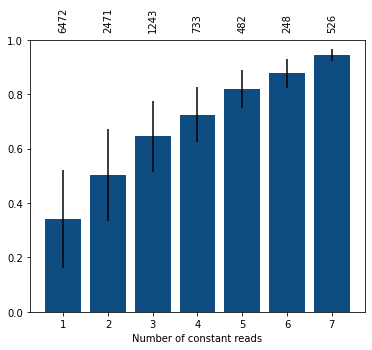

In [96]:
# FIGURE 1E - Make plot with error bars from 3 replicates
tcr_type='tcr_b' # change to 'tcr_a' to calculate TCR alpha
plot_histogram=False
save=True

if tcr_type == "tcr_a":
    color_to_use = "#9FB7CD"
    cutoff=alpha_cutoff
    frac_fin=frac_fin_alpha_mean
    err=frac_fin_alpha_std
    updated_labels=updated_labels_alpha_weighted
if tcr_type == "tcr_b":
    color_to_use = "#0F4C81"
    cutoff=beta_cutoff
    frac_fin=frac_fin_beta_mean
    err=frac_fin_beta_std
    updated_labels=updated_labels_beta_weighted

#Aesthetics
_, ax = plt.subplots(figsize=(cutoff, 5))
print(cutoff)

ax.bar(np.array([i + 1 for i in range(cutoff + 1)]),
       frac_fin, yerr=err,
       color=color_to_use)

plt.ylim([0, 1])
if tcr_type == "tcr_b":
#         plt.yticks([])
    plt.ylabel("")
    plt.xlabel("Number of constant reads")

else:
    plt.ylabel("Fraction")
    plt.ylabel("")
    plt.yticks([])
    plt.xlabel("")
plt.xticks([i + 1 for i in range(cutoff + 1)])
print(frac_fin)

for idx in range(len(updated_labels)):
    ax.text(idx + 1,
            1.03,
            round(updated_labels[idx]),
            ha="center",
            va="bottom",
            rotation="vertical")
plt.ylim([0, 1])
    
if plot_histogram:
    plt.figure(figsize=(cutoff, 1))
    print(updated_labels)
    plt.plot(range(len(updated_labels)), updated_labels)
    plt.axis("off")
if tcr_type == "tcr_b":
    plt.ylabel("")
    plt.xlabel("Number of constant reads")

else:
    plt.ylabel("Fraction")
    plt.ylabel("")
    plt.yticks([])
    plt.xlabel("")
    plt.xticks([i + 1 for i in range(cutoff + 1)])
    
if save == True:
    plt.savefig(f'./plots/{tcr_type}.pdf')

# Figure S1A-B Comparing Nanopore and MiSeq sequencing
- (A) Comparing the number of beads with TCRs detected in Nanopore long-read sequencing and MiSeq short-read sequencing across human renal cell carcinoma and OT-I mouse spleen samples. Barplots indicate means, and error bars indicate the standard deviation of replicates. We hypothesize that the improvement with Nanopore sequencing is in part due to human alpha and beta sequences being longer (\~1300 nt and \~1100 nt) than the mouse OT-I sequences (\~1000 nt), making it slightly harder for the human sequences to cluster on the MiSeq. As the MiSeq has a lower error rate, when the sequences do cluster, mouse TCR sequences sequenced on the MiSeq outperform those sequenced via Nanopore.
- (B) Correlation between the fraction of each TCR in four pucks of renal cell carcinoma when sequenced by Nanopore long-read sequencing and MiSeq short-read sequencing (R=0.81).

In [ ]:
# Load in human renal cell carcinoma samples
puck13 = load_puck(slideseq_name="2022-05-15_Puck_220408_13")
puck14 = load_puck(slideseq_name="2022-05-17_Puck_220408_14")
puck15 = load_puck(slideseq_name="2022-05-17_Puck_220408_15")
puck20 = load_puck(slideseq_name="2022-05-15_Puck_220408_20")


0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

/home/jupyter/packages/ipykernel_launcher.py:122: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


cutoff 6


/home/jupyter/packages/ipykernel_launcher.py:122: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


cutoff 5
cutoff 3


/home/jupyter/packages/ipykernel_launcher.py:122: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.
/home/jupyter/packages/ipykernel_launcher.py:122: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


cutoff 12


AttributeError: 'PuckReplicate' object has no attribute 'nanopore_bcumi_list'

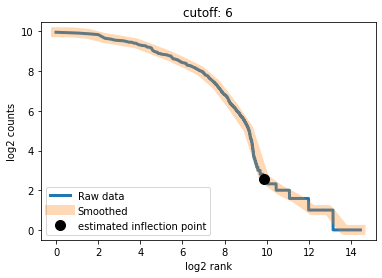

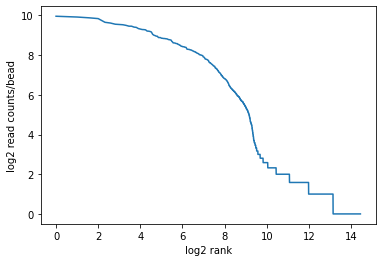

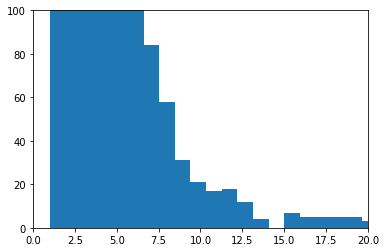

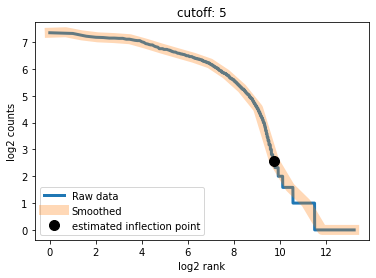

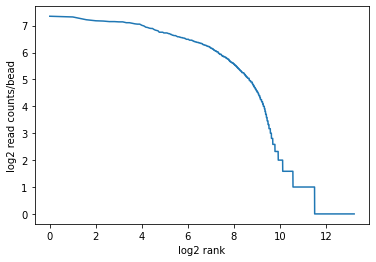

...

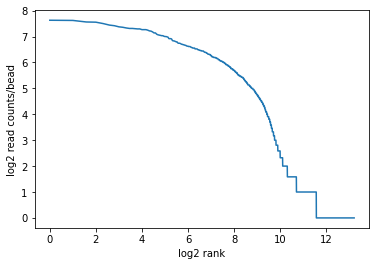

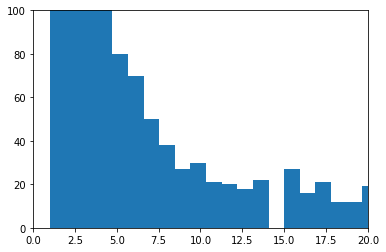

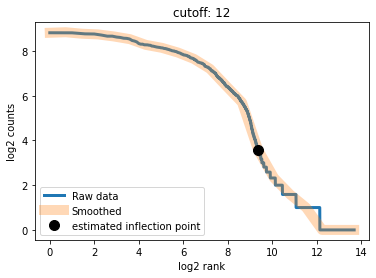

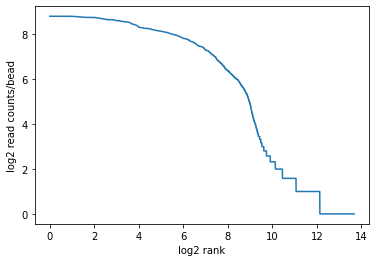

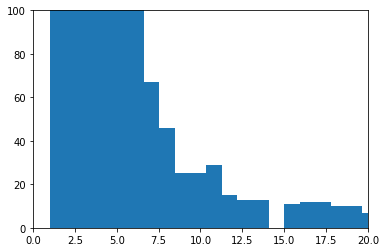

In [114]:
# Add nanopore data to the renal cell carcinoma libraries # run twice
add_nanopore(puck13, "Puck_220408_13_clone_bcumi.csv",
             "Puck_220408_13_clones.txt")
add_nanopore(puck14, "Puck_220408_14_clone_bcumi.csv",
             "Puck_220408_14_clones.txt")
add_nanopore(puck15, "Puck_220408_15_clone_bcumi.csv",
             "Puck_220408_15_clones.txt")
add_nanopore(puck20, "Puck_220408_20_clone_bcumi.csv",
             "Puck_220408_20_clones.txt")

# Process the libraries to identify the filtering cutoff for the TCR sequences
for puck in [puck13, puck14, puck15, puck20, puckSpleen1, puckSpleen2]:
    process_nanopore_filtering(puck)

0it [00:00, ?it/s]

0it [00:00, ?it/s]

/home/jupyter/packages/ipykernel_launcher.py:122: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


cutoff 2


/home/jupyter/packages/ipykernel_launcher.py:122: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


cutoff 30


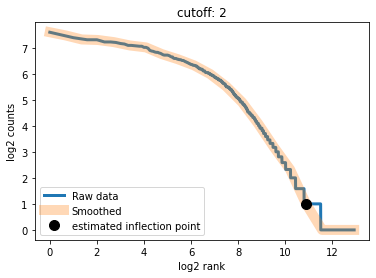

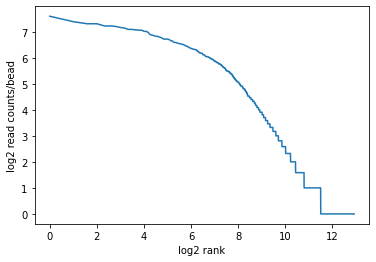

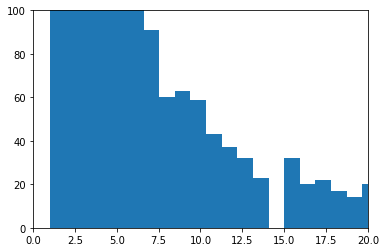

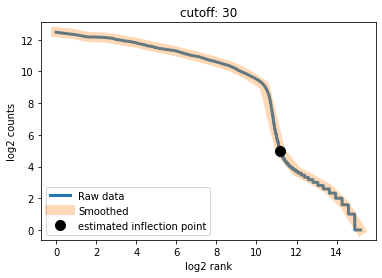

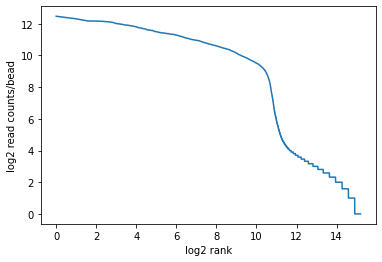

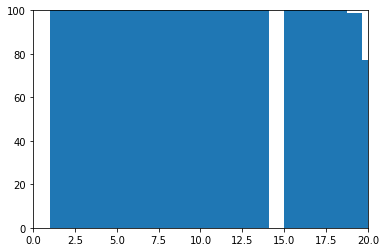

In [141]:
# Add nanopore data to spleen libraries # run twice
add_nanopore(puckSpleen1,"Puck_211105_07_NanoporeTCR_BC_UMI_reads.csv","211105_07_NanoporeTCR_clones.csv",csv=True)
add_nanopore(puckSpleen2,"Puck_220420_17_clone_bcumi.csv","Puck_220420_17_clones.txt")

process_nanopore_filtering(puckSpleen1)
process_nanopore_filtering(puckSpleen2)

np 2890 miseq 2366


  0%|          | 0/14 [00:00<?, ?it/s]

INFLECTION
cutoff 2


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


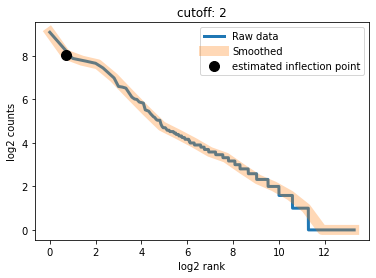

np 2394 miseq 4964


  0%|          | 0/26 [00:00<?, ?it/s]

INFLECTION
cutoff 49


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


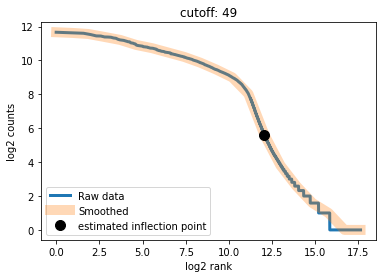

np 1056 miseq 266


  0%|          | 0/56 [00:00<?, ?it/s]

INFLECTION
cutoff 3


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


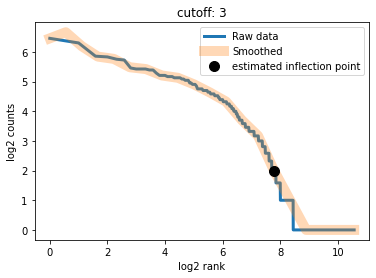

np 969 miseq 271


  0%|          | 0/35 [00:00<?, ?it/s]

INFLECTION
cutoff 2


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


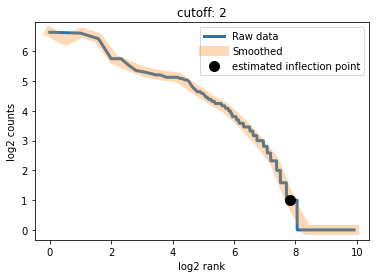

np 1665 miseq 1201


  0%|          | 0/742 [00:00<?, ?it/s]

INFLECTION
cutoff 4


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


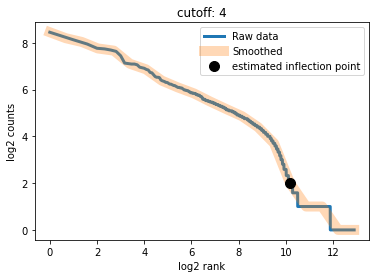

np 660 miseq 943


  0%|          | 0/807 [00:00<?, ?it/s]

INFLECTION
cutoff 9


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


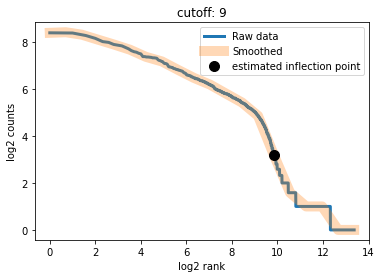

Ttest_relResult(statistic=-0.11972796468531954, pvalue=0.9093606375177485)

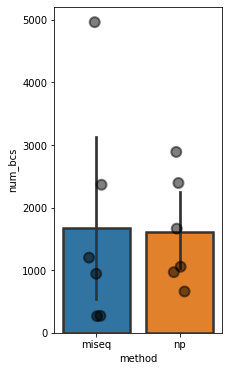

In [142]:
# SUPPLEMENTARY FIGURE 1A - ALL SAMPLES 
miseq_bcs_all = []
nanopore_bcs_all = []
for puck in [puckSpleen1, puckSpleen2, puck13, puck14, puck15, puck20]:
    x, y = process_miseq_filtering(puck)
    miseq_bcs_all.append(x)
    nanopore_bcs_all.append(y)

# Make plot
plot_dict = {
    'method': ['miseq'] * len(miseq_bcs_all) + ['np'] * len(nanopore_bcs_all),
    'num_bcs': miseq_bcs_all + nanopore_bcs_all
}
plt.figure(figsize=(3, 6))
plot_df = pd.DataFrame.from_dict(plot_dict)
ax = sns.barplot(x='method',
                 y='num_bcs',
                 data=plot_df,
                 alpha=1,
                 linewidth=2.5,
                 edgecolor='.2',
                 errcolor='0.2')

sns.stripplot(x='method',
              y='num_bcs',
              data=plot_df,
              dodge=True,
              jitter=True,
              color='black',
              alpha=0.5,
              ax=ax,
              s=10,
              edgecolor='black',
              linewidth=2)
scipy.stats.ttest_rel(nanopore_bcs_all, miseq_bcs_all)
#plt.savefig(f'./plots/nano_miseq_bar_plot_mouse.pdf')

np 2890 miseq 2366


  0%|          | 0/14 [00:00<?, ?it/s]

INFLECTION
cutoff 2


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


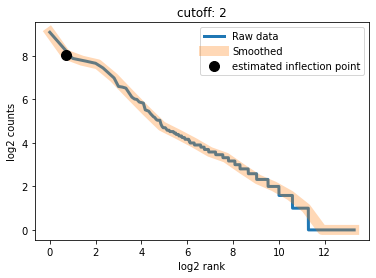

np 2394 miseq 4964


  0%|          | 0/26 [00:00<?, ?it/s]

INFLECTION
cutoff 49


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


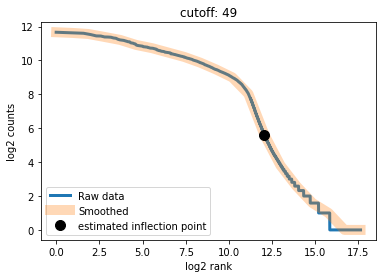

Ttest_relResult(statistic=-0.6612798965740142, pvalue=0.6280459702375722)

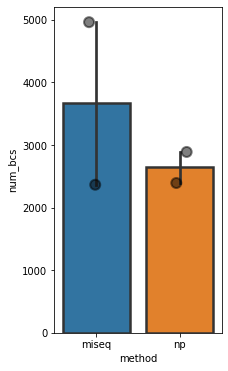

In [143]:
# SUPPLEMENTARY FIGURE 1A - MOUSE
miseq_bcs_all = []
nanopore_bcs_all = []
for puck in [puckSpleen1, puckSpleen2]:
    x, y = process_miseq_filtering(puck)
    miseq_bcs_all.append(x)
    nanopore_bcs_all.append(y)

# Make plot
plot_dict = {
    'method': ['miseq'] * len(miseq_bcs_all) + ['np'] * len(nanopore_bcs_all),
    'num_bcs': miseq_bcs_all + nanopore_bcs_all
}
plt.figure(figsize=(3, 6))
plot_df = pd.DataFrame.from_dict(plot_dict)
ax = sns.barplot(x='method',
                 y='num_bcs',
                 data=plot_df,
                 alpha=1,
                 linewidth=2.5,
                 edgecolor='.2',
                 errcolor='0.2')

sns.stripplot(x='method',
              y='num_bcs',
              data=plot_df,
              dodge=True,
              jitter=True,
              color='black',
              alpha=0.5,
              ax=ax,
              s=10,
              edgecolor='black',
              linewidth=2)
scipy.stats.ttest_rel(nanopore_bcs_all, miseq_bcs_all)
#plt.savefig(f'./plots/nano_miseq_bar_plot_mouse.pdf')

np 1056 miseq 266


  0%|          | 0/56 [00:00<?, ?it/s]

INFLECTION
cutoff 3


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


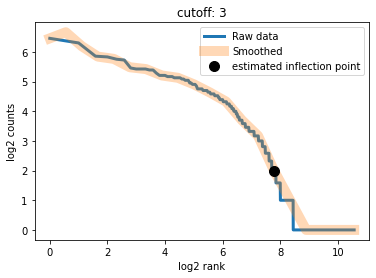

np 969 miseq 271


  0%|          | 0/35 [00:00<?, ?it/s]

INFLECTION
cutoff 2


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


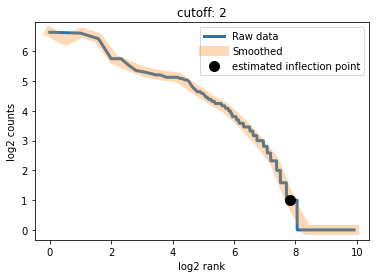

np 1665 miseq 1201


  0%|          | 0/742 [00:00<?, ?it/s]

INFLECTION
cutoff 4


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


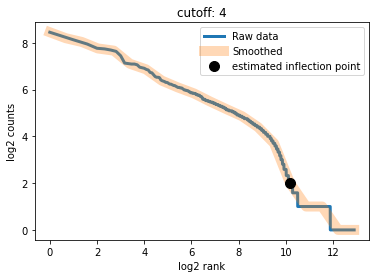

np 660 miseq 943


  0%|          | 0/807 [00:00<?, ?it/s]

INFLECTION
cutoff 9


/home/jupyter/packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in log2
/home/jupyter/packages/ipykernel_launcher.py:159: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "or" (-> color='r'). The keyword argument will take precedence.


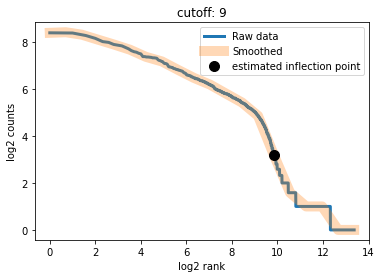

Ttest_relResult(statistic=1.7150091568137773, pvalue=0.18485298246938558)

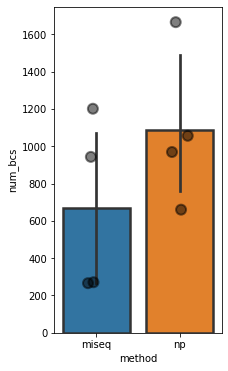

In [144]:
# SUPPLEMENTARY FIGURE 1A - HUMAN
miseq_bcs_all = []
nanopore_bcs_all = []
for puck in [puck13, puck14, puck15, puck20]:
    x, y = process_miseq_filtering(puck)
    miseq_bcs_all.append(x)
    nanopore_bcs_all.append(y)

# Make plot
plot_dict = {
    'method': ['miseq'] * len(miseq_bcs_all) + ['np'] * len(nanopore_bcs_all),
    'num_bcs': miseq_bcs_all + nanopore_bcs_all
}
plt.figure(figsize=(3, 6))
plot_df = pd.DataFrame.from_dict(plot_dict)
ax = sns.barplot(x='method',
                 y='num_bcs',
                 data=plot_df,
                 alpha=1,
                 linewidth=2.5,
                 edgecolor='.2',
                 errcolor='0.2')

sns.stripplot(x='method',
              y='num_bcs',
              data=plot_df,
              dodge=True,
              jitter=True,
              color='black',
              alpha=0.5,
              ax=ax,
              s=10,
              edgecolor='black',
              linewidth=2)
scipy.stats.ttest_rel(nanopore_bcs_all, miseq_bcs_all)
#plt.savefig(f'./plots/nano_miseq_bar_plot_mouse.pdf')

(0.81214590363382, 5.1980822896745707e-23)


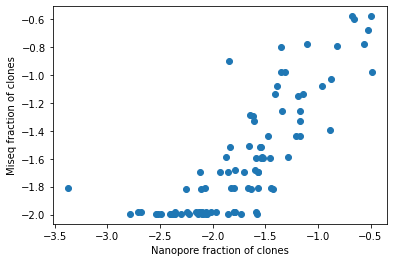

In [145]:
# SUPPLMENETARY FIGURE 1B
np_num_beads_per_clone = []
miseq_num_beads_per_clone = []

for puck in [puck13, puck14, puck15, puck20]:
    np_num_beads_to_add = []
    miseq_num_beads_to_add = []

    miseq_dict = make_custom_filtered_bcumis(puck, cutoff=15, umi=False)
    for tcr in miseq_dict:
        if tcr not in puck.clonotypes['1b']:
            continue
        if len(set(
                miseq_dict[tcr])) < 2:  # remove tcrs with fewer than 2 beads
            continue
        if tcr not in puck.nanopore_tcr_bcumi_filt:
            continue
        if len(set([i[0] for i in puck.nanopore_tcr_bcumi_filt[tcr]
                    ])) < 2:  # remove tcrswith fewer than 5 beads
            continue

        else:
            np_bcs = [i[0] for i in puck.nanopore_tcr_bcumi_filt[tcr]]
            np_num_beads_to_add.append(len(np_bcs))

            miseq_bcs = len(set(miseq_dict[tcr]))
            miseq_num_beads_to_add.append(miseq_bcs)
    np_num_beads_to_add = [
        i / sum(np_num_beads_to_add) for i in np_num_beads_to_add
    ]
    miseq_num_beads_to_add = [
        i / sum(miseq_num_beads_to_add) for i in miseq_num_beads_to_add
    ]

    np_num_beads_per_clone = np_num_beads_per_clone + np_num_beads_to_add
    miseq_num_beads_per_clone = miseq_num_beads_per_clone + miseq_num_beads_to_add

x = np.log10(np_num_beads_per_clone)
y = np.log10(miseq_num_beads_per_clone)
plt.xlabel('Nanopore fraction of clones')
plt.ylabel('Miseq fraction of clones')
plt.scatter(x, y)
# plt.xlim(left=0)
# plt.ylim(bottom=0)
print(scipy.stats.pearsonr(x, y))
#plt.savefig(f'./plots/nano_miseq_corr.pdf')

# Figure S1C-D Mouse spleen cell types
- (C) RCTD-assigned cell types for spleen plotted individually from the same array.  
- (D) Frequency of cell-type assignments as identified by RCTD. 

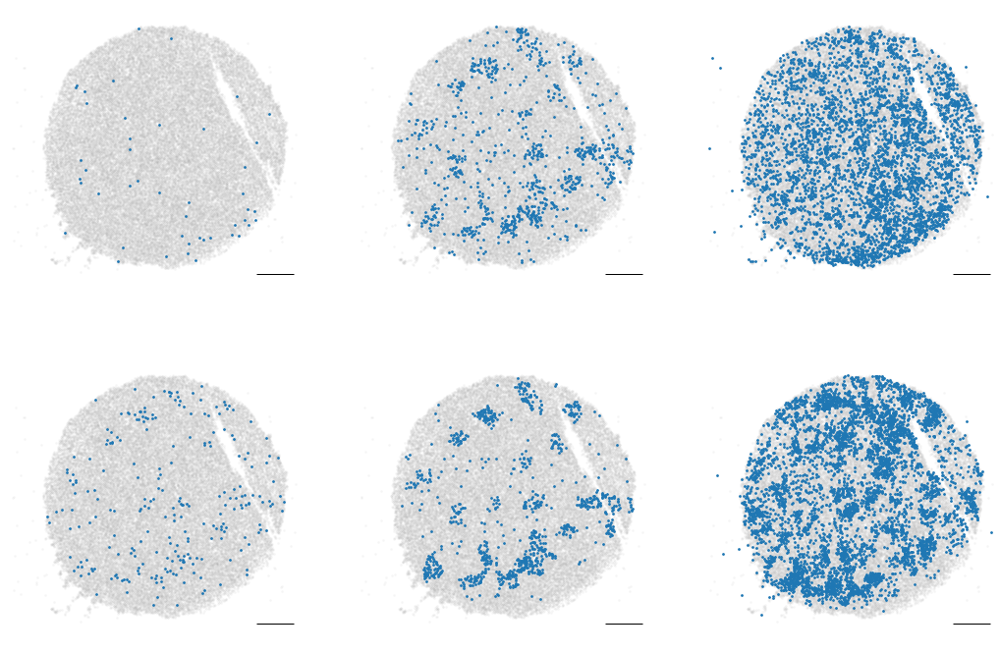

In [146]:
# FIGURE S1C

fig, ax = plt.subplots(2, 3, figsize=(9 * 2, 6 * 2))

gray_filt = puckSpleen.s1_dge_fmtd
gray_filt_x = [puckSpleen.bc_loc_dict_s1[i][0] for i in gray_filt.index]
gray_filt_y = [puckSpleen.bc_loc_dict_s1[i][1] for i in gray_filt.index]

for idx in range(len(cell_type_list)):
    c = cell_type_list[idx]
    x = cluster_labels[cluster_labels.cluster == c].x
    y = cluster_labels[cluster_labels.cluster == c].y
    ax[math.floor(idx / 3), idx % 3].scatter(gray_filt_x,
                                             gray_filt_y,
                                             s=3,
                                             alpha=0.05,
                                             c='gray')
    ax[math.floor(idx / 3), idx % 3].scatter(x, y, s=3)
    ax[math.floor(idx / 3), idx % 3].axis('off')
    ax[math.floor(idx / 3), idx % 3].set_xlim([0, 6000])
    ax[math.floor(idx / 3), idx % 3].set_ylim([0, 6000])

    ######
    fontprops = fm.FontProperties(size=18)
    scalebar = AnchoredSizeBar(ax[math.floor(idx / 3), idx % 3].transData,
                               pixels_needed,
                               '',
                               'lower right',
                               pad=0.1,
                               color='black',
                               frameon=False,
                               size_vertical=1,
                               fontproperties=fontprops)

    ax[math.floor(idx / 3), idx % 3].add_artist(scalebar)
plt.axis('off')
plt.show()

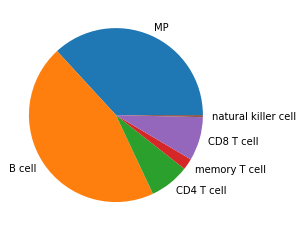

In [147]:
# FIGURE S1D

plt.rcParams.update({'font.size': 10})
cter = Counter(cluster_labels.cell_label)
cell_type = list(cter.keys())
counts = list(cter.values())

#Using matplotlib
plot = plt.pie(counts, labels=cell_type)

# Figure 1D - Gene expression gaussian-filtered heatmap for visualizing the spatial distribution of gene markers
- (D) Gene expression (in UMI counts) gaussian-filtered heatmap for visualizing the spatial distribution of gene markers for marginal zone (Marco), red blood cells (RBCs; Gypa), and CD8 T cells (Cd8a).

real life size: 91.23825


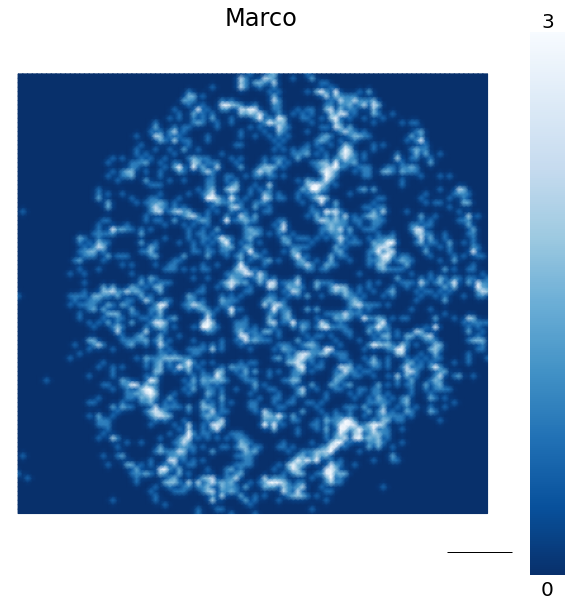

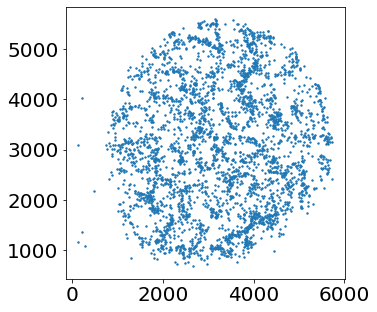

real life size: 85.84584999999998


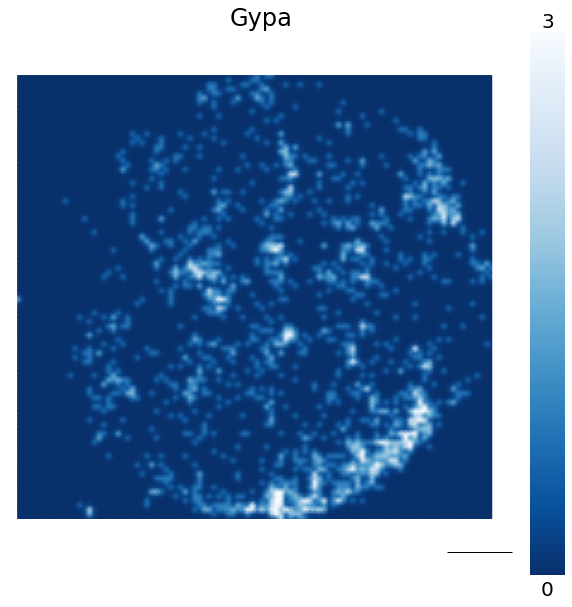

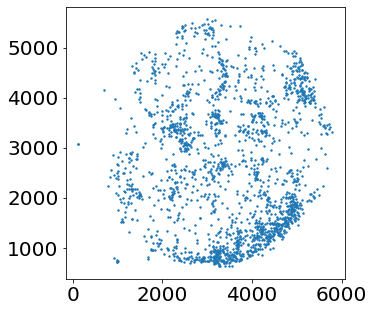

real life size: 91.24085


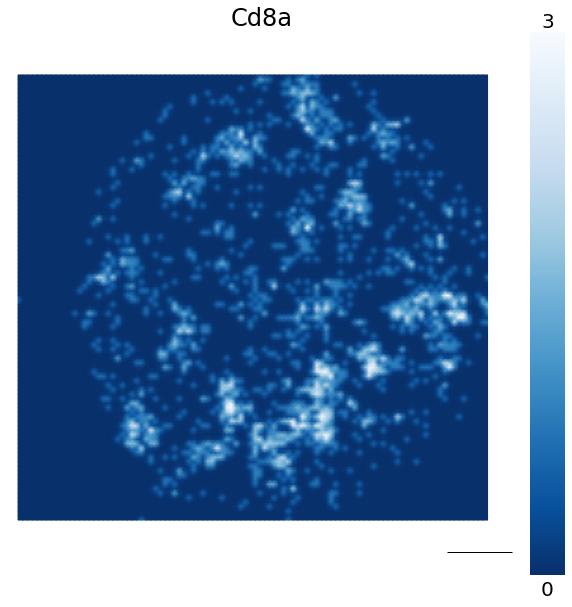

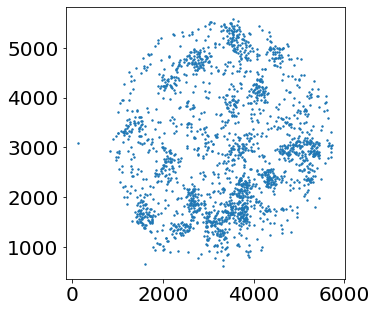

In [160]:
plt.rcParams.update({'font.size': 20})
color_map = plt.cm.get_cmap('Blues')
reversed_color_map = color_map.reversed()

nbins = 100

for gene in ['Marco', 'Gypa', 'Cd8a']:
    gene_filt = puckSpleen.s1_dge_fmtd[puckSpleen.s1_dge_fmtd[gene] > 0]
    x = [puckSpleen.bc_loc_dict_s1[i][0] for i in gene_filt.index]
    y = [puckSpleen.bc_loc_dict_s1[i][1] for i in gene_filt.index]
    gaussian_heat_plot(x, y, 0, 3, title=True, title_text=gene)
    # make non-filtered plot
    plt.figure(figsize=(5,5))
    plt.scatter(x,y,s=2)
    plt.show()

# Figure 1F and 1G - TCR constant and variable heatmaps
- (F-G) Comparing the spatial distribution of constant (left) and variable (right) sequences for TCRα (F) and TCRβ (G) with superimposed density plot.

real life size: 84.77595
real life size: 84.77595
real life size: 169.1837
Beta
real life size: 85.08534999999999


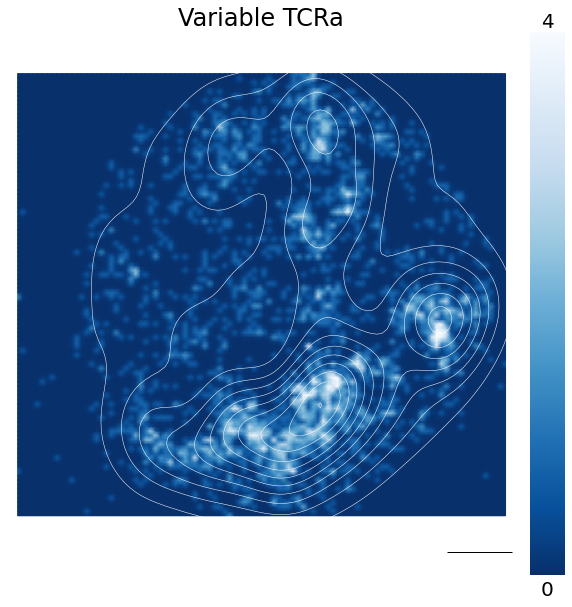

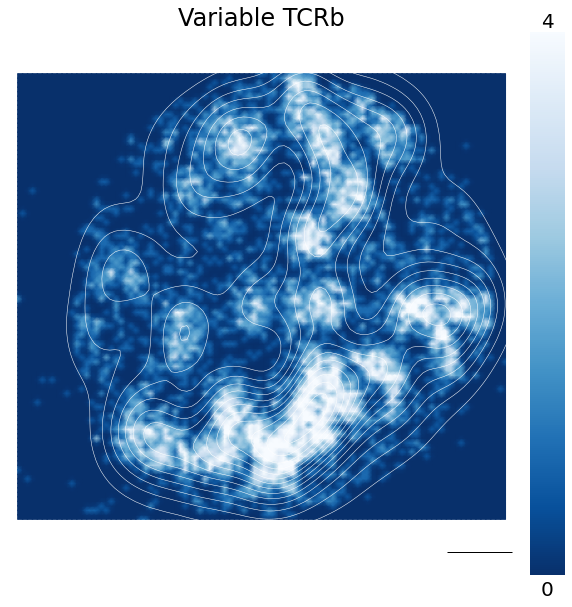

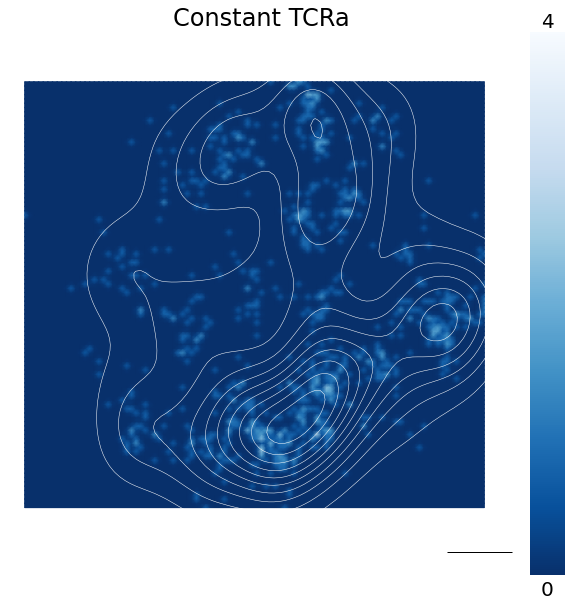

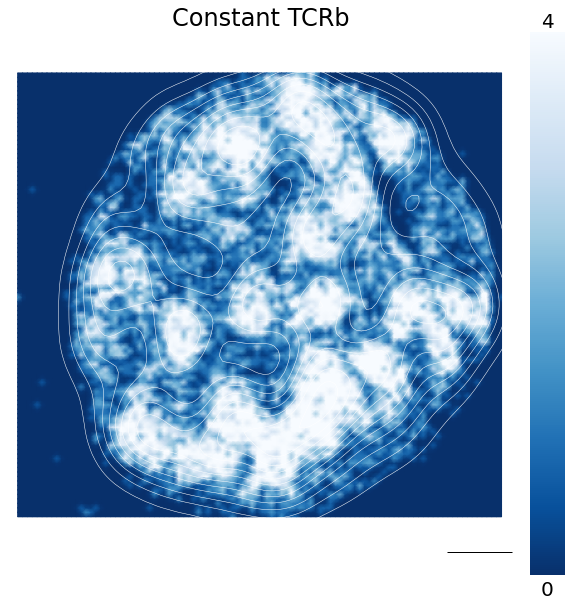

In [161]:
# Contour plot with gaussian smoothing
# Plot kdeplot on for Human or Spleen
# plot for figure
puck = puckSpleen
vmin_val = 0
vmax_val_alpha = 4
vmax_val_beta = 4

species = 'mouse'
if species == 'mouse':
    tcra_gene_name = 'Trac'
    tcrb_gene_name = 'Trbc2'
else:
    tcra_gene_name = 'Trac'
    tcrb_gene_name = 'Trbc2'

tcr_locs = list(set(list(sum(puck.tcr_loc_dict_s1_filtered4.values(),
                             []))))  # variable locations

tcr_locs_alpha = []  # variable locations
tcr_locs_beta = []
for tcr in puck.tcr_loc_dict_s1_filtered4:
    if tcr in puck.clonotypes['1a']:
        tcr_locs_alpha = tcr_locs_alpha + list(
            set(puck.tcr_loc_dict_s1_filtered4[tcr]))
    else:
        tcr_locs_beta = tcr_locs_beta + list(
            set(puck.tcr_loc_dict_s1_filtered4[tcr]))

color_map = plt.cm.get_cmap('Blues')
reversed_color_map = color_map.reversed()

point_size = 20
pixels_needed = 500 / 0.65

gaussian_heat_plot([float(i[0]) for i in tcr_locs_alpha],
                   [float(i[1]) for i in tcr_locs_alpha],
                   vmin_val,
                   vmax_val_alpha,
                   plot_contour=True,
                   title=True,
                   title_text='Variable TCRa')
plt.savefig('./plots/variable_tcra_1a.pdf')
gaussian_heat_plot([float(i[0]) for i in tcr_locs_beta],
                   [float(i[1]) for i in tcr_locs_beta],
                   vmin_val,
                   vmax_val_beta,
                   plot_contour=True,
                   title=True,
                   title_text='Variable TCRb')
plt.savefig('./plots/variable_tcra_1b.pdf')
gene_filt = puck.s1_dge_fmtd[puck.s1_dge_fmtd[tcra_gene_name] > 0]
x = [puck.bc_loc_dict_s1[i][0] for i in gene_filt.index]
y = [puck.bc_loc_dict_s1[i][1] for i in gene_filt.index]
gaussian_heat_plot(x,
                   y,
                   vmin_val,
                   vmax_val_alpha,
                   plot_contour=True,
                   title=True,
                   title_text='Constant TCRa')

print('Beta')

gene_filt = puck.s1_dge_fmtd[puck.s1_dge_fmtd[tcrb_gene_name] > 0]
x = [puck.bc_loc_dict_s1[i][0] for i in gene_filt.index]
y = [puck.bc_loc_dict_s1[i][1] for i in gene_filt.index]
gaussian_heat_plot(x,
                   y,
                   vmin_val,
                   vmax_val_beta,
                   plot_contour=True,
                   title=True,
                   title_text='Constant TCRb')

# Figure S1E and Table S4 Frequency of TCR constant and variable
- Frequency of TCR constant and variable sequences detected on the same bead.
- OT-I sequences.

0.4169655905407201 fraction of constant that also have variable 
0.28686662122244944 new to constant


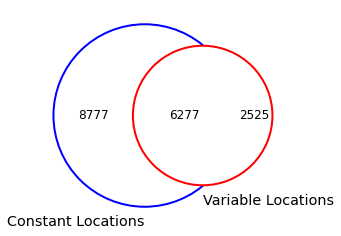

In [11]:
# Figure S1E
plt.rcParams.update({'font.size': 12})
constant_locs = []
variable_locs = []
constant_locs = [
    puckSpleen.bc_loc_dict_s1[i]
    for i in puckSpleen.s1_dge_fmtd[(puckSpleen.s1_dge_fmtd['Trac'] > 0) | (
        puckSpleen.s1_dge_fmtd['Trbc2'] > 0)].index
]
for tcr in puckSpleen.tcr_loc_dict_s1_filtered4:
    variable_locs = variable_locs + \
    puckSpleen.tcr_loc_dict_s1_filtered4[tcr]

constant_locs = set(constant_locs)
variable_locs = set(variable_locs)

shared_locs = set(list(constant_locs & variable_locs))
print(
    len(shared_locs) / len(constant_locs),
    'fraction of constant that also have variable ')
print(
    len([i
         for i in variable_locs if i not in shared_locs]) / len(variable_locs),
    'new to constant')

#####
set1 = constant_locs
set2 = variable_locs

v = venn2([set1, set2], ('Constant Locations', 'Variable Locations'))
c = venn2_circles([set1, set2])
c[0].set_color("white")
c[0].set_ls('solid')
c[0].set_edgecolor('blue')

c[1].set_color("white")
c[1].set_ls('solid')
c[1].set_edgecolor('red')
plt.show()

In [167]:
# Supplementary Figure 2b
locs_all_a = []
locs_all_b = []
for cl in puckSpleen.tcr_loc_dict_s1_filtered4:
    if cl in puckSpleen.clonotypes["1a"]:
        locs_all_a = locs_all_a + puckSpleen.tcr_loc_dict_s1_filtered4[cl]
    elif cl in puckSpleen.clonotypes["1b"]:
        locs_all_b = locs_all_b + puckSpleen.tcr_loc_dict_s1_filtered4[cl]
        print(cl)
locs_all_a = set(locs_all_a)
locs_all_b = set(locs_all_b)

# Circos plot
df_use = puckSpleen.df_s1_filtered4

all_bc = list(puckSpleen.s1_dge_fmtd.index)
bc_s1_tcrb = set([i for i in find_specific_barcodes("tcr_b", df_use) if i in all_bc])
bc_s1_tcra = set([i for i in find_specific_barcodes("tcr_a", df_use) if i in all_bc])
paired_bcs = list(set(bc_s1_tcrb) & set(bc_s1_tcra))
paired_df = puckSpleen.df_s1_filtered4[
    (df_use.tcr_a.map(len) > 0) & (df_use.tcr_b.map(len) > 0)
]


circos_plot_df = paired_df.copy(deep=True)
circos_plot_df["tcr_a"] = paired_df.tcr_a
circos_plot_df["tcr_b"] = paired_df.tcr_b

tcr_a_hamming = []
tcr_b_hamming = []
for i in circos_plot_df["tcr_a"]:
    i = ast.literal_eval(i)
    this_list = []
    for j in i:
        this_list.append(j)
    tcr_a_hamming.append(this_list)

for i in circos_plot_df["tcr_b"]:
    i = ast.literal_eval(i)
    this_list = []
    for j in i:
        this_list.append(j)
    tcr_b_hamming.append(list(set(this_list)))

circos_plot_df["tcr_a_hamming"] = tcr_a_hamming
circos_plot_df["tcr_b_hamming"] = tcr_b_hamming

# SUPPLEMENTARY TABLE 4 IS CIRCOS_PLOT_DF

tcr_bc_counter_dict = {}  # A dictionary for counting (tcr,bc) pairs
for cl in puckSpleen.tcr_loc_dict_s1_filtered4:
    cl_name = cl
    for loc in puckSpleen.tcr_loc_dict_s1_filtered4[cl_name]:
        bc = puckSpleen.loc_to_bc_s1[loc]
        if (cl, bc) not in tcr_bc_counter_dict:
            tcr_bc_counter_dict[(cl_name, bc)] = 0
        tcr_bc_counter_dict[tuple((cl_name, bc))] += 1

circos_bcs = list(circos_plot_df["bead_barcodes"])
circos_a = list(circos_plot_df["tcr_a_hamming"])
circos_b = list(circos_plot_df["tcr_b_hamming"])
circos_plot_df["tcr_a_top"] = [
    find_highest_expressing_clonotype(circos_bcs[idx], circos_a[idx])
    for idx in range(len(circos_plot_df))
]
circos_plot_df["tcr_b_top"] = [
    find_highest_expressing_clonotype(circos_bcs[idx], circos_b[idx])
    for idx in range(len(circos_plot_df))
]

# circos_plot_df['tcr_a_hamming'].apply(pd.Series).reset_index().melt(id_vars='index').dropna()[['index', 'value']].set_index('index')
circos_plot_df = (
    circos_plot_df.groupby(by=["tcr_a_top", "tcr_b_top"])
    .count()[["bead_barcodes"]]
    .rename(columns={"bead_barcodes": "Count"})
    .reset_index()
)
circos_plot_df

CASSRANYEQYF
RASSRATYEQYF
CASSI_EQYF
CASRQQDTQYF
CASRADYEQYF
7459
2754


,tcr_a_top,tcr_b_top,Count
0,,CASRQQDTQYF,1
1,,CASSRANYEQYF,6047
2,CAALNYNQGKLIF,,1
3,CAALNYNQGKLIF,CASSRANYEQYF,1
4,CAASDNYQLIW,,1322
5,CAASDNYQLIW,CASSRANYEQYF,1393
6,CAASRRDKT_NTGYQNFYF,,1
7,CALEGFITGNTGKLIF,,5
8,CALEGFITGNTGKLIF,CASSRANYEQYF,4
9,CALEQN**_KLAFFFF,CASSRANYEQYF,1


# Figure S1F-G QC for TCRs in Slide-TCR-seq
- (F) Spatial heatmap of beads with at least one read of Trac or Trbc2 constant sequence (bin size = 50 pixels or 32.5 µm).
- (G) Spatial heatmap of beads with at least one read of CDR3 variable sequence after computational filtering (bin size = 50 pixels or 32.5 µm).

LinregressResult(slope=0.6261382978728687, intercept=-0.24955437447126627, rvalue=0.8574039892742429, pvalue=0.0, stderr=0.007519611897687189, intercept_stderr=0.06506233115756724)


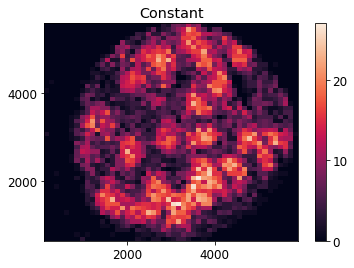

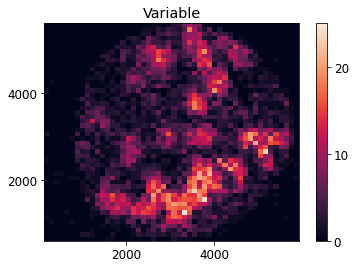

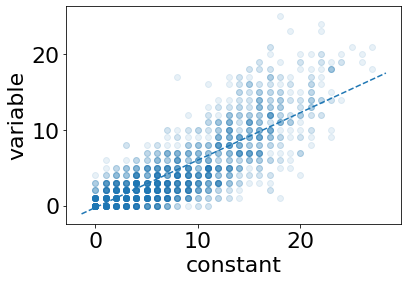

In [168]:
# Find beads with constant Alpha or Beta sequence

puck = puckSpleen
constant_seq_present = puck.s1_dge_fmtd[(puck.s1_dge_fmtd['Trac'] > 0) |
                                        (puck.s1_dge_fmtd['Trbc2'] > 0)]
constant_seq_present_bcs = []
for bc in constant_seq_present.index:
    constant_seq_present_bcs = constant_seq_present_bcs + [bc]

# Find beads with variable Alpha or Beta sequence
variable_seq_present = []
for tcr in puck.tcr_loc_dict_s1_filtered4:
    for loc in set(puck.tcr_loc_dict_s1_filtered4[tcr]):
        variable_seq_present.append(loc)
variable_seq_present = list(set(variable_seq_present))

cmap_to_use = sns.color_palette("rocket", as_cmap=True)
## Constant
x = [i[0] for i in [puck.bc_loc_dict_s1[i] for i in constant_seq_present_bcs]]
y = [i[1] for i in [puck.bc_loc_dict_s1[i] for i in constant_seq_present_bcs]]
heatmap_constant, xedges, yedges = np.histogram2d(x, y, bins=50)
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]

plt.figure()
plt.imshow(heatmap_constant.T, extent=extent, cmap=cmap_to_use, origin='lower')
plt.colorbar()
plt.grid(False)
plt.title('Constant')
plt.savefig('./plots/sf2b.pdf')

## Variable
x_var = [i[0] for i in variable_seq_present]
y_var = [i[1] for i in variable_seq_present]
heatmap_variable, xedges, yedges = np.histogram2d(x_var, y_var, bins=50)
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]

plt.figure()
plt.imshow(heatmap_variable.T, extent=extent, cmap=cmap_to_use, origin='lower')
plt.colorbar()
plt.grid(False)
plt.title('Variable')
plt.savefig('./plots/sf2c.pdf')

## Plot correlation between the two
plt.rcParams.update({'font.size': 22})

x = heatmap_constant.reshape(-1)
y = heatmap_variable.reshape(-1)

plt.figure()
plt.scatter(x, y, alpha=0.1)
abline(scipy.stats.linregress(x, y)[0], scipy.stats.linregress(x, y)[1])
print(scipy.stats.linregress(x, y))
plt.grid(False)
plt.xlabel('constant')
plt.ylabel('variable')
plt.savefig('./plots/sf2d.pdf')

# Figures 2A, S1C RCTD plot of human reactive lymph node
- (A) Spatial reconstruction of Slide-TCR-seq array of a 10 µm section of human reactive lymph node, LN1, with RCTD cell type assignment. Cell types are plotted individually in Supplementary Figure 3A.
- (C) RCTD-assigned cell types and hematoxylin and eosin stain for RCC plotted individually from the array in Figure 2A. During the initial indexing step for this puck, a section of beads was not imaged, resulting in a cutoff final shape.

In [9]:
#Load pucks here
load_all_pucks = True
load_all_adata = True

if load_all_pucks:
    puck_ln27 = load_puck(slideseq_name = '2021-09-01_Puck_210720_27_submit')
    puck_ln28 = load_puck(slideseq_name = '2021-09-01_Puck_210720_28_submit')
    puck_ln29 = load_puck(slideseq_name = '2021-09-02_Puck_210720_29')
    puck_ln11 = load_puck(slideseq_name = '2021-09-01_Puck_210731_11_submit')
    puck_ln12 = load_puck(slideseq_name = '2021-09-01_Puck_210731_12_submit')
    puck_ln13 = load_puck(slideseq_name = '2021-09-01_Puck_210731_13_submit')
    puck_ln5 = load_puck(slideseq_name = '2020-12-12_Puck_201014_05')
    puck_ln6 = load_puck(slideseq_name = '2020-12-12_Puck_201014_06')
    puck_ton21 = load_puck(slideseq_name = '2021-04-13_Puck_210119_21')
    puck_ton22 = load_puck(slideseq_name = '2021-04-13_Puck_210119_22')

if load_all_adata:
    adata_ln12 = load_adata(slideseq_name = '2021-09-01_Puck_210731_12_submit') 
    adata_ln13 = load_adata(slideseq_name = '2021-09-01_Puck_210731_13_submit') 
    adata_ln5 = load_adata(slideseq_name = '2020-12-12_Puck_201014_05')
    adata_ln6 = load_adata(slideseq_name = '2020-12-12_Puck_201014_06')
    adata_ton21 = load_adata(slideseq_name = '2021-04-13_Puck_210119_21')
    adata_ton22 = load_adata(slideseq_name = '2021-04-13_Puck_210119_22')

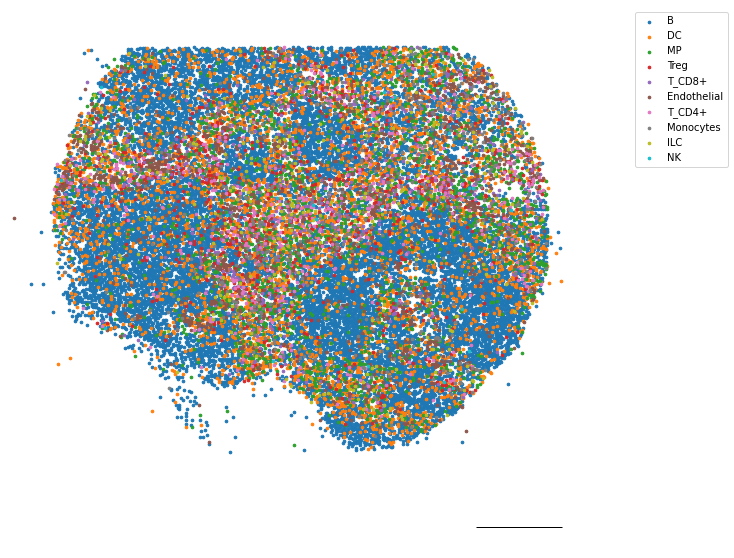

In [10]:
puck = puck_ln6
lymph_rctd = pd.read_csv('lymph_rctd.csv')
fontprops = fm.FontProperties(size=18)

cellType = lymph_rctd.first_type
cellTypeNames = Counter(cellType).keys()
cellLocX = lymph_rctd.xcoord
cellLocY = lymph_rctd.ycoord

fig,ax = plt.subplots(figsize=(10,10))
# Plot all beads in gray

for t in cellTypeNames:
    idx = [i for i,val in enumerate(cellType) if val == t]
    cellLocX_cl = [cellLocX[i] for i in idx]
    cellLocY_cl = [cellLocY[i] for i in idx]
    plt.scatter(cellLocX_cl,cellLocY_cl,s=7,label=t)
    plt.xlim([0,5000])
    plt.ylim([0,5000])
plt.legend(bbox_to_anchor=(1.3, 1))
plt.axis('off')

scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )

ax.add_artist(scalebar)

fig.canvas.draw()
    

['T_CD4+', 'Treg', 'ILC', 'DC', 'Endothelial', 'T_CD8+', 'Monocytes', 'MP', 'NK', 'B']


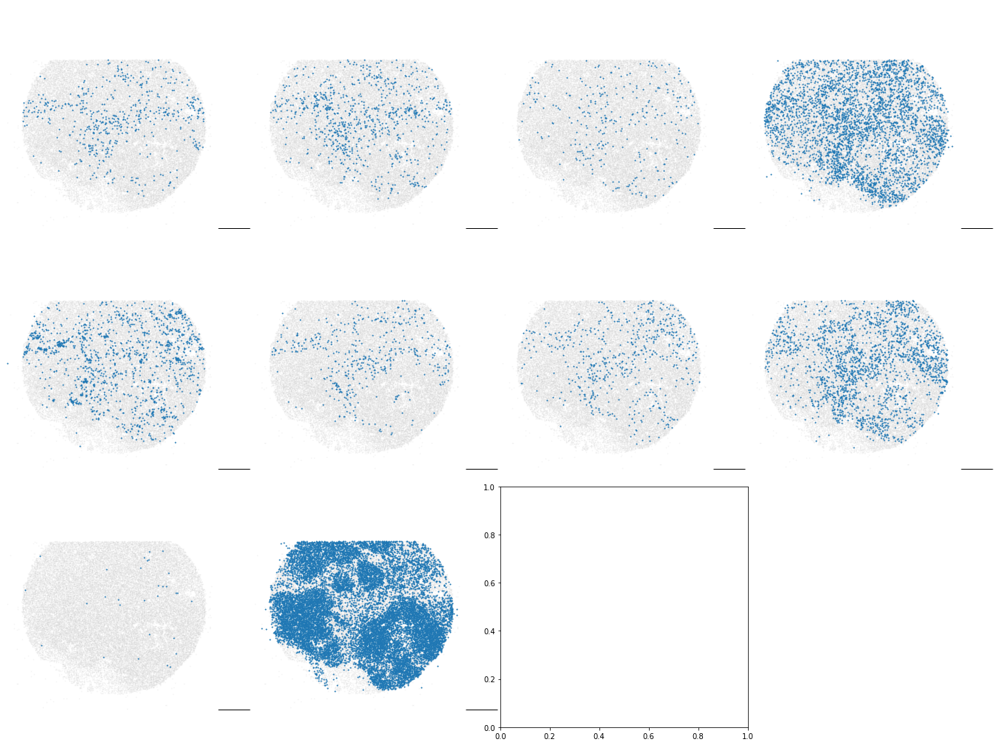

In [11]:
# FIGURE S3C
fig, ax = plt.subplots(3,4, figsize=(12 * 2, 9*2))

gray_filt = puck_ln6.s1_dge_fmtd
gray_filt_x = [puck_ln6.bc_loc_dict_s1[i][0] for i in gray_filt.index]
gray_filt_y = [puck_ln6.bc_loc_dict_s1[i][1] for i in gray_filt.index]

cell_type_list = list(set(lymph_rctd.first_type))
print(cell_type_list)
for idx in range(len(cell_type_list)):
    c = cell_type_list[idx]
    x = lymph_rctd[lymph_rctd.first_type == c].xcoord
    y = lymph_rctd[lymph_rctd.first_type == c].ycoord
    ax[math.floor(idx / 4), idx % 4].scatter(gray_filt_x,
                                             gray_filt_y,
                                             s=1,
                                             alpha=0.05,
                                             c='gray')
    ax[math.floor(idx / 4), idx % 4].scatter(x, y, s=1)
    ax[math.floor(idx / 4), idx % 4].axis('off')
    ax[math.floor(idx / 4), idx % 4].set_xlim([0, 6000])
    ax[math.floor(idx / 4), idx % 4].set_ylim([0, 6000])

    ######
    fontprops = fm.FontProperties(size=18)
    scalebar = AnchoredSizeBar(ax[math.floor(idx / 4), idx % 4].transData,
                               pixels_needed,
                               '',
                               'lower right',
                               pad=0.1,
                               color='black',
                               frameon=False,
                               size_vertical=1,
                               fontproperties=fontprops)

    ax[math.floor(idx / 4), idx % 4].add_artist(scalebar)
    #ax[math.floor(idx / 3), idx % 3].set_title(c)
plt.axis('off')
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

# Figures 2B, S2A-B Number of TCRs per bead, fraction of beads with same TCR on adjacent bead, fraction of beads with TCRs being identified as T cells
- 2(B) Characterization of the number of unique TCRs on beads that contain TCRs across lymph node and tonsil samples (n=10, bar plots indicate means, and error bars indicate standard deviation of replicates.)
- S2(A) Fraction of beads with a TCR that have another bead within 15 µm with the same TCR in a lymph node array (n=10, bar plots indicate means, and error bars indicate standard deviation of replicates.)
- S2(B) For beads containing TCRs, the fraction of beads predicted by RCTD to be T cells based on transcriptome data in a lymph node puck.

In [ ]:
fn = 'lymph_rctd.csv'
d1 = f'../Data\ for\ publication/{fn}'
d2 = f'../{fn}'
!mv $d1 ./
!mv $d2 ./

In [84]:
puck_all = [puck_ln27, puck_ln28, puck_ln29, puck_ln11, 
             puck_ln12, puck_ln13, puck_ln5, puck_ln6, puck_ton21, puck_ton22]
puck_tcr_res = {}
for puck in puck_all:
    puck_tcr_res[puck.abbrev_sample_reference] = {}
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes['1a']:
            continue
        for loc in set(puck.tcr_loc_dict_s1_filtered4[tcr]):
            if loc not in puck_tcr_res[puck.abbrev_sample_reference]:
                puck_tcr_res[puck.abbrev_sample_reference][loc] = []
            puck_tcr_res[puck.abbrev_sample_reference][loc].append(tcr)

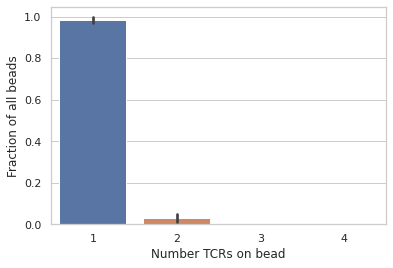

In [85]:
# FIGURE 2B
puck_tcr_res_counts = {}

for puck in puck_all:
    this_puck_dict = puck_tcr_res[puck.abbrev_sample_reference]
    summed = {i:len(set(this_puck_dict[i])) for i in this_puck_dict} # beads to number of TCRs
    all_vals = Counter(list(summed.values())) # numbers of beads with a certain count of TCRs
    total_num_beads = len(summed)
    for bead_sum in all_vals:
        if bead_sum not in puck_tcr_res_counts:
            puck_tcr_res_counts[bead_sum] = []
        fr = all_vals[bead_sum]/total_num_beads # the fraction of beads in this sample with that sum
        puck_tcr_res_counts[bead_sum].append(fr)

# convert to dataframe
num_tcrs = []
bead_fraction = []
for num in puck_tcr_res_counts:
    for frac in puck_tcr_res_counts[num]:
        num_tcrs.append(num)
        bead_fraction.append(frac)
plot_df = pd.DataFrame.from_dict({'Number TCRs on bead':num_tcrs,'Fraction of all beads':bead_fraction})


sns.set_theme(style="whitegrid")
ax = sns.barplot(x="Number TCRs on bead", y="Fraction of all beads", data=plot_df)
# sns.stripplot(
#     x="Number TCRs on bead", 
#     y="Fraction of all beads", 
#     color="black", 
#     data=plot_df, dodge=True, alpha=1, ax=ax
# )
# plt.hist(test_hist)
# plt.xlabel('Number of clonotypes')
# plt.ylabel('Bead counts')
plt.savefig('./plots/bar_qc_slidetcr.pdf')

In [86]:
np.mean(plot_df[plot_df['Number TCRs on bead'] == 1]['Fraction of all beads'])

0.9854770686135023

In [87]:
np.mean(plot_df[plot_df['Number TCRs on bead'] == 2]['Fraction of all beads'])

0.02846615262806789

0 1
0 22
Frac 0.0
0 193
0 67
Frac 0.0
0 0
0 3
Frac 0.0
0 131
0 36
Frac 0.0
1 38
2 125
Frac 0.016
0 24
0 83
Frac 0.0
4 472
8 314
Frac 0.025477707006369428
11 637
22 690
Frac 0.03188405797101449
0 347
0 114
Frac 0.0
0 80
0 397
Frac 0.0


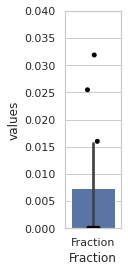

In [88]:
# FIGURE S2A
# What fraction of beads have the same clone within 15 um of one another?
pixel_thresh = 15/0.65
frac_tracker = []

for puck in puck_all:
    low_thresh = 0 # points lower than thresh
    high_thresh = 0 # points higher than thresh
    locs_with_close_loc = []
    all_locs = []
    puck_tcr_res_counts = {}
#     if puck != puck_ln6:
#         continue
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes['1a']:
            continue
        locs = set(puck.tcr_loc_dict_s1_filtered4[tcr])
        all_locs = all_locs + list(locs)
        
        for pts in itertools.combinations(locs, 2): # for all pairs
            t = distance_between_points(pts[0],pts[1])
            if t < pixel_thresh:
                low_thresh += 1
                locs_with_close_loc.append(pts[0])
                locs_with_close_loc.append(pts[1])
            else:
                high_thresh += 1

    print(low_thresh,high_thresh)
    print(len(locs_with_close_loc),len(set(all_locs)))
    frac = len(locs_with_close_loc)/len(set(all_locs))
    print('Frac',frac)
    frac_tracker.append(frac)

        
# plt.hist(test_hist)
# plt.xlabel('Number of clonotypes')
# plt.ylabel('Bead counts')

plt.figure(figsize=(1,4))
plot_df = pd.DataFrame.from_dict({'Fraction':['Fraction' for i in frac_tracker],'values':frac_tracker})
ax = sns.barplot(x = 'Fraction',
            y = 'values',
            data = plot_df)
sns.stripplot(x = 'Fraction',
            y = 'values',
            data = plot_df,
            dodge=True, jitter = True, alpha=1, color="black",ax=ax)
plt.ylim([0,0.04])
plt.savefig('./plots/bar_qc_slidetcr2.pdf')

  0%|          | 0/8 [00:00<?, ?it/s]

164 188
0.5340909090909091


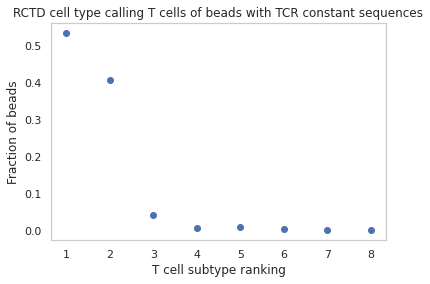

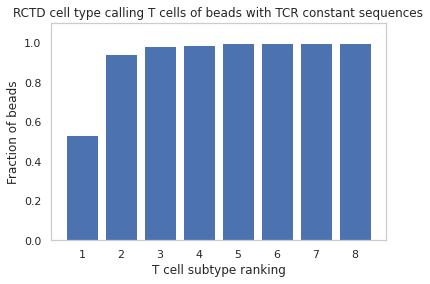

In [90]:
# FIGURE S3B
puck=puck_ln6

tcr_locs = []

tcr_bcs = list(puck.s1_dge_fmtd[puck.s1_dge_fmtd['TRBC2']>2].index) + list(puck.s1_dge_fmtd[puck.s1_dge_fmtd['TRAC']>2].index)
tcr_bcs = list(set(tcr_bcs))
tcr_locs = [puck.bc_loc_dict_s1[i] for i in tcr_bcs]

lymph_rctd_tcrs = lymph_rctd[lymph_rctd["Unnamed: 0"].isin(tcr_bcs)]
lymph_rctd_tcrs = lymph_rctd_tcrs[lymph_rctd_tcrs['spot_class'] != 'reject']

x = range(8)
y = []
for cutoff in tqdm(x):
    bad = 0
    good = 0
    for index,row in lymph_rctd_tcrs.iterrows():
    #     if row['spot_class'] == 'reject':
    #         continue
        T_est = row['T_CD4+'] + row['T_CD8+'] + row['Treg']

        cell_list = [row['B'], row['DC'], row['Endothelial'],row['ILC'], row['Monocytes'],row['MP'],row['NK']] + [T_est]
        cell_list.sort()

        ind = cell_list.index(T_est) 
        #print(len(cell_list),ind)
    #     if ind < cutoff:
    #         bad += 1
    #     if ind >=cutoff:
    #         good += 1

        # Plot 2
        if ind != cutoff:
            bad += 1
        if ind == cutoff:
            good += 1
    y.append(good/(good+bad))
    

print(bad,good)

print(good/(good+bad))

# x = [1,2,3,4,5,6,7]
# y = [0.4013, 0.766, 0.878, 0.929, 0.971, 0.994,1]
# sns.set_style("whitegrid", {"axes.grid": False})
# plt.scatter(x,y)
# plt.title('RCTD cell type calling T cells of beads with TCR CDR3 sequences')
# plt.xlabel('T cell subtype ranking')
# plt.ylabel('Fraction of beads')
x = [i+1 for i in x]
y.reverse()
sns.set_style("whitegrid", {"axes.grid": False})
plt.figure()
plt.scatter(x,y)
plt.title('RCTD cell type calling T cells of beads with TCR constant sequences')
plt.xlabel('T cell subtype ranking')
plt.ylabel('Fraction of beads')


sns.set_style("whitegrid", {"axes.grid": False})
plt.figure()
plt.bar(x,np.cumsum(y))
plt.title('RCTD cell type calling T cells of beads with TCR constant sequences')
plt.xlabel('T cell subtype ranking')
plt.ylabel('Fraction of beads')
plt.ylim([0,1.1])
plt.savefig('./plots/bar_qc_slidetcr3.pdf')

# Figure 2C Plot genes for lymph node
- (C) Gene expression gaussian-filtered heatmap for visualizing the spatial distribution of gene markers for T cells (TRBC2) and germinal centers (GCs; CXCR5, BCL6).

real life size: 183.84675000000001
real life size: 383.94815
real life size: 429.0987


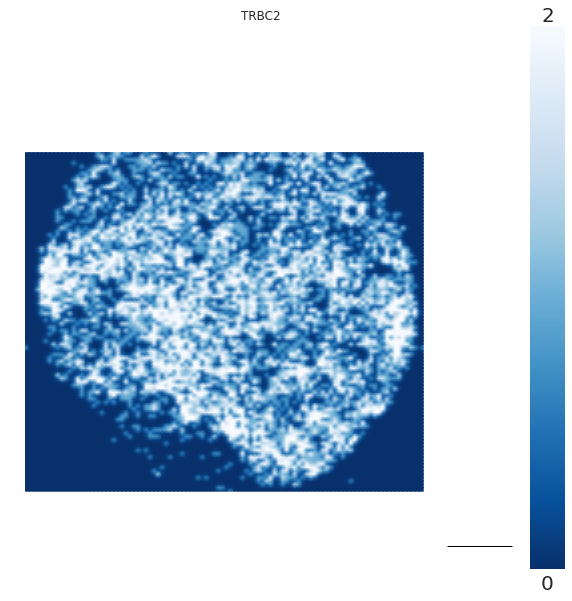

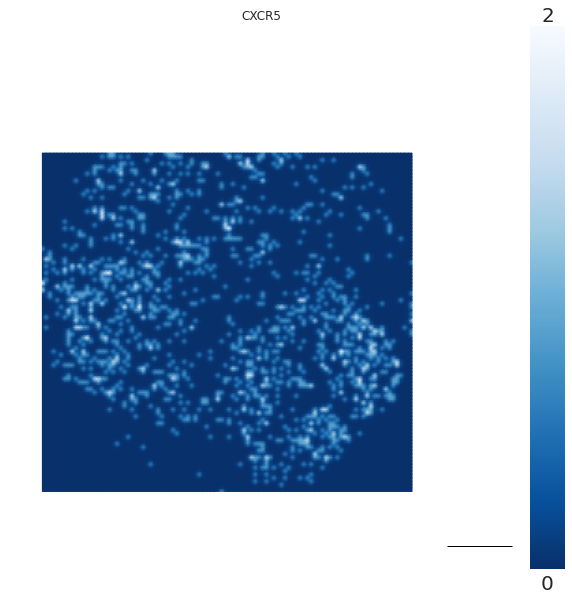

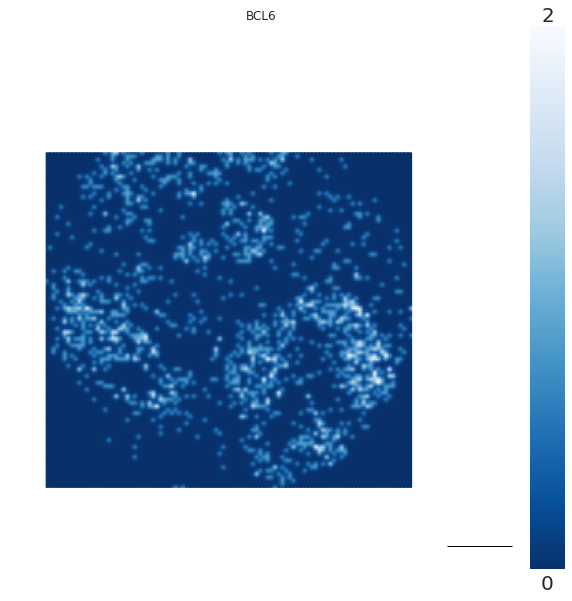

In [91]:
puck = puck_ln6
file_type = 'jilong'

fontprops = fm.FontProperties(size=18)

plt.rcParams.update({'font.size': 20})
color_map = plt.cm.get_cmap('Blues')
reversed_color_map = color_map.reversed()

nbins = 100

for gene in ["TRBC2",'CXCR5','BCL6']: 
    if '+' not in gene:
        gene_filt = puck.s1_dge_fmtd[puck.s1_dge_fmtd[gene] > 0]
        if file_type == 'slide-seq-tools':
            x = [puck.bc_loc_dict_s1[puck.matched_to_bc[i]][0] for i in gene_filt.index]
            y = [puck.bc_loc_dict_s1[puck.matched_to_bc[i]][1] for i in gene_filt.index]
        else:
            x = [puck.bc_loc_dict_s1[i][0] for i in gene_filt.index]
            y = [puck.bc_loc_dict_s1[i][1] for i in gene_filt.index]
    if '+' in gene:
        all_genes = gene.split('+')
        x = []
        y = []
        for g in all_genes:
            gene_filt = puck.s1_dge_fmtd[puck.s1_dge_fmtd[g] > 0]
            if file_type == 'slide-seq-tools':
                x = x + [puck.bc_loc_dict_s1[puck.matched_to_bc[i]][0] for i in gene_filt.index]
                y = y + [puck.bc_loc_dict_s1[puck.matched_to_bc[i]][1] for i in gene_filt.index]
            else:
                x = x + [puck.bc_loc_dict_s1[i][0] for i in gene_filt.index]
                y = y + [puck.bc_loc_dict_s1[i][1] for i in gene_filt.index]
                
    gaussian_heat_plot(x, y, 0,2, title=True, title_text=gene,save=True)

# Figures 2D-E Germinal center identification and bootstrapping
- (D) Bead designation into either GC regions (blue) or non-GC (orange) regions based on unsupervised clustering and GC markers on LN1. Beads with TCRβ CDR3 sequences detected are shown by black dots, but only for CDR3 sequences detected on  >1 bead. 
- (E) For LN1, Left: For clonotypes found on >1 bead, a Venn diagram showing the clonotype overlap between GC (blue) and non-GC (orange) regions. Right: the significance of the observed number of shared clonotypes compared to the expected number from randomly shuffled assignments.

PUCK: 2020-12-12_Puck_201014_06


  0%|          | 0/38105 [00:00<?, ?it/s]

  0%|          | 0/25158 [00:00<?, ?it/s]

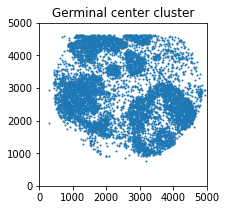

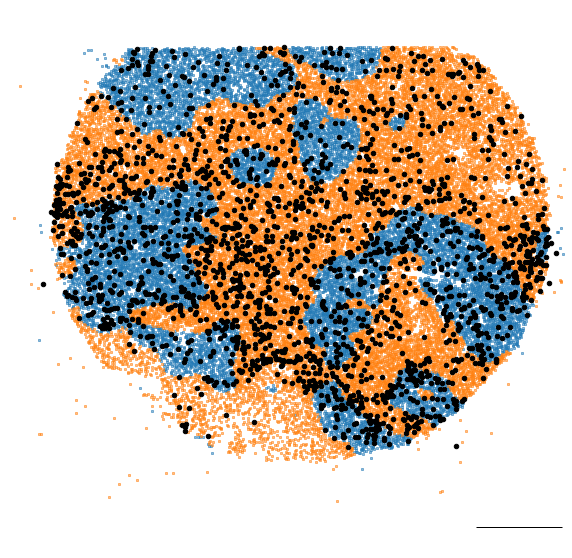

1000
1.0


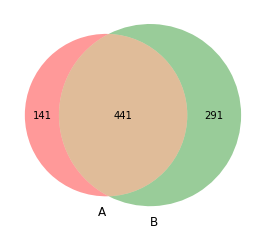

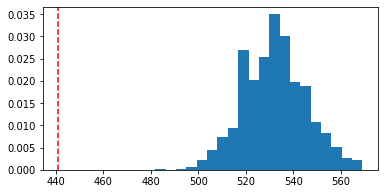

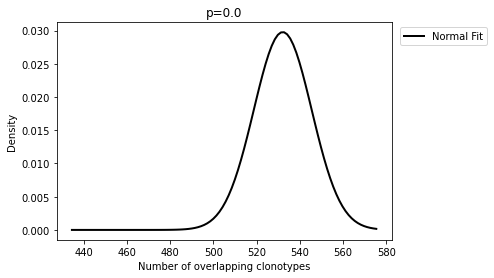

In [15]:
# FIGURE 2D-E
adata_all = [adata_ln6]
puck_all = [puck_ln6]

for adata, puck in zip(adata_all, puck_all):
    print(f'PUCK: {puck.puck_name}')
    gc_cluster_num,file_type = find_gc_cl_num([adata],[puck])
    #plot_clusters(puck,adata)
    puck, adata = identify_gcs(puck,adata, look_at_multiples = True, show_plots = True)
    puck, adata = separate_tcrs(puck,adata, look_at_multiples = True, show_plots = True)
    bootstrap_gcs(puck.gc_tcrs,puck.other_tcrs,puck, show_plots = True)

# Figures S3D, Venn diagram for all clones, and 2F Shannon entropy
- (D) For all clonotypes, a Venn diagram showing the clonotype overlap between GC (blue) and non-GC (orange) regions in a reactive lymph node.
- (F) Shannon entropy (i.e., a measure of diversity) of the TCR repertoire in GC vs. non-GC regions for six arrays across three human secondary lymphoid organs.

In [ ]:
# For the venn diagrams and associated analysis, need to change look_at_multiples to True

PUCK: 2020-12-12_Puck_201014_06


  0%|          | 0/38105 [00:00<?, ?it/s]

  0%|          | 0/25158 [00:00<?, ?it/s]

1000
1.0


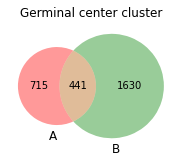

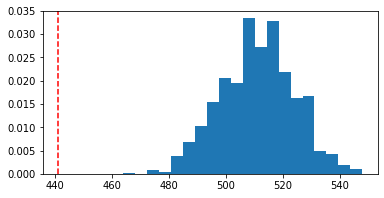

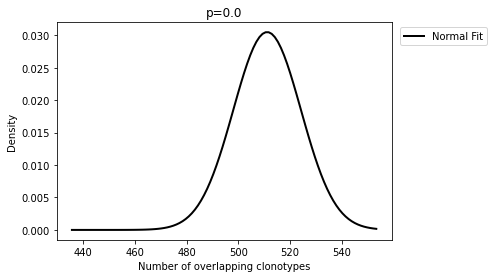

In [36]:
adata_all = [adata_ln6]
puck_all = [puck_ln6]

for adata, puck in zip(adata_all, puck_all):
    print(f'PUCK: {puck.puck_name}')
    gc_cluster_num,file_type = find_gc_cl_num([adata],[puck])
    puck, adata = identify_gcs(puck,adata, look_at_multiples = False,show_plots = True)
    puck, adata = separate_tcrs(puck,adata, look_at_multiples = False)
    bootstrap_gcs(puck.gc_tcrs,puck.other_tcrs,puck,show_plots = True)

In [37]:
adata_all = [adata_ton21, adata_ton22, adata_ln5, adata_ln12, adata_ln13]
puck_all = [puck_ton21, puck_ton22, puck_ln5, puck_ln12, puck_ln13]

for adata, puck in zip(adata_all, puck_all):
    print(f'PUCK: {puck.puck_name}')
    gc_cluster_num,file_type = find_gc_cl_num([adata],[puck])
    puck, adata = identify_gcs(puck,adata, look_at_multiples = False)
    puck, adata = separate_tcrs(puck,adata, look_at_multiples = False)
    bootstrap_gcs(puck.gc_tcrs,puck.other_tcrs,puck)

PUCK: 2021-04-13_Puck_210119_21


  0%|          | 0/51705 [00:00<?, ?it/s]

  0%|          | 0/46919 [00:00<?, ?it/s]

1000
0.973
PUCK: 2021-04-13_Puck_210119_22


  0%|          | 0/50923 [00:00<?, ?it/s]

  0%|          | 0/44908 [00:00<?, ?it/s]

1000
0.999
PUCK: 2020-12-12_Puck_201014_05


  0%|          | 0/30173 [00:00<?, ?it/s]

  0%|          | 0/19242 [00:00<?, ?it/s]

1000
1.0
PUCK: 2021-09-01_Puck_210731_12_submit


  0%|          | 0/43142 [00:00<?, ?it/s]

  0%|          | 0/42024 [00:00<?, ?it/s]

1000
0.661
PUCK: 2021-09-01_Puck_210731_13_submit


  0%|          | 0/51834 [00:00<?, ?it/s]

  0%|          | 0/50352 [00:00<?, ?it/s]

1000
0.348


In [38]:
g_sh = []
o_sh = []
adata_all = [
    adata_ton21, adata_ton22, adata_ln5, adata_ln6, adata_ln12, adata_ln13
]
puck_all = [puck_ton21, puck_ton22, puck_ln5, puck_ln6, puck_ln12, puck_ln13]

for puck in puck_all:
    g_sh_this, o_sh_this = get_shannon_values(gc_tcrs=puck.gc_tcrs,
                                              other_tcrs=puck.other_tcrs)
    g_sh.append(g_sh_this)
    o_sh.append(o_sh_this)

In [39]:
sample_names = ["TON1-1", "TON1-2", "LN1-1", "LN1-2", "LN2-1",
                "LN2-2"]
pval_ent = ttest_rel(g_sh, o_sh)
print(pval_ent)

Ttest_relResult(statistic=-3.0983252296320933, pvalue=0.026904204322967484)


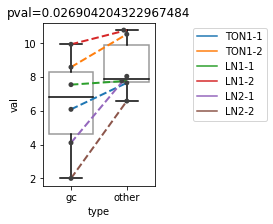

In [40]:
# Recording gc vs other diversity

data = {'gc': np.array(g_sh),
       'other':np.array(o_sh)}
maxsize = max([a.size for a in data.values()])
data_pad = {k:np.pad(v, pad_width=(0,maxsize-v.size,), mode='constant', constant_values=np.nan) for k,v in data.items()}
df = pd.DataFrame(data_pad)

df_line = pd.DataFrame.from_dict({'type':['gc']*6 + ['other']*6, 'val':list(g_sh)+list(o_sh),
                                 'sample':sample_names+sample_names})
fig, ax = plt.subplots(figsize=(2,3))
sns.boxplot(data=df,color='white')
#sns.violinplot(data=df)
sns.swarmplot(data=df,color=".25")
for line in ax.get_lines():
    line.set_color('black')
sns.lineplot(data=df_line, x ='type',y='val',hue='sample',linewidth=2,linestyle='--') #,hue='sample'

plt.title(f'pval={pval_ent[1]}')
plt.legend(bbox_to_anchor=(1.3, 1))
plt.savefig('./plots/2e.pdf')
plt.show()


# Figure S2E Table of p-values for shared clones across GC and non-GC in three samples
- (E) Significance of the observed number of shared clonotypes between GCs compared to the expected number from randomly shuffled assignments for three secondary lymphoid organ samples. Combined p-value using Fisher’s method.

PUCK: 2021-04-13_Puck_210119_21


  0%|          | 0/51705 [00:00<?, ?it/s]

  0%|          | 0/46919 [00:00<?, ?it/s]

PUCK: 2021-04-13_Puck_210119_22


  0%|          | 0/50923 [00:00<?, ?it/s]

  0%|          | 0/44908 [00:00<?, ?it/s]

PUCK: 2020-12-12_Puck_201014_05


  0%|          | 0/30173 [00:00<?, ?it/s]

  0%|          | 0/19242 [00:00<?, ?it/s]

PUCK: 2020-12-12_Puck_201014_06


  0%|          | 0/38105 [00:00<?, ?it/s]

  0%|          | 0/25158 [00:00<?, ?it/s]

PUCK: 2021-09-01_Puck_210731_12_submit


  0%|          | 0/43142 [00:00<?, ?it/s]

  0%|          | 0/42024 [00:00<?, ?it/s]

PUCK: 2021-09-01_Puck_210731_13_submit


  0%|          | 0/51834 [00:00<?, ?it/s]

  0%|          | 0/50352 [00:00<?, ?it/s]

1000
1.0


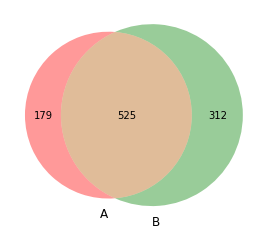

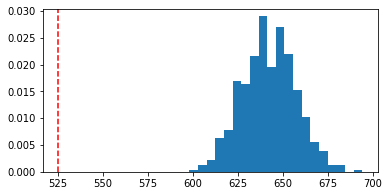

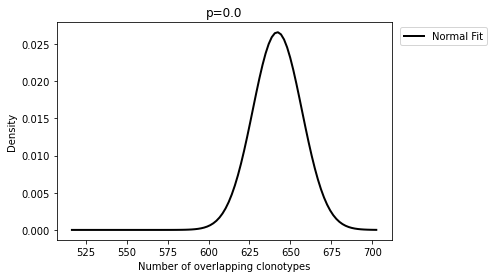

1000
1.0


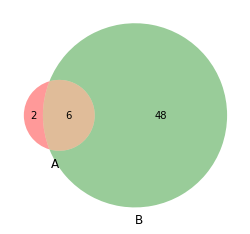

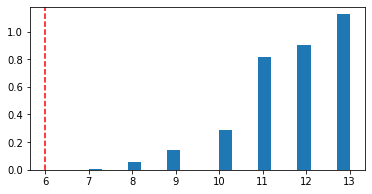

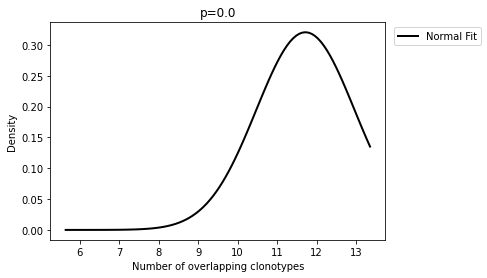

1000
1.0


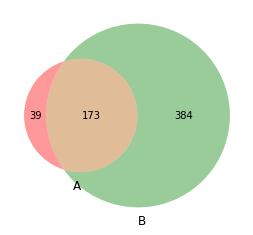

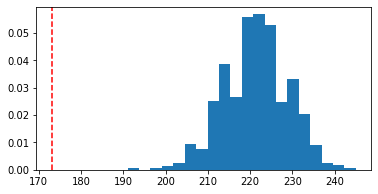

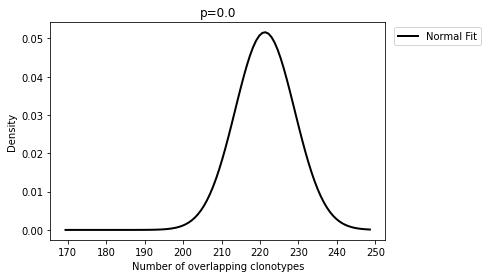

In [41]:
adata_all = [
    adata_ton21, adata_ton22, adata_ln5, adata_ln6, adata_ln12, adata_ln13
]
puck_all = [puck_ton21, puck_ton22, puck_ln5, puck_ln6, puck_ln12, puck_ln13]

for adata, puck in zip(adata_all, puck_all):
    print(f'PUCK: {puck.puck_name}')
    gc_cluster_num, file_type = find_gc_cl_num([adata], [puck])
    #plot_clusters(puck,adata)
    puck, adata = identify_gcs(puck, adata, look_at_multiples=True)
    puck, adata = separate_tcrs(puck, adata, look_at_multiples=True)

bootstrap_gcs(gc_tcrs=puck_ln5.gc_tcrs + puck_ln6.gc_tcrs,
              other_tcrs=puck_ln5.other_tcrs + puck_ln6.other_tcrs,
              puck=puck_ln5,
              show_plots=True)

bootstrap_gcs(gc_tcrs=puck_ln12.gc_tcrs + puck_ln13.gc_tcrs,
              other_tcrs=puck_ln12.other_tcrs + puck_ln13.other_tcrs,
              puck=puck_ln11,
              show_plots=True)

bootstrap_gcs(gc_tcrs=puck_ton21.gc_tcrs + puck_ton22.gc_tcrs,
              other_tcrs=puck_ton21.other_tcrs + puck_ton22.other_tcrs,
              puck=puck_ton21,
              show_plots=True)

In [42]:
scipy.stats.combine_pvalues([0.0001,0.0001,0.0001])

(55.262042231857095, 4.1036768507037387e-10)

# Figure 2G Bar plot for clonotype abundance in GC vs. non-GC
- (G) Clonotypes grouped by clonotype fraction, normalized by the total number of TCRs in each compartment, in GC and non-GC regions in lymph node and tonsil, with the number of corresponding beads along the top axis.

In [43]:
adata_all = [adata_ton21, adata_ton22, adata_ln5, adata_ln6, adata_ln12, adata_ln13]
puck_all = [puck_ton21, puck_ton22, puck_ln5, puck_ln6, puck_ln12, puck_ln13]

for adata, puck in zip(adata_all, puck_all):
    print(f'PUCK: {puck.puck_name}')
    gc_cluster_num,file_type = find_gc_cl_num([adata],[puck])
    puck, adata = identify_gcs(puck,adata, look_at_multiples = False)
    puck, adata = separate_tcrs(puck,adata, look_at_multiples = False)
    bootstrap_gcs(puck.gc_tcrs,puck.other_tcrs,puck)

PUCK: 2021-04-13_Puck_210119_21


  0%|          | 0/51705 [00:00<?, ?it/s]

  0%|          | 0/46919 [00:00<?, ?it/s]

1000
0.98
PUCK: 2021-04-13_Puck_210119_22


  0%|          | 0/50923 [00:00<?, ?it/s]

  0%|          | 0/44908 [00:00<?, ?it/s]

1000
0.999
PUCK: 2020-12-12_Puck_201014_05


  0%|          | 0/30173 [00:00<?, ?it/s]

  0%|          | 0/19242 [00:00<?, ?it/s]

1000
1.0
PUCK: 2020-12-12_Puck_201014_06


  0%|          | 0/38105 [00:00<?, ?it/s]

  0%|          | 0/25158 [00:00<?, ?it/s]

1000
1.0
PUCK: 2021-09-01_Puck_210731_12_submit


  0%|          | 0/43142 [00:00<?, ?it/s]

  0%|          | 0/42024 [00:00<?, ?it/s]

1000
0.655
PUCK: 2021-09-01_Puck_210731_13_submit


  0%|          | 0/51834 [00:00<?, ?it/s]

  0%|          | 0/50352 [00:00<?, ?it/s]

1000
0.321


In [44]:
gc_and_other_all_tcrs = []

gc_tcrs = puck_ln5.gc_tcrs + puck_ln6.gc_tcrs
other_tcrs = puck_ln5.other_tcrs + puck_ln6.other_tcrs
gc_and_other_all_tcrs.append((gc_tcrs,other_tcrs))

gc_tcrs = puck_ln12.gc_tcrs + puck_ln13.gc_tcrs
other_tcrs = puck_ln12.other_tcrs + puck_ln13.other_tcrs
gc_and_other_all_tcrs.append((gc_tcrs,other_tcrs))

gc_tcrs = puck_ton21.gc_tcrs + puck_ton22.gc_tcrs
other_tcrs = puck_ton21.other_tcrs + puck_ton22.other_tcrs
gc_and_other_all_tcrs.append((gc_tcrs,other_tcrs))


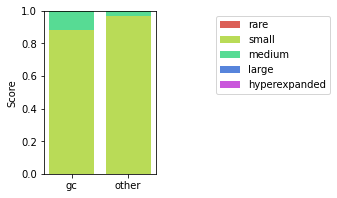

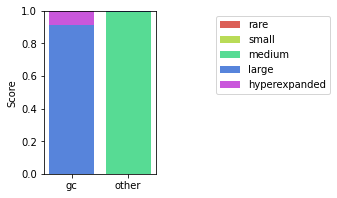

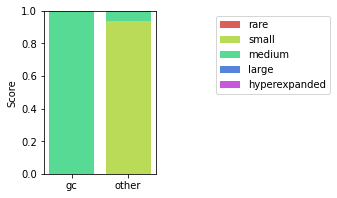

In [45]:
for i in gc_and_other_all_tcrs:
    gc_tcrs = i[0]
    other_tcrs = i[1]
    gc_tcrs_ct = Counter(gc_tcrs).values()
    other_tcrs_ct = Counter(other_tcrs).values()
    rare = (0, 10**-4)
    small = (10**-4, 10**-3)
    medium = (10**-3, 10**-2)
    large = (10**-2, 10**-1)
    hyperexpanded = (10**-1, 1)

    cmap_use = sns.color_palette("hls", 5)
    test = convert_tcr_list_to_groupings([i / sum(gc_tcrs_ct) for i in gc_tcrs_ct])
    test2 = convert_tcr_list_to_groupings(
        [i / sum(other_tcrs_ct) for i in other_tcrs_ct])
    test_df = pd.DataFrame.from_dict({
        'gc':
        test,
        'other':
        test2,
        'cat': ['rare', 'small', 'medium', 'large', 'hyperexpanded']
    })
    test_df.set_index('cat', inplace=True)
    test_df_t = test_df.T
    test_df_t["sum"] = test_df_t.sum(axis=1)
    df = test_df_t.div(test_df_t["sum"], axis=0)
    df.pop('sum')

    # # plot bars in stack manner
    plt.figure(figsize=(2, 3))
    x = ['gc', 'other']
    y0 = np.array(df['rare'])
    y1 = np.array(df['small'])
    y2 = np.array(df['medium'])
    y3 = np.array(df['large'])
    y4 = np.array(df['hyperexpanded'])
    plt.bar(x, y0, color=cmap_use[0])
    plt.bar(x, y1, bottom=y0, color=cmap_use[1])
    plt.bar(x, y2, bottom=y0 + y1, color=cmap_use[2])
    plt.bar(x, y3, bottom=y0 + y1 + y2, color=cmap_use[3])
    plt.bar(x, y4, bottom=y0 + y1 + y2 + y3, color=cmap_use[4])
    plt.ylabel("Score")
    plt.legend(["rare", "small", "medium", "large", "hyperexpanded"],
               bbox_to_anchor=(1.5, 1))
    plt.savefig(f'./plots/gc_vs_other_population_fraction_ln11.pdf')
    plt.show()

In [46]:
# Number of corresponding beads for plot

print('LN')
print(len(puck_ln5.gc_tcrs) + len(puck_ln6.gc_tcrs))
print(len(puck_ln5.other_tcrs) + len(puck_ln6.other_tcrs))

print('LN')
print(len(puck_ln12.gc_tcrs) + len(puck_ln13.gc_tcrs))
print(len(puck_ln12.other_tcrs) + len(puck_ln13.other_tcrs))

print('TON')
print(len(puck_ton21.gc_tcrs) + len(puck_ton22.gc_tcrs))
print(len(puck_ton21.other_tcrs) + len(puck_ton22.other_tcrs))

LN
2155
3240
LN
28
458
TON
566
2625


# Figures 2H-I and S2F-G Comparing GC1 vs GC2
- (H) K-means clustering distinguishing two GCs in a human reactive lymph node. 
- (I) Left: For clonotypes detected on >1 bead, a Venn diagram showing clonotype overlap between GC1 (purple) and GC2 (red) regions. Right: The significance of the observed number of shared clonotypes between GCs compared to the expected number from randomly shuffled assignments. 
- (F) K-means clustering distinguishing two GCs in a serial section of a human reactive lymph node.
- (G) (Left) For clonotypes detected on >1 bead, a Venn diagram showing clonotype overlap between GC1 (purple) and GC2 (red) regions. (Right) - The significance of the observed number of shared clonotypes between GCs compared to the expected number from randomly shuffled assignments.
All scale bars: 500 µm. LN = lymph node. TON = tonsil.

In [47]:
adata_all = [adata_ln5, adata_ln6]
puck_all =[puck_ln5, puck_ln6]

for adata, puck in zip(adata_all, puck_all):
    print(f'PUCK: {puck.puck_name}')
    gc_cluster_num,file_type = find_gc_cl_num([adata],[puck])
    #plot_clusters(puck,adata)
    puck, adata = identify_gcs(puck,adata, look_at_multiples = True, show_plots = False)

PUCK: 2020-12-12_Puck_201014_05


  0%|          | 0/30173 [00:00<?, ?it/s]

  0%|          | 0/19242 [00:00<?, ?it/s]

PUCK: 2020-12-12_Puck_201014_06


  0%|          | 0/38105 [00:00<?, ?it/s]

  0%|          | 0/25158 [00:00<?, ?it/s]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


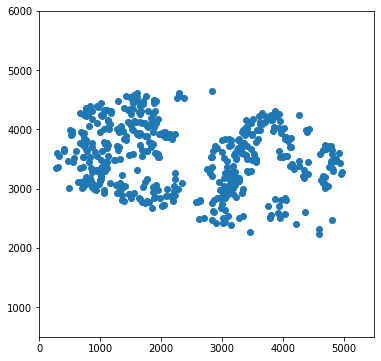

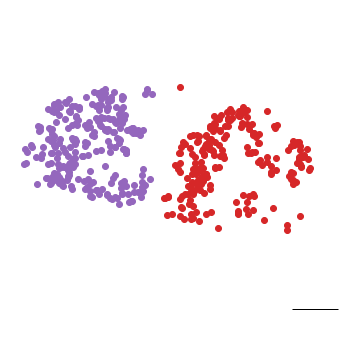

In [48]:
fontprops = fm.FontProperties(size=18)

# Compare between germinal centers - LN 5
puck = puck_ln5
fig,ax = plt.subplots(figsize=(6,6))
gc_tcrs_locs = [i for i in puck_ln5.gc_tcrs_locs if i[1] > 2000]
plt.scatter([i[0] for i in gc_tcrs_locs],[i[1] for i in gc_tcrs_locs])
kmeans = KMeans(n_clusters=2, random_state=0).fit(gc_tcrs_locs)
g1 = [i for i,j in zip(gc_tcrs_locs,kmeans.labels_) if j == 0]
g2 = [i for i,j in zip(gc_tcrs_locs,kmeans.labels_) if j == 1]
plt.xlim([0,5500])
plt.ylim([500,6000])

# Filter below a certain y value to ignore the weird cluster up top
g1 = [i for i in g1 ] # if i[1] < 3400 for puck_ln
g2 = [i for i in g2 ] # if i[1] < 3400 for puck_ln
fig,ax = plt.subplots(figsize=(6,6))
plt.scatter([i[0] for i in g1],[i[1] for i in g1],c=sns.color_palette()[4])
plt.scatter([i[0] for i in g2],[i[1] for i in g2],c=sns.color_palette()[3])
plt.xlim([0,5500])
plt.ylim([500,6000])
plt.axis('off')

scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )

ax.add_artist(scalebar)

fig.canvas.draw()
plt.show()
    
    

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


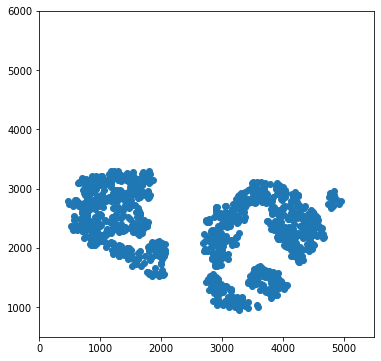

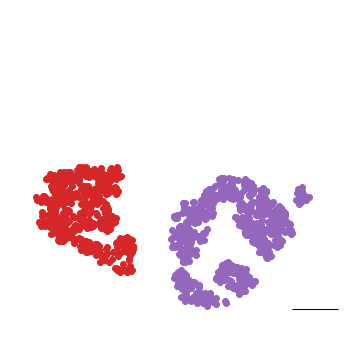

In [49]:
# Compare between germinal centers - LN 6
puck = puck_ln6
fig,ax = plt.subplots(figsize=(6,6))
gc_tcrs_locs = [i for i in puck_ln6.gc_tcrs_locs if i[1] < 3300]
plt.scatter([i[0] for i in gc_tcrs_locs],[i[1] for i in gc_tcrs_locs])
kmeans = KMeans(n_clusters=2, random_state=0).fit(gc_tcrs_locs)
g1 = [i for i,j in zip(gc_tcrs_locs,kmeans.labels_) if j == 0]
g2 = [i for i,j in zip(gc_tcrs_locs,kmeans.labels_) if j == 1]
plt.xlim([0,5500])
plt.ylim([500,6000])

# Filter below a certain y value to ignore the weird cluster up top
g1 = [i for i in g1 ] # if i[1] < 3400 for puck_ln
g2 = [i for i in g2 ] # if i[1] < 3400 for puck_ln
fig,ax = plt.subplots(figsize=(6,6))
plt.scatter([i[0] for i in g1],[i[1] for i in g1],c=sns.color_palette()[3])
plt.scatter([i[0] for i in g2],[i[1] for i in g2],c=sns.color_palette()[4])
plt.xlim([0,5500])
plt.ylim([500,6000])
plt.axis('off')

scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )

ax.add_artist(scalebar)

fig.canvas.draw()
plt.show()
    
    

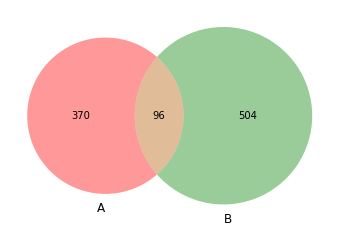

In [50]:
g1_tcrs= [puck.loc_to_tcr[i] for i in g1 if i in puck.loc_to_tcr]
g2_tcrs = [puck.loc_to_tcr[i] for i in g2 if i in puck.loc_to_tcr]

g1_tcrs = list(itertools.chain.from_iterable(g1_tcrs))
g2_tcrs = list(itertools.chain.from_iterable(g2_tcrs))

venn2(subsets = (set(g1_tcrs),set(g2_tcrs)))

1.0


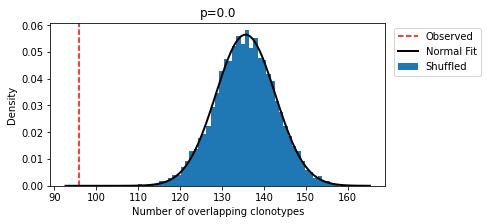

In [51]:
# Bootstrap overlaps between GC and interfollicles
iters = 10000 # Number of random shuffles
iter_cter = 0
overlaps = [] # Counts the number of overlaps in the random shuffles

rand_all = g1_tcrs + g2_tcrs # Make one list of TCRs in both locations for shuffling
while iter_cter < iters:
    random.shuffle(rand_all)
    rand_gc_tcrs_tcrs = rand_all[0:len(g1_tcrs)]
    rand_other_tcrs_tcrs = rand_all[len(g1_tcrs):]
    overlaps.append(len(set(rand_gc_tcrs_tcrs) & set(rand_other_tcrs_tcrs)))
    iter_cter += 1
    
# Plot a figure showing p-value testing
save = True
fig = plt.figure(figsize=(6,3))
plt.hist(overlaps,bins=len(set(overlaps)),density=True,label = 'Shuffled')
plt.axvline(len(set(g1_tcrs) & set(g2_tcrs)),c='r',linestyle='--',label='Observed')
test = [i for i in overlaps if i >len(set(g1_tcrs) & set(g2_tcrs))]
pval = len(test)/len(overlaps)
print(pval)

mu, std = scipy.stats.distributions.norm.fit(overlaps)

xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = scipy.stats.distributions.norm.pdf(x, mu,std)
  
plt.plot(x, p, 'k', linewidth=2,label='Normal Fit')
plt.legend(bbox_to_anchor=(1.3, 1))

plt.title(f'p={1-pval}')
plt.xlabel('Number of overlapping clonotypes')
plt.ylabel('Density')
if save==True:
    fig.savefig(f"./plots/gc_gc_testing_{puck.puck_name}.pdf", bbox_inches='tight')

# Figure 2J VDJ comparison

In [27]:
adata_all = [adata_ln6]
puck_all =[puck_ln6]

for adata, puck in zip(adata_all, puck_all):
    print(f'PUCK: {puck.puck_name}')
    gc_cluster_num,file_type = find_gc_cl_num([adata],[puck])
    #plot_clusters(puck,adata)
    puck, adata = identify_gcs(puck,adata, look_at_multiples = True, show_plots = False)

PUCK: 2020-12-12_Puck_201014_06


  0%|          | 0/38105 [00:00<?, ?it/s]

  0%|          | 0/25158 [00:00<?, ?it/s]

In [28]:
puck = puck_ln6

puck.readids_filt = puck.readids[puck.readids.cloneId != -1]
puck.readids_filt = puck.readids_filt[puck.readids_filt.topChains=='TRB']

cloneid_v = {i:j for i,j in zip(puck.cloneids.cloneId,puck.cloneids.allVHitsWithScore)}
cloneid_j = {i:j for i,j in zip(puck.cloneids.cloneId,puck.cloneids.allJHitsWithScore)}

bc_to_v = {}
bc_to_j = {}

failed_clones = [] # Check to see which clones do not have V
puck.readIDtobarcode_dict
for index,row in tqdm(puck.readids_filt.iterrows()):
    if 'TRB' not in row['topChains']:
        continue
    clone = row.cloneId
    for read in row['descrsR1'].split(','):
        if clone not in cloneid_v:
            if clone not in failed_clones:
                failed_clones.append(clone)
            continue
        bc = puck.readIDtobarcode_dict[read][0]
        clone = row['cloneId']
        if 'A' in cloneid_v[clone]:
            continue
        if 'A' in cloneid_j[clone]:
            continue
        bc_to_v[bc] = cloneid_v[clone]
        bc_to_j[bc] = cloneid_j[clone]
        
clonotype_to_v = {}
clonotype_to_j = {}

for cdr3,v in zip(puck.cloneids.aaSeqImputedCDR3,puck.cloneids.allVHitsWithScore):
    if cdr3 not in puck.clonotypes['1b']:
        continue
    if cdr3 not in clonotype_to_v:
        clonotype_to_v[cdr3] = []
    clonotype_to_v[cdr3].append(v.split('*')[0])
clonotype_to_v = {i:list(set(clonotype_to_v[i])) for i in clonotype_to_v}

for cdr3,j in zip(puck.cloneids.aaSeqImputedCDR3,puck.cloneids.allJHitsWithScore):
    if cdr3 not in puck.clonotypes['1b']:
        continue
    if cdr3 not in clonotype_to_j:
        clonotype_to_j[cdr3] = []
    clonotype_to_j[cdr3].append(j.split('*')[0])
clonotype_to_j = {i:list(set(clonotype_to_j[i])) for i in clonotype_to_j}

0it [00:00, ?it/s]

In [29]:
# SET GC AND OTHER OR GC1 and GC2 

gc_tcrs_v, gc_tcrs_v_counter = find_vs(bc_to_v,[puck.loc_to_bc_s1[i] for i in puck.gc_tcrs_locs])
other_tcrs_v, other_tcrs_v_counter = find_vs(bc_to_v,[puck.loc_to_bc_s1[i] for i in puck.other_tcrs_locs])

gc_tcrs_j, gc_tcrs_j_counter = find_vs(bc_to_j,[puck.loc_to_bc_s1[i] for i in puck.gc_tcrs_locs])
other_tcrs_j, other_tcrs_j_counter = find_vs(bc_to_j,[puck.loc_to_bc_s1[i] for i in puck.other_tcrs_locs])

g1_tcrs_v, g1_tcrs_v_counter = find_vs(bc_to_v,[puck.loc_to_bc_s1[i] for i in g1])
g2_tcrs_v, g2_tcrs_v_counter = find_vs(bc_to_v,[puck.loc_to_bc_s1[i] for i in g2])

g1_tcrs_j, g1_tcrs_j_counter = find_vs(bc_to_j,[puck.loc_to_bc_s1[i] for i in g1])
g2_tcrs_j, g2_tcrs_j_counter = find_vs(bc_to_j,[puck.loc_to_bc_s1[i] for i in g2])

In [30]:
## Prep gc vs other
v = list(set(list(gc_tcrs_v_counter.keys()) + list(other_tcrs_v_counter.keys())))
g = [gc_tcrs_v_counter[i] for i in v]
o = [other_tcrs_v_counter[i] for i in v]
g_norm = [i/sum(g) for i in g]
o_norm = [i/sum(o) for i in o]

j = list(set(list(gc_tcrs_j_counter.keys()) + list(other_tcrs_j_counter.keys())))
g_j =  [gc_tcrs_j_counter[i] for i in j]
o_j =  [other_tcrs_j_counter[i] for i in j]
g_j_norm = [i/sum(g_j) for i in g_j]
o_j_norm = [i/sum(o_j) for i in o_j]

df = pd.DataFrame.from_dict({'v_name':v+j,'gc':g+g_j,'other':o+o_j,'gc_norm':g_norm+g_j_norm,
                             'other_norm':o_norm+o_j_norm})

df['diff'] = df.gc_norm - df.other_norm
df['abs_diff'] = [np.abs(i) for i in df['diff']]

df = df.sort_values('v_name')

reorder_list =  [ 
       'TRBV2', 
       'TRBV3-1', 'TRBV3-2',  'TRBV4-1', 'TRBV4-3', 'TRBV5-1',
       'TRBV5-5', 'TRBV5-6', 'TRBV5-7', 'TRBV5-8', 'TRBV6-1', 'TRBV6-2',
       'TRBV6-3', 'TRBV6-4', 'TRBV6-5', 'TRBV6-6', 'TRBV7-2', 'TRBV7-3',
       'TRBV7-4', 'TRBV7-6', 'TRBV7-8', 'TRBV7-9', 'TRBV9',
        'TRBV10-1', 'TRBV10-2', 'TRBV10-3', 'TRBV11-1',
       'TRBV11-2', 'TRBV11-3', 'TRBV12-3', 'TRBV12-4', 'TRBV12-5',
       'TRBV13', 'TRBV14', 'TRBV15', 'TRBV16', 'TRBV18', 'TRBV19',
    'TRBV20-1', 'TRBV24-1', 'TRBV27', 'TRBV28', 'TRBV29-1','TRBV30',
                 'TRBJ1-1', 'TRBJ1-2', 'TRBJ1-3', 'TRBJ1-4', 'TRBJ1-5', 'TRBJ1-6',
       'TRBJ2-1', 'TRBJ2-2', 'TRBJ2-3', 'TRBJ2-4', 'TRBJ2-5', 'TRBJ2-6',
       'TRBJ2-7',]

df.set_index('v_name',inplace=True)

for n in [i for i in reorder_list if i not in df.index]:
    df.loc[n]={i:0 for i in df.columns}
df = df.fillna(0)


df = df.loc[reorder_list]
df['v_name'] = df.index

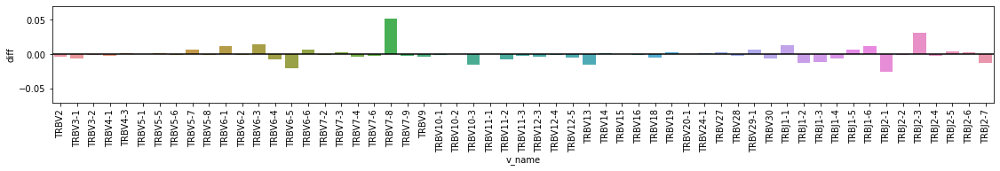

In [31]:
fig,ax = plt.subplots(figsize=(len(set(df.v_name))/3,2))
barplot = sns.barplot(x='v_name',y='diff',data=df) #facecolor=(1, 1, 1, 0), edgecolor=".2"
plt.xticks(rotation=90)
plt.axhline(y=0,c='k')
plt.ylim([-0.07,0.07])

fig.savefig(f"./plots/vj_gc_vs_other.pdf", bbox_inches='tight')

plt.show()

Text(0.5, 1.0, 'pval=0.0')

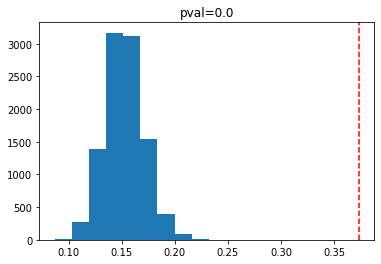

In [32]:
# Get p-values
measured = sum(df.abs_diff)
iterations = 10000
random_recorder_gc = []
random_recorder_other = []
p = sum(df.gc)/sum(df.other)
p
for index,row in df.iterrows():
    num_for_this_vj = row['gc'] + row['other']
    n, p = num_for_this_vj, .5  # number of trials, probability of each trial
    gc = np.random.binomial(n, p, iterations)
    random_recorder_gc.append(gc)
    random_recorder_other.append(num_for_this_vj-gc)
random_gc = np.array(random_recorder_gc)
random_other = np.array(random_recorder_other)
random_norm_gc = random_gc/random_gc.sum(axis=0,keepdims=1)
random_norm_other = random_other/random_other.sum(axis=0,keepdims=1)
random_l1 = []
for i in range(iterations):
    test = sum([np.abs(i-j) for i,j in zip(random_norm_other[:,i],random_norm_gc[:,i])])
    random_l1.append(test)
plt.hist(random_l1)
plt.axvline(measured,c='r',linestyle='--',label='Observed')
plt.title(f'pval={len([i for i in random_l1 if i > measured])/iterations}')

In [33]:
## Prep gc vs gc
v = list(set(list(g1_tcrs_v_counter.keys()) + list(g2_tcrs_v_counter.keys())))
g = [g1_tcrs_v_counter[i] for i in v]
o = [g2_tcrs_v_counter[i] for i in v]
g_norm = [i/sum(g) for i in g]
o_norm = [i/sum(o) for i in o]

j = list(set(list(g1_tcrs_j_counter.keys()) + list(g1_tcrs_j_counter.keys())))
g_j =  [g1_tcrs_j_counter[i] for i in j]
o_j =  [g2_tcrs_j_counter[i] for i in j]
g_j_norm = [i/sum(g_j) for i in g_j]
o_j_norm = [i/sum(o_j) for i in o_j]

df = pd.DataFrame.from_dict({'v_name':v+j,'gc':g+g_j,'other':o+o_j,'gc_norm':g_norm+g_j_norm,
                             'other_norm':o_norm+o_j_norm})


df['diff'] = df.gc_norm - df.other_norm
df['abs_diff'] = [np.abs(i) for i in df['diff']]

df = df.sort_values('v_name')
df.set_index('v_name',inplace=True)

for n in [i for i in reorder_list if i not in df.index]:
    df.loc[n]={i:0 for i in df.columns}
df = df.fillna(0)


df = df.loc[reorder_list]
df['v_name'] = df.index

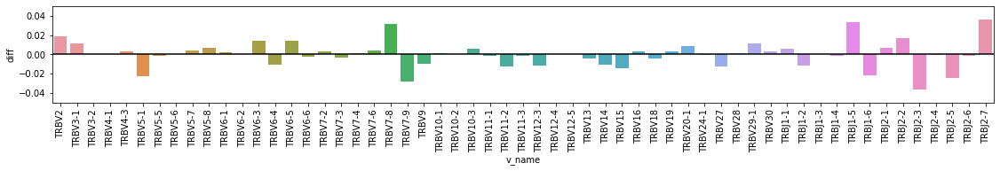

In [34]:
fig,ax = plt.subplots(figsize=(len(set(df.v_name))/3,2))
barplot = sns.barplot(x='v_name',y='diff',data=df) #facecolor=(1, 1, 1, 0), edgecolor=".2"
plt.xticks(rotation=90)
plt.axhline(y=0,c='k')
plt.ylim([-0.05,0.05])

fig.savefig(f"./plots/vj_gc_vs_gc.pdf", bbox_inches='tight')
plt.show()

Text(0.5, 1.0, 'pval=0.0')

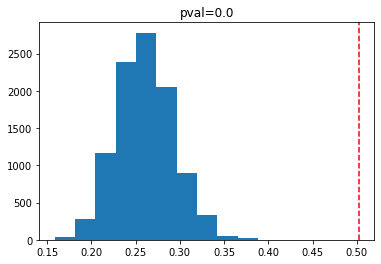

In [35]:
# Get p-values
measured = sum(df.abs_diff)
iterations = 10000
random_recorder_gc = []
random_recorder_other = []
p = sum(df.gc)/sum(df.other)
p
for index,row in df.iterrows():
    num_for_this_vj = row['gc'] + row['other']
    n, p = num_for_this_vj, .5  # number of trials, probability of each trial
    gc = np.random.binomial(n, p, iterations)
    random_recorder_gc.append(gc)
    random_recorder_other.append(num_for_this_vj-gc)
random_gc = np.array(random_recorder_gc)
random_other = np.array(random_recorder_other)
random_norm_gc = random_gc/random_gc.sum(axis=0,keepdims=1)
random_norm_other = random_other/random_other.sum(axis=0,keepdims=1)
random_l1 = []
for i in range(iterations):
    test = sum([np.abs(i-j) for i,j in zip(random_norm_other[:,i],random_norm_gc[:,i])])
    random_l1.append(test)
plt.hist(random_l1)
plt.axvline(measured,c='r',linestyle='--',label='Observed')
plt.title(f'pval={len([i for i in random_l1 if i > measured])/iterations}')

# Figure S3A Renal cell carcinoma cell types
- (A) Plot of all RCTD cell assignments for pre-treatment (top panel, n=2 replicate arrays) and post-treatment (bottom panel, n=3 replicate arrays) specimens.

In [58]:
#Save or load pucks that you have been analyzing

save = False  # Set to true if you want to re-save everything
# again and false if you want to load a previously saved puck

# all_puck_names = [
#     '2020-09-02_Puck_200727_08',
#     '2020-09-02_Puck_200727_09',
#     '2020-09-02_Puck_200727_10',  # Post-treatment
#     '2020-08-31_Puck_200727_02',  # Spleen
#     '2020-09-02_Puck_200727_11',
#     '2020-09-02_Puck_200727_12'
# ]  # Pre-treatment
puck_name = '2020-09-02_Puck_200727_08'
puck8 = load_puck(slideseq_name = puck_name)

puck_name = '2020-09-02_Puck_200727_09'
puck9 = load_puck(slideseq_name = puck_name)

puck_name = '2020-09-02_Puck_200727_10'
puck10 = load_puck(slideseq_name = puck_name)
# #####
puck_name = '2020-08-31_Puck_200727_12'
puck12 = load_puck(slideseq_name = puck_name)

puck_name = '2020-09-02_Puck_200727_13'
puck13 = load_puck(slideseq_name = puck_name)


In [59]:
# Clean up cell type names
pretty_cell_type_names = {
    "Bcell": "B",
    "MastCell": "Mast",
    "MyeloidCell_02_CD11c_CD14": "Myeloid CD11c CD14",
    "Myeloid_01_CD11c": "Myeloid CD11c",
    "Myeloid_03_CD16": "Myeloid CD16",
    "Myeloid_04_CD14_CD16": "Myeloid CD14 CD16",
    "Myeloid_DC1_CD141": "Myeloid DC CD141",
    "Myeloid_pDC": "Myeloid pDC",
    "NK": "NK",
    "NKT": "NKT",
    "NonImmuneCell": "Lung",
    "PlasmaCell": "Plasma B",
    "Tcell_CD4": "CD4 T",
    "Tcell_CD8": "CD8 T",
    "Tcell_Treg": "Treg",
    "TumorCell_CA9": "Tumor",
    "Kidney_DistalTubule": "Kidney",
    "Kidney_ProximalTubule": "Kidney",
    "Epithelial_EPCAM": "Epithelial",
}

In [60]:
# Post-treatment RCC
# For resave and resave_sparse
# Set True if this is your first time loading a puck.
# Otherwise you can set to False.
load_pre_treatment = False
load_post_treatment = False
post_cluster_num_to_name_list = [
    "Tumor",
    "B",
    "MGP",
    "RNA28S5",
    "Lung",
    "TIL Chemokines",
    "IghM B",
    "No markers",
    "Igll5 and Iglv3.25",
    "No markers",
    "B",
    "B",
    "B",
    "RBC",
    "TIL Chemokines",
    "B",
    "B",
    "B",
    "B",
    "B",
    "B",
    "Ftl",
    "Tmsb4x",
]
post_cell_type_list = ["Lung", "Tumor", "TIL Chemokines"]
if load_post_treatment:
    puck8 = PuckReplicate(
        puck_name="2020-09-02_Puck_200727_08",
        genome="hg19",
        clonotype_sample_name="B10_8",
        clonotype_fastq_name="B10-8_S1",
        clonotype_mixcr_name = 'B10_8',
        umi_filter_number=1,
        rctd_fn="Aggregated_clusterassignments.csv",
        cluster_num_to_name_list=post_cluster_num_to_name_list,
        cell_type_list=post_cell_type_list,
        abbrev_rep_name="rep8",
        rcc=True,
        resave=False,
        resave_sparse=False,
        pub = True
    )

    puck9 = PuckReplicate(
        puck_name="2020-09-02_Puck_200727_09",
        genome="hg19",
        clonotype_sample_name="B10_9",
        clonotype_fastq_name="B10-9_S2",
        clonotype_mixcr_name = 'B10_9',
        umi_filter_number=1,
        rctd_fn="Aggregated_clusterassignments.csv",
        cluster_num_to_name_list=post_cluster_num_to_name_list,
        cell_type_list=post_cell_type_list,
        abbrev_rep_name="rep9",
        rcc=True,
        resave=False,
        resave_sparse=False,
        pub = True
    )

    puck10 = PuckReplicate(
        puck_name="2020-09-02_Puck_200727_10",
        genome="hg19",
        clonotype_sample_name="B10_10",
        clonotype_fastq_name="B10-10_S1",
        clonotype_mixcr_name = 'B10_10',
        umi_filter_number=1,
        rctd_fn="Aggregated_clusterassignments.csv",
        cluster_num_to_name_list=post_cluster_num_to_name_list,
        cell_type_list=post_cell_type_list,
        abbrev_rep_name="rep10",
        rcc=True,
        resave=False,
        resave_sparse=True,
        pub = True
    )

if load_pre_treatment:
    pre_cluster_num_to_name_list = [
        "None",
        "None",
        "None",
        "Tumor",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "Immune",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
        "None",
    ]
    pre_cell_type_list = ["", "Tumor", "Immune"]

    puck12 = PuckReplicate(
        puck_name="2020-09-02_Puck_200727_12",
        genome="hg19",
        clonotype_sample_name="B10_12",
        clonotype_fastq_name="B10-12_S1",
        clonotype_mixcr_name = 'B10_12',
        umi_filter_number=1,
        rctd_fn="Aggregated_clusterassignments_pretreatment.csv",
        cluster_num_to_name_list=pre_cluster_num_to_name_list,
        cell_type_list=pre_cell_type_list,
        abbrev_rep_name="rep12",
        rcc=False,
        resave=False,
        resave_sparse=False,
        pub = True
    )

    puck13 = PuckReplicate(
        puck_name="2020-09-02_Puck_200727_13",
        genome="hg19",
        clonotype_sample_name="B10_13",
        clonotype_fastq_name="B10-13_S2",
        clonotype_mixcr_name = 'B10_13',
        umi_filter_number=1,
        rctd_fn="Aggregated_clusterassignments_pretreatment.csv",
        cluster_num_to_name_list=pre_cluster_num_to_name_list,
        cell_type_list=pre_cell_type_list,
        abbrev_rep_name="rep13",
        rcc=False,
        resave=False,
        resave_sparse=False,
        pub = True
    )

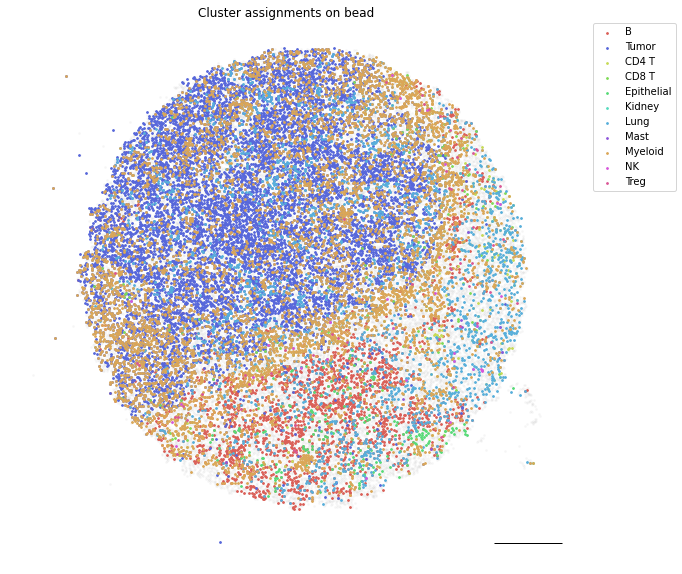

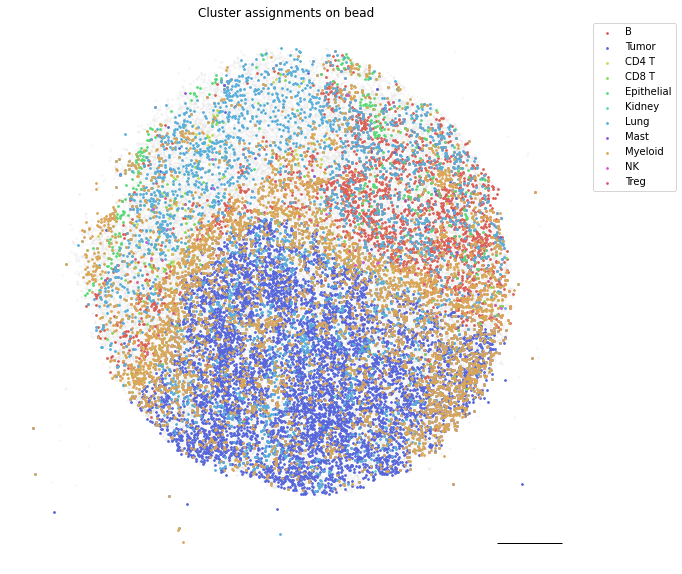

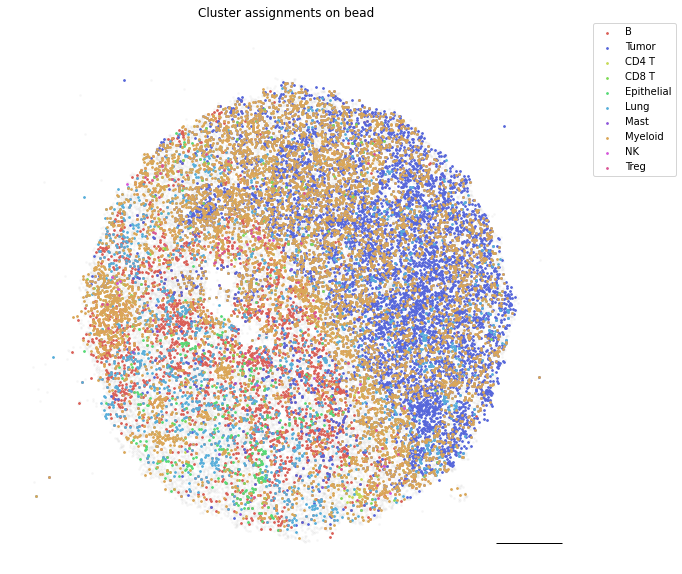

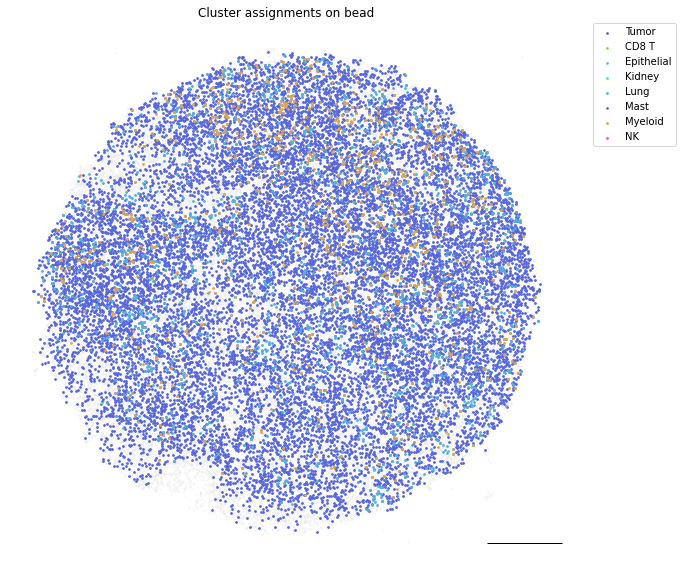

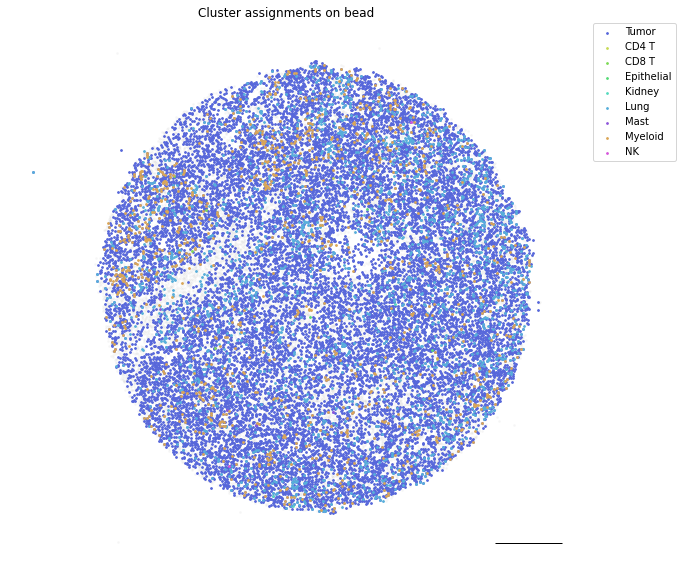

In [81]:
# Plot RCTD
for puck in [puck8, puck9, puck10, puck12, puck13]:

    condensed_cell_type_names = {
        "Bcell": "B",
        "MastCell": "Mast",
        "MyeloidCell_02_CD11c_CD14": "Myeloid",
        "Myeloid_01_CD11c": "Myeloid",
        "Myeloid_03_CD16": "Myeloid",
        "Myeloid_04_CD14_CD16": "Myeloid",
        "Myeloid_DC1_CD141": "Myeloid",
        "Myeloid_pDC": "Myeloid",
        "NK": "NK",
        "NKT": "NK",
        "NonImmuneCell": "Lung",
        "PlasmaCell": "B",
        "Tcell_CD4": "CD4 T",
        "Tcell_CD8": "CD8 T",
        "Tcell_Treg": "Treg",
        "TumorCell_CA9": "Tumor",
        "Kidney_DistalTubule": "Kidney",
        "Kidney_ProximalTubule": "Kidney",
        "Epithelial_EPCAM": "Epithelial",
    }

    point_size = 3

    fig, ax = plt.subplots(figsize=(10, 10))

    gray_filt = puck.s1_dge_fmtd
    plt.scatter(
        [puck.bc_loc_dict_s1[i][0] for i in gray_filt.index],
        [puck.bc_loc_dict_s1[i][1] for i in gray_filt.index],
        s=point_size,
        alpha=0.05,
        c="gray",
    )  # c=list(marco_filt['Marco']),

    fn = "{}rcc_rctd_clusters_{}.csv".format(directory, puck.puck_name)
    cluster_labels = pd.read_csv(fn)
    cluster_labels["cluster"] = cluster_labels["cell_label"]

    cluster_num = len(list(set(cluster_labels.cluster)))

    cell_type_list = sorted(list(set(list(condensed_cell_type_names.values()))))
    # move myeloid to position 1 for coloring and tumor to purple
    cell_type_list.remove("Myeloid")
    cell_type_list.insert(1, "Myeloid")
    cell_type_list.remove("Tumor")
    cell_type_list.insert(7, "Tumor")

    cluster_labels["condensed"] = [
        condensed_cell_type_names[i] for i in cluster_labels["cluster"]
    ]
    colors_to_use_condensed = [
        sns.color_palette("hls", len(cell_type_list))[idx]
        for idx in range(len(cell_type_list))
    ]

    groups = cluster_labels.groupby(
        "cell_label"
    )  # can change to translated to visualize by translation or clonotype
    groups_condensed = cluster_labels.groupby(
        "condensed"
    )  # can change to translated to visualize by translation or clonotype

    ##### CONDENSED VERSIONS

    for name, group in groups_condensed:  # Plot tumor first
        if name in ["Tumor", "B"]:
            plt.scatter(
                group["x"],
                group["y"],
                s=point_size,
                label=name,
                marker="o",
                alpha=1,
                color=colors_to_use_condensed[cell_type_list.index(name)],
            )

    for name, group in groups_condensed:
        if name not in ["Tumor", "B"]:
            plt.scatter(
                group["x"],
                group["y"],
                s=point_size,
                label=name,
                marker="o",
                alpha=1,
                color=colors_to_use_condensed[cell_type_list.index(name)],
            )

    ######
    fontprops = fm.FontProperties(size=18)
    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )

    ax.add_artist(scalebar)

    plt.title("Cluster assignments on bead")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)
    plt.axis("off")
    plt.show()

# Figures 3C and S3B - All clonotypes plotted
- (C) Spatial localization of T cell clonotypes (n=549 clonotypes, colored by clonotype).
- (B) Plot of all clonotypes for pre-treatment (top panel, n=2 replicate arrays) and post-treatment (bottom panel, n=3 replicate arrays) specimens. Clonotype CDR3 sequences were queried in VDJdb (https://vdjdb.cdr3.net/) to identify any with known HLA-matched antigen specificity, among which only rare clonotypes (<3.5% of pre- and post-treatment clonotypes) were identified – the majority of which were annotated as anti-viral specificity and none of which met the criteria for inclusion in the T clonotype analyses.

In [84]:
for puck in [puck12,puck13]:
    puck.cluster_labels = make_knn_assignments(
                "{}/{}".format(directory_slideseq, puck.rctd_fn),
                puck.abbrev_rep_name,
                puck,
                puck.cluster_num_to_name_list,
                puck.cell_type_list,
            )

/home/jupyter/packages/ipykernel_launcher.py:885: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/jupyter/packages/ipykernel_launcher.py:888: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/jupyter/packages/ipykernel_launcher.py:899: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

Begin classifier process


  0%|          | 0/35245 [00:00<?, ?it/s]

  0%|          | 0/3991 [00:00<?, ?it/s]

/home/jupyter/packages/ipykernel_launcher.py:885: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/jupyter/packages/ipykernel_launcher.py:888: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/jupyter/packages/ipykernel_launcher.py:899: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

Begin classifier process


  0%|          | 0/32615 [00:00<?, ?it/s]

  0%|          | 0/4077 [00:00<?, ?it/s]

549 total number of clonotypes on this puck


  0%|          | 0/549 [00:00<?, ?it/s]

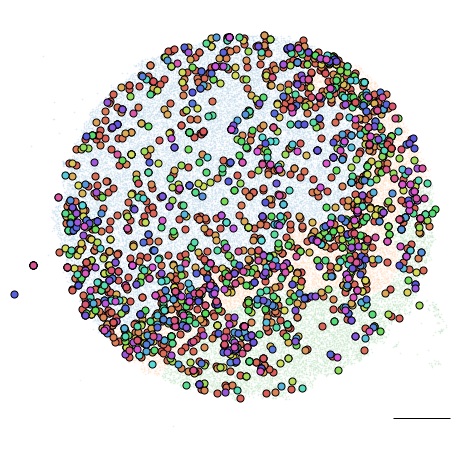

563 total number of clonotypes on this puck


  0%|          | 0/563 [00:00<?, ?it/s]

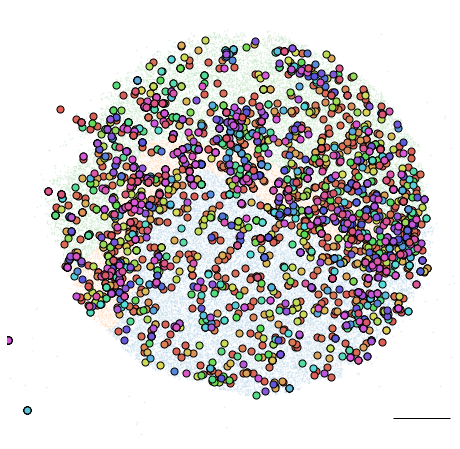

348 total number of clonotypes on this puck


  0%|          | 0/348 [00:00<?, ?it/s]

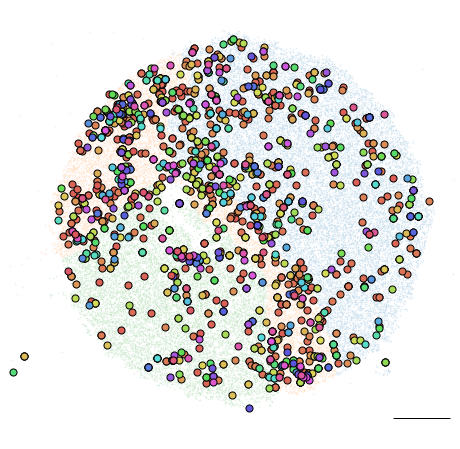

25 total number of clonotypes on this puck


  0%|          | 0/25 [00:00<?, ?it/s]

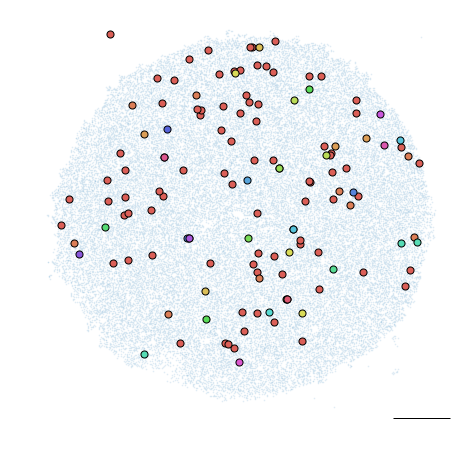

22 total number of clonotypes on this puck


  0%|          | 0/22 [00:00<?, ?it/s]

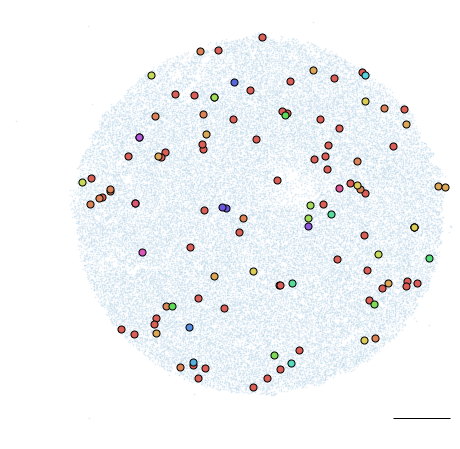

In [85]:
# Plot all clonotypes in different colors
for puck in [puck8, puck9, puck10, puck12, puck13]:

    clonotypes_to_plot = []
    clonotypes_to_plot_names = []
    for cl in puck.tcr_loc_dict_s1_filtered4:
        if cl not in puck.clonotypes["1b"]:
            continue
        if len(puck.tcr_loc_dict_s1_filtered4[cl]) == 0:
            continue
        clonotypes_to_plot = clonotypes_to_plot + [cl]
        clonotypes_to_plot_names.append(cl)

    print(len(clonotypes_to_plot_names), "total number of clonotypes on this puck")

    fig, ax = plt.subplots(figsize=(8, 8))
    t_plotx = [
        j[0]
        for j in [
            i for i in puck.tll_loc_cluster_dict if puck.tll_loc_cluster_dict[i] == "Tumor"
        ]
    ]
    t_ploty = [
        j[1]
        for j in [
            i for i in puck.tll_loc_cluster_dict if puck.tll_loc_cluster_dict[i] == "Tumor"
        ]
    ]
    ax.scatter(t_plotx, t_ploty, s=0.5, alpha=0.1, label="Tumor")

    til_plotx = [
        j[0]
        for j in [
            i
            for i in puck.tll_loc_cluster_dict
            if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
        ]
    ]
    til_ploty = [
        j[1]
        for j in [
            i
            for i in puck.tll_loc_cluster_dict
            if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
        ]
    ]
    ax.scatter(til_plotx, til_ploty, s=0.5, alpha=0.1, label="Immune")

    til_plotx = [
        j[0]
        for j in [
            i for i in puck.tll_loc_cluster_dict if puck.tll_loc_cluster_dict[i] == "Lung"
        ]
    ]
    til_ploty = [
        j[1]
        for j in [
            i for i in puck.tll_loc_cluster_dict if puck.tll_loc_cluster_dict[i] == "Lung"
        ]
    ]
    ax.scatter(til_plotx, til_ploty, s=0.5, alpha=0.1, label="Lung")

    for idx in tqdm(range(len(clonotypes_to_plot))):
        clonotype = clonotypes_to_plot[idx]
        #####
        loc_for_this_cl = list(set(puck.tcr_loc_dict_s1_filtered4[clonotype]))

        x_val = [float(i[0]) for i in loc_for_this_cl]
        y_val = [float(i[1]) for i in loc_for_this_cl]

        plt.scatter(
            x_val,
            y_val,
            label=clonotype,
            color=sns.color_palette("hls", len(clonotypes_to_plot))[idx],
            edgecolors="k",
            linewidth=1,
            s=50,
        )
        plt.xlim(0, 6000)
        plt.ylim(0, 6000)

        plt.axis("off")
    fontprops = fm.FontProperties(size=18)
    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )

    ax.add_artist(scalebar)
    plt.show()

# Figure S3C Plot individual cell types
- (C) RCTD-assigned cell types for RCC plotted individually from the array in Figure 3B. Annotations are from a published RCC scRNA-seq dataset that included this patient’s sample.

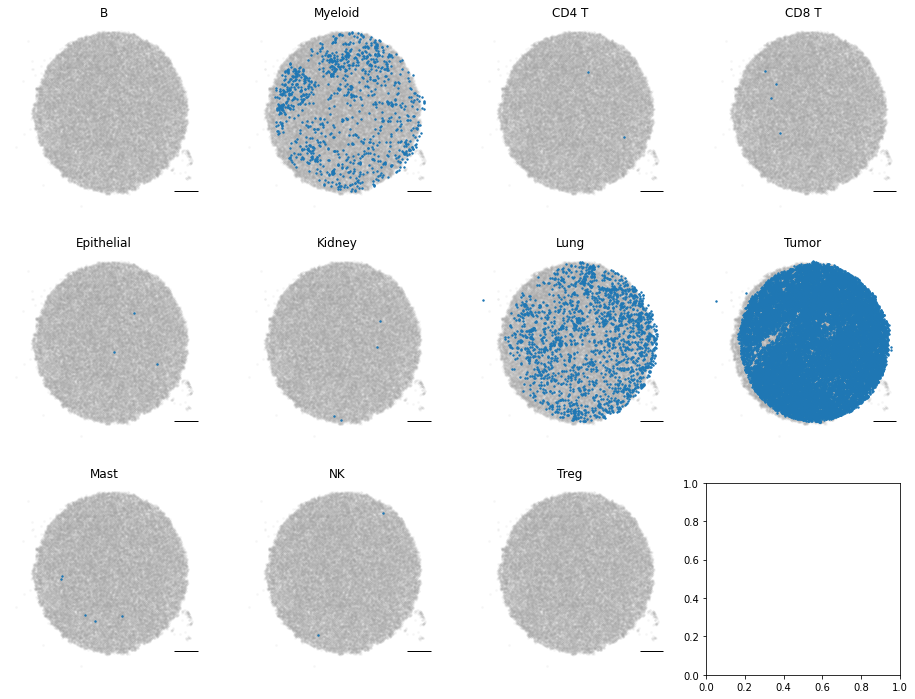

In [86]:
# Plot each cell type individually

puck = puck8
fig, ax = plt.subplots(3, 4, figsize=(8 * 2, 6 * 2))

gray_filt = puck.s1_dge_fmtd
gray_filt_x = [puck.bc_loc_dict_s1[i][0] for i in gray_filt.index]
gray_filt_y = [puck.bc_loc_dict_s1[i][1] for i in gray_filt.index]

for idx, c in enumerate(cell_type_list):
    x = cluster_labels[cluster_labels.condensed == c].x
    y = cluster_labels[cluster_labels.condensed == c].y
    ax[math.floor(idx / 4), idx % 4].scatter(
        gray_filt_x, gray_filt_y, s=3, alpha=0.05, c="gray"
    )
    ax[math.floor(idx / 4), idx % 4].scatter(x, y, s=2)
    ax[math.floor(idx / 4), idx % 4].axis("off")
    fontprops = fm.FontProperties(size=18)
    scalebar = AnchoredSizeBar(
        ax[math.floor(idx / 4), idx % 4].transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )

    ax[math.floor(idx / 4), idx % 4].add_artist(scalebar)

    ax[math.floor(idx / 4), idx % 4].set_title(c)

# Table S6 Clone names and fractions

In [87]:
# To make Supplementary Table 6
tcrs_all = {}
for puck in [puck12, puck13]:
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes["1b"]:
            continue
        if tcr not in tcrs_all:
            tcrs_all[tcr] = []
        tcrs_all[tcr] = tcrs_all[tcr] + list(
            set(puck.tcr_loc_dict_s1_filtered4[tcr])
        )  # fraction of beads, not umis
sum_all = 0
for tcr in tcrs_all:
    sum_all += len(tcrs_all[tcr])

tcr_name = []
fraction_all = []
for tcr in tcrs_all:
    if len(tcrs_all[tcr]) == 0:
        continue
    fraction = len(tcrs_all[tcr]) / sum_all
    #     if fraction > 0.09: #tcr == 'CASSVTGETGELFF':
    # print(fraction,tcr)
    tcr_name.append(tcr)
    fraction_all.append(fraction)

clonotype_fractions = pd.DataFrame.from_dict(
    {"clonotype": tcr_name, "fraction": fraction_all}
)
clonotype_fractions.sort_values("fraction", ascending=False, inplace=True)
clonotype_fractions.reset_index(inplace=True)
clonotype_fractions.drop(columns=["index"], inplace=True)
clonotype_fractions["name"] = [
    "TCR-" + str(i + 1224) for i in clonotype_fractions.index
]
print(len(clonotype_fractions.clonotype))
clonotype_fractions.to_csv(
    "{}pre_treatment_clonotype_fraction_slide_seq.csv".format(directory)
)

# Fraction calculation for betas for each clonotype across all pucks
tcrs_all = {}
for puck in [puck8, puck9, puck10]:
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes["1b"]:
            continue
        if tcr not in tcrs_all:
            tcrs_all[tcr] = []
        tcrs_all[tcr] = tcrs_all[tcr] + list(
            set(puck.tcr_loc_dict_s1_filtered4[tcr])
        )  # fraction of beads, not umis
sum_all = 0
for tcr in tcrs_all:
    sum_all += len(tcrs_all[tcr])

tcr_name = []
fraction_all = []
for tcr in tcrs_all:
    if len(tcrs_all[tcr]) == 0:
        continue
    fraction = len(tcrs_all[tcr]) / sum_all
    #     if fraction > 0.09: #tcr == 'CASSVTGETGELFF':
    # print(fraction,tcr)
    tcr_name.append(tcr)
    fraction_all.append(fraction)

clonotype_fractions = pd.DataFrame.from_dict(
    {"clonotype": tcr_name, "fraction": fraction_all}
)
clonotype_fractions.sort_values("fraction", ascending=False, inplace=True)
clonotype_fractions.reset_index(inplace=True)
clonotype_fractions.drop(columns=["index"], inplace=True)
# clonotype_fractions['name'] = ['TCR-'+str(i+1) for i in clonotype_fractions.index]
clonotype_fractions["name"] = [
    "TCR-" + str(i+1) for i in clonotype_fractions.index
]
print(len(clonotype_fractions.clonotype))
clonotype_fractions.to_csv(
    "{}post_treatment_clonotype_fraction_slide_seq.csv".format(directory)
)

41
1223


# Figure S3 -  Benchmarking Slide-TCR-seq using bulk TCR sequencing data. Related to Figure 3.
- (A) Comparing clonotype fractions for clonotypes with at least 10 counts in Slide-TCR-seq and bulk TCR sequencing of the post-treatment RCC specimen by Pearson’s r.
- (B) Comparing the consistency of UMI counts per clonotype, normalized by total TCR counts, between all three post-treatment arrays by Pearson’s r.
- (C) Cumulative distribution function (CDF) showing the diversity and abundance of the clonotypes in Slide-TCR-seq (top) and bulk TCR sequencing (bottom).
- (D) Comparing the clonotypes in the pre-treatment and post-treatment specimens for bulk TCR (top) and Slide-TCR-seq (bottom).
- (E) Showing the change in clonotype fraction for clonotypes that were shared in pre- and post-treatment in Slide-TCR-seq (left panel) and bulk TCR-seq (right panel; transparency alpha of dots was set at 0.3 to display density).

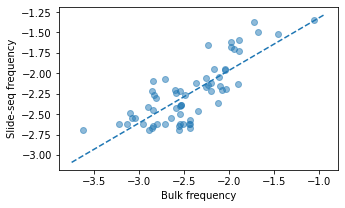

(0.7933825107435202, 8.987989100161693e-15)
SpearmanrResult(correlation=0.7417665173588881, pvalue=3.5345582616144055e-12)


In [88]:
# FIGURE S5A
pre_treatment_df = pd.read_csv(
    '{}pre_treatment_clonotype_fraction_slide_seq.csv'.format(directory))
post_treatment_df = pd.read_csv(
    '{}post_treatment_clonotype_fraction_slide_seq.csv'.format(directory))
post_treatment_df = post_treatment_df[
    post_treatment_df.fraction > 0.00018889308651303364 *
    10]  # To filter for at least 10 counts in Slide-seq

post_treatment_dict = dict(
    zip(post_treatment_df.clonotype, post_treatment_df.fraction))
post_bulk_beta_filt = post_bulk_beta[post_bulk_beta.count_sum >= 10]
post_treatment_dict_bulk = dict(zip(post_bulk_beta_filt.cdr3, post_bulk_beta_filt.Freq))

values_in_slide_seq = []
values_in_bulk = []
for cl in post_treatment_dict:
    if cl in post_treatment_dict_bulk:
        values_in_slide_seq.append(post_treatment_dict[cl])
        values_in_bulk.append(post_treatment_dict_bulk[cl])

x = np.log10(values_in_bulk)
y = np.log10(values_in_slide_seq)
fig, ax = plt.subplots(figsize=(5, 3))
plt.scatter(x, y, alpha=0.5)
x_vals = np.array(ax.get_xlim())
y_vals = scipy.stats.linregress(
    x, y)[1] + scipy.stats.linregress(x, y)[0] * x_vals
ax.plot(x_vals, y_vals, '--')
plt.xlabel('Bulk frequency')
plt.ylabel('Slide-seq frequency')
plt.savefig("./plots/sf4a-bulk.pdf")
plt.show()
print(pearsonr(x, y))
print(scipy.stats.spearmanr(x, y))

r 0.5998745182192742 pval 1.4905649192132037e-14
r 0.5683050774507464 pval 9.684706007812232e-13
r 0.523755859864941 pval 2.2356025457135525e-09


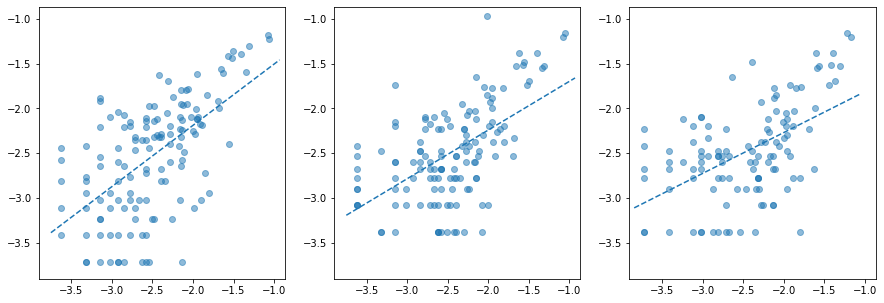

In [89]:
# FIGURE S5B

puck8.total_reads = sum(puck8.s1_total_counts)
puck9.total_reads = sum(puck9.s1_total_counts)
puck10.total_reads = sum(puck10.s1_total_counts)

puck8.total_cl_counts = 0
puck9.total_cl_counts = 0
puck10.total_cl_counts = 0

puck8_umi_cl_counts = []
puck9_umi_cl_counts = []
for cl in puck8.tcr_loc_dict_s1_filtered4:
    if cl in puck9.tcr_loc_dict_s1_filtered4:
        if len(puck8.tcr_loc_dict_s1_filtered4[cl]) <= 0:
            continue
        if len(puck9.tcr_loc_dict_s1_filtered4[cl]) <= 0:
            continue
        puck8.total_cl_counts += len(puck8.tcr_loc_dict_s1_filtered4[cl])
        puck9.total_cl_counts += len(puck9.tcr_loc_dict_s1_filtered4[cl])
        puck8_umi_cl_counts.append(len(puck8.tcr_loc_dict_s1_filtered4[cl]))
        puck9_umi_cl_counts.append(len(puck9.tcr_loc_dict_s1_filtered4[cl]))

puck8_umi_cl_counts_vs10 = []
puck10_umi_cl_counts = []
for cl in puck8.tcr_loc_dict_s1_filtered4:
    if cl in puck10.tcr_loc_dict_s1_filtered4:
        if len(puck8.tcr_loc_dict_s1_filtered4[cl]) <= 0:
            continue
        if len(puck10.tcr_loc_dict_s1_filtered4[cl]) <= 0:
            continue
        puck8_umi_cl_counts_vs10.append(
            len(puck8.tcr_loc_dict_s1_filtered4[cl]))
        puck10.total_cl_counts += len(puck10.tcr_loc_dict_s1_filtered4[cl])
        puck10_umi_cl_counts.append(len(puck10.tcr_loc_dict_s1_filtered4[cl]))

puck9_umi_cl_counts_vs10 = []
puck10_umi_cl_counts_vs9 = []
for cl in puck9.tcr_loc_dict_s1_filtered4:
    if cl in puck10.tcr_loc_dict_s1_filtered4:
        if len(puck9.tcr_loc_dict_s1_filtered4[cl]) <= 0:
            continue
        if len(puck10.tcr_loc_dict_s1_filtered4[cl]) <= 0:
            continue

        puck9_umi_cl_counts_vs10.append(
            len(puck9.tcr_loc_dict_s1_filtered4[cl]))
        puck10_umi_cl_counts_vs9.append(
            len(puck10.tcr_loc_dict_s1_filtered4[cl]))

puck8_umi_cl_counts = normalize_by_total_reads(puck8_umi_cl_counts,
                                               puck8.total_cl_counts)
puck8_umi_cl_counts_vs10 = normalize_by_total_reads(puck8_umi_cl_counts_vs10,
                                                    puck8.total_cl_counts)
puck9_umi_cl_counts = normalize_by_total_reads(puck9_umi_cl_counts,
                                               puck9.total_cl_counts)
puck9_umi_cl_counts_vs10 = normalize_by_total_reads(puck9_umi_cl_counts_vs10,
                                                    puck9.total_cl_counts)
puck10_umi_cl_counts = normalize_by_total_reads(puck10_umi_cl_counts,
                                                puck10.total_cl_counts)
puck10_umi_cl_counts_vs9 = normalize_by_total_reads(puck10_umi_cl_counts_vs9,
                                                    puck10.total_cl_counts)

puck8_umi_cl_counts = np.log10(puck8_umi_cl_counts)
puck9_umi_cl_counts = np.log10(puck9_umi_cl_counts)
puck10_umi_cl_counts = np.log10(puck10_umi_cl_counts)
puck8_umi_cl_counts_vs10 = np.log10(puck8_umi_cl_counts_vs10)
puck9_umi_cl_counts_vs10 = np.log10(puck9_umi_cl_counts_vs10)
puck10_umi_cl_counts_vs9 = np.log10(puck10_umi_cl_counts_vs9)

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
ax1.scatter(puck8_umi_cl_counts,
            puck9_umi_cl_counts,
            label="8 vs 9",
            alpha=0.5)
ax2.scatter(puck8_umi_cl_counts_vs10,
            puck10_umi_cl_counts,
            label="8 vs 10",
            alpha=0.5)
ax3.scatter(puck9_umi_cl_counts_vs10,
            puck10_umi_cl_counts_vs9,
            label="9 vs 10",
            alpha=0.5)
# plt.legend()

abline(
    scipy.stats.linregress(puck8_umi_cl_counts, puck9_umi_cl_counts)[0],
    scipy.stats.linregress(puck8_umi_cl_counts, puck9_umi_cl_counts)[1],
    ax_name=ax1,
)
abline(
    scipy.stats.linregress(puck8_umi_cl_counts_vs10, puck10_umi_cl_counts)[0],
    scipy.stats.linregress(puck8_umi_cl_counts_vs10, puck10_umi_cl_counts)[1],
    ax_name=ax2,
)
abline(
    scipy.stats.linregress(puck9_umi_cl_counts_vs10,
                           puck10_umi_cl_counts_vs9)[0],
    scipy.stats.linregress(puck9_umi_cl_counts_vs10,
                           puck10_umi_cl_counts_vs9)[1],
    ax_name=ax3,
)

print(
    "r",
    scipy.stats.linregress(puck8_umi_cl_counts, puck9_umi_cl_counts)[2],
    "pval",
    scipy.stats.linregress(puck8_umi_cl_counts, puck9_umi_cl_counts)[3],
)
print(
    "r",
    scipy.stats.linregress(puck8_umi_cl_counts_vs10, puck10_umi_cl_counts)[2],
    "pval",
    scipy.stats.linregress(puck8_umi_cl_counts_vs10, puck10_umi_cl_counts)[3],
)
print(
    "r",
    scipy.stats.linregress(puck9_umi_cl_counts_vs10,
                           puck10_umi_cl_counts_vs9)[2],
    "pval",
    scipy.stats.linregress(puck9_umi_cl_counts_vs10,
                           puck10_umi_cl_counts_vs9)[3],
)

args = (
    puck9_umi_cl_counts_vs10,
    puck10_umi_cl_counts_vs9,
    puck8_umi_cl_counts_vs10,
    puck10_umi_cl_counts,
    puck8_umi_cl_counts,
    puck9_umi_cl_counts,
)
all_counts = np.concatenate(args)

max_val = max(all_counts)
min_val = min(all_counts)
for ax in [ax1,ax2,ax3]:
    ax.set_xlim([min_val * 1.05, max_val * 0.9])
    ax.set_ylim([min_val * 1.05, max_val * 0.9])
plt.savefig('./plots/sf4b.pdf')
plt.show()

<Figure size 432x288 with 0 Axes>

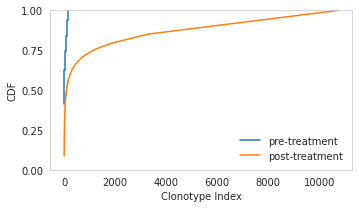

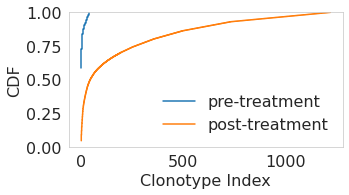

In [90]:
# FIGURE S5C

######## BULK
# Histogram of percent of all beads vs clonotype
plt.figure()
pre_bulk_cdf = list(pre_bulk_beta.sort_values("Freq", ascending=False).cumsum()["Freq"])
post_bulk_cdf = list(
    post_bulk_beta.sort_values("Freq", ascending=False).cumsum()["Freq"]
)
sns.set_style("whitegrid", {"axes.grid": False})

plt.figure(figsize=(5, 3))
plt.step(range(len(pre_bulk_cdf)), pre_bulk_cdf, label="pre-treatment")
plt.step(range(len(post_bulk_cdf)), post_bulk_cdf, label="post-treatment")
plt.ylim([0, 1])
plt.xlabel("Clonotype Index")
plt.ylabel("CDF")
plt.legend(frameon=False)
plt.tight_layout()
plt.savefig('./plots/sf4c.pdf')

######## SLIDE-SEQ

pre_treatment_df = pd.read_csv(
    "{}pre_treatment_clonotype_fraction_slide_seq.csv".format(directory)
)
post_treatment_df = pd.read_csv(
    "{}post_treatment_clonotype_fraction_slide_seq.csv".format(directory)
)

# Histogram of percent of all beads vs clonotype
plt.rcParams.update({"font.size": 16})

plt.figure(figsize=(5, 3))
plt.step(
    range(len(np.cumsum(pre_treatment_df.fraction))),
    np.cumsum(pre_treatment_df.fraction),
    label="pre-treatment",
)
plt.step(
    range(len(np.cumsum(post_treatment_df.fraction))),
    np.cumsum(post_treatment_df.fraction),
    label="post-treatment",
)
plt.ylim([0, 1])
plt.xlabel("Clonotype Index")
plt.ylabel("CDF")
plt.legend(frameon=False)
plt.tight_layout()
plt.savefig("./plots/figure3c.pdf")

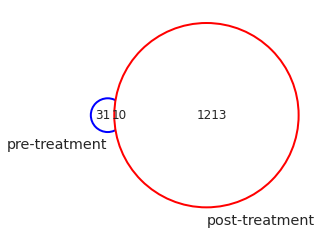

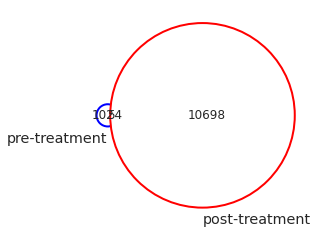

In [91]:
# FIGURE S5D
pre_treatment_df = pd.read_csv(
    "{}pre_treatment_clonotype_fraction_slide_seq.csv".format(directory)
)
post_treatment_df = pd.read_csv(
    "{}post_treatment_clonotype_fraction_slide_seq.csv".format(directory)
)

clono_vd(
    list(pre_treatment_df.clonotype),
    list(post_treatment_df.clonotype),
    ("pre-treatment", "post-treatment"),
    filename="{}Supplementary Figure 5B_slide_seq.pdf".format(directory),
)
clono_vd(
    list(pre_bulk_beta.cdr3),
    list(post_bulk_beta.cdr3),
    ("pre-treatment", "post-treatment"),
    filename="{}Supplementary Figure 5B_bulk.pdf".format(directory),
)

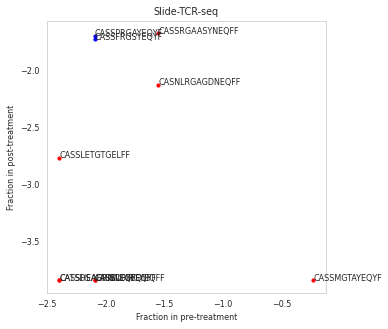

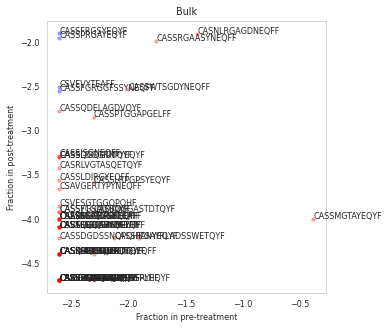

In [92]:
# FIGURE S5E

plt.rcParams.update({"font.size": 8})
shared_test = list(set(pre_treatment_df.clonotype) & set(post_treatment_df.clonotype))
x = []
y = []
for i in shared_test:
    x.append(float(pre_treatment_df[pre_treatment_df.clonotype == i].fraction))
    y.append(float(post_treatment_df[post_treatment_df.clonotype == i].fraction))

x_pre_higher = []
y_pre_higher = []
x_post_higher = []
y_post_higher = []

for (xid, yid) in zip(x, y):
    if xid > yid:
        x_pre_higher.append(xid)
        y_pre_higher.append(yid)
    else:
        x_post_higher.append(xid)
        y_post_higher.append(yid)

x_pre_higher = np.log10(x_pre_higher)
y_pre_higher = np.log10(y_pre_higher)
x_post_higher = np.log10(x_post_higher)
y_post_higher = np.log10(y_post_higher)

fig, ax = plt.subplots(figsize=(5, 5))
plt.scatter(
    x_pre_higher,
    y_pre_higher,
    c="red",
    s=10,
    label="Higher clonotype fraction in pre-treatment",
)
plt.scatter(
    x_post_higher,
    y_post_higher,
    c="blue",
    s=10,
    label="Higher clonotype fraction in post-treatment",
)
plt.title("Slide-TCR-seq")
for i, txt in enumerate(shared_test):
    # ax.annotate(txt, (x[i], y[i]))
    ax.annotate(txt, (np.log10(x[i]), np.log10(y[i])))
plt.xlabel("Fraction in pre-treatment")
plt.ylabel("Fraction in post-treatment")
plt.savefig('./plots/sf4e_slideseq.pdf')

#### BULK
# PLOT CHANGES IN CLONOTYPE FRACTIONS FOR SHARED CLONOTYPES AND ALL CLONOTYPES for slide-seq and bulk
plt.rcParams.update({"font.size": 8})
shared_test = list(set(pre_bulk_beta.cdr3) & set(post_bulk_beta.cdr3))
x = []
y = []
for i in shared_test:
    x.append(float(pre_bulk_beta[pre_bulk_beta.cdr3 == i].Freq))
    y.append(float(post_bulk_beta[post_bulk_beta.cdr3 == i].Freq))

x_pre_higher = []
y_pre_higher = []
x_post_higher = []
y_post_higher = []

for (xid, yid) in zip(x, y):
    if xid > yid:
        x_pre_higher.append(xid)
        y_pre_higher.append(yid)
    else:
        x_post_higher.append(xid)
        y_post_higher.append(yid)

x_pre_higher = np.log10(x_pre_higher)
y_pre_higher = np.log10(y_pre_higher)
x_post_higher = np.log10(x_post_higher)
y_post_higher = np.log10(y_post_higher)

fig, ax = plt.subplots(figsize=(5, 5))
# plt.scatter(x,y)
plt.scatter(
    x_pre_higher,
    y_pre_higher,
    c="red",
    s=10,
    label="Higher clonotype fraction in pre-treatment",
    alpha=0.3,
)
plt.scatter(
    x_post_higher,
    y_post_higher,
    c="blue",
    s=10,
    label="Higher clonotype fraction in post-treatment",
    alpha=0.3,
)
plt.title("Bulk")
for i, txt in enumerate(shared_test):
    # ax.annotate(txt, (x[i], y[i]))
    ax.annotate(txt, (np.log10(x[i]), np.log10(y[i])))
plt.xlabel("Fraction in pre-treatment")
plt.ylabel("Fraction in post-treatment")
plt.savefig('./plots/sf4e_bulk.pdf')

# Figures 3B and S4E - Compartment visualization

- (B) Compartment assignment of the lung (green), boundary (orange), and tumor (blue) of the array from Figure 3A. by applying K-nearest neighbors to cell types determined by unsupervised clustering. 
- (E) Cell compartment assignment for each array.

  0%|          | 0/3 [00:00<?, ?it/s]

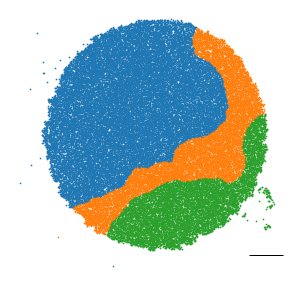

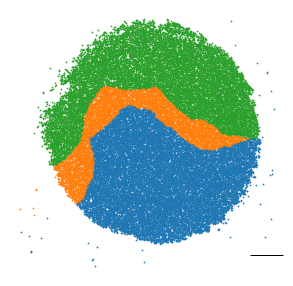

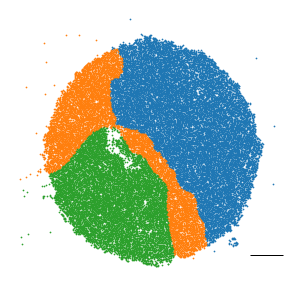

In [93]:
# Plot cell type compartments

for puck in tqdm([puck8, puck9, puck10]):
    fig, ax = plt.subplots(figsize=(5, 5))
    puck.tumor_beads = [
        i for i in puck.tll_loc_cluster_dict if puck.tll_loc_cluster_dict[i] == "Tumor"
    ]

    puck.til_beads = [
        i
        for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
    ]

    puck.lung_beads = [
        i for i in puck.tll_loc_cluster_dict if puck.tll_loc_cluster_dict[i] == "Lung"
    ]

    plt.scatter(
        [i[0] for i in puck.tumor_beads],
        [i[1] for i in puck.tumor_beads],
        label="tumor",
        s=0.5,
        alpha=1,
        color=sns.color_palette()[0],
    )
    plt.scatter(
        [i[0] for i in puck.til_beads],
        [i[1] for i in puck.til_beads],
        label="tll",
        s=0.5,
        alpha=1,
        color=sns.color_palette()[1],
    )
    plt.scatter(
        [i[0] for i in puck.lung_beads],
        [i[1] for i in puck.lung_beads],
        label="lung",
        s=0.5,
        alpha=1,
        color=sns.color_palette()[2],
    )

    plt.axis("off")
    fontprops = fm.FontProperties(size=18)
    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )
    ax.add_artist(scalebar)

    plt.show()

# Figures 3D and S3F - Plotting RCC subtypes
- (D) Within-tumor spatial localization of 3 distinct RCC cell subtypes. 
- (F) Within-tumor spatial localization of 3 distinct RCC cell subtypes across pre- and post-treatment arrays.

In [101]:
harlequin_df = pd.read_csv('./rcc_08_harl.csv')
cycling_df = pd.read_csv('./rcc_08_rcc_cells.csv')
cells_df = pd.read_csv('./rcc_08_five_cells.csv')

RCC1
RCC2
cycRCC


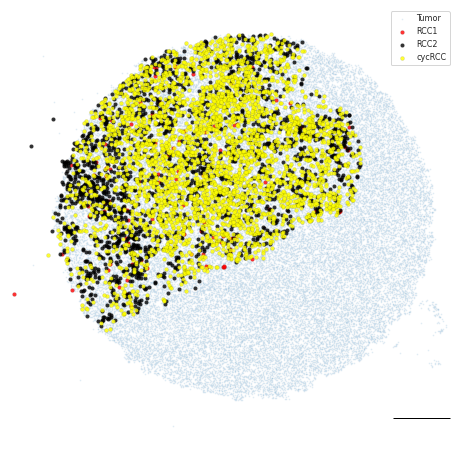

RCC1
RCC2
cycRCC


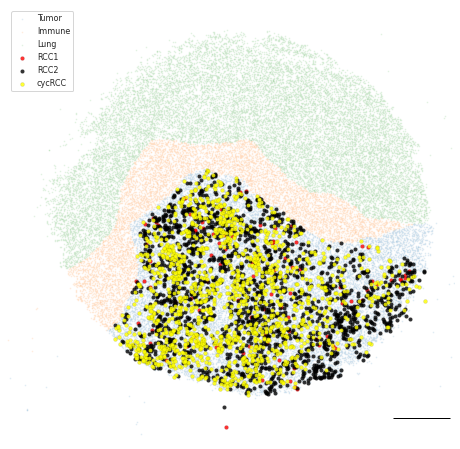

RCC1
RCC2
cycRCC


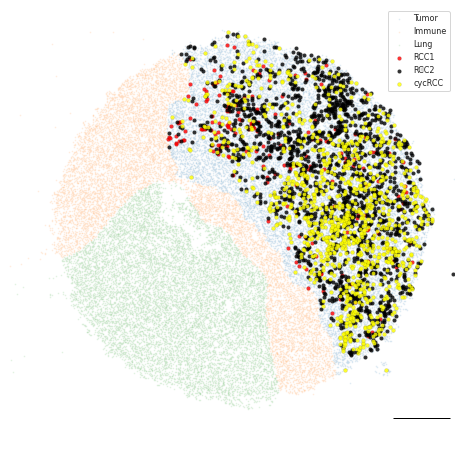

RCC1
RCC2
cycRCC


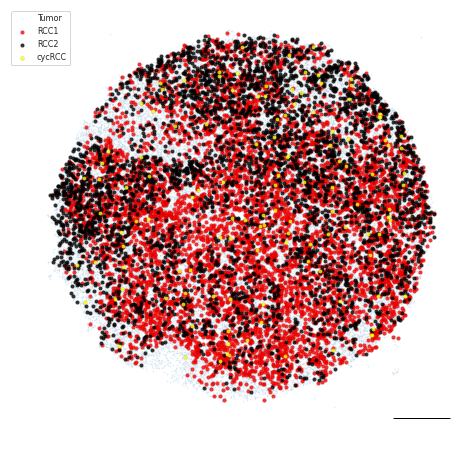

RCC1
RCC2
cycRCC


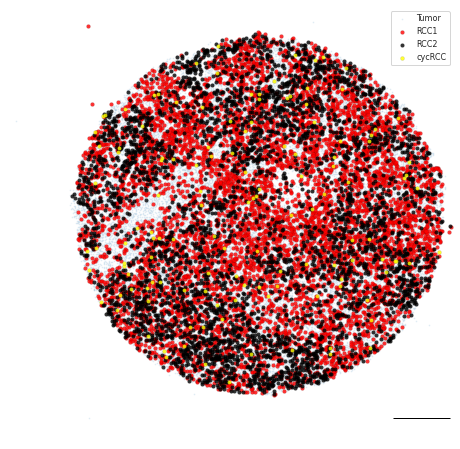

In [108]:
# FIGURE 3E
# Plot all clonotypes in different colors

for puck, name in zip([puck8, puck9, puck10, puck12, puck13],['08','09','10','12','13']):
    cycling_df = pd.read_csv(f'./rcc_{name}_rcc_cells.csv')

    fig, ax = plt.subplots(figsize=(8, 8))
    if puck in [puck9,puck10]:
        t_plotx = [
            j[0] for j in [
                i for i in puck.tll_loc_cluster_dict
                if puck.tll_loc_cluster_dict[i] == "Tumor"
            ]
        ]
        t_ploty = [
            j[1] for j in [
                i for i in puck.tll_loc_cluster_dict
                if puck.tll_loc_cluster_dict[i] == "Tumor"
            ]
        ]
        ax.scatter(t_plotx, t_ploty, s=0.5, alpha=0.1, label="Tumor")

        til_plotx = [
            j[0] for j in [
                i for i in puck.tll_loc_cluster_dict
                if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
            ]
        ]
        til_ploty = [
            j[1] for j in [
                i for i in puck.tll_loc_cluster_dict
                if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
            ]
        ]
        ax.scatter(til_plotx, til_ploty, s=0.5, alpha=0.1, label="Immune")

        til_plotx = [
            j[0] for j in [
                i for i in puck.tll_loc_cluster_dict
                if puck.tll_loc_cluster_dict[i] == "Lung"
            ]
        ]
        til_ploty = [
            j[1] for j in [
                i for i in puck.tll_loc_cluster_dict
                if puck.tll_loc_cluster_dict[i] == "Lung"
            ]
        ]
        ax.scatter(til_plotx, til_ploty, s=0.5, alpha=0.1, label="Lung")
    else:
        locx = [i[0] for i in puck.loc_to_bc_s1]
        locy = [i[1] for i in puck.loc_to_bc_s1]
        ax.scatter(locx,locy, s=0.5, alpha=0.1, label="Tumor")

    plt.xlim(0, 6000)
    plt.ylim(0, 6000)

    plt.axis("off")
    fontprops = fm.FontProperties(size=18)
    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )

    ax.add_artist(scalebar)

    color_dict = ['red','black', 'yellow']
    ctypes = ['RCC1','RCC2','cycRCC']
    for idx in range(len(ctypes)):
        i = ctypes[idx]
        print(i)
        if puck in [puck8, puck9,puck10]:
            in_tumor = cycling_df[cycling_df.tissue == 'Tumor']
            x = in_tumor[in_tumor.first_type == i].xcoord
            y = in_tumor[in_tumor.first_type == i].ycoord
        else:
            x = cycling_df[cycling_df.first_type==i].xcoord
            y = cycling_df[cycling_df.first_type==i].ycoord
        plt.scatter(x,
                    y,
                    s=15,
                    label=i,
                    color=color_dict[idx],
                    alpha=0.8,
                    edgecolors='k',
                    linewidth=0.1)
    plt.legend()
    plt.show()


# Figure 3E non-tumor, non-T cell types in RCC
- (E) Within-tumor spatial localization of the five most abundant non-tumor non-T cell types as determined by RCTD and using the combination of five scRNA-seq datasets as reference. DC = dendritic cell.

Endothelial
B
DC
Fibroblast
Macrophage


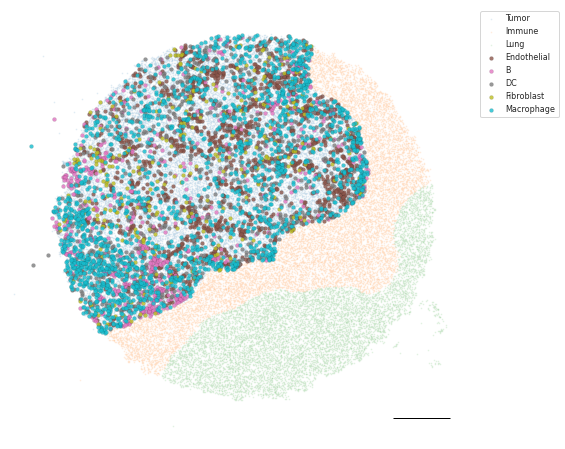

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [109]:
# FIGURE 3E
puck = puck8

fig, ax = plt.subplots(figsize=(8, 8))
t_plotx = [
    j[0] for j in [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == "Tumor"
    ]
]
t_ploty = [
    j[1] for j in [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == "Tumor"
    ]
]
ax.scatter(t_plotx, t_ploty, s=0.5, alpha=0.1, label="Tumor")

til_plotx = [
    j[0] for j in [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
    ]
]
til_ploty = [
    j[1] for j in [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
    ]
]
ax.scatter(til_plotx, til_ploty, s=0.5, alpha=0.1, label="Immune")

til_plotx = [
    j[0] for j in [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == "Lung"
    ]
]
til_ploty = [
    j[1] for j in [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == "Lung"
    ]
]
ax.scatter(til_plotx, til_ploty, s=0.5, alpha=0.1, label="Lung")

plt.xlim(0, 6000)
plt.ylim(0, 6000)

plt.axis("off")
fontprops = fm.FontProperties(size=18)
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)

ax.add_artist(scalebar)

color_dict = sns.color_palette()[5:]
ctypes = list(set(cells_df['Cell Types']))
for idx in range(len(ctypes)):
    i = ctypes[idx]
    print(i)
    in_tumor = cells_df[cells_df.tissue == 'Tumor']
    x = in_tumor[in_tumor['Cell Types'] == i].xcoord
    y = in_tumor[in_tumor['Cell Types'] == i].ycoord
    plt.scatter(x,
                y,
                s=15,
                label=i,
                color=color_dict[idx],
                alpha=0.8,
                edgecolors='k',
                linewidth=0.1)
plt.legend(bbox_to_anchor = (1.05,1))
plt.show()
sns.color_palette()

# Figures 3F and S4F-G - Spatial enrichment analysis
- (F) Top: Significance of clonotype spatial distributions compared against all other clonotypes with at least ten beads per array from the post-treatment specimen plotted against tumor enrichment (n=3 serial arrays, two one-tailed K-S tests) with Bottom: Visualization of selected significant clonotypes, ordered by tumor enrichment, in tissue compartments for a single array (T cells within the tumor compartment are displayed as opaque, T cells within other compartments are shown as translucent).
- (B) Significance of clonotype spatial distributions compared against all other clonotypes from the post-treatment specimen plotted against lung enrichment (n=3 replicate arrays). Each color represents one clonotype. Grey dots indicate clonotypes that were not significantly enriched.
- (C) Visualization of select clonotypes that are significantly enriched or depleted in the tumor compartment for each post-treatment array. T cells within the tumor compartment are displayed as opaque, and T cells within other compartments are shown as translucent.

In [110]:
# Aggregate all pucks

cl_agg_enrichment = {}
compartments = ["Tumor", "Lung", "TIL"]
for i in compartments:
    cl_agg_enrichment[i] = {}

add_cp_puck(puck8, cl_agg_enrichment)
add_cp_puck(puck9, cl_agg_enrichment)
add_cp_puck(puck10, cl_agg_enrichment)

# Take mean for each clonotype
for c in compartments:
    cl_agg_enrichment[c] = {
        i: np.mean(cl_agg_enrichment[c][i]) for i in cl_agg_enrichment[c]
    }

In [111]:
# Boundary-based distance testing
# Only look at TCR betas with at least 10 beads.
# Compare against all other beads.
analyze_tumor = True
bin_them=False

if analyze_tumor:
    num_bins = 10
    show_plot = False
    aggregated_distribution_for_this_cl = {}
    aggregated_p_values_greater = {}
    aggregated_p_values_less = {}
    num_counts = {}
    for puck in [puck8, puck9, puck10]:
        # Try distance from boundary instead
        distance_vectors_for_cls = {}
        aggregate_distance = []
        for cl in tqdm(puck.tcr_loc_dict_s1_filtered4):
            if cl not in puck.clonotypes["1b"]:
                continue
            all_pts = list(set(puck.tcr_loc_dict_s1_filtered4[cl]))

            distance_distribution = [
                distance_between_points(pt, closest_node(pt, puck.boundary_points))
                for pt in all_pts
                if pt in puck.tumor_beads
            ]
            # if you want to include the distance not in tumor
            distance_distribution = distance_distribution + [
                -distance_between_points(pt, closest_node(pt, puck.boundary_points))
                for pt in all_pts
                if pt not in puck.tumor_beads
            ]

            if cl not in num_counts:
                num_counts[cl] = 0
            num_counts[cl] += len(all_pts)

            if len(all_pts) < 10:
                aggregate_distance = aggregate_distance + distance_distribution
                continue
            distance_vectors_for_cls[cl] = distance_distribution
            aggregate_distance = aggregate_distance + distance_distribution

        print(len(aggregate_distance))

        for cl in distance_vectors_for_cls:
            if cl not in aggregated_p_values_greater:
                aggregated_p_values_greater[cl] = []
            if cl not in aggregated_p_values_less:
                aggregated_p_values_less[cl] = []
            if bin_them is False:
                aggregate_distance_for_this_cl = copy.deepcopy(aggregate_distance)
            aggregate_distance_for_this_cl = list(aggregate_distance_for_this_cl)
            for i in distance_vectors_for_cls[cl]:  # remove clonotype you're testing
                aggregate_distance_for_this_cl.remove(i)
            aggregated_distribution_for_this_cl[cl] = aggregate_distance_for_this_cl

            if show_plot:
                plt.figure()
                plt.title(cl)
                plt.hist(
                    distance_vectors_for_cls[cl],
                    alpha=0.5,
                    density=True,
                    range=(min_val, max_val),
                    bins=20,
                )
                plt.hist(
                    aggregate_distance_for_this_cl,
                    alpha=0.5,
                    density=True,
                    range=(min_val, max_val),
                    bins=20,
                )

            min_val = min(min(distance_vectors_for_cls[cl]), min(aggregate_distance))
            max_val = max(max(distance_vectors_for_cls[cl]), max(aggregate_distance))
            aggregated_p_values_greater[cl].append(
                kstest(
                    distance_vectors_for_cls[cl],
                    aggregate_distance_for_this_cl,
                    alternative="less",
                )[1]
            )
            aggregated_p_values_less[cl].append(
                kstest(
                    distance_vectors_for_cls[cl],
                    aggregate_distance_for_this_cl,
                    alternative="greater",
                )[1]
            )
            print(
                cl,
                kstest(
                    distance_vectors_for_cls[cl],
                    aggregate_distance_for_this_cl,
                    alternative="less",
                )[1],
            )
            print(
                cl,
                ttest_ind(distance_vectors_for_cls[cl], aggregate_distance_for_this_cl)[
                    1
                ],
            )

  0%|          | 0/1010 [00:00<?, ?it/s]

2404
CSARDPGPDTQYF 0.6943534213677933
CSARDPGPDTQYF 0.1818013583219689
CASSQGLAGVLGQFF 0.37672784425741773
CASSQGLAGVLGQFF 0.29034170879225163
CASSPRTSGRYNEQFF 0.000647684596349112
CASSPRTSGRYNEQFF 0.10297924782509922
CASSVTGETGELFF 0.09232405071740166
CASSVTGETGELFF 0.5362907971648029
CASRVQGGPGANVLTF 0.04888625050894757
CASRVQGGPGANVLTF 0.13691334000827404
CASSPYHSSGGETQYF 0.00548408123333829
CASSPYHSSGGETQYF 0.06601306293266475
CASSPTVYNEQFF 0.04023580933937363
CASSPTVYNEQFF 0.09118503749322657
CASSPRGAYEQYF 0.4569932736363939
CASSPRGAYEQYF 0.942226081909989
CASSFRGSYEQYF 0.4377543402271053
CASSFRGSYEQYF 0.4203103761368854
CASSRGAASYNEQFF 0.7957856275139676
CASSRGAASYNEQFF 0.21896089412527175
CASRQGNTEAFF 0.06983197910357938
CASRQGNTEAFF 0.17378495829467763
CASRGQGGYNSPLHF 0.8574722146136442
CASRGQGGYNSPLHF 0.33342286810599
CASRGAHSNQPQHF 0.04417617376524574
CASRGAHSNQPQHF 0.10769580520819381
CASSSSDRGYQETQYF 0.6233487336511288
CASSSSDRGYQETQYF 0.0692230736731643
CSASVYGPSYEQYF 0.63

  0%|          | 0/1022 [00:00<?, ?it/s]

3013
CSARDPGPDTQYF 0.1372280726214055
CSARDPGPDTQYF 0.761932129264481
CASSPRTSGRYNEQFF 0.5229291557722092
CASSPRTSGRYNEQFF 0.49713230153058996
CASSQGLAGVLGQFF 0.7924312730547033
CASSQGLAGVLGQFF 0.6387411695049228
CASRVQGGPGANVLTF 0.14238857265704158
CASRVQGGPGANVLTF 0.4991614076578268
CASSPTVYNEQFF 0.13184751832962546
CASSPTVYNEQFF 0.11143046878882616
CASSVAVLNTEAFF 0.0829664293606278
CASSVAVLNTEAFF 0.01354187249505021
CASSPRGAYEQYF 0.008090001120533909
CASSPRGAYEQYF 0.0068778652365109934
CASSFRGSYEQYF 0.07461880021945096
CASSFRGSYEQYF 0.8362465768490198
CASSPYHSSGGETQYF 0.1180022451111431
CASSPYHSSGGETQYF 0.24076344135417524
CASSDWAGSTDTQYF 0.4240573033119479
CASSDWAGSTDTQYF 0.23397334517434357
CASSRGAASYNEQFF 0.23014855265852027
CASSRGAASYNEQFF 0.8940687915510019
CASSVTGETGELFF 0.059066901664685645
CASSVTGETGELFF 0.15477604955501992
CASSTTGGIHEQFF 0.9959173956017828
CASSTTGGIHEQFF 0.014724274118265709
CASSPTGGAPGELFF 0.7393689082209085
CASSPTGGAPGELFF 0.7478092041128618
CASSLSRTGGAGG

  0%|          | 0/673 [00:00<?, ?it/s]

1589
CASSQGLAGVLGQFF 0.12804501235506432
CASSQGLAGVLGQFF 0.18138363372345853
CSARDPGPDTQYF 0.9854309423350404
CSARDPGPDTQYF 0.03858056487643073
CASSPRTSGRYNEQFF 0.10902268365255892
CASSPRTSGRYNEQFF 0.30702185689728345
CASSRGAASYNEQFF 0.9718204472456313
CASSRGAASYNEQFF 0.002278791740498098
CASSVTGETGELFF 0.1771530885936403
CASSVTGETGELFF 0.7813679325436651
CASSPYHSSGGETQYF 0.026185246250728364
CASSPYHSSGGETQYF 0.32165806805045893
CASRVQGGPGANVLTF 0.17691086892641475
CASRVQGGPGANVLTF 0.12195017902815701
CSARDPAQGITGELFF 0.27119890051896806
CSARDPAQGITGELFF 0.6400736945063161
CASSPTVYNEQFF 0.6385638708769961
CASSPTVYNEQFF 0.9588752732334834
CASMRDRGKGYNEQFF 0.022174496424158457
CASMRDRGKGYNEQFF 0.049892163221330846
CASSPRGAYEQYF 0.791191125222979
CASSPRGAYEQYF 0.5233561854047879
CASSSSLGLAGANEQFF 0.3339515398945528
CASSSSLGLAGANEQFF 0.5926850214844136
CASSFRGSYEQYF 0.33759258985965557
CASSFRGSYEQYF 0.9920687295565441
CASFKGTGRPNTEAFF 0.19610893861637105
CASFKGTGRPNTEAFF 0.3899572839933620

/home/jupyter/packages/numpy/core/_asarray.py:102: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order)
/home/jupyter/packages/numpy/core/_asarray.py:102: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order)


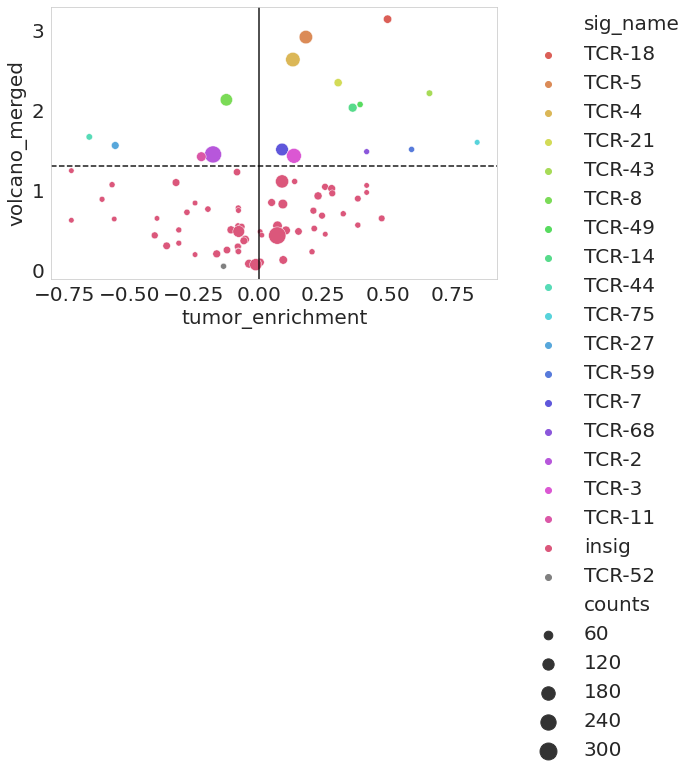

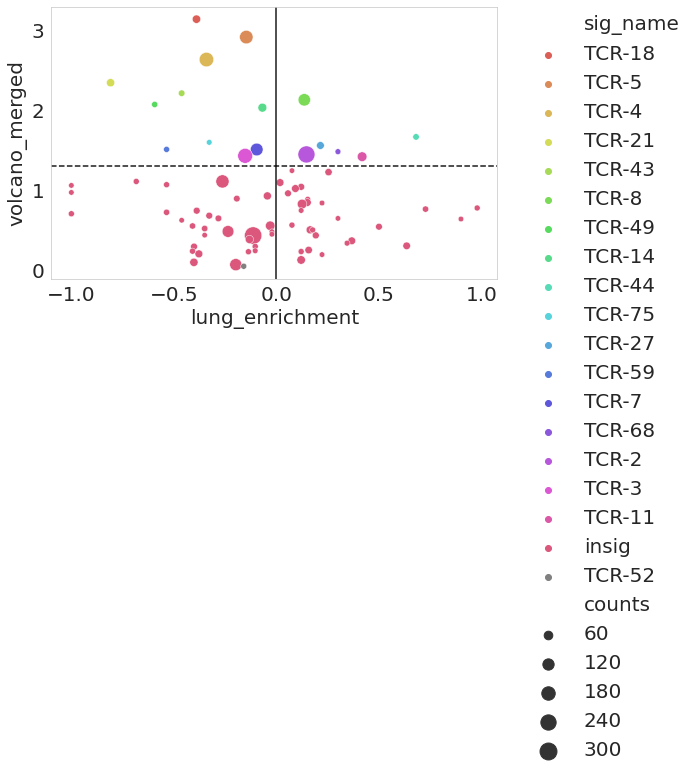

In [112]:
# Make plot
aggregated_p_values_greater_adj = {}
aggregated_p_values_less_adj = {}
cls_to_look_at = list(aggregated_p_values_greater.keys())
for cl in cls_to_look_at:
    aggregated_p_values_greater_adj[cl] = scipy.stats.combine_pvalues(
        aggregated_p_values_greater[cl]
    )[1]
    aggregated_p_values_less_adj[cl] = scipy.stats.combine_pvalues(
        aggregated_p_values_less[cl]
    )[1]

# Adjust p values
all_p_vals = list(aggregated_p_values_greater_adj.values())

pvalue_greater = [
    -np.log10(aggregated_p_values_greater_adj[cl]) for cl in cls_to_look_at
]
pvalue_greater_adjusted = [
    -np.log10(i)
    for i in statsmodels.stats.multitest.multipletests(all_p_vals, method="fdr_bh")[1]
]

pvalue_less = [-np.log10(aggregated_p_values_less_adj[cl]) for cl in cls_to_look_at]
pvalue_less_adjusted = [
    -np.log10(i)
    for i in statsmodels.stats.multitest.multipletests(
        list(aggregated_p_values_less_adj.values()), method="fdr_bh"
    )[1]
]

dict_plot = {
    "clonotype": cls_to_look_at,
    "tumor_enrichment": [cl_agg_enrichment["Tumor"][cl] for cl in cls_to_look_at],
    "lung_enrichment": [cl_agg_enrichment["Lung"][cl] for cl in cls_to_look_at],
    "pvalue_greater": pvalue_greater,
    "pvalue_greater_adjusted": pvalue_greater_adjusted,
    "pvalue_less": pvalue_less,
    "pvalue_less_adjusted": pvalue_less_adjusted,
    "counts": [num_counts[cl] for cl in cls_to_look_at],
}

plot_df = pd.DataFrame.from_dict(dict_plot)
plot_df.reset_index(drop=True, inplace=True)

pvalue_to_use_greater = "pvalue_greater"
pvalue_to_use_less = "pvalue_less"


## MAKE VOLCANO MERGED COLUMN
volcano_merged = []
for index, row in plot_df.iterrows():
    if row["tumor_enrichment"] < 0:
        volcano_merged.append(row[pvalue_to_use_less])
    elif row["tumor_enrichment"] > 0:
        volcano_merged.append(row[pvalue_to_use_greater])
    else:
        print("we have a zero over here!")
plot_df["volcano_merged"] = volcano_merged
###
plot_df["clonotype"] = [pretty_clonotype_name[i] for i in plot_df["clonotype"]]

plot_df["sig_name"] = [
    plot_df.clonotype[idx]
    if (
        (plot_df[pvalue_to_use_greater][idx] > -np.log10(0.05))
        or (plot_df[pvalue_to_use_less][idx] > -np.log10(0.05))
    )
    else "insig"
    for idx in range(len(plot_df.clonotype))
]
plot_df["sig_name_greater"] = [
    plot_df.clonotype[idx]
    if (plot_df[pvalue_to_use_greater][idx] > -np.log10(0.05))
    else "insig"
    for idx in range(len(plot_df.clonotype))
]

y_metric = "volcano_merged"
hue_metric = "sig_name"

plot_df.sort_values("volcano_merged", inplace=True, ascending=False)
plt.rcParams.update({"font.size": 20})
colors_to_use = sns.color_palette("hls", len(set(plot_df[hue_metric])) - 1) + ["gray"]

fig, ax = plt.subplots(figsize=(8, 5))
sns.scatterplot(
    data=plot_df,
    x="tumor_enrichment",
    y=y_metric,
    hue=hue_metric,
    palette=colors_to_use,
    sizes=(30, 300),
    size="counts",
)  # volcano_merged
plt.legend(bbox_to_anchor=(1.05, 1), borderaxespad=0.0, frameon=False)
ax.axvline(0, c="black", alpha=0.9)
ax.axhline(-np.log10(0.05), c="black", alpha=0.9, linestyle="--")
plt.savefig('./plots/fig3f.pdf')

fig, ax = plt.subplots(figsize=(8, 5))
sns.scatterplot(
    data=plot_df,
    x="lung_enrichment",
    y=y_metric,
    hue=hue_metric,
    palette=colors_to_use,
    sizes=(30, 300),
    size="counts",
)  # volcano_merged
plt.legend(bbox_to_anchor=(1.05, 1), borderaxespad=0.0, frameon=False)
ax.axvline(0, c="black", alpha=0.9)
ax.axhline(-np.log10(0.05), c="black", alpha=0.9, linestyle="--")
plt.savefig('./plots/fig3f_supp.pdf')

In [113]:
plot_df[plot_df.clonotype=='TCR-18']

,clonotype,tumor_enrichment,lung_enrichment,pvalue_greater,pvalue_greater_adjusted,pvalue_less,pvalue_less_adjusted,counts,volcano_merged,sig_name,sig_name_greater
18,TCR-18,0.497739,-0.389684,3.135511,1.320588,7.772620e-07,7.772620e-07,54,3.135511,TCR-18,TCR-18


  0%|          | 0/3 [00:00<?, ?it/s]

CASSRGAASYNEQFF 5
CSARDPGPDTQYF 14
CASSPRTSGRYNEQFF 2
CASTDWDYGLYSNQPQHF 0
CASSRGAASYNEQFF 5
CSARDPGPDTQYF 14
CASSPRTSGRYNEQFF 2
CASTDWDYGLYSNQPQHF 0
CASSRGAASYNEQFF 5
CSARDPGPDTQYF 14
CASSPRTSGRYNEQFF 2
CASTDWDYGLYSNQPQHF 0


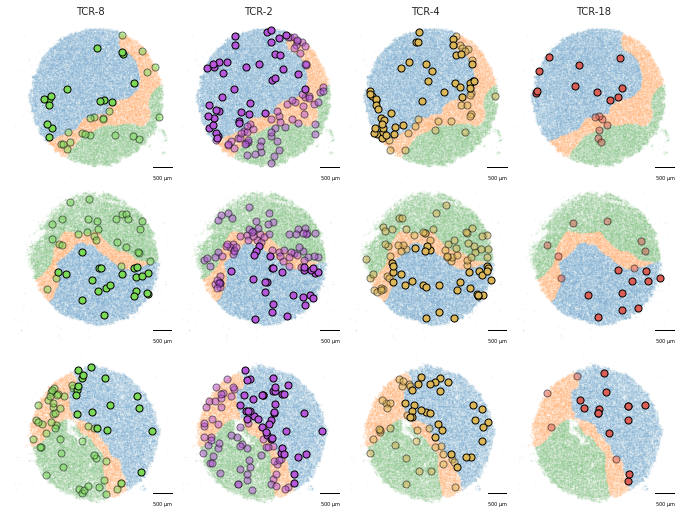

In [114]:
# plot significant clonotypes on all pucks

plot_df[(plot_df.tumor_enrichment < 0) & (plot_df.volcano_merged > -np.log10(0.05))]

significant_clonotypes = [
    ugly_clonotype_name[i] for i in list(plot_df.sig_name) if i != "insig"
]

test = [8,2,4,18]
tcr_name = ["TCR-" + str(i) for i in test]
plotting_clonotypes = [ugly_clonotype_name[i] for i in tcr_name]

plt.rcParams.update({"font.size": 22})
fig, ax = plt.subplots(
    3, len(plotting_clonotypes), figsize=(3 * len(plotting_clonotypes), 9)
)

for puck in tqdm([puck8, puck9, puck10]):  # puck8,puck9,

    if puck == puck8:
        loc_x = 0
    elif puck == puck9:
        loc_x = 1
    else:
        loc_x = 2
    for cl in plotting_clonotypes:

        puck.tumor_beads = [
            i
            for i in puck.tll_loc_cluster_dict
            if puck.tll_loc_cluster_dict[i] == "Tumor"
        ]

        puck.til_beads = [
            i
            for i in puck.tll_loc_cluster_dict
            if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
        ]

        puck.lung_beads = [
            i
            for i in puck.tll_loc_cluster_dict
            if puck.tll_loc_cluster_dict[i] == "Lung"
        ]

        ax[loc_x, plotting_clonotypes.index(cl)].scatter(
            [i[0] for i in puck.til_beads],
            [i[1] for i in puck.til_beads],
            label="tll",
            s=0.5,
            alpha=0.05,
            color=sns.color_palette()[1],
        )
        ax[loc_x, plotting_clonotypes.index(cl)].scatter(
            [i[0] for i in puck.lung_beads],
            [i[1] for i in puck.lung_beads],
            label="lung",
            s=0.5,
            alpha=0.05,
            color=sns.color_palette()[2],
        )
        ax[loc_x, plotting_clonotypes.index(cl)].scatter(
            [i[0] for i in puck.tumor_beads],
            [i[1] for i in puck.tumor_beads],
            label="tumor",
            s=0.5,
            alpha=0.05,
            color=sns.color_palette()[0],
        )

        color_index = significant_clonotypes.index(cl)
        print(cl, color_index)
        ax[loc_x, plotting_clonotypes.index(cl)].scatter(
            [
                i[0]
                for i in set(puck.tcr_loc_dict_s1_filtered4[cl])
                if i not in puck.tumor_beads
            ],
            [
                i[1]
                for i in set(puck.tcr_loc_dict_s1_filtered4[cl])
                if i not in puck.tumor_beads
            ],
            color=sns.color_palette("hls", len(significant_clonotypes))[color_index],
            s=50,
            edgecolors="k",
            alpha=0.5,
        )
        ax[loc_x, plotting_clonotypes.index(cl)].scatter(
            [
                i[0]
                for i in set(puck.tcr_loc_dict_s1_filtered4[cl])
                if i in puck.tumor_beads
            ],
            [
                i[1]
                for i in set(puck.tcr_loc_dict_s1_filtered4[cl])
                if i in puck.tumor_beads
            ],
            color=sns.color_palette("hls", len(significant_clonotypes))[color_index],
            s=50,
            edgecolors="k",
        )

        ax[loc_x, plotting_clonotypes.index(cl)].axis("off")
        plt.rcParams.update({"font.size": 5})
        scalebar = ScaleBar(
            0.65,
            "um",
            length_fraction=1 / 3 / 2,
            frameon=False,
            label_loc="bottom",
            label=None,
            location="lower right",
        )
        ax[loc_x, plotting_clonotypes.index(cl)].add_artist(scalebar)

for ax, col in zip(ax[0], plotting_clonotypes):
    ax.set_title(pretty_clonotype_name[col], fontsize=10)

plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

# Figures 3G-H Post vs. pre-treatment clone tumor enrichment and bulk fraction vs. tumor enrichment
- (G) Comparison of the tumor enrichment of clonotypes that are exclusive to the post-treatment sample (n=48 clonotypes) versus clonotypes that are shared with the pre-treatment sample (n=5 clonotypes) across all serial arrays. 
- (H) Lack of correlation between the mean tumor enrichment of clonotypes in Slide-TCR-seq and their fraction in bulk TCR-seq from the same post-treatment specimen, by Spearman’s correlation. 

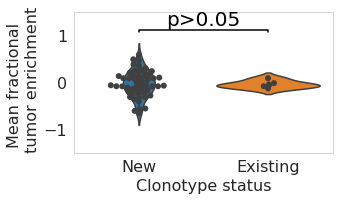

5
54


In [115]:
# Figure 2g
in_post_not_pre = []
in_both = []
in_pre_not_post = []
not_in_any = []
all_cls = list(
    set(
        list(
            [
                i
                for i in puck8.tcr_loc_dict_s1_filtered4
                if len(set(puck8.tcr_loc_dict_s1_filtered4[i])) > 10
            ]
        )
        + list(
            [
                i
                for i in puck9.tcr_loc_dict_s1_filtered4
                if len(set(puck9.tcr_loc_dict_s1_filtered4[i])) > 10
            ]
        )
        + list(
            [
                i
                for i in puck10.tcr_loc_dict_s1_filtered4
                if len(set(puck10.tcr_loc_dict_s1_filtered4[i])) > 10
            ]
        )
    )
)
for cl in all_cls:
    pre_beta = False
    pre_alpha = False
    post_beta = False
    post_alpha = False
    if cl in list(pre_bulk_beta.cdr3):
        pre_beta = True
    if cl in list(pre_bulk_alpha.cdr3):
        pre_alpha = True
    if cl in list(post_bulk_alpha.cdr3):
        post_alpha = True
    if cl in list(post_bulk_beta.cdr3):
        post_beta = True

    if pre_beta and post_beta:
        # print('Present in both')
        in_both.append(cl)
    if pre_beta and not post_beta:
        # print('in pre but not in post')
        in_pre_not_post.append(cl)
    if post_beta and not pre_beta:
        # print('in post but not in pre')
        in_post_not_pre.append(cl)
    if pre_alpha or post_alpha:
        pass
    if not pre_beta and not pre_alpha and not post_beta and not post_alpha:
        not_in_any.append(cl)

tumor_enrichment_in_both = []
tumor_enrichment_in_post_not_pre = []

for cl in plot_df.clonotype:
    if ugly_clonotype_name[cl] in in_both:
        tumor_enrichment_in_both.append(
            float(plot_df[plot_df.clonotype == cl].tumor_enrichment)
        )
    if ugly_clonotype_name[cl] in in_post_not_pre:
        tumor_enrichment_in_post_not_pre.append(
            float(plot_df[plot_df.clonotype == cl].tumor_enrichment)
        )

plt.rcParams.update({"font.size": 16})
plt.figure(figsize=(5, 3))
status = ["New"] * len(tumor_enrichment_in_post_not_pre) + ["Existing"] * len(
    tumor_enrichment_in_both
)
value = tumor_enrichment_in_post_not_pre + tumor_enrichment_in_both
enrichment_vs_cl_status_df = pd.DataFrame.from_dict(
    {"status": status, "tumor_enrichment": value}
)
sns.violinplot(x="status", y="tumor_enrichment", data=enrichment_vs_cl_status_df)
sns.swarmplot(
    x="status",
    y="tumor_enrichment",
    data=enrichment_vs_cl_status_df,
    color=".25",
    size=6,
)

# statistical annotation
x1, x2 = 0, 1  # columns 'Sat' and 'Sun' (first column: 0, see plt.xticks())
y, h, col = enrichment_vs_cl_status_df["tumor_enrichment"].max() + 0.1, 0.03, "k"
y = y + 0.4
plt.plot([x1, x1, x2, x2], [y, y + h, y + h, y], lw=1.5, c=col)
plt.text((x1 + x2) * 0.5, y + h, "p>0.05", ha="center", va="bottom", color=col, size=20)
plt.ylim(-1.5, 1.5)
plt.xlabel("Clonotype status")
plt.ylabel("Mean fractional \n tumor enrichment")
plt.tight_layout()
plt.savefig('./plots/fig3g.pdf')
plt.show()

print(len(enrichment_vs_cl_status_df[enrichment_vs_cl_status_df.status == "Existing"]))
print(len(enrichment_vs_cl_status_df[enrichment_vs_cl_status_df.status == "New"]))

r 0.26530094454029046 pval 0.03879183506331978
SpearmanrResult(correlation=0.18755866994433654, pvalue=0.1477694381247228)


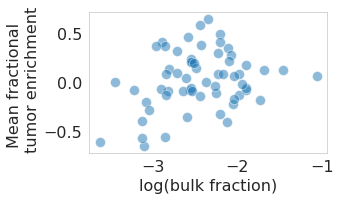

In [116]:
# Clonotype enrichment vs percentage of bulk
post_bulk_beta_filt = post_bulk_beta[post_bulk_beta.count_sum >= 10]

cl_to_freq_dict = dict(
    zip(list(post_bulk_beta_filt.cdr3), list(post_bulk_beta_filt.Freq))
)

pretty_cl_to_freq = [
    pretty_clonotype_name[i] for i in cl_to_freq_dict if i in pretty_clonotype_name
]
plot_df = plot_df[plot_df.clonotype.isin(pretty_cl_to_freq)]

freq = []

tumor_enrichment = list(plot_df.tumor_enrichment)
freq = [cl_to_freq_dict[ugly_clonotype_name[cl]] for cl in list(plot_df.clonotype)]
log_freq = [np.log10(i) for i in freq]
plotting_df = pd.DataFrame.from_dict({"tumor": tumor_enrichment, "log_freq": log_freq})
plt.figure(figsize=(5, 3))
sns.scatterplot(x="log_freq", y="tumor", data=plotting_df, s=100, alpha=0.5)
plt.ylabel("Mean fractional \n tumor enrichment")
plt.xlabel("log(bulk fraction)")
print(
    "r",
    scipy.stats.linregress(log_freq, tumor_enrichment)[2],
    "pval",
    scipy.stats.linregress(log_freq, tumor_enrichment)[3],
)
print(scipy.stats.spearmanr(log_freq,tumor_enrichment))
plt.tight_layout()
plt.savefig('./plots/fig3h.pdf')

# Figures 3I-J PRI expression
- (I) Left: The three axes – spatial localization, gene expression, and T cell clonotype – that Slide-TCR-seq can relate. Center: distribution of poor response to immune checkpoint inhibitor treatment (‘PRI’) gene set expression across all clonotypes in the tumor region for the post-PD-1 inhibitor RCC lung metastasis in a single array with kernel density estimation. Yellow = clonotypes with lower than median PRI expression; purple = clonotypes with PRI expression greater than or equal to the median value. Right: localization of low (yellow) and high (purple) PRI gene set expression clonotypes within the tumor region (light blue) from the Slide-TCR-seq array shows their distinct spatial separation (light blue = tumor region, orange = boundary region, green = lung region). 
- (J) Smoothed histograms comparing the distance infiltrated into the tumor by two-tailed K-S test comparing low (yellow) and high (purple) expression clonotypes, as dichotomized by median expression of PRI. 

In [121]:
# Load in genes
d = 50  # distance in microns
d = d / 0.65

# Load in genesets
puck = puck8
load_genesets = True
# Read in gene sets
if load_genesets:
    gene_df = pd.read_excel(
        "{}Supplementary Table 3.xls".format(directory), sheet_name="All genes"
    )
    gene_groups = {}
    for name in gene_df.columns:
        gene_groups[name] = [i for i in list(gene_df[name]) if isinstance(i, str)]
    ss_genes = puck.s1_dge_fmtd_norm.columns

    missing_genes = []
    for group in gene_groups:
        for gene in gene_groups[group]:
            if gene in ss_genes:
                pass
            if gene not in ss_genes:
                missing_genes.append(gene)
    if len(missing_genes) > 0:
        print("These genes are missing:", missing_genes)
    # Remove missing genes
    for group in gene_groups:
        gene_groups[group] = [i for i in gene_groups[group] if i not in missing_genes]

These genes are missing: ['MS4A4C', 'CTLA2A', 'RPS17', 'MT-CYTB', 'RPL10-PS3', 'GM8730', 'GM10073', '2900026A02RIK', 'AW112010', 'SERPINA3G', 'FASL', 'IFI47', 'IZUMO1R', 'LSP1', 'CRIP1', 'NDUFB8', 'PSMA1', 'REREP3', 'OVCA2', 'CKS1B', 'ABCB1A', 'ABCB1B', 'LY6A', 'TCL1', 'NANOG', 'HAND1', 'C11ORF31', 'C11ORF48', 'C11ORF58', 'C12ORF57', 'C12ORF75', 'C14ORF166', 'C14ORF2', 'C16ORF13', 'C17ORF49', 'C17ORF62', 'C18ORF32', 'C19ORF10', 'C19ORF24', 'C19ORF53', 'C19ORF66', 'C1ORF43', 'C21ORF33', 'C2ORF68', 'C4ORF3', 'C5ORF56', 'C7ORF55-LUC7L2', 'C7ORF73', 'C9ORF16', 'EIF3CL', 'LSP1', 'NDUFB8', 'PNRC2', 'PSMA1', 'PSMA2', 'RNASEK-C17ORF49', 'SDHD', 'SLX1A', 'SLX1B', 'SRSF10', 'TMBIM4', 'TOMM6', 'UQCR11', 'IFNA2', 'IFNB1', 'IFNZ', 'OAS1A', 'OAS1B', 'TAP2', 'TAP', 'CD39', 'CD137', 'IFNA1', 'IL2']


  0%|          | 0/1010 [00:00<?, ?it/s]

/home/jupyter/packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/home/jupyter/packages/seaborn/distributions.py:1699: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)
/home/jupyter/packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/home/jupyter/packages/seaborn/distri

ks_test KstestResult(statistic=0.25670426065162905, pvalue=3.95383725759757e-12)


/home/jupyter/packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/home/jupyter/packages/seaborn/distributions.py:1699: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.3 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)
/home/jupyter/packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


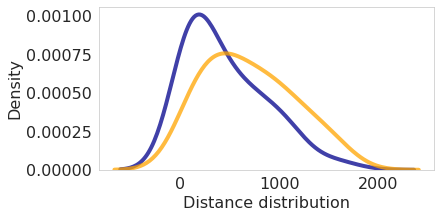

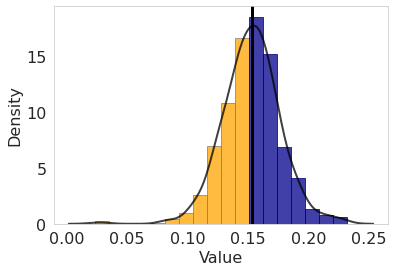

In [122]:
# Split the plots by clonotype:
# Calculate gene expression for each gene group for clonotypes separately and then all together
sns.set_style("whitegrid", {"axes.grid": False})
group = "Bad response to ICP (from Sade-Feldman et al. 2018)"

# INDIVIDUAL CLONOTYPE ANALYSIS
gene_group_cl = {}
gene_group_cl_less = {}
gene_group_cl_greater = {}
all_cl_bcs = []
for clonotype in tqdm(puck.tcr_loc_dict_s1_filtered4):
    if clonotype not in puck.clonotypes['1b']:
        continue
    cl_locs = [
        i
        for i in set(puck.tcr_loc_dict_s1_filtered4[clonotype])
        if i in puck.tumor_beads
    ]
    cl_bcs = [puck.loc_to_bc_s1[i] for i in cl_locs]
    all_cl_bcs = all_cl_bcs + cl_bcs
    if len(cl_bcs) < 10:
        continue

    gene_group_cl[clonotype] = list(
        puck.s1_dge_fmtd_norm.loc[cl_bcs, gene_groups[group]].sum(axis=1)
    )

    cutoff = np.median(gene_group_cl[clonotype])
    gene_group_cl_less[clonotype] = [
        cl_locs[idx]
        for idx in range(len(gene_group_cl[clonotype]))
        if gene_group_cl[clonotype][idx] < cutoff
    ]
    gene_group_cl_greater[clonotype] = [
        cl_locs[idx]
        for idx in range(len(gene_group_cl[clonotype]))
        if gene_group_cl[clonotype][idx] >= cutoff
    ]

# AGGREGATE CLONOTYPE ANALYSIS
gene_group_cl_agg = []
gene_group_cl_agg_less = []
gene_group_cl_agg_greater = []

all_cl_bcs = list(set(all_cl_bcs))
all_locs = [puck.bc_loc_dict_s1[i] for i in all_cl_bcs]

gene_group_cl_agg = list(
    puck.s1_dge_fmtd_norm.loc[all_cl_bcs, gene_groups[group]].sum(axis=1)
)
cutoff = np.median(gene_group_cl_agg)
gene_group_cl_agg_less = [
    all_locs[idx]
    for idx in range(len(gene_group_cl_agg))
    if gene_group_cl_agg[idx] < cutoff
]
gene_group_cl_agg_greater = [
    all_locs[idx]
    for idx in range(len(gene_group_cl_agg))
    if gene_group_cl_agg[idx] >= cutoff
]
less_agg_dist = [
    distance_between_points(pt, closest_node(pt, puck.boundary_points))
    for pt in gene_group_cl_agg_less
    if pt in puck.tumor_beads
]
greater_agg_dist = [
    distance_between_points(pt, closest_node(pt, puck.boundary_points))
    for pt in gene_group_cl_agg_greater
    if pt in puck.tumor_beads
]


    
# PLOT
plt.figure(figsize=(6, 3))
df_greater = pd.DataFrame.from_dict(
    {"Distance distribution": [i * 0.65 for i in greater_agg_dist]}
)
df_less = pd.DataFrame.from_dict(
    {"Distance distribution": [i * 0.65 for i in less_agg_dist]}
)
sns.distplot(
    df_greater["Distance distribution"],
    hist=False,
    kde=True,
    bins=int(180 / 5),
    color="darkblue",
    hist_kws={"edgecolor": "gray", "alpha": 0.75},
    kde_kws={"linewidth": 4, "bw": 0.5, "alpha": 0.75},
    norm_hist=True,
    label="Greater",
)

sns.distplot(
    df_less["Distance distribution"],
    hist=False,
    kde=True,
    bins=int(180 / 5),
    color="orange",
    hist_kws={"edgecolor": "gray", "alpha": 0.75},
    kde_kws={"linewidth": 4, "bw": 0.5, "alpha": 0.75},
    norm_hist=True,
    label="Less",
)

print(
    "ks_test", 
    kstest([i * 0.65 for i in greater_agg_dist], [i * 0.65 for i in less_agg_dist]),
)
plt.savefig('./plots/5c.pdf')

# PLOT 2
fig, ax = plt.subplots()
agg = copy.deepcopy(gene_group_cl_agg)

df_all = pd.DataFrame.from_dict({"Value": agg})

sns.distplot(
    df_all["Value"],
    hist=False,
    kde=True,
    bins=int(180 / 10),
    color="black",
    hist_kws={"edgecolor": "gray", "alpha": 0.75},
    kde_kws={"linewidth": 2, "bw": 0.3, "alpha": 0.75},
    norm_hist=True,
    label="Less",
)
plt.axvline(x=cutoff, c="black", linewidth=3)

sns.distplot(
    df_all["Value"],
    hist=True,
    kde=False,
    bins=int(180 / 10),
    color="orange",
    hist_kws={"edgecolor": "gray", "alpha": 0.75},
    kde_kws={"linewidth": 2, "bw": 0.3, "alpha": 0.75},
    norm_hist=True,
    label="Less",
)
plt.axvline(x=cutoff, c="black", linewidth=3)
plt.savefig('./plots/5btop.pdf')

for p in ax.patches:
    if p.get_xy()[0] >= cutoff * 0.95:
        p.set_color("darkblue")
    if p.get_xy()[1] >= cutoff:
        p.set_color("darkblue")


In [123]:
for cl in gene_group_cl:
    less = gene_group_cl_less[cl]
    greater = gene_group_cl_greater[cl]

    less_disat = [
        distance_between_points(pt, closest_node(pt, puck.boundary_points))
        for pt in less
        if pt in puck.tumor_beads
    ]
    greater_dist = [
        distance_between_points(pt, closest_node(pt, puck.boundary_points))
        for pt in greater
        if pt in puck.tumor_beads
    ]


/home/jupyter/packages/ipykernel_launcher.py:79: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 


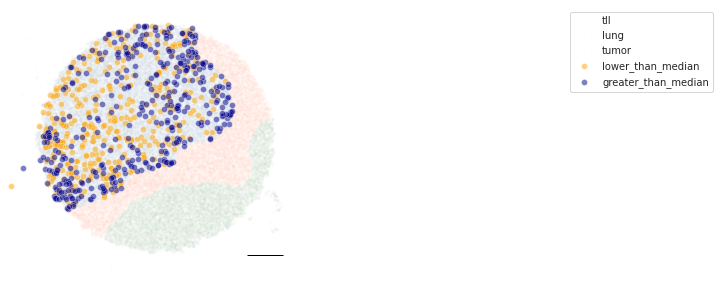

In [124]:
# Plot geneset expression spatially on puck separated by median geneset expression

# plot significant clonotypes on all pucks
plt.rcParams.update({'font.size': 10})


fig, ax = plt.subplots(figsize=(5, 5))
puck.tumor_beads = [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == 'Tumor'
    ]

puck.til_beads = [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == 'TIL Chemokines'
    ]

puck.lung_beads = [
        i for i in puck.tll_loc_cluster_dict
        if puck.tll_loc_cluster_dict[i] == 'Lung'
    ]


plt.scatter([i[0] for i in puck.til_beads],
            [i[1] for i in puck.til_beads],
            label='tll',
            s=3,
            alpha=0.01,
            color=sns.color_palette()[1])
plt.scatter([i[0] for i in puck.lung_beads],
            [i[1] for i in puck.lung_beads],
            label='lung',
            s=3,
            alpha=0.01,
            color=sns.color_palette()[2])
plt.scatter([i[0] for i in puck.tumor_beads],
            [i[1] for i in puck.tumor_beads],
            label='tumor',
            s=3,
            alpha=0.01,
            color=sns.color_palette()[0])

coloring_for_each_loc = gene_group_cl_agg

#         x = [i[0] for i in all_tcr_locs  if i in puck.tumor_beads] #
#         y = [i[1] for i in all_tcr_locs  if i in puck.tumor_beads] #
x = [i[0] for i in all_locs]  #
y = [i[1] for i in all_locs]  #
ge = coloring_for_each_loc
plotting_df = pd.DataFrame.from_dict({'x': x, 'y': y, 'ge': ge})
cutoff = np.median(plotting_df['ge'])  ## FOR AGGREGATE

plotting_df_less = plotting_df[plotting_df['ge'] < cutoff]
plotting_df_greater = plotting_df[plotting_df['ge'] >= cutoff]
#         sns.scatterplot(data = plotting_df, x= x, y = y, hue = 'blue',alpha=0.5)

### FOR ORIGINAL SEPARATED PLOTS
sns.scatterplot(data=plotting_df_less,
                x='x',
                y='y',
                color='orange',
                alpha=0.5,
                label='lower_than_median')
sns.scatterplot(data=plotting_df_greater,
                x='x',
                y='y',
                color='darkblue',
                alpha=0.5,
                label='greater_than_median')
### FOR PLOTS COLORED BY EXPRESSION
#         sns.scatterplot(data = plotting_df, x= 'x', y = 'y', hue='ge',alpha=0.5)
plt.xlim([0, 6000])
plt.ylim([0, 6000])
ax.set_xlim([0, 6000])
ax.set_ylim([0, 6000])
#plt.title(group)
plt.legend(bbox_to_anchor=(2, 1), loc='upper left')
plt.axis('off')
plt.tight_layout()
fontprops = fm.FontProperties(size=18)
scalebar = AnchoredSizeBar(ax.transData,
                           pixels_needed,
                           '',
                           'lower right',
                           pad=0.1,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fontprops)

ax.add_artist(scalebar)
plt.show()


# Figure 3K PRI expression heterogeneity between clones
- (K) Expression of PRI gene set across clonotypes with at least 20 beads (n=7 clonotypes), dichotomized based on each clonotype’s median distance infiltrated into the tumor from the tumor edge (red = less infiltrated, blue = more infiltrated; the median distances in µm are displayed along the top). TCR-4 exhibited higher PRI expression when localized closer to the tumor edge than farther from the edge (by two-tailed K-S test). See STAR Methods for n of each distribution.

In [125]:
for puck in [puck8]: 
    if puck == puck8:
        name = 'p8'
    if puck == puck9:
        name = 'p9'
    if puck == puck10:
        name = 'p10'

    all_genes = []
    for group in gene_groups:
        all_genes = all_genes + gene_groups[group]
    all_genes = list(set(all_genes))
    all_genes_pucks = list(
        set(list(set(puck8.s1_dge_fmtd.columns) & set(puck9.s1_dge_fmtd.columns)))
        & set(puck10.s1_dge_fmtd.columns)
    )
    all_genes = [i for i in all_genes if i in all_genes_pucks]


In [126]:
# Plot two distributions of gene expression based on distances split

# Calculate distances and medians
cl_distances = {}
cl_medians = {}
for cl in puck.tcr_loc_dict_s1_filtered4:
    cl_distances[cl] = [
        (pt, distance_between_points(pt, closest_node(pt, puck.boundary_points)))
        for pt in set(puck.tcr_loc_dict_s1_filtered4[cl])
        if pt in puck.tumor_beads
    ]
    cl_medians[cl] = np.median([i[1] for i in cl_distances[cl]])

gene_group_cl_below_median = {}
gene_group_cl_above_median = {}
for clonotype in tqdm(puck.tcr_loc_dict_s1_filtered4):

    if clonotype not in cl_distances:
        continue
    below_cl_locs = [
        i[0] for i in cl_distances[clonotype] if i[1] <= cl_medians[clonotype]
    ]  # if i in puck.tumor_beads
    above_cl_locs = [
        i[0] for i in cl_distances[clonotype] if i[1] > cl_medians[clonotype]
    ]
    below_bcs = [puck.loc_to_bc_s1[i] for i in below_cl_locs]
    above_bcs = [puck.loc_to_bc_s1[i] for i in above_cl_locs]
    all_cl_bcs = all_cl_bcs + cl_bcs
    if len(below_cl_locs) < 10:
        continue
    if len(above_cl_locs) < 10:
        continue
    group = "Bad response to ICP (from Sade-Feldman et al. 2018)"
    gene_group_cl_below_median[clonotype] = list(
        puck.s1_dge_fmtd_norm.loc[below_bcs, gene_groups[group]].sum(axis=1)
    )
    gene_group_cl_above_median[clonotype] = list(
        puck.s1_dge_fmtd_norm.loc[above_bcs, gene_groups[group]].sum(axis=1)
    )

/home/jupyter/packages/numpy/core/fromnumeric.py:3420: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/jupyter/packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


  0%|          | 0/1010 [00:00<?, ?it/s]

KS CSARDPGPDTQYF Bad response to ICP (from Sade-Feldman et al. 2018) 0.00396729438660086
KS CASSPRTSGRYNEQFF Bad response to ICP (from Sade-Feldman et al. 2018) 0.00014786719130865933
KS CASSVTGETGELFF Bad response to ICP (from Sade-Feldman et al. 2018) 0.036163801987613264
KS CASSPTVYNEQFF Bad response to ICP (from Sade-Feldman et al. 2018) 0.0056304409404600575


/home/jupyter/packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.set_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


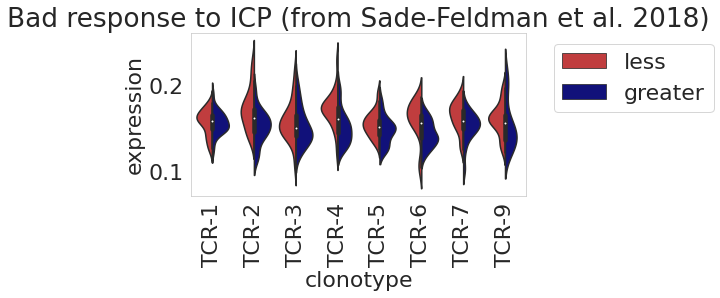

In [127]:
# Plot for each clonotype and geneset x-axis geneset expression, split by distance median.

plotting_df, pval_recorder = make_plotting_df()

plotting_df = plotting_df[plotting_df.clonotype.isin(puck.clonotypes["1b"])]

plotting_df["log_expression"] = -np.log10(plotting_df["expression"])

plt.figure(figsize=(6, 3))

cl_to_plot = list(gene_group_cl_below_median.keys())
# Heatmap merged of e
plotting_df = plotting_df[plotting_df.clonotype.isin(cl_to_plot)]
plotting_df.clonotype = plotting_df.clonotype.astype("category")
plotting_df.clonotype.cat.set_categories(cl_to_plot, inplace=True)
plotting_df.sort_values(["clonotype"], inplace=True)
plotting_df.clonotype = plotting_df.clonotype.astype(str)
plotting_df.clonotype = [
    pretty_clonotype_name[cl] for cl in list(plotting_df.clonotype)
]
plotting_df.sort_values(["clonotype"], inplace=True)
color_palette_to_use = [sns.color_palette("tab10")[3]] + ["darkblue"]
sns.violinplot(
    x="clonotype",
    y="expression",
    hue="greater_or_less",
    data=plotting_df,
    palette=color_palette_to_use,
    split=True,
    bw=0.5,
)
plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.title(group)
plt.grid(False)
plt.savefig('./plots/5f.pdf')
plt.show()

In [128]:
ldf = plotting_df[plotting_df.greater_or_less=='less']
gdf = plotting_df[plotting_df.greater_or_less=='greater']
t1 = ldf[ldf.clonotype=='TCR-9'].expression
t2 = gdf[gdf.clonotype=='TCR-9'].expression
scipy.stats.ttest_ind(t1,t2)

Ttest_indResult(statistic=0.6914969192247786, pvalue=0.4976165668888929)

In [129]:
pretty_clonotype_name['CSARDPGPDTQYF']
pretty_clonotype_name['CASSPTVYNEQFF']


'TCR-6'

In [130]:
plotting_df

,clonotype,greater_or_less,expression,log_expression
40,TCR-1,less,0.158163,0.800894
80,TCR-1,greater,0.123457,0.908485
67,TCR-1,greater,0.172372,0.763534
91,TCR-1,greater,0.164530,0.783755
90,TCR-1,greater,0.143646,0.842705
...,...,...,...,...
296,TCR-9,greater,0.142857,0.845098
298,TCR-9,greater,0.212719,0.672193
291,TCR-9,greater,0.121118,0.916791
282,TCR-9,less,0.158672,0.799501


In [131]:
tcr_names = list(set(plotting_df.clonotype))
tcr_names.sort()
for i in ['less','greater']:
    for j in tcr_names:
        print(i,j)
        print(len([i for i in list(plotting_df[plotting_df.greater_or_less==i].clonotype==j) if i == True]))
        

less TCR-1
26
less TCR-2
20
less TCR-3
23
less TCR-4
22
less TCR-5
16
less TCR-6
17
less TCR-7
18
less TCR-9
11
greater TCR-1
26
greater TCR-2
20
greater TCR-3
23
greater TCR-4
21
greater TCR-5
15
greater TCR-6
16
greater TCR-7
17
greater TCR-9
10


In [132]:
# Find median distance
cl_medians[ugly_clonotype_name['TCR-4']]

540.3298344529941

In [133]:
# Multiple hypothesis correction
p_values_all_corrected = stats.multitest.multipletests(
    list(pval_recorder.values()), alpha=0.05, method="fdr_bh", is_sorted=False, returnsorted=False
)
conversion_dict = dict(zip(list(pval_recorder.values()), p_values_all_corrected[1]))
print(conversion_dict)

{0.00396729438660086: 0.016891322821380172, 0.7327372974834561: 0.8243294596688882, 0.00014786719130865933: 0.001330804721777934, 0.036163801987613264: 0.08136855447212984, 0.12429453839909903: 0.22373016911837823, 0.22346203641745843: 0.29240198103532944, 0.0056304409404600575: 0.016891322821380172, 0.22742376302747846: 0.29240198103532944, 0.9383310279844598: 0.9383310279844598}


# Figure S3G NMF clonal correlation
- (G) Correlation between different clonotypes’ non-negative matrix factorized cell loadings by Pearson’s correlation.

In [134]:
# For geneset NMF analysis for heatmaps # betas, at least 10 beads in tumor
for puck in [puck8, puck9, puck10]: 
    if puck == puck8:
        name = 'p8'
    if puck == puck9:
        name = 'p9'
    if puck == puck10:
        name = 'p10'

    all_genes = []
    for group in gene_groups:
        all_genes = all_genes + gene_groups[group]
    all_genes = list(set(all_genes))
    all_genes_pucks = list(
        set(list(set(puck8.s1_dge_fmtd.columns) & set(puck9.s1_dge_fmtd.columns)))
        & set(puck10.s1_dge_fmtd.columns)
    )
    all_genes = [i for i in all_genes if i in all_genes_pucks]

    tcr_bcs_in_tumor = []
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes["1b"]:
            continue
        tumor_beads_cl = {
            i
            for i in list(set(puck.tcr_loc_dict_s1_filtered4[tcr]))
            if i in puck.tumor_beads
        }
        if len(tumor_beads_cl) < 10:  # < 10: ### change to = 0 for all reps
            continue
        tcr_bcs_in_tumor = tcr_bcs_in_tumor + [puck.loc_to_bc_s1[i] for i in tumor_beads_cl]
    dge = puck.s1_dge_fmtd_norm[all_genes] # _norm # all_genes #ghv
    dge = dge[dge.index.isin(tcr_bcs_in_tumor)]
    puck.nmf_dge = dge
    #puck.nmf_dge["rep"] = [name] * len(dge)


In [135]:
# test summing cls before nmf
cl_to_plot = {}
for puck in [puck8, puck9, puck10]:
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes['1b']:
            continue
        locs = list(set(puck.tcr_loc_dict_s1_filtered4[tcr]))
        if tcr not in cl_to_plot:
            cl_to_plot[tcr] = []
        cl_to_plot[tcr] = cl_to_plot[tcr] + locs    
cl_to_plot = [i for i in cl_to_plot if len(cl_to_plot[i])>=10]

puck.nmf_dge_presum = {}
cln = []
for cl in tqdm(cl_to_plot):
    bcs = []
    for puck in [puck8,puck9,puck10]:
        if cl not in puck.clonotypes['1b']:
            continue
        locs = list(set(puck.tcr_loc_dict_s1_filtered4[cl]))
        locs = [i for i in locs if i in puck.tumor_beads]
        bcs = bcs + [puck.loc_to_bc_s1[i] for i in locs]
    
    test = puck.nmf_dge[puck.nmf_dge.index.isin(bcs)].sum()#.div(len(bcs)) # averaged across all beads
    puck.nmf_dge_presum[cl] = test
    cln.append(cl)

  0%|          | 0/98 [00:00<?, ?it/s]

In [136]:

big_df = pd.DataFrame()

test = puck8.nmf_dge
test_scaled = test.div(test.sum(axis=1), axis=0) * 10000
test_scaled = test_scaled.dropna(axis=1)
print(test_scaled.shape)
big_df = test_scaled

test = puck9.nmf_dge
test_scaled = test.div(test.sum(axis=1), axis=0) * 10000
test_scaled = test_scaled.dropna(axis=1)
print(test_scaled.shape)
big_df = pd.concat([big_df,test_scaled])


test = puck10.nmf_dge
test_scaled = test.div(test.sum(axis=1), axis=0) * 10000
test_scaled = test_scaled.dropna(axis=1)
print(test_scaled.shape)
big_df = pd.concat([big_df,test_scaled])
print(big_df.shape)

(393, 1474)
(319, 1474)
(250, 1474)
(962, 1474)


In [137]:
# NMF testing

#df_all.drop(columns=['rep'])
N_COMPONENTS = 10
#dge_values_only = dge.drop(columns=["rep"])
dge_values_only = big_df##### TEST CHANGE HERE
X = np.array(dge_values_only)
model = NMF(N_COMPONENTS, init="random", random_state=0, max_iter=1000)
W = model.fit_transform(X)
H = model.components_

nmf_report = {}
for factor in range(N_COMPONENTS):
    nmf_report[factor] = H[factor, :]

In [138]:
# Normalize NMF matrix
newW = np.zeros(np.shape(W))
a,_ = np.shape(W)
for i in range(a):
    newW[i,:] = W[i,:]/sum(W[i,:])

In [139]:
np.shape(W)

(962, 10)

In [140]:
# try cohen's d again
bcs_all = list(big_df.index)
np.shape(W)
df = {}

cl_to_plot = {}
for puck in [puck8, puck9, puck10]:
    for tcr in puck.tcr_loc_dict_s1_filtered4:
        if tcr not in puck.clonotypes['1b']:
            continue
        locs = list(set(puck.tcr_loc_dict_s1_filtered4[tcr]))
        if tcr not in cl_to_plot:
            cl_to_plot[tcr] = []
        cl_to_plot[tcr] = cl_to_plot[tcr] + locs    
cl_to_plot = [i for i in cl_to_plot if len(cl_to_plot[i])>=10]


df = {}
for cl in cl_to_plot:
    df[cl] = []
    bcs_thiscl = []
    for puck in [puck8, puck9, puck10]:
        if cl not in puck.clonotypes['1b']:
            continue
        if cl not in puck.tcr_loc_dict_s1_filtered4:
            continue
        locs = set(puck.tcr_loc_dict_s1_filtered4[cl])
        locs = [i for i in locs if i in puck.tumor_beads]
        bcs  = [puck.loc_to_bc_s1[i] for i in locs]
        bcs_thiscl = bcs_thiscl + bcs
    idxs_all_nmf = []
    idxs_other = []
    for bc in bcs_thiscl:
        if bc not in bcs_all:
            continue
        if bc in bcs_all:
            idxs_all_nmf.append(bcs_all.index(bc))
    idxs_other = [index for index,val in enumerate(bcs_all) if val not in set(bcs_thiscl)]

    this_cl = [newW[i,:] for i in idxs_all_nmf]
    other_cl = [newW[i,:] for i in idxs_other]
    if len(this_cl) <= 10:
        continue
    #print(len(this_cl),len(other_cl))
    for factor in range(len(this_cl[0])):
        this = [i[factor] for i in this_cl]
        other = [i[factor] for i in other_cl]
        x = cohens_d(this,other)
        df[cl].append(x)
#t = pd.DataFrame.from_dict(df)

In [141]:
df = {i:df[i] for i in df if df[i] != []}

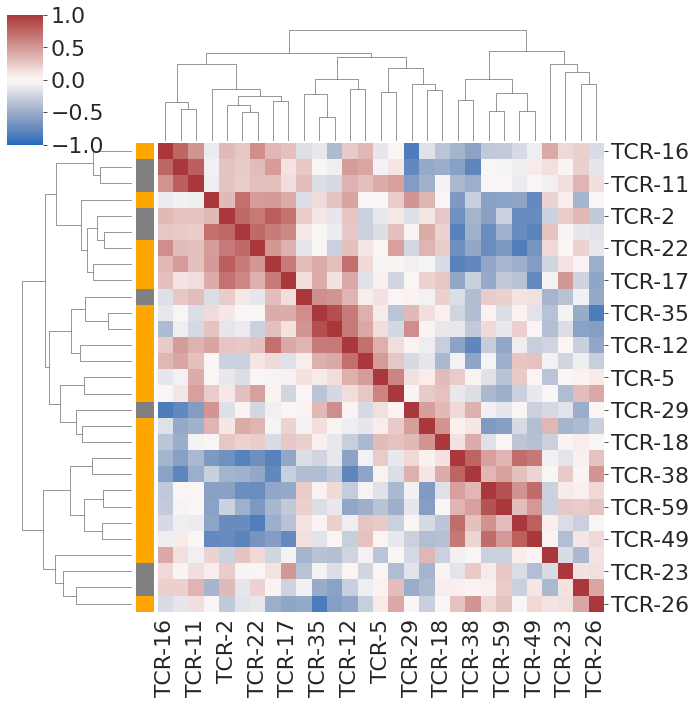

In [142]:
significant_enriched = [
    pretty_clonotype_name[i]
    for i in cl_agg_enrichment["Tumor"]
    if cl_agg_enrichment["Tumor"][i] > 0
]
significant_depleted = [
    pretty_clonotype_name[i]
    for i in cl_agg_enrichment["Tumor"]
    if cl_agg_enrichment["Tumor"][i] < 0
]

df_df = pd.DataFrame(df)
df_df.columns = [pretty_clonotype_name[i] for i in df_df.columns]
corrMatrix = df_df.corr()
cm = sns.color_palette("vlag", as_cmap=True)


lut = {}
for i in corrMatrix.columns:
    if i in significant_enriched:
        lut[i] = "orange"
    elif i in significant_depleted:
        lut[i] = "gray"
    else:
        lut[i] = "gray"
names = corrMatrix.index
row_colors = names.map(lut)

sns.clustermap(corrMatrix,cmap = cm,vmax=1,vmin=-1,row_colors=row_colors,)

sns.set(font_scale=1)
plt.savefig('./plots/cell_loadings_nmf_heatmap.pdf')

# Figures 4A, 4C, S5A RCC TLS analysis
- (A-B) Aligned H&E of a serial section (left), Slide-TCR-seq array (center) with beads colored by RCTD cell type assignments, and zoomed-in Slide-TCR-seq of tertiary lymphoid structure (TLS) (right) in RCC (A) and melanoma (B). 
- (C-D) Region mask of a Slide-TCR-seq array delineating tumor, TLS, and adjacent non-neoplastic regions (top left); beads containing both CDR3 and T cell state colored by RCTD assignment (top center); Gaussian-filtered heatmap visualizing TCRs weighted by the extent of clonal expansion (top right); Gaussian-filtered heatmap normalized to maximum values in TLSs and tumor regions, visualizing the location of B cell, CD4+ T cell, and CD8+ Exhausted (Exh) T cell types (bottom); in RCC (C) and melanoma (D). 
- (S8A) All replicates of the renal cell carcinoma samples in Figures 4E and 4G. From left to right, 1 – a region mask of a Slide-TCR-seq array delineating tumor, TLS, and adjacent non-neoplastic regions. 2 – a plot of B cells identified through RCTD. 3 - beads containing both CDR3 and T cell state colored by RCTD assignment. 4 – beads containing CDR3 colored by log10(total number of T cells for that clone). 5 – Gaussian-filtered heatmap visualizing TCRs weighted by the extent of clonal expansion

In [143]:
import matplotlib.cm as cm

In [144]:
puck_name = "Puck_220408_20" # Can change this to generate all other pucks in S8B
# all_pucks = ['Puck_220408_13', 
#                  'Puck_220408_14', 'Puck_220408_15', 'Puck_220408_20']


(2150.0, 3250.0)

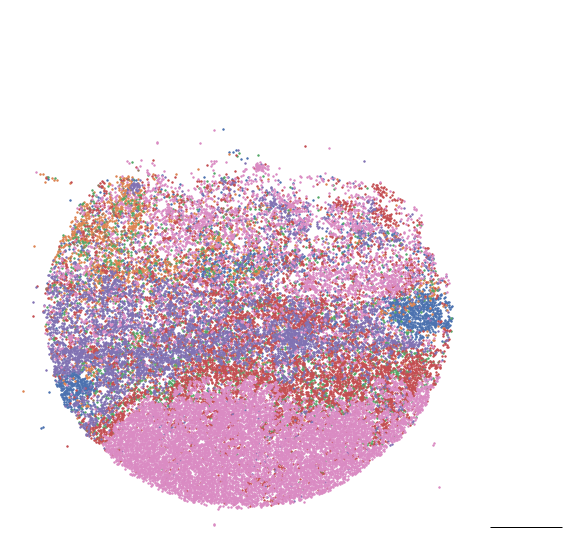

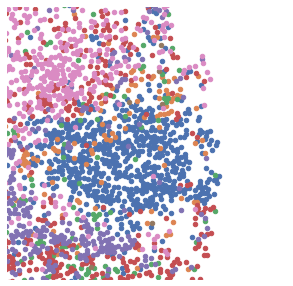

In [153]:
# Figure 4A
df = pd.read_csv(f"{puck_name}_cell_clones.csv")
df_filt = df[~df.TRBs.isnull()]

all_cell_types = [
    'B cell', 'CD4', 'CD8 Exh.', 'Myeloid', 'Plasma', 'CD8 NonExh.', 'Tfh',
    'Treg', 'Tumor'
]

df_to_use = df[df.maxw > 0.3]
all_locs = [(i, j) for i, j in zip(df_to_use.x, df_to_use.y)]

fig, ax = plt.subplots(figsize=(10, 10))
for cell_type in all_cell_types:
    if cell_type in ['Treg', 'Tfh']:
        continue
    x = df_to_use[df_to_use.type == cell_type].x
    y = df_to_use[df_to_use.type == cell_type].y
    plt.scatter(x, y, s=2, label=cell_type)
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
plt.axis('off')
#plt.legend()
ax.add_artist(scalebar)
plt.xlim([0, 6000])
plt.ylim([0, 6000])

df_to_use = df[df.maxw > 0.3]

fig, ax = plt.subplots(figsize=(5, 5))
for cell_type in all_cell_types:
    if cell_type in ['Treg', 'Tfh']:
        continue
    x = df_to_use[df_to_use.type == cell_type].x
    y = df_to_use[df_to_use.type == cell_type].y
    plt.scatter(x, y, s=20, label=cell_type)
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
plt.axis('off')
#ax.add_artist(scalebar)
plt.xlim([3950, 5050])
plt.ylim([2150, 3250])
#plt.legend()

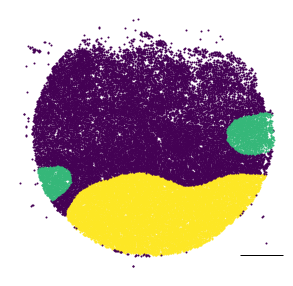

In [154]:
df = pd.read_csv(f"{puck_name}_cell_clones.csv")
Counter(df.TRBs).most_common()
most_common_tcr = 'CASRASNEQFF'

bc_to_loc = {}
loc_to_tcr = {}
tcr_to_loc = {}
tumor_locs = []
all_tcr_locs = []
tcr_to_state = {}
for index, row in df.iterrows():
    bc = row['Unnamed: 0'][:-2]
    loc = (row.x, row.y)
    tcr = row.TRBs
    bc_to_loc[bc] = loc
    loc_to_tcr[loc] = tcr
    if tcr not in tcr_to_loc:
        tcr_to_loc[tcr] = []
    tcr_to_loc[tcr].append(loc)

    if row['type'] == 'Tumor':
        tumor_locs.append(loc)
    if type(tcr) == str:
        all_tcr_locs.append(loc)

    if tcr not in tcr_to_state:
        tcr_to_state[tcr] = []
    tcr_to_state[tcr].append(row.type)
#df = df[~df.TRBs.isnull()]
all_regions = set(df.spot)
colors = cm.viridis(np.linspace(0, 1, len(all_regions)))

colors = np.array([
    [0.190631, 0.407061, 0.556089, 1.],  #blue
    [0.993248, 0.906157, 0.143936, 1.],  #yellow
    [0.267004, 0.004874, 0.329415, 1.],  #purple
    [0.20803, 0.718701, 0.472873, 1.]  #teal
])

colors = np.array([
    [0.993248, 0.906157, 0.143936, 1.],  #blue
    [0.993248, 0.906157, 0.143936, 1.],  #yellow
    [0.267004, 0.004874, 0.329415, 1.],  #purple
    [0.20803, 0.718701, 0.472873, 1.]  #teal
])
region_cmap = {}
for r in all_regions:
    if r == 'Fibrostromal':
        region_cmap[r] = [0.267004, 0.004874, 0.329415, 1.]
    if 'Lobe' in r:
        region_cmap[r] = [0.993248, 0.906157, 0.143936, 1.]
    if r == 'Tumor':
        region_cmap[r] = [0.993248, 0.906157, 0.143936, 1.]
    if r == 'TLS':
        region_cmap[r] = [0.20803, 0.718701, 0.472873, 1.]

fig, ax = plt.subplots(figsize=(5, 5))
for region, c in zip(all_regions, colors):
    x = df[df.spot == region].x
    y = df[df.spot == region].y
    plt.scatter(x, y, s=1, alpha=1, label=region, color=region_cmap[region])
    plt.axis('off')
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
#plt.legend()
ax.add_artist(scalebar)

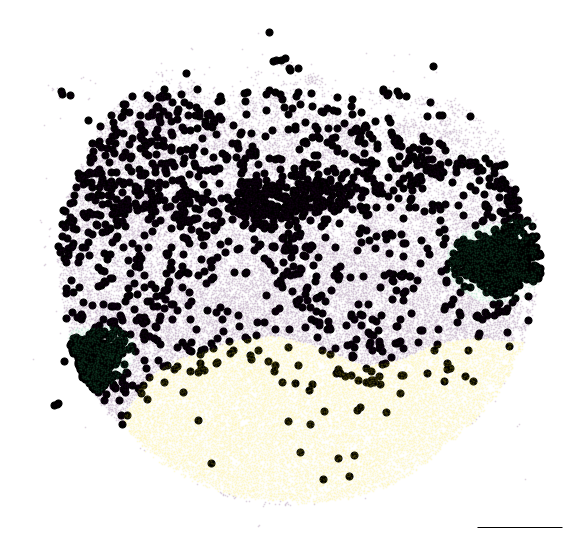

In [155]:
# ONLY PLOT B-CELLS
for cell_type in ['B cell']:
    fig, ax = plt.subplots(figsize=(10, 10))
    x = list(df[df.type == 'B cell'].x)
    y = list(df[df.type == 'B cell'].y)
    locs = [(i, j) for i, j in zip(x, y)]
    ax.scatter(x, y, c='black', s=50)

    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )
    #plt.legend()
    ax.add_artist(scalebar)

    for region in all_regions:
        x = df[df.spot == region].x
        y = df[df.spot == region].y
        ax.scatter(x,
                   y,
                   s=1,
                   alpha=0.1,
                   label=region,
                   color=region_cmap[region])
        plt.axis('off')

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


[1.         0.49803922 0.05490196 1.        ]
[0.17254902 0.62745098 0.17254902 1.        ]
[0.54901961 0.3372549  0.29411765 1.        ]


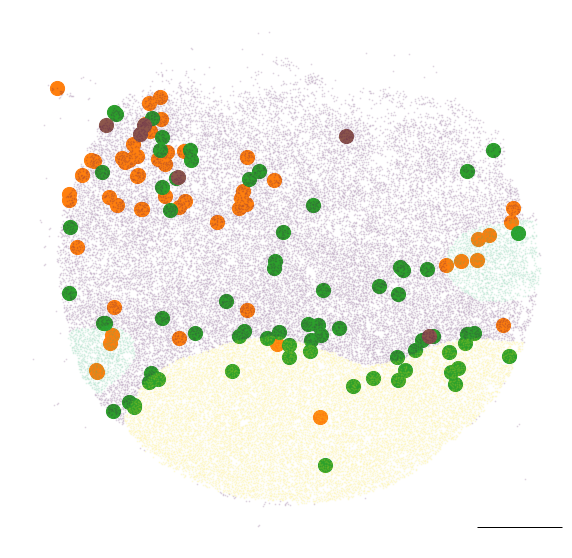

In [158]:
# ONLY PLOT T CELLS
df_to_use = df_filt
all_locs = [(i, j) for i, j in zip(df_to_use.x, df_to_use.y)]

# Set up colors for plots
cmap = cm.tab10(np.linspace(0, 1, 10))

cmap = {
    'CD4': cmap[1],
    'CD8 Exh.': cmap[2],
    'CD8 NonExh.': cmap[5],
    'B-cell': cmap[3]
}

fig, ax = plt.subplots(figsize=(10, 10))
for cell_type in all_cell_types:
    if cell_type not in ['CD8 Exh.', 'CD8 NonExh.', 'CD4']:
        continue

    x = df_to_use[df_to_use.type == cell_type].x
    y = df_to_use[df_to_use.type == cell_type].y
    ax.scatter(x, y, s=200, label=cell_type, c=cmap[cell_type])
    print(cmap[cell_type])
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
plt.axis('off')
#plt.legend()
ax.add_artist(scalebar)
for region in all_regions:
    x = df[df.spot == region].x
    y = df[df.spot == region].y
    ax.scatter(x, y, s=1, alpha=0.1, label=region, color=region_cmap[region])
    plt.axis('off')

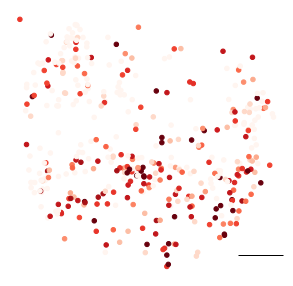

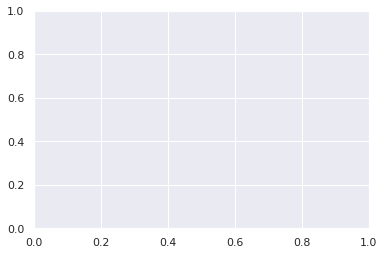

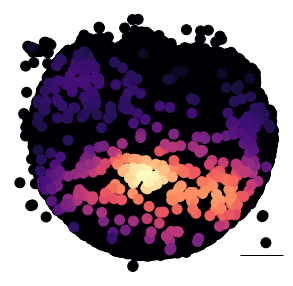

1.792672006549545e-07


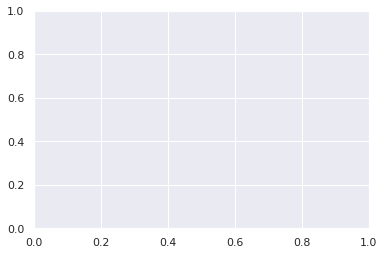

In [159]:
# Expansion

# plt.figure(figsize=(5,5))
locs = [(i, j) for i, j in zip(df_filt.x, df_filt.y)]  # T cell locs
#plt.scatter([i[0] for i in locs],[i[1] for i in locs],s=5,c='blue',alpha=1)

weights_to_use = df_filt.CloneSize

x = [i[0] for i in locs]
y = [i[1] for i in locs]

# Raw data
fig, ax = plt.subplots(figsize=(5, 5))
new_locs = [i for i in all_locs if i not in locs]
new_x = [i[0] for i in new_locs]
new_y = [i[1] for i in new_locs]
new_c = [0] * len(new_locs)
#p = ax.scatter(new_x,new_y,c=new_c,s=100,vmin=0,vmax=max(weights_to_use),cmap='magma')
p = ax.scatter(x,
               y,
               c=np.log10(weights_to_use),
               s=20,
               vmin=0,
               vmax=2,
               cmap='Reds',
               alpha=1,
               linewidth=1)
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
#plt.legend()
ax.add_artist(scalebar)
plt.axis('off')
plt.show()
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(p, ax=ax)
ax.remove()
#plt.savefig('./plots/plot_magma_rcc.pdf')

# Gaussian smoothed plot - Calculate the point density
xy = np.vstack([x, y])
z = gaussian_kde(xy, weights=weights_to_use)(xy)

all_locs_x = list(df.x)
all_locs_y = list(df.y)
all_locs = [(i, j) for i, j in zip(all_locs_x, all_locs_y)]

fig, ax = plt.subplots(figsize=(5, 5))
new_locs = [i for i in all_locs if i not in locs]
new_x = [i[0] for i in new_locs]
new_y = [i[1] for i in new_locs]
new_c = [0] * len(new_locs)
p = ax.scatter(new_x, new_y, c=new_c, s=100, vmin=0, vmax=max(z), cmap='magma')
ax.scatter(x, y, c=z, s=100, vmin=0, vmax=max(z), cmap='magma')
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
#plt.legend()
ax.add_artist(scalebar)
plt.axis('off')
plt.show()
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(p, ax=ax)
ax.remove()
#plt.savefig('./plots/plot_onlycbar_rcc.pdf')

print(max(z))

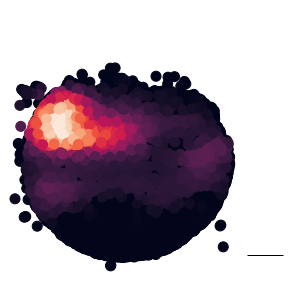

3.604488937940551e-07


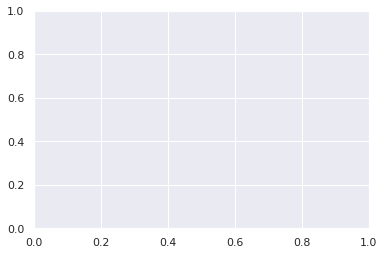

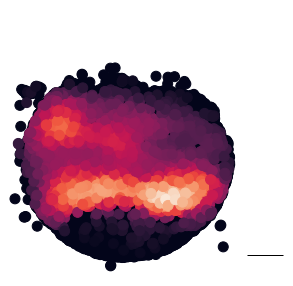

1.88667389060582e-07


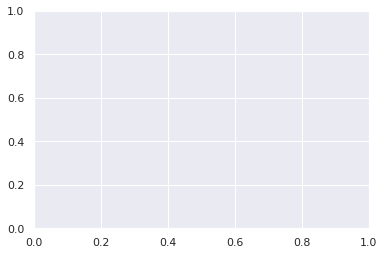

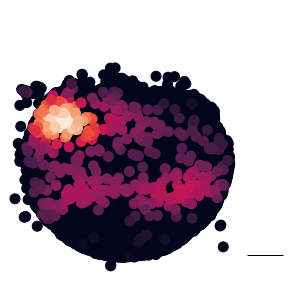

2.1911637071142473e-07


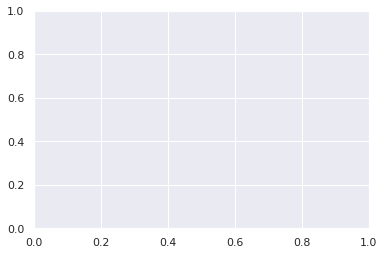

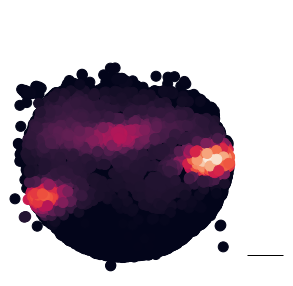

4.3574929231407224e-07


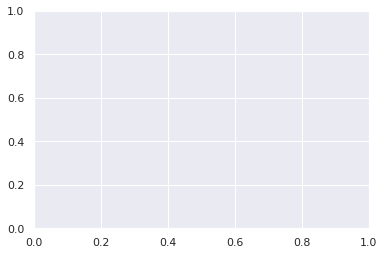

In [160]:
for cell_type in ['CD4', 'CD8 Exh.', 'CD8 NonExh.', 'B cell']:

    x = df[df.type == cell_type].x
    y = df[df.type == cell_type].y
    locs = [(i, j) for i, j in zip(x, y)]

    # Calculate the point density
    xy = np.vstack([x, y])
    z = gaussian_kde(xy)(xy)

    fig, ax = plt.subplots(figsize=(5, 5))
    new_locs = [i for i in all_locs if i not in locs]
    new_x = [i[0] for i in new_locs]
    new_y = [i[1] for i in new_locs]
    new_c = [0] * len(new_locs)
    p = ax.scatter(new_x, new_y, c=new_c, s=100, vmin=0, vmax=max(z))
    ax.scatter(x, y, c=z, s=100, vmin=0, vmax=max(z))
    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )
    #plt.legend()
    ax.add_artist(scalebar)
    plt.axis('off')
    plt.xlim([0, 6000])
    plt.ylim([0, 6000])
    #plt.title(cell_type)
    plt.show()
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(p, ax=ax)
    ax.remove()
    plt.savefig(f'./plots/plot_onlycbar_{cell_type}.pdf')

    print(max(z))

# Figures 4B, 4D, S5B Melanoma TLS analysis
- (A-B) Aligned H&E of a serial section (left), Slide-TCR-seq array (center) with beads colored by RCTD cell type assignments, and zoomed-in Slide-TCR-seq of tertiary lymphoid structure (TLS) (right) in RCC (A) and melanoma (B). 
- (C-D) Region mask of a Slide-TCR-seq array delineating tumor, TLS, and adjacent non-neoplastic regions (top left); beads containing both CDR3 and T cell state colored by RCTD assignment (top center); Gaussian-filtered heatmap visualizing TCRs weighted by the extent of clonal expansion (top right); Gaussian-filtered heatmap normalized to maximum values in TLSs and tumor regions, visualizing the location of B cell, CD4+ T cell, and CD8+ Exhausted (Exh) T cell types (bottom); in RCC (C) and melanoma (D). 
- (S8B) All replicates of the melanoma samples in Figures 4F and 4H. From left to right, 1 – a region mask of a Slide-TCR-seq array delineating tumor, TLS, and adjacent non-neoplastic regions. 2 – a plot of B cells identified through RCTD. 3 - beads containing both CDR3 and T cell state colored by RCTD assignment. 4 – beads containing CDR3 colored by log10(total number of T cells for that clone). 5 – Gaussian-filtered heatmap visualizing TCRs weighted by the extent of clonal expansion.

In [187]:
puck_name = "Puck_220215_14" # Can change this to generate all other pucks in S8B
# all_pucks = [
#         "Puck_220408_09", "Puck_220408_12", "Puck_220408_07", "Puck_220408_08",
#         "Puck_220215_13", "Puck_220215_11",'Puck_220215_14'
#     ]

(2500.0, 3600.0)

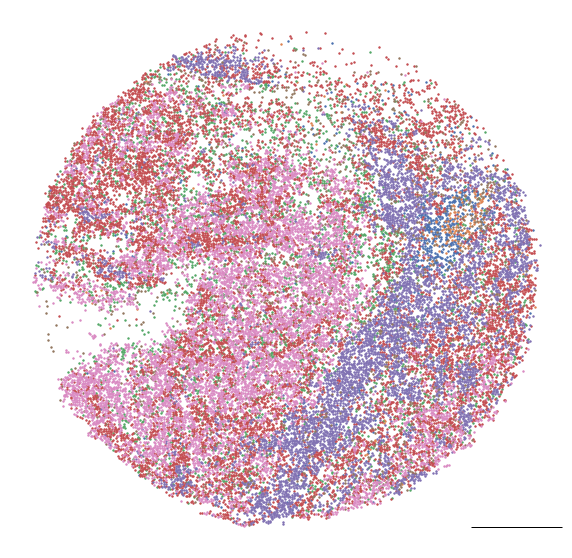

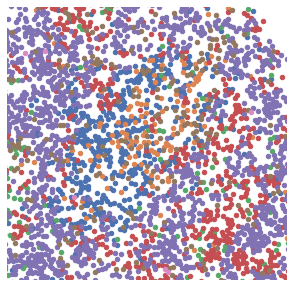

In [199]:
# Figure 4A
df = pd.read_csv(f"{puck_name}_cell_clones.csv")
bc_loc_df = pd.read_csv(f'{puck_name}_barcode_matching.txt', sep='\t')
df_filt = df[~df.TRBs.isnull()]

all_cell_types = [
    'B-cell', 'CD4', 'CD8 Exh.', 'Myeloid', 'Plasma', 'CD8 NonExh.', 'Tfh',
    'Treg', 'Tumor'
]

# Set up colors for plots
cmap = cm.tab10(np.linspace(0, 1, 10))

cmap = {
    'CD4': cmap[1],
    'CD8 Exh.': cmap[2],
    'CD8 NonExh.': cmap[5],
    'B-cell': cmap[3]
}

all_regions = set(df.spot)
region_cmap = {}
for r in all_regions:
    if r == 'Fibrostromal':
        region_cmap[r] = [0.267004, 0.004874, 0.329415, 1.]
    if 'Lobe' in r:
        region_cmap[r] = [0.993248, 0.906157, 0.143936, 1.]
    if r == 'Tumor':
        region_cmap[r] = [0.993248, 0.906157, 0.143936, 1.]
    if r == 'TLS':
        region_cmap[r] = [0.20803, 0.718701, 0.472873, 1.]
        
df_to_use = df[df.maxw > 0.3]
all_locs = [(i, j) for i, j in zip(df_to_use.x, df_to_use.y)]

fig, ax = plt.subplots(figsize=(10, 10))
for cell_type in all_cell_types:
    if cell_type in ['Treg', 'Tfh']:
        continue
    x = df_to_use[df_to_use.type == cell_type].x
    y = df_to_use[df_to_use.type == cell_type].y
    plt.scatter(x, y, s=2, label=cell_type)
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
plt.axis('off')
#plt.legend()
ax.add_artist(scalebar)

df_to_use = df[df.maxw > 0.3]

fig, ax = plt.subplots(figsize=(5, 5))
for cell_type in all_cell_types:
    if cell_type in ['Treg', 'Tfh']:
        continue
    x = df_to_use[df_to_use.type == cell_type].x
    y = df_to_use[df_to_use.type == cell_type].y
    plt.scatter(x, y, s=20, label=cell_type)
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
plt.axis('off')
#ax.add_artist(scalebar)
plt.xlim([3500, 4600])
plt.ylim([2500, 3600])

#plt.legend()

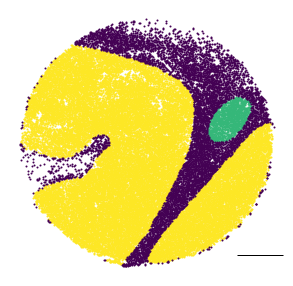

In [200]:
# Plot region mask
df = pd.read_csv(f"{puck_name}_cell_clones.csv")
Counter(df.TRBs).most_common()
most_common_tcr = 'CASRASNEQFF'

bc_to_loc = {}
loc_to_tcr = {}
tcr_to_loc = {}
tumor_locs = []
all_tcr_locs = []
tcr_to_state = {}
for index, row in df.iterrows():
    bc = row['Unnamed: 0'][:-2]
    loc = (row.x, row.y)
    tcr = row.TRBs
    bc_to_loc[bc] = loc
    loc_to_tcr[loc] = tcr
    if tcr not in tcr_to_loc:
        tcr_to_loc[tcr] = []
    tcr_to_loc[tcr].append(loc)

    if row['type'] == 'Tumor':
        tumor_locs.append(loc)
    if type(tcr) == str:
        all_tcr_locs.append(loc)

    if tcr not in tcr_to_state:
        tcr_to_state[tcr] = []
    tcr_to_state[tcr].append(row.type)
#df = df[~df.TRBs.isnull()]
all_regions = set(df.spot)
colors = cm.viridis(np.linspace(0, 1, len(all_regions)))

colors = np.array([
    [0.190631, 0.407061, 0.556089, 1.],  #blue
    [0.993248, 0.906157, 0.143936, 1.],  #yellow
    [0.267004, 0.004874, 0.329415, 1.],  #purple
    [0.20803, 0.718701, 0.472873, 1.]  #teal
])

colors = np.array([
    [0.993248, 0.906157, 0.143936, 1.],  #blue
    [0.993248, 0.906157, 0.143936, 1.],  #yellow
    [0.267004, 0.004874, 0.329415, 1.],  #purple
    [0.20803, 0.718701, 0.472873, 1.]  #teal
])
region_cmap = {}
for r in all_regions:
    if r == 'Fibrostromal':
        region_cmap[r] = [0.267004, 0.004874, 0.329415, 1.]
    if 'Lobe' in r:
        region_cmap[r] = [0.993248, 0.906157, 0.143936, 1.]
    if r == 'Tumor':
        region_cmap[r] = [0.993248, 0.906157, 0.143936, 1.]
    if r == 'TLS':
        region_cmap[r] = [0.20803, 0.718701, 0.472873, 1.]

fig, ax = plt.subplots(figsize=(5, 5))
for region, c in zip(all_regions, colors):
    x = df[df.spot == region].x
    y = df[df.spot == region].y
    plt.scatter(x, y, s=1, alpha=1, label=region, color=region_cmap[region])
    plt.axis('off')
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
#plt.legend()
ax.add_artist(scalebar)

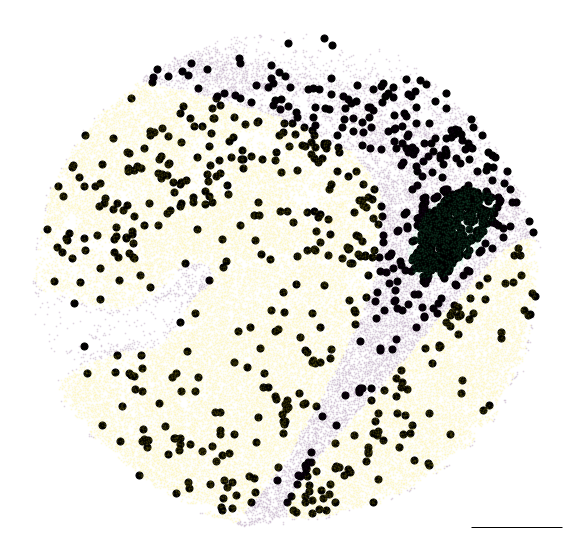

In [201]:
# ONLY PLOT B-CELLS
for cell_type in ['B-cell']:
    fig, ax = plt.subplots(figsize=(10, 10))
    x = list(df[df.type == 'B-cell'].x)
    y = list(df[df.type == 'B-cell'].y)
    locs = [(i, j) for i, j in zip(x, y)]
    ax.scatter(x, y, c='black', s=50)

    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )
    #plt.legend()
    ax.add_artist(scalebar)

    for region in all_regions:
        x = df[df.spot == region].x
        y = df[df.spot == region].y
        ax.scatter(x,
                   y,
                   s=1,
                   alpha=0.1,
                   label=region,
                   color=region_cmap[region])
        plt.axis('off')

[1.         0.49803922 0.05490196 1.        ]
[0.17254902 0.62745098 0.17254902 1.        ]
[0.54901961 0.3372549  0.29411765 1.        ]


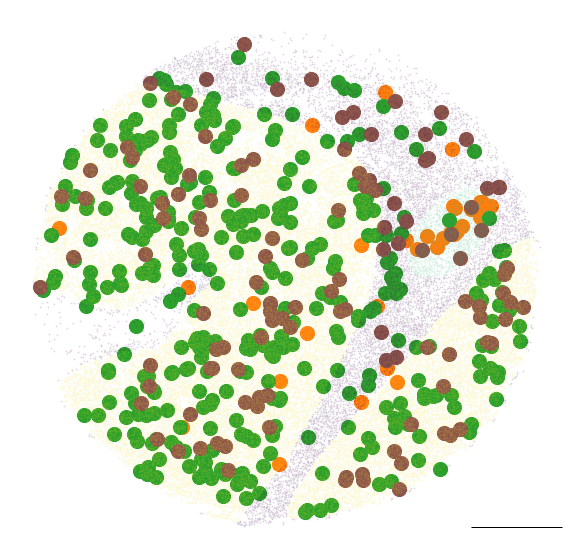

In [202]:
# ONLY PLOT T CELLS
df_to_use = df_filt
all_locs = [(i, j) for i, j in zip(df_to_use.x, df_to_use.y)]

fig, ax = plt.subplots(figsize=(10, 10))
for cell_type in all_cell_types:
    if cell_type not in ['CD8 Exh.', 'CD8 NonExh.', 'CD4']:
        continue

    x = df_to_use[df_to_use.type == cell_type].x
    y = df_to_use[df_to_use.type == cell_type].y
    ax.scatter(x, y, s=200, label=cell_type, c=[cmap[cell_type]])
    print(cmap[cell_type])
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
plt.axis('off')
#plt.legend()
ax.add_artist(scalebar)
for region in all_regions:
    x = df[df.spot == region].x
    y = df[df.spot == region].y
    ax.scatter(x, y, s=1, alpha=0.1, label=region, color=region_cmap[region])
    plt.axis('off')

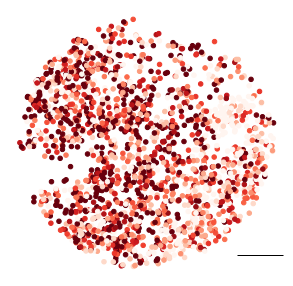

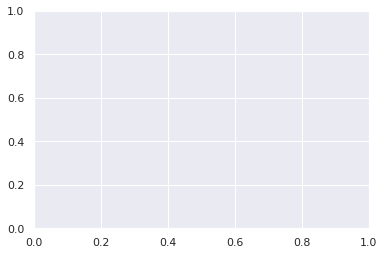

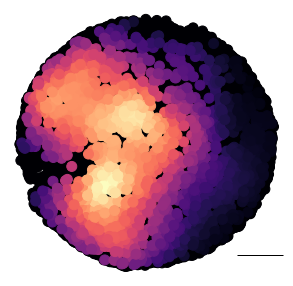

1.4269113033693738e-07


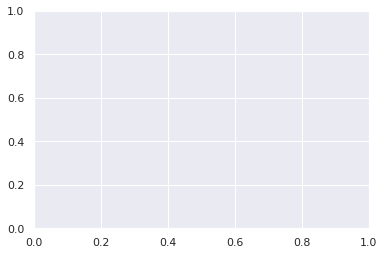

In [203]:
# Expansion

# plt.figure(figsize=(5,5))
locs = [(i, j) for i, j in zip(df_filt.x, df_filt.y)]  # T cell locs
#plt.scatter([i[0] for i in locs],[i[1] for i in locs],s=5,c='blue',alpha=1)

weights_to_use = df_filt.CloneSize

x = [i[0] for i in locs]
y = [i[1] for i in locs]

# Raw data
fig, ax = plt.subplots(figsize=(5, 5))
new_locs = [i for i in all_locs if i not in locs]
new_x = [i[0] for i in new_locs]
new_y = [i[1] for i in new_locs]
new_c = [0] * len(new_locs)
#p = ax.scatter(new_x,new_y,c=new_c,s=100,vmin=0,vmax=max(weights_to_use),cmap='magma')
p = ax.scatter(x,
               y,
               c=np.log10(weights_to_use),
               s=20,
               vmin=0,
               vmax=2,
               cmap='Reds',
               alpha=1,
               linewidth=1)
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
#plt.legend()
ax.add_artist(scalebar)
plt.axis('off')
plt.show()
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(p, ax=ax)
ax.remove()
#plt.savefig('./plots/plot_magma_rcc.pdf')

# Gaussian smoothed plot - Calculate the point density
xy = np.vstack([x, y])
z = gaussian_kde(xy, weights=weights_to_use)(xy)

all_locs_x = list(df.x)
all_locs_y = list(df.y)
all_locs = [(i, j) for i, j in zip(all_locs_x, all_locs_y)]

fig, ax = plt.subplots(figsize=(5, 5))
new_locs = [i for i in all_locs if i not in locs]
new_x = [i[0] for i in new_locs]
new_y = [i[1] for i in new_locs]
new_c = [0] * len(new_locs)
p = ax.scatter(new_x, new_y, c=new_c, s=100, vmin=0, vmax=max(z), cmap='magma')
ax.scatter(x, y, c=z, s=100, vmin=0, vmax=max(z), cmap='magma')
scalebar = AnchoredSizeBar(
    ax.transData,
    pixels_needed,
    "",
    "lower right",
    pad=0.1,
    color="black",
    frameon=False,
    size_vertical=1,
    fontproperties=fontprops,
)
#plt.legend()
ax.add_artist(scalebar)
plt.axis('off')
plt.show()
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(p, ax=ax)
ax.remove()
#plt.savefig('./plots/plot_onlycbar_rcc.pdf')

print(max(z))

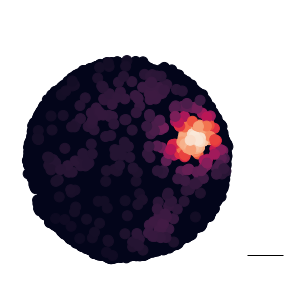

4.366923225300521e-07


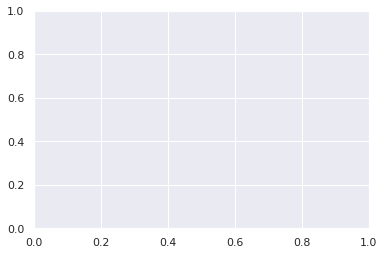

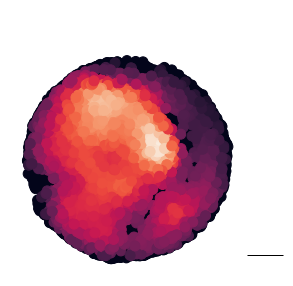

1.394239065435868e-07


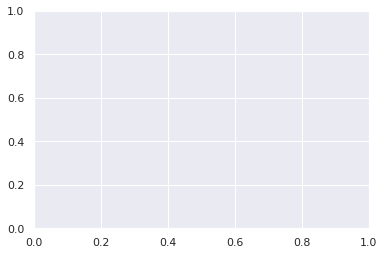

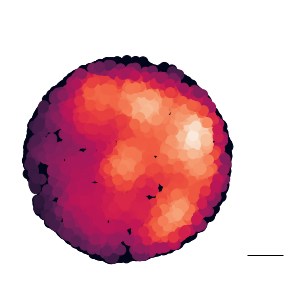

1.189328883306488e-07


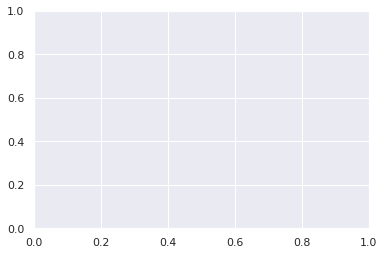

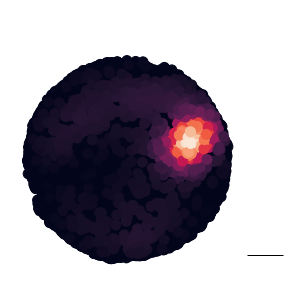

6.0505528435962e-07


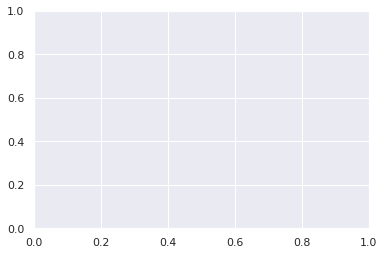

In [204]:
for cell_type in ['CD4', 'CD8 Exh.', 'CD8 NonExh.', 'B-cell']:

    x = df[df.type == cell_type].x
    y = df[df.type == cell_type].y
    locs = [(i, j) for i, j in zip(x, y)]

    # Calculate the point density
    xy = np.vstack([x, y])
    z = gaussian_kde(xy)(xy)

    fig, ax = plt.subplots(figsize=(5, 5))
    new_locs = [i for i in all_locs if i not in locs]
    new_x = [i[0] for i in new_locs]
    new_y = [i[1] for i in new_locs]
    new_c = [0] * len(new_locs)
    p = ax.scatter(new_x, new_y, c=new_c, s=100, vmin=0, vmax=max(z))
    ax.scatter(x, y, c=z, s=100, vmin=0, vmax=max(z))
    scalebar = AnchoredSizeBar(
        ax.transData,
        pixels_needed,
        "",
        "lower right",
        pad=0.1,
        color="black",
        frameon=False,
        size_vertical=1,
        fontproperties=fontprops,
    )
    #plt.legend()
    ax.add_artist(scalebar)
    plt.axis('off')
    plt.xlim([0, 6000])
    plt.ylim([0, 6000])
    #plt.title(cell_type)
    plt.show()
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(p, ax=ax)
    ax.remove()
    plt.savefig(f'./plots/plot_onlycbar_{cell_type}.pdf')

    print(max(z))

# Figures 4E-H RCC and Melanoma TLS and T cell state analysis
- (E-F) Grouped barplot visualizing the fraction of T cells in each compartment (TLS, tumor, and adjacent non-neoplastic) grouped by the extent of clonal expansion of the T cells in RCC (E; n=4 arrays across two regions) and melanoma (F; n=5 arrays across three regions).
- (G-H) Grouped barplot visualizing the fraction of T cells in each compartment (TLS, tumor, adjacent non-neoplastic) grouped by their T cell states in RCC (G; n=4 arrays across two regions) and melanoma (H; n=5 arrays across three regions). 

In [248]:
sample_type = 'mel' # can change to "rcc"

if sample_type == 'mel':
    all_pucks = [
        "Puck_220408_09", "Puck_220408_12", "Puck_220408_07", "Puck_220408_08",
        "Puck_220215_13", "Puck_220215_11",'Puck_220215_14'
    ]
if sample_type == 'rcc':
    all_pucks = ['Puck_220408_13', 
                 'Puck_220408_14', 'Puck_220408_15', 'Puck_220408_20']

In [249]:
if sample_type == 'mel':
    clone_dfs=[]
    state_dfs=[]
    conf_t=False
    for puck in all_pucks:
        print(puck)
        obs = pd.read_csv(f"{puck}_cell_clones.csv")
        adsub=obs[(~obs.TRBs.isna()) & (obs.type.isin(['Treg','Tfh','CD4','CD8 Exh.','CD8 NonExh.']))].copy()
        if not conf_t:
            cells=obs[['Treg','Tfh','CD4','CD8 Exh.','CD8 NonExh.']].copy()
            maxw=cells.max(axis=1).to_list()
            cells.idxmax(axis=1)
            obs['type']=cells.idxmax(axis=1).to_list()
            obs['maxw']=maxw
            adsub=obs[~obs.TRBs.isna()].copy()
        expansion=[]
        for i in adsub.CloneSize:
            if i==1:
                expansion.append('1')
            if i>1 and i<6:
                expansion.append('2-5')
            if i>=6 and i<30:
                expansion.append('6-29')
            if i>=30:# and i<400:
                expansion.append('>30')
            #if i>=100 and i<400:
            #    expansion.append('100-400 Members')
    #         if i>400:
    #             expansion.append('CASRASNEQFF')
        adsub['Clonality']=expansion
        table=adsub.groupby('spot')['Clonality'].value_counts()
        table=table.unstack(level=1)
        #table=table.divide(table.sum(axis=1),axis='rows')*100
        #if 'TLS' not in table.index:
        #    table.loc['TLS']=[0,0,0,0,0]
        clone_dfs.append(table)
        table=adsub.groupby('spot')['type'].value_counts()
        table=table.unstack(level=1)
        #table=table.divide(table.sum(axis=1),axis='rows')*100
        #if 'TLS' not in table.index:
        #    table.loc['TLS']=[0,0,0,0,0]
        state_dfs.append(table)
    # 1:55
    state_final=reduce(lambda a, b: a.add(b, fill_value=0), state_dfs)
    state_final=state_final.divide(state_final.sum(axis=1),axis='rows')*100
    clones_final=reduce(lambda a, b: a.add(b, fill_value=0), clone_dfs)
    clones_final=clones_final.divide(clones_final.sum(axis=1),axis='rows')*100
    clones_final=clones_final[['1','2-5', '6-29','>30']] #, 'CASRASNEQFF'
    #plt.tight_layout()
    #plt.savefig('MEL_clonality_location.pdf',bbox_inches='tight');
if sample_type == 'rcc':
        # RCC processing
    clone_dfs=[]
    state_dfs=[]
    conf_t=False
    for puck in all_pucks:
        print(puck)
        obs = pd.read_csv(f"{puck}_cell_clones.csv")
        adsub=obs[(~obs.TRBs.isna()) & (obs.type.isin(['Treg','Tfh','CD4','CD8 Exh.','CD8 NonExh.']))].copy()
        if not conf_t:
            cells=obs[['Treg','CD4','CD8 Exh.','CD8 NonExh.']].copy()
            maxw=cells.max(axis=1).to_list()
            cells.idxmax(axis=1)
            obs['type']=cells.idxmax(axis=1).to_list()
            obs['maxw']=maxw
            adsub=obs[~obs.TRBs.isna()].copy()
        expansion=[]
        for i in adsub.CloneSize:
            if i==1:
                expansion.append('1')
            if i>1 and i<11:
                expansion.append('2-10')
            if i>=11:# and i<400:
                expansion.append('>11')
            #if i>=100 and i<400:
            #    expansion.append('100-400 Members')
    #         if i>400:
    #             expansion.append('CASRASNEQFF')
        adsub['Clonality']=expansion
        table=adsub.groupby('spot')['Clonality'].value_counts()
        table=table.unstack(level=1)
        #table=table.divide(table.sum(axis=1),axis='rows')*100
        #if 'TLS' not in table.index:
        #    table.loc['TLS']=[0,0,0,0,0]
        clone_dfs.append(table)
        table=adsub.groupby('spot')['type'].value_counts()
        table=table.unstack(level=1)
        #table=table.divide(table.sum(axis=1),axis='rows')*100
        #if 'TLS' not in table.index:
        #    table.loc['TLS']=[0,0,0,0,0]
        state_dfs.append(table)
    # 1:55
    state_final=reduce(lambda a, b: a.add(b, fill_value=0), state_dfs)
    state_final=state_final.divide(state_final.sum(axis=1),axis='rows')*100
    clones_final=reduce(lambda a, b: a.add(b, fill_value=0), clone_dfs)
    clones_final=clones_final.divide(clones_final.sum(axis=1),axis='rows')*100
    clones_final=clones_final[['1','2-10','>11']] #, 'CASRASNEQFF'
    
    #plt.tight_layout()
    #plt.savefig('MEL_clonality_location.pdf',bbox_inches='tight');

Puck_220408_09
Puck_220408_12
Puck_220408_07
Puck_220408_08
Puck_220215_13
Puck_220215_11
Puck_220215_14


In [250]:
# Normalize plots by compartment
regions_all = ['TLS','Tumor','Fibrostromal']

state_dfs_norm = normalize_by_compartment(state_dfs,sample=sample_type)
clone_dfs_norm = normalize_by_compartment(clone_dfs,sample=sample_type)

if sample_type=='mel':
    state_dfs_updated = update_df_reps(state_dfs_norm,['CD4','CD8 Exh.', 'CD8 NonExh.','Tfh','Treg'])
    clone_dfs_updated = update_df_reps(clone_dfs_norm,['1','2-5','6-29','>30', ] )
elif sample_type=='rcc':
    state_dfs_updated = update_df_reps(state_dfs_norm,['CD4','CD8 Exh.', 'CD8 NonExh.','Treg'])
    clone_dfs_updated = update_df_reps(clone_dfs_norm,['1','2-10','>11'] )

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

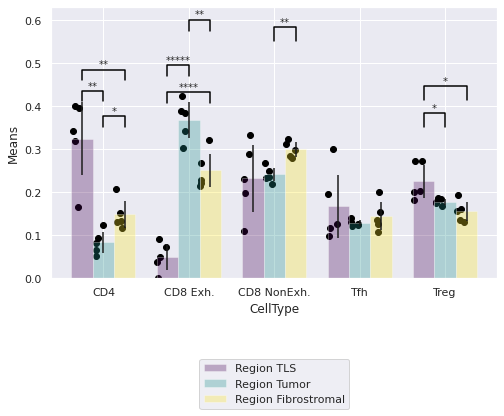

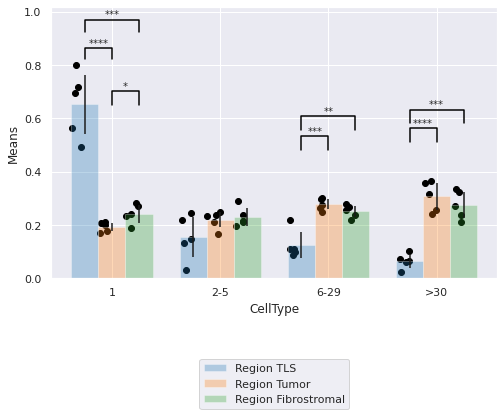

In [251]:
cat = "CellType"
subcat = "Region"
val = "Means"
err = "StDev"


if sample_type == 'mel':
    all_p1 = make_bar_plot(state_dfs_updated,['CD4','CD8 Exh.', 'CD8 NonExh.','Tfh','Treg'],cm.viridis(np.linspace(0, 1, 3)))
    plt.savefig('./plots/plot.pdf')
    all_p2 = make_bar_plot(clone_dfs_updated,['1','2-5','6-29','>30', ],cm.tab10(np.linspace(0, 1, 10)))
    plt.savefig('./plots/plot2.pdf')

if sample_type == 'rcc':
    all_p1 = make_bar_plot(state_dfs_updated,['CD4','CD8 Exh.', 'CD8 NonExh.','Treg'],cm.viridis(np.linspace(0, 1, 3)))
    plt.savefig('./plots/plot.pdf')
    all_p2 = make_bar_plot(clone_dfs_updated,['1','2-10','>11', ],cm.tab10(np.linspace(0, 1, 10)))
    plt.savefig('./plots/plot2.pdf')

In [252]:
# Correct p-values for multiple hypotheses in final figures
print(statsmodels.stats.multitest.fdrcorrection(all_p2))
print(all_p2)

(array([ True,  True,  True, False, False, False,  True,  True, False,
        True,  True, False]), array([2.15638453e-04, 3.03117146e-04, 4.88494827e-02, 1.75155117e-01,
       1.46204364e-01, 6.67518516e-01, 7.99444190e-04, 2.39738611e-03,
       1.46204364e-01, 2.15638453e-04, 2.34127947e-04, 4.17305993e-01]))
[3.593974210291121e-05, 0.00010103904861856125, 0.028495531580962092, 0.1459625973298287, 0.10667980782956756, 0.6675185156181048, 0.0003331017459895014, 0.001198693057090976, 0.10965327335681532, 2.6058867516267966e-05, 5.8531986841111384e-05, 0.3825304940051497]


# Figures 5A-C, S5C Visualization of two lobes of tumor in melanoma
- (A) H&E of melanoma tumor sample (top) and schematic illustrating the delineation of two distinct lobes (orange and blue) of the tumor across the corresponding H&E, Slide-TCR-seq arrays, and constructed region masks (bottom). ROI = region of interest.
- (B) Spatial enrichment of TCRs between the two lobes, tested by chi-square test (n=7 arrays across three regions). 
- (C) Visualization of all TCRs (left) and the CASRASNEQFF TCR clonotype (right) across one array from each of the three regions. These visualizations are representative of the findings across the serial replicates, shown in Figure S8.
- (S8C) All replicates used in analyses in Figure 5. Visualization of all TCRs (left) and the CASRASNEQFF TCR clonotype (right) across all replicate arrays.

In [253]:
puck = "Puck_220215_14" # Can change this to generate all other pucks in S8B
# all_pucks = [
#         "Puck_220408_09", "Puck_220408_12", "Puck_220408_07", "Puck_220408_08",
#         "Puck_220215_13", "Puck_220215_11",'Puck_220215_14'
#     ]

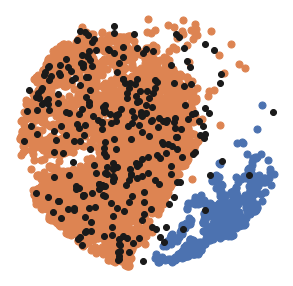

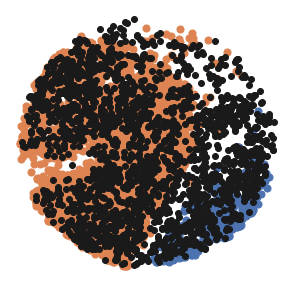

In [254]:
switch = True # Can change this to switch blue and orange coloring, because kmeans coloring is not consistent
locs = tumor_locs
plt.figure(figsize=(5, 5))

if puck not in ["Puck_220408_08","Puck_220215_11","Puck_220215_14","Puck_220215_13"]:
    
    kmeans = KMeans(n_clusters=2, init='k-means++', random_state=0).fit(locs)
    kmeans

    if switch:
        locs_0 = [locs[idx] for idx, val in enumerate(kmeans.labels_) if val == 1]
        locs_1 = [locs[idx] for idx, val in enumerate(kmeans.labels_) if val == 0]
    else:
        locs_1 = [locs[idx] for idx, val in enumerate(kmeans.labels_) if val == 1]
        locs_0 = [locs[idx] for idx, val in enumerate(kmeans.labels_) if val == 0]
    plt.scatter([i[0] for i in locs_0], [i[1] for i in locs_0], s=50)
    plt.scatter([i[0] for i in locs_1], [i[1] for i in locs_1], s=50)

    locs = tcr_to_loc[most_common_tcr]
    plt.scatter([i[0] for i in locs], [i[1] for i in locs], c='k')
    plt.axis('off')

    ##### Plot all clones

    locs = tumor_locs
    plt.figure(figsize=(5, 5))
    kmeans = KMeans(n_clusters=2, init='k-means++', random_state=0).fit(locs)
    kmeans

    if switch:
        locs_0 = [locs[idx] for idx, val in enumerate(kmeans.labels_) if val == 1]
        locs_1 = [locs[idx] for idx, val in enumerate(kmeans.labels_) if val == 0]
    else:
        locs_1 = [locs[idx] for idx, val in enumerate(kmeans.labels_) if val == 1]
        locs_0 = [locs[idx] for idx, val in enumerate(kmeans.labels_) if val == 0]
    plt.scatter([i[0] for i in locs_0], [i[1] for i in locs_0], s=50)
    plt.scatter([i[0] for i in locs_1], [i[1] for i in locs_1], s=50)

    locs = all_tcr_locs
    plt.scatter([i[0] for i in locs], [i[1] for i in locs], c='k')
    plt.axis('off')
else:
    if puck_name == "Puck_220408_08":
        slope = 0.6  # for 8
        intercept = 1900  # for 8
    if puck_name == "Puck_220215_11":
        slope = -0.3  # for 11
        intercept = 3500  # for 11
    if puck_name == "Puck_220215_14":
        slope = 1.7  # for 14
        intercept = -3700  # for 14
    if puck_name == "Puck_220215_13":
        slope = 0.95  # for 13
        intercept = 0  # for 13

    if switch:
        locs_0 = [i for i in locs if (i[1] - (slope * i[0] + intercept) < 0)]
        locs_1 = [i for i in locs if i not in locs_0]
    else:
        locs_1 = [i for i in locs if (i[1] - (slope * i[0] + intercept) < 0)]
        locs_0 = [i for i in locs if i not in locs_1]
    plt.scatter([i[0] for i in locs_0], [i[1] for i in locs_0], s=50)
    plt.scatter([i[0] for i in locs_1], [i[1] for i in locs_1], s=50)
    #abline(1.7,-3700)
    #plt.ylim([0,6000])

    locs = tcr_to_loc[most_common_tcr]
    plt.scatter([i[0] for i in locs], [i[1] for i in locs], c='k')
    plt.axis('off')

    ##### Plot all clones

    locs = tumor_locs
    plt.figure(figsize=(5, 5))
    kmeans = KMeans(n_clusters=2, init='k-means++', random_state=0).fit(locs)
    kmeans

    if switch:
        locs_0 = [i for i in locs if (i[1] - (slope * i[0] + intercept) < 0)]
        locs_1 = [i for i in locs if i not in locs_0]
    else:
        locs_1 = [i for i in locs if (i[1] - (slope * i[0] + intercept) < 0)]
        locs_0 = [i for i in locs if i not in locs_1]
    plt.scatter([i[0] for i in locs_0], [i[1] for i in locs_0], s=50)
    plt.scatter([i[0] for i in locs_1], [i[1] for i in locs_1], s=50)

    locs = all_tcr_locs
    plt.scatter([i[0] for i in locs], [i[1] for i in locs], c='k')
    plt.axis('off')

In [255]:
# Figure 5B - region biases of clones
def region_count(list_of_puck_names):
    region_counter = {}  # Clone: {'Lobe1':[],'Lobe2':[]}
    for fn in list_of_puck_names:
        df = pd.read_csv(f'{fn}_cell_clones.csv')

        for index, row in df[~df.TRBs.isnull()].iterrows():
            tcr = row.TRBs
            if tcr not in region_counter:
                region_counter[tcr] = {'Lobe1': 0, 'Lobe2': 0}
            if row.spot == 'Lobe1':
                region_counter[tcr]['Lobe1'] += 1
            if row.spot == 'Lobe2':
                region_counter[tcr]['Lobe2'] += 1
    return region_counter


reg1 = region_count(["Puck_220408_09","Puck_220408_12"])

reg2 = region_count(["Puck_220408_07", "Puck_220408_08"])

reg3 = region_count(["Puck_220215_13", "Puck_220215_11", "Puck_220215_14"])

[33, 328] [[125.44401544 235.55598456]
 [234.55598456 440.44401544]]
[28, 203] [[ 88.5840708 142.4159292]
 [171.4159292 275.5840708]]
[19, 402] [[130.68215613 290.31784387]
 [203.31784387 451.68215613]]
{'CASRASNEQFF': 102.68602729228292, 'CASSFGQRGYEQYF': 16.855725933531286, 'CASSATNEQFF': 12.131251314373479, 'CASSLVVSYEQYF': 9.075538070426617, 'CASSFGGRTYEQYF': 9.075538070426617, 'CASSSLQGDPQPQHF': 8.383726394856318, 'CASSSGTGWYTEAFF': 7.717606641679609, 'CASIRGPLMGYTF': 7.269028916825818, 'CASSFGRRTYEQYF': 6.938131602973385, 'CAITQGENEQFF': 6.232766073567345, 'CASSFPGQDTQYF': 6.180801194677384, 'CASRPGTGNEQYF': 5.717308930130105, 'CATTGDYEQYF': 4.903420906192272, 'CASSPTSGGANEQFF': 4.233418308544462, 'CASSSGTNTGELFF': 2.2870964367069138, 'CASSSGGGNTIYF': 1.7908393173543204, 'CASSLGGAVGNEQFF': 1.7908393173543204, 'CASSQDPTTGNEQFF': 1.6130406066432128, 'CAISETRDWTYEQYF': 1.0853946786127175, 'CASSFGHRTYEQYF': 0.914969705567938, 'CSARRGGSTQYF': 0.8689688227066603, 'CASSPPTVAKNIQYF': 0.7

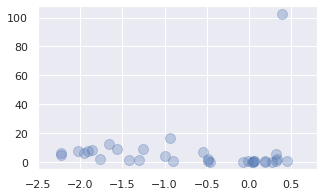

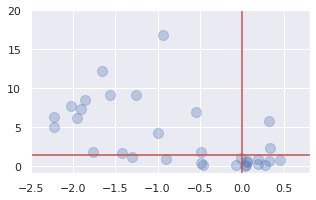

In [256]:
# only look at shared tcrs
tcr_enrichment = {}
tcr_p_values = {}

shared_tcrs = []
all_lobe1 = [0,0,0]
all_lobe2 = [0,0,0]

for tcr in reg1:
    if tcr not in reg1:
        continue
    if tcr not in reg2:
        continue
    if tcr not in reg3:
        continue
    if sum(reg1[tcr].values())<5: # only analyze tcrs with at least 5 counts in each replicate
        continue
    if sum(reg2[tcr].values())<5:
        continue
    if sum(reg3[tcr].values())<5:
        continue
    shared_tcrs.append(tcr)
    
for idx,reg in enumerate([reg1, reg2, reg3]):
    for tcr in shared_tcrs:
        all_lobe1[idx] += reg[tcr]['Lobe1']
        all_lobe2[idx] += reg[tcr]['Lobe2']  

all_rep_p_values = {}
all_rep_enrichment = {}
# calculate enrichment in each replicate
for tcr in shared_tcrs:
    all_rep_p_values[tcr] = []
    all_rep_enrichment[tcr] = []
    for idx,reg in enumerate([reg1,reg2,reg3]): #reg2, reg3
        obs = list(reg[tcr].values())
        chi2, p, dof, expected = scipy.stats.chi2_contingency([obs,[all_lobe1[idx]-obs[0],all_lobe2[idx]-obs[1]]])
        if tcr == 'CASRASNEQFF':
            print(obs, expected)
        if expected[0][0] < obs[0]:
            tcr_enrichment[tcr] = -(obs[0]-expected[0][0])/expected[0][0]
        else:
            tcr_enrichment[tcr] = (obs[1]-expected[0][1])/expected[0][1]

        tcr_p_values[tcr] = p
        all_rep_p_values[tcr].append(p)
        all_rep_enrichment[tcr].append(tcr_enrichment[tcr])

combined_p_values = {}

for tcr in all_rep_p_values:
    combined_p_values[tcr] = scipy.stats.combine_pvalues(all_rep_p_values[tcr])[1]

tcr_list = list(combined_p_values.keys())
new_p_values = statsmodels.stats.multitest.fdrcorrection(list(combined_p_values.values()))[1]
corrected_combined_p_values = {i:j for i,j in zip(tcr_list,new_p_values)}


print({k: -np.log10(v) for k, v in sorted(corrected_combined_p_values.items(), key=lambda item: item[1])})
x = tcr_enrichment.values()
y = -np.log10(list(corrected_combined_p_values.values()))
plt.figure(figsize=(5,3))
plt.scatter(x,y,alpha=0.3,s=100)
plt.xlim([-2.5,0.8])
plt.savefig('./plots/enrichment_outlier.pdf')
plt.show()

fig,ax = plt.subplots(figsize=(5,3))
plt.scatter(x,y,alpha=0.3,s=100)
plt.ylim([-1,20])
plt.xlim([-2.5,0.8])
plt.axhline(y=-np.log10(0.05),c='r')
plt.axvline(x=0,c='r')

plt.savefig('./plots/enrichment.pdf')
plt.show()

# Figure 5D CASRASNEQFF gene expression vs. all other TCRs
- (D) Differentially expressed genes between T cells with the CASRASNEQFF clonotype (right) and all other TCRs (left) (STAR Methods), with blue dots representing statistically significant differentially-expressed genes with absolute log fold change > 0.4 (n=7 arrays across three regions).

In [267]:
plot_df = pd.read_csv('tcr_de_genes.csv')

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

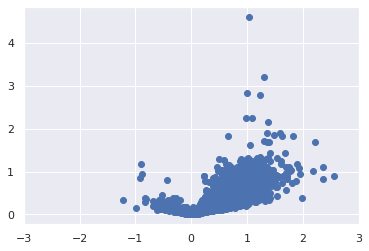

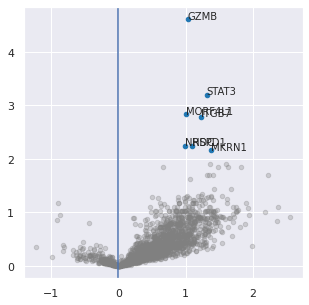

In [268]:
colors = cm.tab10(np.linspace(0, 1, 10))

plot_df['neg_log_q']= -np.log10(plot_df.q_val)
x = plot_df.log_fc_est
y = plot_df.neg_log_q
plt.scatter(x,y)
plt.xlim([-3,3])

f, ax = plt.subplots(figsize=(5,5))
# ax.set(yscale="log")
# p = sns.scatterplot(data=plot_df,x='log_fc_est',y='neg_log_p',s=20,color='gray')
plt.scatter(plot_df['log_fc_est'],plot_df['neg_log_q'],s=20,color='gray',alpha=0.3)
df = plot_df
for i in range(df.shape[0]):
    x = df.log_fc_est[i]
    y = df.neg_log_q[i]
    
    if y < -np.log10(0.01): #0.0006168328 for mono macro # for tcr 2.529153e-05
        continue
    if np.abs(x)<0.40:
        continue
    plt.text(x,y=df.neg_log_q[i],s=df['Unnamed: 0'][i])
    plt.scatter(x,y,c=colors[0],s=20)
plt.axvline(x=0)

#ax.set_ylim([min(df.neg_log_p)/2,max(df.neg_log_p)*3])
plt.savefig('TCR_de.pdf')


# Figures 5E Cell interactions with CASRASNEQFF clone
- (E) i. Differentially expressed genes between monocytes (M) within 20 µm of T cells with CASRASNEQFF (right; T\*) and monocytes within 20 µm of all other TCRs (left; T), excluding any monocytes that are within 20 µm of both T cells with CASRASNEQFF and other TCRs. 
ii. Differentially expressed genes between tumor cells (Tum) within 20 µm of T cells with CASRASNEQFF (right; T\*) and tumor cells within 20 µm of all other TCRs (left; T), excluding any tumor cells that are within 20 µm of both T cells with CASRASNEQFF and other TCRs (STAR Methods). Blue dots represent statistically significant differentially-expressed genes with absolute log fold change > 0.4 (n=7 arrays across three regions). 


In [292]:
# Identify locations to test in C-SIDE

## First, make a melanoma reference
mel_ref = sc.read_h5ad('./mel_ref.h5ad')
mel_mtx = sc.read_mtx('./mel_mtx.mtx')

# np.savetxt('./Fastq/dge.csv',asarray(mel_mtx),delimiter=',')
df = pd.DataFrame(data=scipy.sparse.csr_matrix.todense(mel_mtx.X))
df.to_csv("./dge.csv", index=False)

with open('./genes.csv', 'w', newline='') as myfile:
    wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
    wr.writerow(list(mel_ref.var.index))

with open('./barcodes.csv', 'w', newline='') as myfile:
    wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
    wr.writerow(list(mel_ref.obs.index))
with open('./celltype.csv', 'w', newline='') as myfile:
    wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
    wr.writerow(list(mel_ref.obs.CellType))

with open('./nUMI.csv', 'w', newline='') as myfile:
    wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
    wr.writerow(list(mel_ref.obs.total_counts))
    
puck_reps = ["Puck_220408_09","Puck_220408_12",
             "Puck_220408_07","Puck_220408_08",
             "Puck_220215_14","Puck_220215_13","Puck_220215_11"]

# Make new explanatory variable with high T cell vs all other T cells
for fn in puck_reps:
    df = pd.read_csv(f"{fn}_cell_clones.csv")
    df = df[df.spot.isin(['Lobe1','Lobe2'])] ## only look in tumor regions
    Counter(df.TRBs).most_common()
    most_common_tcr = 'CASRASNEQFF'

    bc_to_loc = {}
    loc_to_tcr = {}
    tcr_to_loc = {}
    tumor_locs = []
    all_tcr_locs = []
    tcr_to_state = {}
    for index,row in df.iterrows():
        bc = row['Unnamed: 0'][:-2]
        loc = (row.x,row.y)
        tcr = row.TRBs
        bc_to_loc[bc] = loc
        loc_to_tcr[loc] = tcr
        if tcr not in tcr_to_loc:
            tcr_to_loc[tcr] = []
        tcr_to_loc[tcr].append(loc)

        if row['type'] == 'Tumor':
            tumor_locs.append(loc)
        if type(tcr) ==str :
            all_tcr_locs.append(loc)

        if tcr not in tcr_to_state:
            tcr_to_state[tcr] = []
        tcr_to_state[tcr].append(row.type)
        
    df_filt = df[~df.TRBs.isnull()]
    #region 1 is all other tcrs
    bcs_r1 = list(df_filt[df.TRBs!=most_common_tcr]['Unnamed: 0'])

    # region 2 is most common tcr
    bcs_r2 = list(df[df.TRBs==most_common_tcr]['Unnamed: 0'])

    bcs = bcs_r1 + bcs_r2
    labels = [0]*len(bcs_r1) + [1] * len(bcs_r2)
    
    with open(f'./Fastq/mel{fn[-2:]}_tcr_labels_filt_tumor.csv', 'w', newline='') as myfile:
        wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
        wr.writerow(bcs)
        wr.writerow(labels)

/home/jupyter/packages/ipykernel_launcher.py:64: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [293]:
#split tumor into two regions based on proximity to tcr of interest vs all other tcrs
# find list of points within 50 pixel distance of tcr of interest
# find list of points within 50 pixel distance of other tcrs
# remove intersection

# Make proximity exvar high T cell vs all other T cells FILTERED VERSION

for fn in puck_reps:
    df = pd.read_csv(f"{fn}_cell_clones.csv")
    df = df[df.spot.isin(['Lobe1','Lobe2'])] ## only look in tumor regions
    most_common_tcr = 'CASRASNEQFF'

    bc_to_loc = {}
    loc_to_bc = {}
    loc_to_tcr = {}
    tcr_to_loc = {}
    tumor_locs = []
    all_tcr_locs = []
    tcr_to_state = {}
    for index,row in df.iterrows():
        bc = row['Unnamed: 0'][:-2]
        loc = (row.x,row.y)
        tcr = row.TRBs
        bc_to_loc[bc] = loc
        loc_to_tcr[loc] = tcr
        loc_to_bc[loc] = bc
        if tcr not in tcr_to_loc:
            tcr_to_loc[tcr] = []
        tcr_to_loc[tcr].append(loc)

        if row['type'] == 'Tumor':
            tumor_locs.append(loc)
        if type(tcr) ==str :
            all_tcr_locs.append(loc)

        if tcr not in tcr_to_state:
            tcr_to_state[tcr] = []
        tcr_to_state[tcr].append(row.type)
    
    
    all_points = list(loc_to_tcr.keys())
    all_point_tree = spatial.cKDTree(all_points)
        
    df_filt = df[~df.TRBs.isnull()]
    #region 1 is all other tcrs
    bcs_r1 = list(df_filt[df.TRBs!=most_common_tcr]['Unnamed: 0'])
    locs_r1 = [bc_to_loc[i[:-2]] for i in bcs_r1]
    r1_point_tree = spatial.cKDTree(locs_r1)
    index_r1=all_point_tree.query_ball_tree(r1_point_tree,r=30)
    nearby_locs_r1 = []
    for i in range(len(index_r1)):
        if len(index_r1[i])==0:
            continue
        else:
            nearby_locs_r1.append(all_points[i])
    #index_r1 = list(itertools.chain.from_iterable(index_r1))
    nearby_locs_r1 = set(nearby_locs_r1)
    
    # region 2 is most common tcr
    bcs_r2 = list(df[df.TRBs==most_common_tcr]['Unnamed: 0'])
    locs_r2 = [bc_to_loc[i[:-2]] for i in bcs_r2]
    r2_point_tree = spatial.cKDTree(locs_r2)
    index_r2=all_point_tree.query_ball_tree(r2_point_tree,r=50)
    nearby_locs_r2 = []
    for i in range(len(index_r2)):
        if len(index_r2[i])==0:
            continue
        else:
            nearby_locs_r2.append(all_points[i])
    #index_r1 = list(itertools.chain.from_iterable(index_r1))
    nearby_locs_r2 = set(nearby_locs_r2)
    
    
    exclude_these_locs = set(nearby_locs_r1 & nearby_locs_r2)
    
    nearby_locs_r1 = [i for i in nearby_locs_r1 if i not in exclude_these_locs]
    nearby_locs_r2 = [i for i in nearby_locs_r2 if i not in exclude_these_locs]
    
    bcs1_updated = [loc_to_bc[i] for i in nearby_locs_r1]
    bcs2_updated = [loc_to_bc[i] for i in nearby_locs_r2]
    
    bcs = bcs1_updated + bcs2_updated
    labels = [0]*len(bcs1_updated) + [1] * len(bcs2_updated)

    with open(f'./Fastq/mel{fn[-2:]}_tcr_labels_filt_tumor_exclusive.csv', 'w', newline='') as myfile:
        wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
        wr.writerow(bcs)
        wr.writerow(labels)



/home/jupyter/packages/ipykernel_launcher.py:46: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


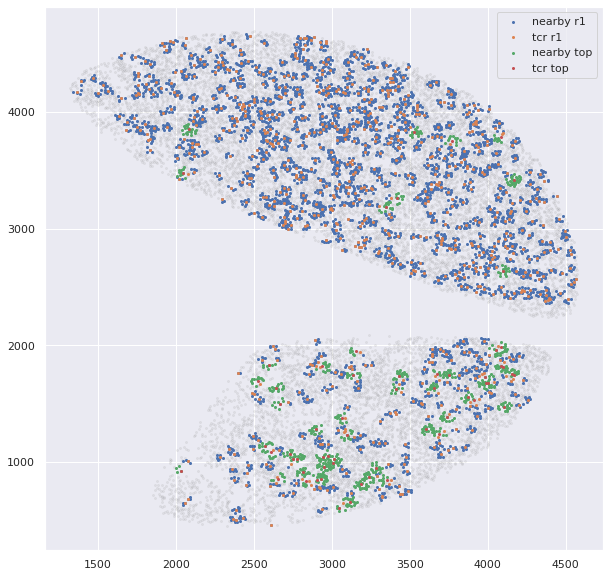

In [294]:
# Visualize adjacent cells
size=4
plt.figure(figsize=(10,10))

x,y = zip(*all_points)
plt.scatter(x,y,c='gray',s=size,alpha=0.1)


x,y = zip(*list(nearby_locs_r1))
plt.scatter(x,y,s=size,label='nearby r1')

x,y = zip(*list(locs_r1))
plt.scatter(x,y,s=size,label='tcr r1')
plt.legend()


x,y = zip(*list(nearby_locs_r2))
plt.scatter(x,y,s=size,label='nearby top')

x,y = zip(*list(locs_r2))
plt.scatter(x,y,s=size,label='tcr top')
plt.legend()

In [17]:
!gsutil cp gs://fc-secure-684f6a10-dafd-4da5-b11e-1883c28668d0/tumor_proximity_de_genes.csv ./

Copying gs://fc-secure-684f6a10-dafd-4da5-b11e-1883c28668d0/tumor_proximity_de_genes.csv...
/ [1 files][417.4 KiB/417.4 KiB]                                                
Operation completed over 1 objects/417.4 KiB.                                    


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

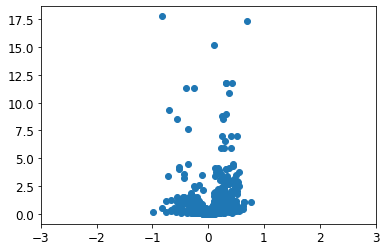

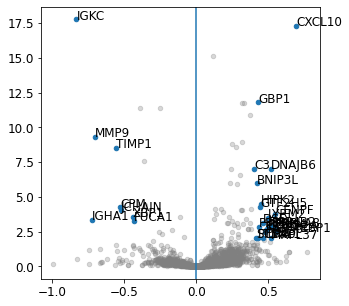

In [15]:
# Figure 5Ei
plot_df = pd.read_csv('monocyte_de_genes.csv')
colors = cm.tab10(np.linspace(0, 1, 10))


plot_df['neg_log_q']= -np.log10(plot_df.q_val)
x = plot_df.log_fc_est
y = plot_df.neg_log_q
plt.scatter(x,y)
plt.xlim([-3,3])

f, ax = plt.subplots(figsize=(5,5))
# ax.set(yscale="log")
# p = sns.scatterplot(data=plot_df,x='log_fc_est',y='neg_log_p',s=20,color='gray')
plt.scatter(plot_df['log_fc_est'],plot_df['neg_log_q'],s=20,color='gray',alpha=0.3)
df = plot_df
for i in range(df.shape[0]):
    x = df.log_fc_est[i]
    y = df.neg_log_q[i]
    
    if y < -np.log10(0.01): #0.0006168328 for mono macro # for tcr 2.529153e-05
        continue
    if np.abs(x)<0.40:
        continue
    plt.text(x,y=df.neg_log_q[i],s=df['Unnamed: 0'][i])
    plt.scatter(x,y,c=colors[0],s=20)
plt.axvline(x=0)

#ax.set_ylim([min(df.neg_log_p)/2,max(df.neg_log_p)*3])
plt.savefig('TCR_de.pdf')


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

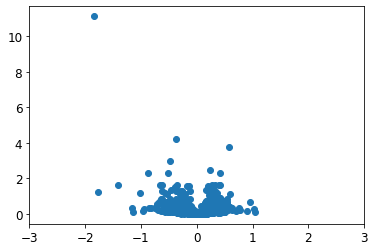

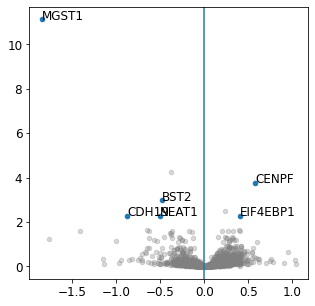

In [18]:
# Figure 5E ii
plot_df = pd.read_csv('tumor_proximity_de_genes.csv')
colors = cm.tab10(np.linspace(0, 1, 10))


plot_df['neg_log_q']= -np.log10(plot_df.q_val)
x = plot_df.log_fc_est
y = plot_df.neg_log_q
plt.scatter(x,y)
plt.xlim([-3,3])

f, ax = plt.subplots(figsize=(5,5))
# ax.set(yscale="log")
# p = sns.scatterplot(data=plot_df,x='log_fc_est',y='neg_log_p',s=20,color='gray')
plt.scatter(plot_df['log_fc_est'],plot_df['neg_log_q'],s=20,color='gray',alpha=0.3)
df = plot_df
for i in range(df.shape[0]):
    x = df.log_fc_est[i]
    y = df.neg_log_q[i]
    
    if y < -np.log10(0.01): #0.0006168328 for mono macro # for tcr 2.529153e-05
        continue
    if np.abs(x)<0.40:
        continue
    plt.text(x,y=df.neg_log_q[i],s=df['Unnamed: 0'][i])
    plt.scatter(x,y,c=colors[0],s=20)
plt.axvline(x=0)

#ax.set_ylim([min(df.neg_log_p)/2,max(df.neg_log_p)*3])
plt.savefig('TCR_de.pdf')


# Figure 5F-G Gene expression in adjacent cells
- (F) Beads colored by CXCL10 expression (purple, counts ≥2) in one array. 
- (G) Beads colored by MGST1 expression (green, counts ≥1) in one array.

In [32]:
slideseq_name = '2022-05-03_Puck_220408_09' 
#puck_mel9 =  load_puck(slideseq_name)
puck_mel9 = PuckReplicate(
    puck_name='2022-05-03_Puck_220408_09',  # Name of the Slide-seq puck
    genome="hg19",  # Genome"
    clonotype_sample_name="",
    clonotype_mixcr_name="",  # Name of the MiXCR outputs
    clonotype_fastq_name="",  # Name of the rhPCR sequencing results
    umi_filter_number=
    1,  # We consider clonotypes on beads with > umi_filter_number UMIs.
    rctd_fn="".format(directory_out),
    resave=False,  # See note below
    resave_sparse=False,
    pub=True,
    skip_clonotype=True,
    file_type='slide-seq-tools')  # Set note below


1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000


In [34]:
df = pd.read_csv("Puck_220408_09_cell_clones.csv")
#df_filt = df[~df.TRBs.isnull()]
df_bc_to_loc = {}

for index,row in tqdm(df.iterrows()):
    df_bc_to_loc[row['Unnamed: 0']] = (row.x,row.y)
df_filt = df[df.maxw>0.3]

tumor_bcs = list(df_filt[df_filt.type == 'Tumor']['Unnamed: 0'])
tumor_locs = [df_bc_to_loc[i] for i in tumor_bcs]

0it [00:00, ?it/s]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


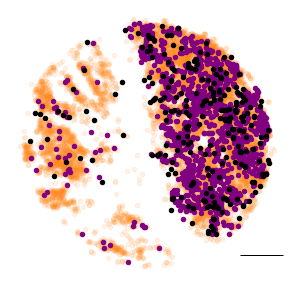

In [35]:
# Figure 5F
cutoff = 2
gene_name = 'CXCL10'

bcs = puck_mel9.s1_dge_fmtd[puck_mel9.s1_dge_fmtd[gene_name] >= cutoff].index
bcs = [i for i in bcs if (i in tumor_bcs)]
colors = list(puck_mel9.s1_dge_fmtd.loc[bcs][puck_mel9.s1_dge_fmtd.loc[bcs][gene_name] >= cutoff][gene_name])
locs = [df_bc_to_loc[i] for i in bcs]

most_common_tcr = 'CASRASNEQFF'
tcr_bcs = df[df.TRBs==most_common_tcr]['Unnamed: 0']
tcr_locs = [df_bc_to_loc[i] for i in tcr_bcs]

cmap = cm.tab10(np.linspace(0, 1, 10))

fig,ax = plt.subplots(figsize=(5,5))
x,y = zip(*tumor_locs)
plt.scatter(x,y,c=cmap[1],s=20,alpha=0.1)

x,y = zip(*locs)
plt.scatter(x,y,c='purple',s=20,alpha=1)

x,y = zip(*tcr_locs)
plt.scatter(x,y,c='k',s=20)

scalebar = AnchoredSizeBar(
ax.transData,
pixels_needed,
"",
"lower right",
pad=0.1,
color="black",
frameon=False,
size_vertical=1,
fontproperties=fontprops,
)
plt.axis('off')
#plt.legend()
ax.add_artist(scalebar)

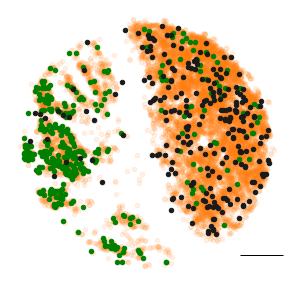

In [200]:
# Figure G
cutoff = 1
gene_name = 'MGST1'

bcs = puck_mel9.s1_dge_fmtd[puck_mel9.s1_dge_fmtd[gene_name] >= cutoff].index
bcs = [i for i in bcs if (i in tumor_bcs)]
colors = list(puck_mel9.s1_dge_fmtd.loc[bcs][puck_mel9.s1_dge_fmtd.loc[bcs][gene_name] >= cutoff][gene_name])
locs = [df_bc_to_loc[i] for i in bcs]

most_common_tcr = 'CASRASNEQFF'
tcr_bcs = df[df.TRBs==most_common_tcr]['Unnamed: 0']
tcr_locs = [df_bc_to_loc[i] for i in tcr_bcs]

cmap = cm.tab10(np.linspace(0, 1, 10))

fig,ax = plt.subplots(figsize=(5,5))
x,y = zip(*tumor_locs)
plt.scatter(x,y,c=cmap[1],s=20,alpha=0.1)

x,y = zip(*locs)
plt.scatter(x,y,c='green',s=20,alpha=1)

x,y = zip(*tcr_locs)
plt.scatter(x,y,c='k',s=20)

scalebar = AnchoredSizeBar(
ax.transData,
pixels_needed,
"",
"lower right",
pad=0.1,
color="black",
frameon=False,
size_vertical=1,
fontproperties=fontprops,
)
plt.axis('off')
#plt.legend()
ax.add_artist(scalebar)

# Figure S4H-I ERV expression in RCC

(H) Gaussian-filtered heatmap for visualizing the spatial distribution of all ERV expression (in UMI counts) in the post-treatment RCC lung metastasis array from Figure 3B. ERV expression was identified using Telescope. Dashed line delineates the tumor compartment.
(I) Spatial localization of beads expressing the predominant HARLEQUIN ERV family (black dots).
(J) To assess the co-expression of ERVs in RCC cells, the frequency with which beads in the tumor compartment expressed each ERV was quantified. For each expressed ERV (y-axis), the percent of beads in the tumor region that also co-expressed another ERV (x-axis) was displayed using a heatmap. ERVs were included in the analysis if they were expressed by at least 500 tumor-compartment beads in the three post-treatment RCC arrays and expressed in less than %1 of non-tumor cells in matched scRNA-seq data from the pre-treatment sample, thereby excluding ERVs that demonstrated high expression in non-tumor cells.
(K) Z-score normalized proportions of ERV-expressing beads that were predicted to be one of three RCC subtypes by RCTD.

real life size: 51.6955


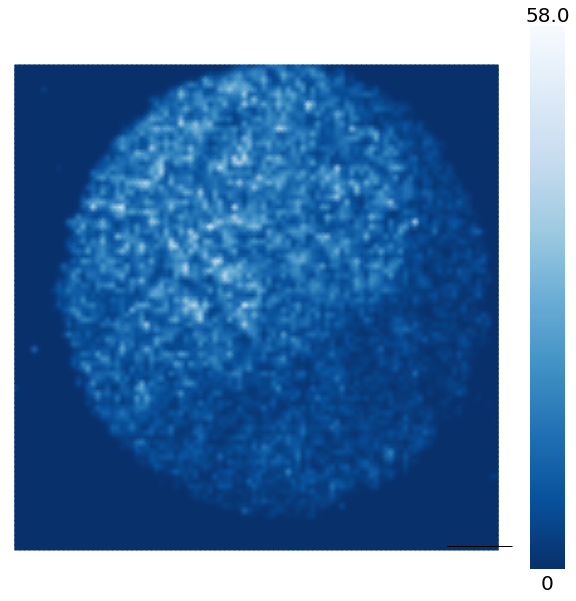

In [46]:
erv = pd.read_csv('ERV_loc_counts.csv')
nbins = 100
fontprops = fm.FontProperties(size=18)
plt.rcParams.update({'font.size': 20})
color_map = plt.cm.get_cmap('Blues')
reversed_color_map = color_map.reversed()

locs = [(i, j) for i, j in zip(erv.x, erv.y)]
erv_locs = []
for i, j in zip(erv.total_counts, locs):
    erv_locs = erv_locs + int(i) * [j]

gaussian_heat_plot([i[0] for i in erv_locs], [i[1] for i in erv_locs],
                   0,
                   max(erv.total_counts),
                   title_text='ERV',
                   save_name='ERV',
                   save=True)

In [49]:
for puck_id in ['08']:
    with open(f'adata_erv_rcc_{puck_id}.h5ad', 'rb') as p_f:
        ad_erv = sc.read_h5ad(p_f)
#         ad_erv.obs.drop(columns='tissue',inplace=True)
    

In [50]:
# Plot cell type compartments
def plot_on_puck(erv_df,title):
    for puck in tqdm([puck8]):
        fig, ax = plt.subplots(figsize=(5, 5))
        puck.tumor_beads = [
            i for i in puck.tll_loc_cluster_dict if puck.tll_loc_cluster_dict[i] == "Tumor"
        ]

        puck.til_beads = [
            i
            for i in puck.tll_loc_cluster_dict
            if puck.tll_loc_cluster_dict[i] == "TIL Chemokines"
        ]

        puck.lung_beads = [
            i for i in puck.tll_loc_cluster_dict if puck.tll_loc_cluster_dict[i] == "Lung"
        ]
        alpha_back = 0.1
        plt.scatter(
            [i[0] for i in puck.tumor_beads],
            [i[1] for i in puck.tumor_beads],
            label="tumor",
            s=0.5,
            alpha=alpha_back,
            color=sns.color_palette()[0],
        )
        plt.scatter(
            [i[0] for i in puck.til_beads],
            [i[1] for i in puck.til_beads],
            label="tll",
            s=0.5,
            alpha=alpha_back,
            color=sns.color_palette()[1],
        )
        plt.scatter(
            [i[0] for i in puck.lung_beads],
            [i[1] for i in puck.lung_beads],
            label="lung",
            s=0.5,
            alpha=alpha_back,
            color=sns.color_palette()[2],
        )

        plt.axis("off")
        fontprops = fm.FontProperties(size=18)
        scalebar = AnchoredSizeBar(
            ax.transData,
            pixels_needed,
            "",
            "lower right",
            pad=0.1,
            color="black",
            frameon=False,
            size_vertical=1,
            fontproperties=fontprops,
        )
        ax.add_artist(scalebar)
        
        # ADD IN ERVS
        plt.scatter(erv_df.x,erv_df.y,s=3,c='k')
        plt.title(title)
        plt.show()

In [55]:
!gsutil cp ../HARLEQUIN_1q24.3_locs.csv ./

Copying file://../HARLEQUIN_1q24.3_locs.csv...

Operation completed over 1 objects/38.2 KiB.                                     


In [ ]:
puck_name = '2020-09-02_Puck_200727_08'
puck8 = load_puck(slideseq_name = puck_name)

  0%|          | 0/1 [00:00<?, ?it/s]

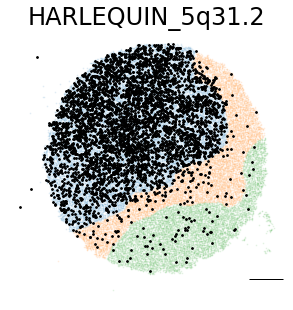

  0%|          | 0/1 [00:00<?, ?it/s]

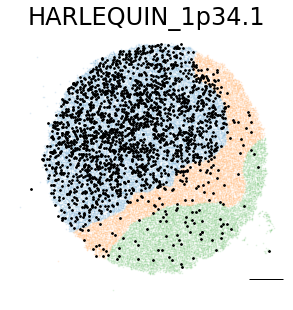

  0%|          | 0/1 [00:00<?, ?it/s]

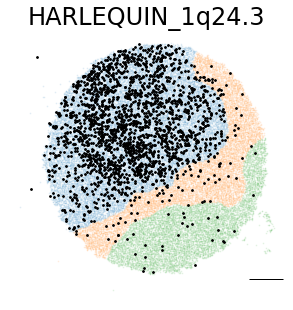

In [57]:
top_ERVs=['HARLEQUIN_5q31.2', 'HARLEQUIN_1p34.1', 'HARLEQUIN_1q24.3']
for v in top_ERVs:
    ERV=pd.read_csv(f'{v}_locs.csv', index_col=0)
    plot_on_puck(ERV,title=v)

# FIN